In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
import matplotlib as mpl
#import uproot
import uproot3
from scipy import optimize as op

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions.ipynb
#uproot3
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [10]:
sim="exp"
run="e1f"
cut_perf="delta"
species = "pim"

date = "05-31-2024"
dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_"+run+"/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/06-13-2022"

root_file=dir+"/"+sim+"_"+run+"_clas6_"+cut_perf+"_"+species+"_"+date+".root"
file=uproot3.open(root_file)
#selection 0-> pid in experimental W range, 1->event selection in full W range
selection = 0
# 0 => full range 1=> Experimental W range
W_range = 0

rel_top=['mnone','mall']

W_bits=['all','in_range']

In [11]:
#The Various layers of TDirectories to get to the histograms
layer1='Delta'
layer2=cut_perf+"_"+species
layer3=[layer2+"_pid",layer2+"_event"]
layer4=[[layer3[sel]+"_sec"+str(sec+1) for sel in range(2)] for sec in range(6)]
layer5=[[layer4[sec][sel]+"_cut" for sel in range(2)] for sec in range(6)]
layer6=[[layer5[sec][0]+"_mnone",layer5[sec][1]+"_mall"] for sec in range(6)]
layer7=[[layer6[sec][sel]+"_in_range" for sel in range(2)] for sec in range(6)]
layer8=[[layer3[sel]+"_cut_"+rel_top[sel]+"_sec"+str(sec+1)+"_"+W_bits[W_range] for sel in range(2)] for sec in range(6)]
dir_loc0= [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection] for sec in range(6)]
dir_loc = [layer1+"/"+layer2+"/"+layer3[selection]+"/"+layer4[sec][selection]+"/"+layer5[sec][selection]+"/"+layer6[sec][selection]+"/"+layer7[sec][selection]+"/"+layer8[sec][selection] for sec in range(6)]

hist = [file[dir_loc[sec]] for sec in range(6)]

print(layer8[0][selection])

delta_pim_pid_cut_mnone_sec1_all


In [12]:
cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

In [13]:
#Extracting X and Y bins
#X and Y binning is the same for all sectors
xbins=Center_Xbins(hist[0])
ybins=Center_Ybins(hist[0])
#Extracting Zvals for 2d histograms
zvals_xy=[XY_Values(hist[sec]) for sec in range(6)]
zvals_yx=[YX_Values(hist[sec]) for sec in range(6)]

In [14]:
#Determining Cell Merging 
xmerge=3
ymerge=3
xname="p(GeV)"
yname="\u0395 t"
#Merge -> No Zeros
x = Merge_Bins(xbins,xmerge)
y = Merge_Bins(ybins,ymerge)
xedges = Merge_Bin_Edges(XEdges_2d(hist[0]),xmerge)
yedges = Merge_Bin_Edges(YEdges_2d(hist[0]),ymerge)
z_xy=[Merge_Z(zvals_xy[i],xmerge,ymerge) for i in range(6)]
z_yx=[Merge_Z(zvals_yx[i],ymerge,xmerge) for i in range(6)]
fit_x = [[Remove_Zeros_X(y,z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]
fit_y = [[Remove_Zeros_Y(z_xy[sec][xbin]) for xbin in range(len(x))] for sec in range(6)]



In [15]:
#dumb_x= np.zeros((6,len(x)*len(y)))
#dumb_y= np.zeros((6,len(x)*len(y)))
#dense2 = np.zeros((6,len(x)*len(y)))
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    #for i in range(len(x)):
    for i in range(len(xbins)):
        #for j in range(len(y)):
        for j in range(len(ybins)):
            #dumb_x[sec][i+j*len(x)]+=x[i]
            #dumb_y[sec][i+j*len(x)]+=y[j]
            #dense2[sec][i+j*len(x)]+=zvals_xy[sec][i][j]
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]


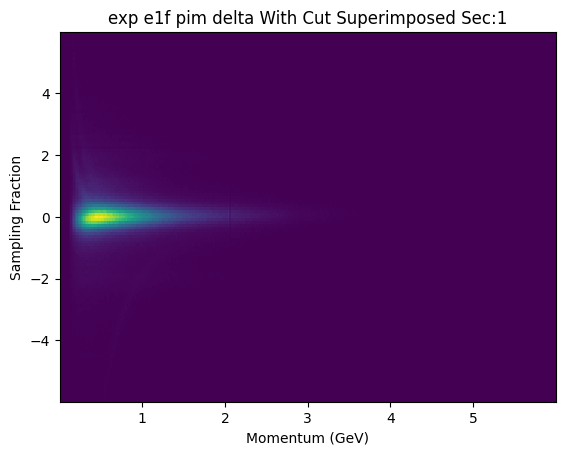

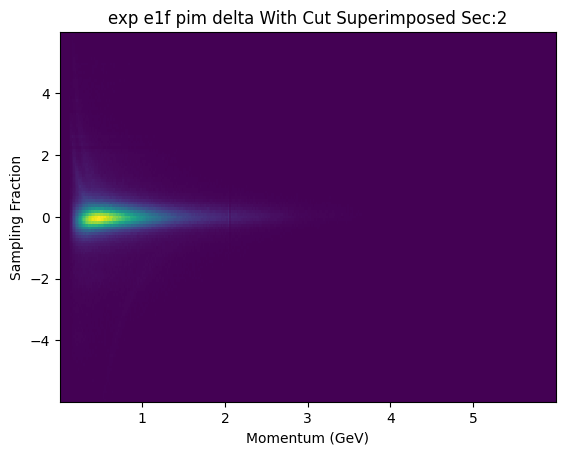

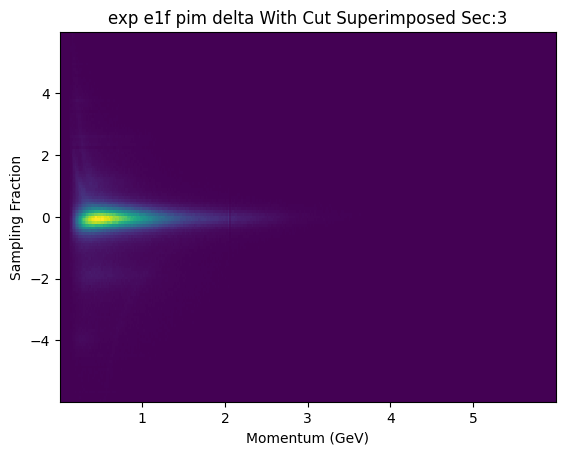

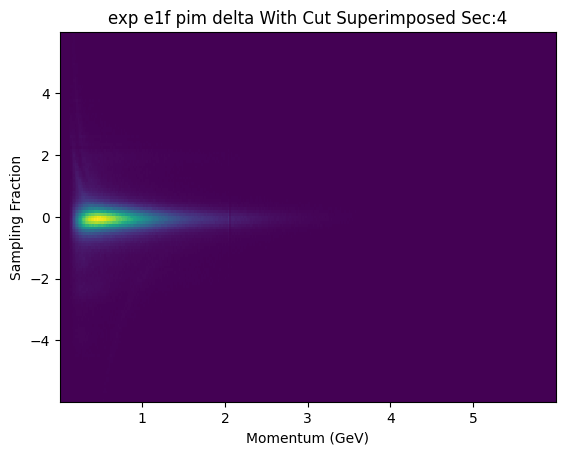

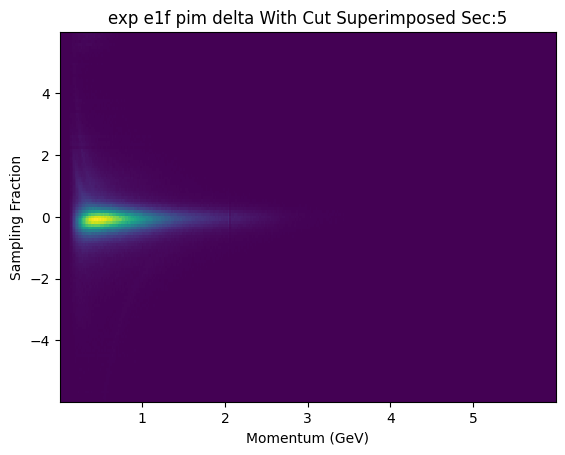

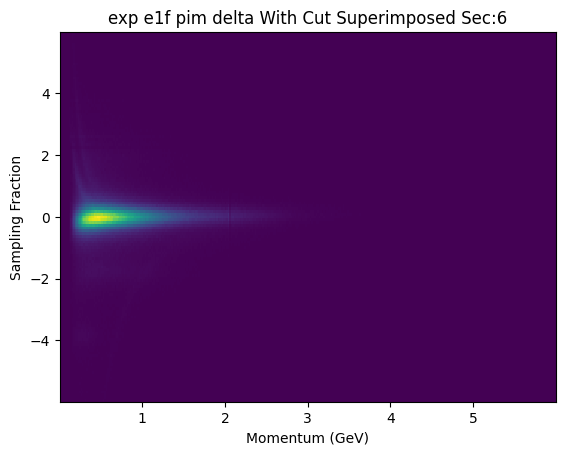

In [16]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(x), len(y)), weights=dense2[sec])
    plt.title("{} {} {} {} With Cut Superimposed Sec:{}".format(sim,run,species,cut_perf,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("Sampling Fraction")
    plt.show()
    
    
    

In [17]:
def Pbin_low(xbin_):
    return round(xedges[xbin_],3)
def Pbin_top(xbin_):
    return round(xedges[xbin_+1],3)

-0.8919557470119729 0.8684440556707086
-1.067995727280241 1.0444840359389767
-1.2440357075485091 1.2205240162072448


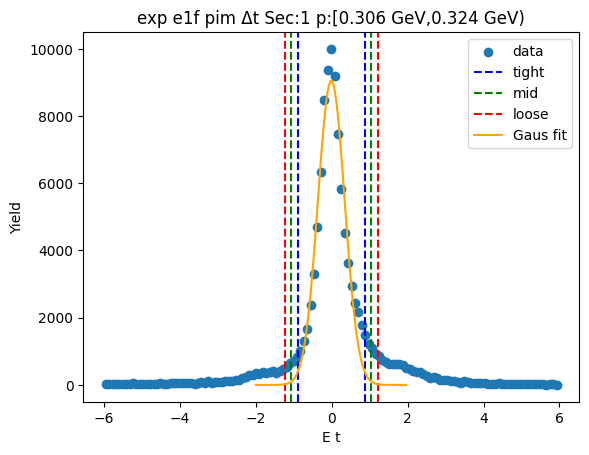

-0.8697307596190863 0.8477445473336466
-1.0414782903143596 1.01949207802892
-1.2132258210096327 1.1912396087241932


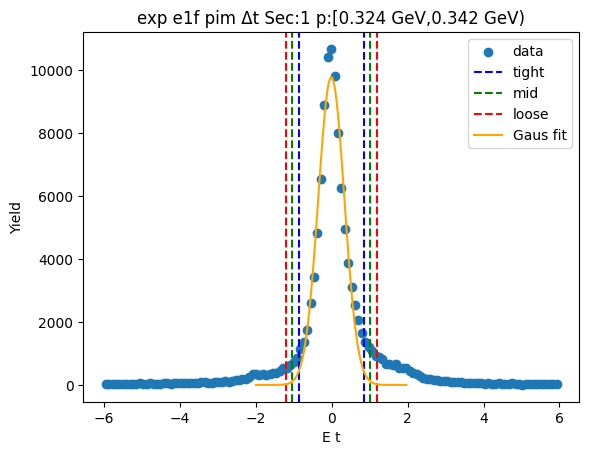

-0.8358071957735941 0.8265537879683332
-1.0020432941477868 0.992789886342526
-1.1682793925219794 1.1590259847167186


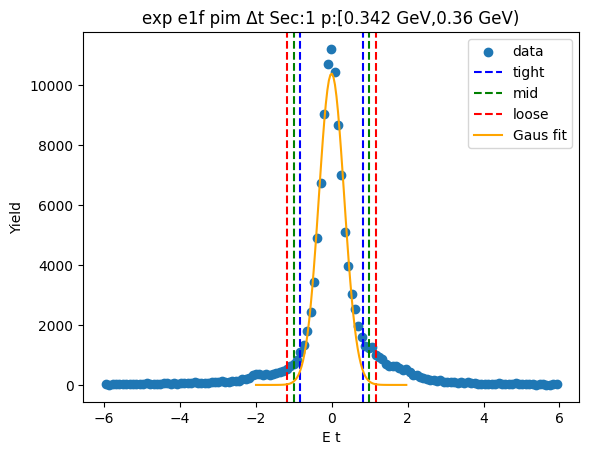

-0.8165282117322317 0.8178173434005696
-0.9799627672455118 0.9812518989138497
-1.143397322758792 1.1446864544271298


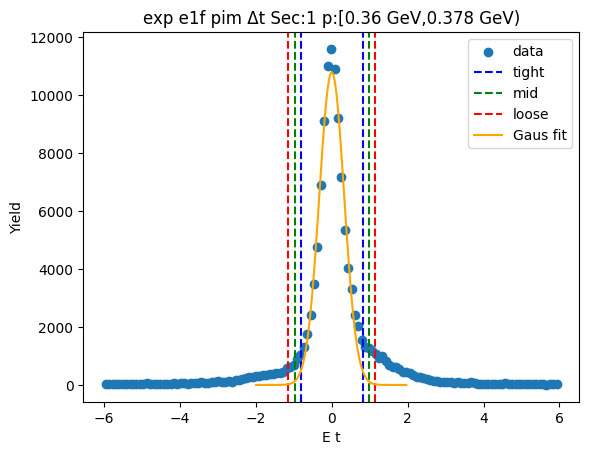

-0.7883046905625647 0.7929045006235101
-0.9464256096811722 0.9510254197421176
-1.1045465287997795 1.1091463388607252


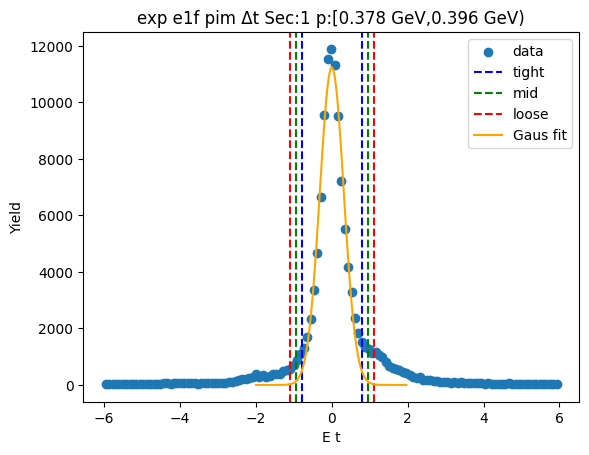

-0.7808361816855733 0.7938391070919983
-0.9383037105633305 0.9513066359697555
-1.0957712394410877 1.1087741648475127


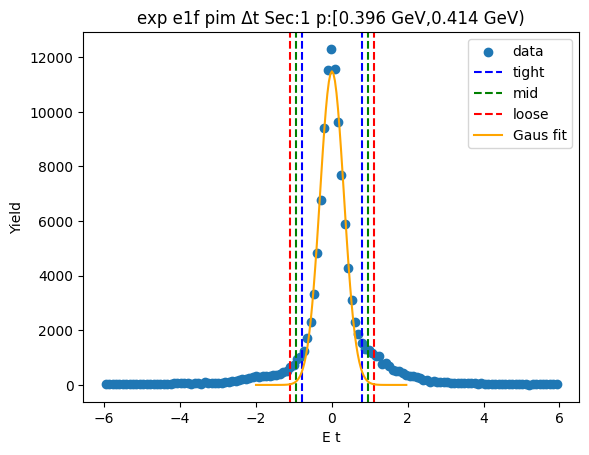

-0.7536451722286323 0.7727450043447702
-0.9062841898859726 0.9253840220021106
-1.0589232075433128 1.0780230396594508


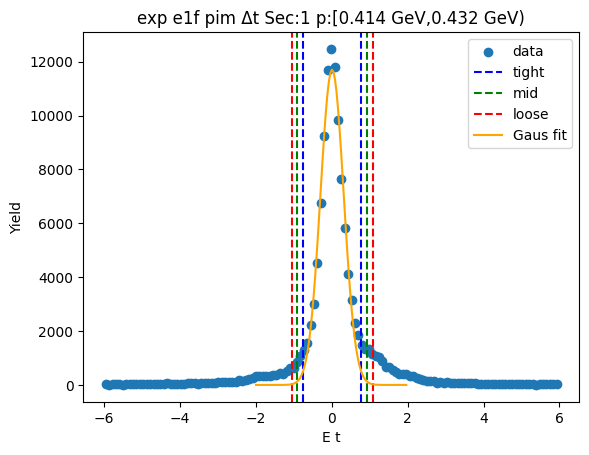

-0.7407735418778812 0.7682864129413111
-0.8916795373598005 0.9191924084232304
-1.0425855328417197 1.0700984039051498


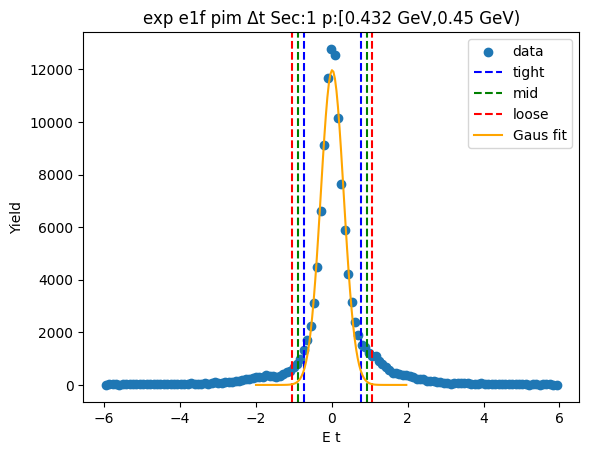

-0.7249218288844823 0.7619510062866384
-0.8736091124015944 0.9106382898037505
-1.0222963959187066 1.0593255733208626


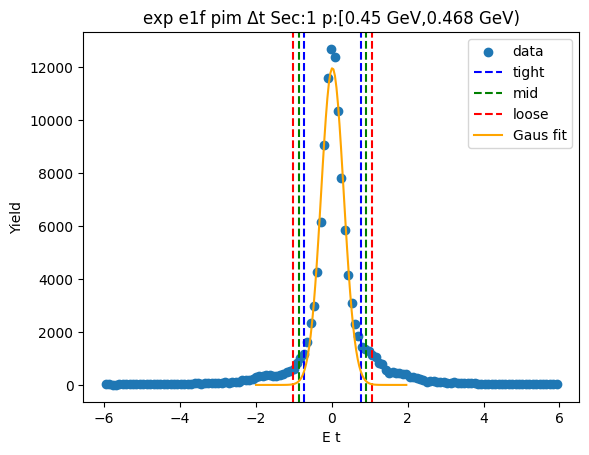

-0.7273410603243992 0.7678818649417608
-0.8768633528510152 0.9174041574683769
-1.0263856453776312 1.0669264499949929


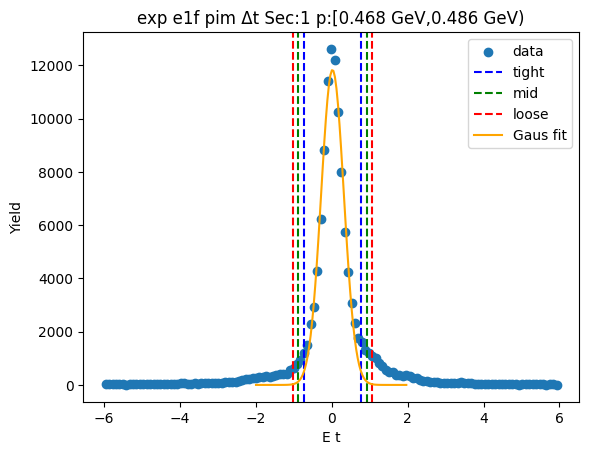

-0.7105319079130216 0.7448143670782702
-0.8560665354121508 0.8903489945773995
-1.00160116291128 1.0358836220765286


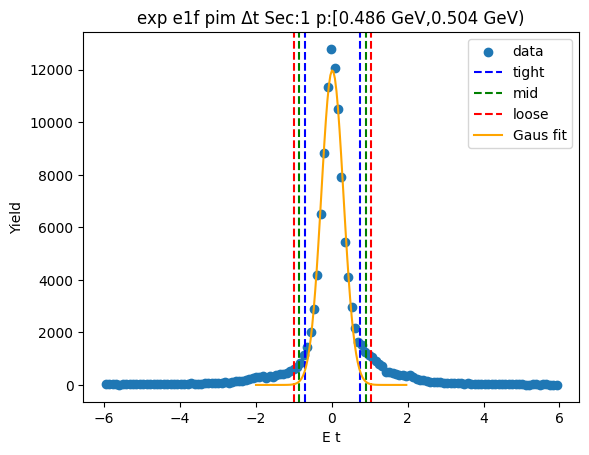

-0.7057773360330545 0.7494689032602057
-0.8513019599623806 0.8949935271895317
-0.9968265838917066 1.0405181511188577


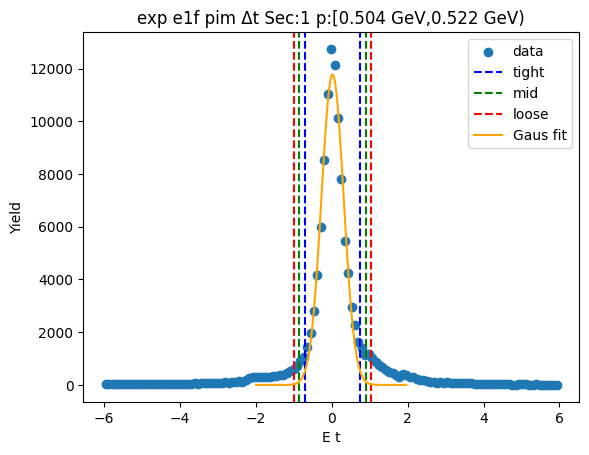

-0.6958305610643742 0.7403237471978512
-0.8394459918905969 0.8839391780240738
-0.9830614227168194 1.0275546088502963


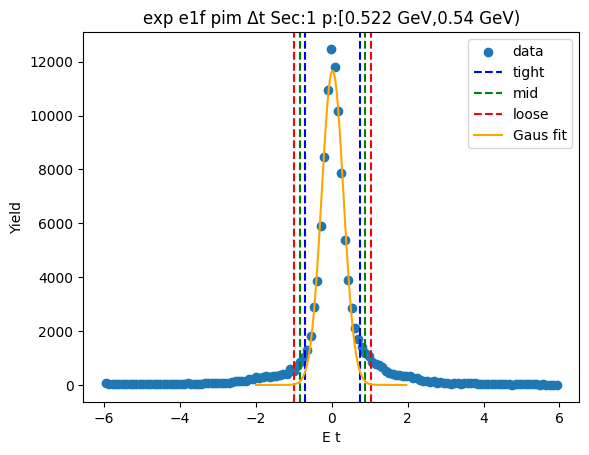

-0.6939912816751534 0.7483347256491928
-0.8382238824075882 0.8925673263816275
-0.9824564831400228 1.0367999271140622


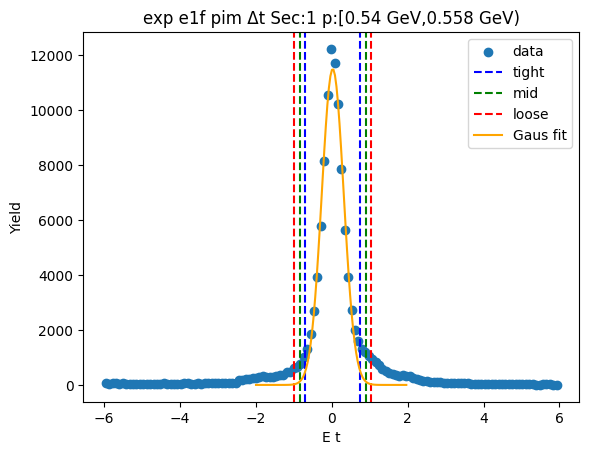

-0.6754317576734274 0.7261368642342143
-0.8155886198641917 0.8662937264249784
-0.9557454820549558 1.0064505886157427


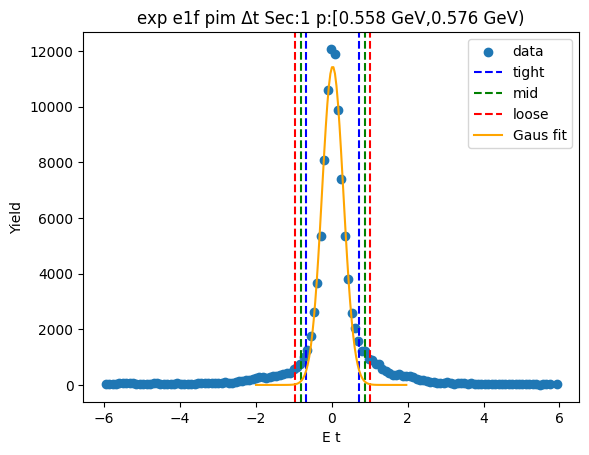

-0.6973390170657925 0.7473313547155676
-0.8418060542439284 0.8917983918937035
-0.9862730914220644 1.0362654290718394


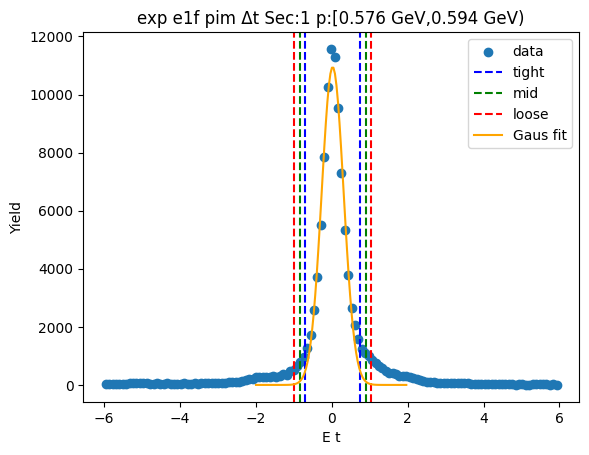

-0.6793955799609863 0.738780495022469
-0.8212131874593319 0.8805981025208146
-0.9630307949576775 1.0224157100191602


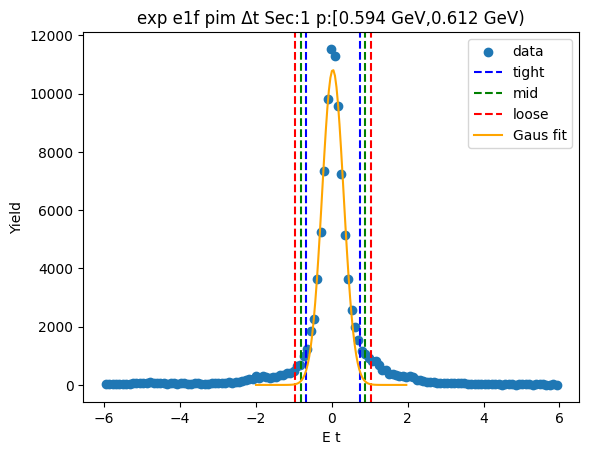

-0.6726637702571494 0.7268927767589954
-0.8126194249587638 0.8668484314606099
-0.9525750796603782 1.0068040861622243


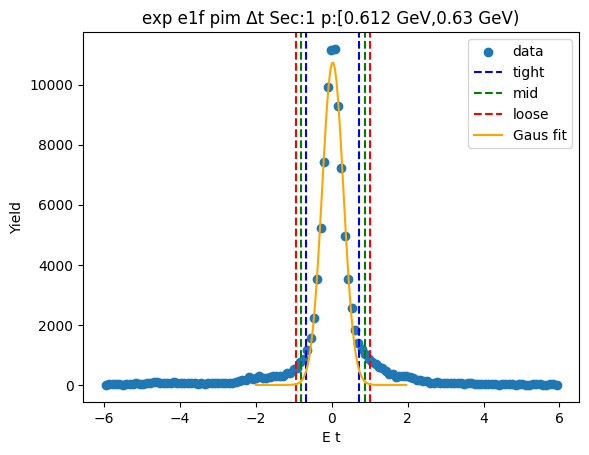

-0.6675771752637449 0.727661369271845
-0.807101029717304 0.8671852237254041
-0.946624884170863 1.0067090781789632


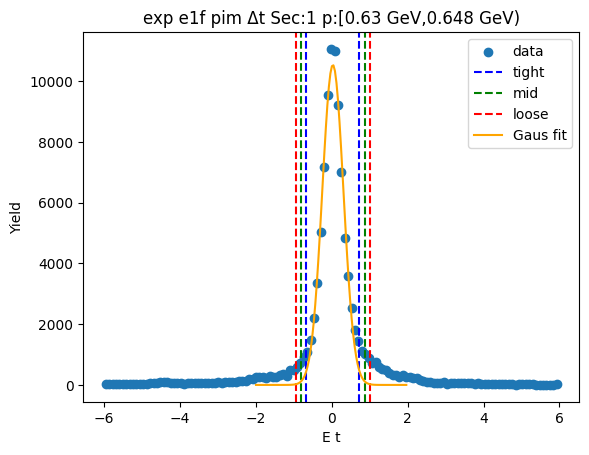

-0.6697633830749858 0.724165757772963
-0.8091562971597807 0.8635586718577578
-0.9485492112445755 1.0029515859425526


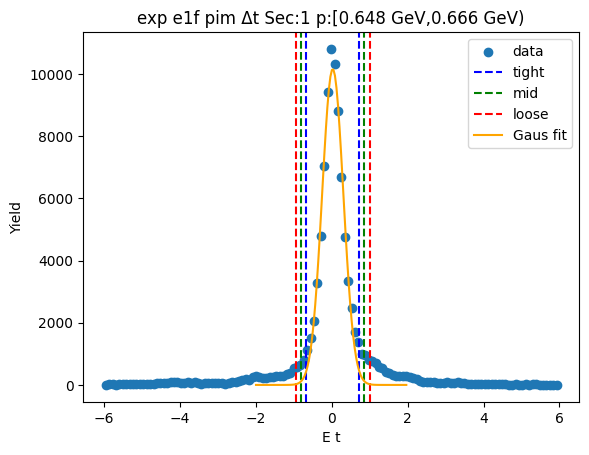

-0.669223057844341 0.7282926874500526
-0.8089746323737804 0.868044261979492
-0.9487262069032198 1.0077958365089315


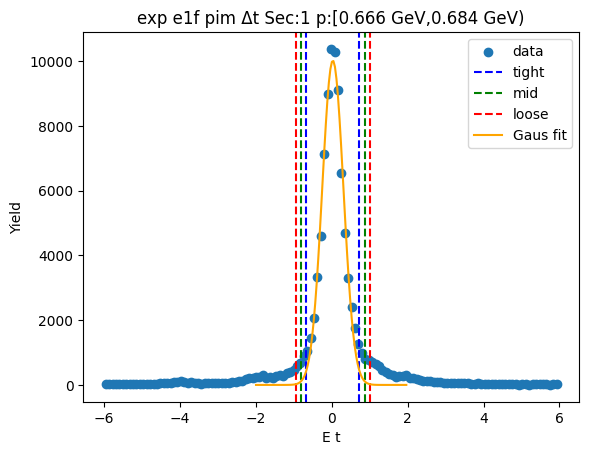

-0.6746081234769828 0.7309653234705952
-0.8151654681717407 0.8715226681653531
-0.9557228128664985 1.0120800128601108


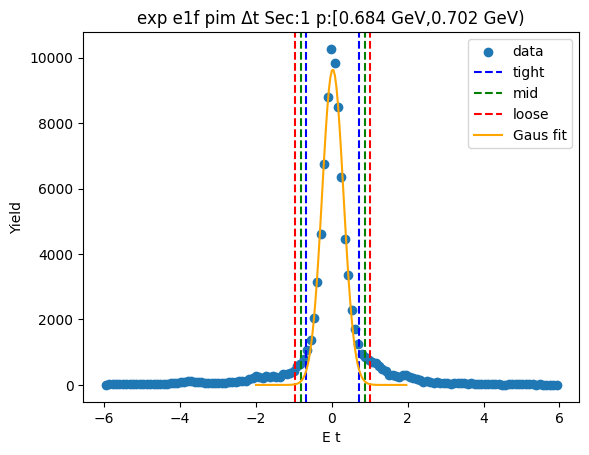

-0.6651681078000763 0.729900689499163
-0.8046749875300002 0.8694075692290869
-0.9441818672599241 1.0089144489590107


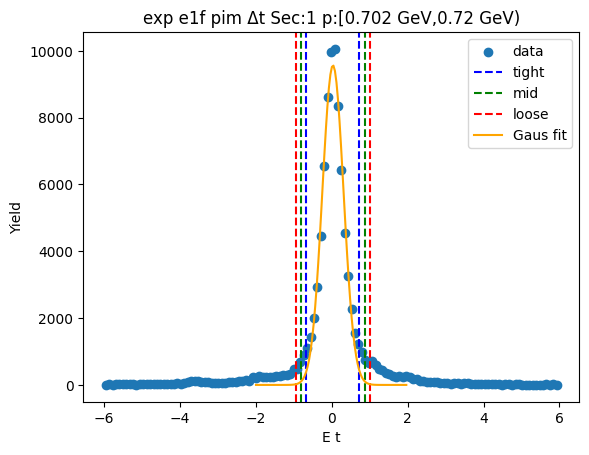

-0.6598981769903629 0.729991674910401
-0.7988871621804392 0.8689806601004773
-0.9378761473705156 1.0079696452905538


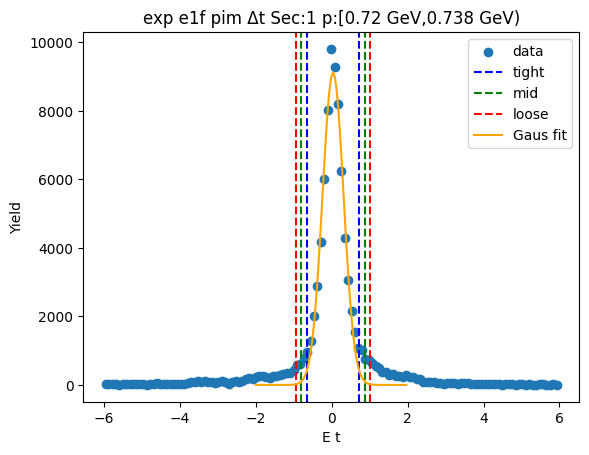

-0.6577051444865034 0.721986531902395
-0.7956743121253932 0.8599556995412848
-0.933643479764283 0.9979248671801746


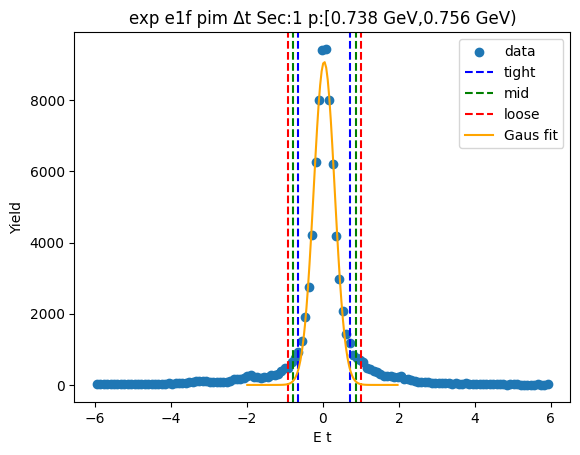

-0.6517372280029123 0.7193935802315152
-0.7888503088263551 0.856506661054958
-0.9259633896497979 0.9936197418784007


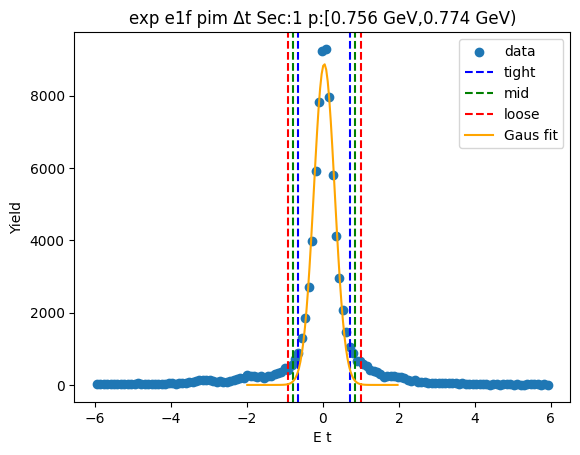

-0.659176933918177 0.7272233129107142
-0.797816958601066 0.8658633375936032
-0.9364569832839551 1.0045033622764923


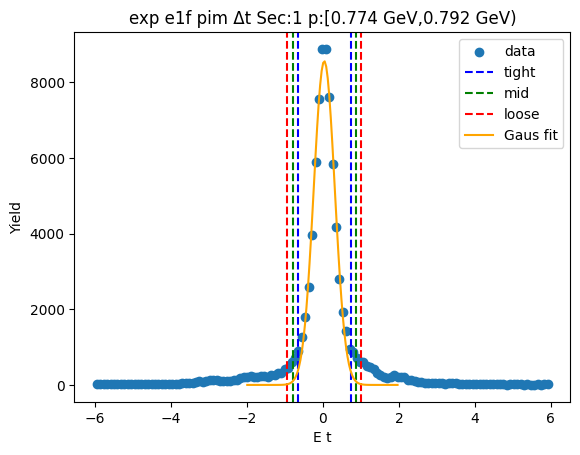

-0.6545500538452317 0.7191564383661958
-0.7919207030663745 0.8565270875873386
-0.9292913522875172 0.9938977368084814


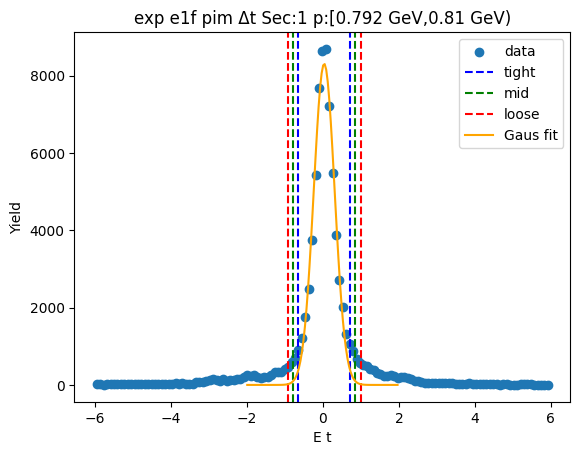

-0.6616814478168892 0.732682210567441
-0.8011178136553223 0.8721185764058741
-0.9405541794937553 1.011554942244307


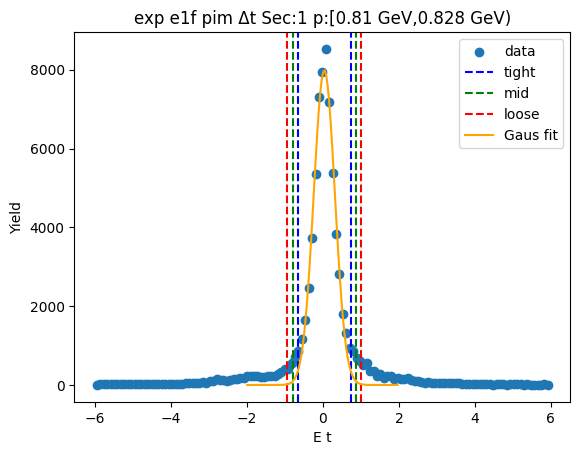

-0.6488911122164921 0.7176567314901127
-0.7855458965871526 0.8543115158607731
-0.922200680957813 0.9909663002314336


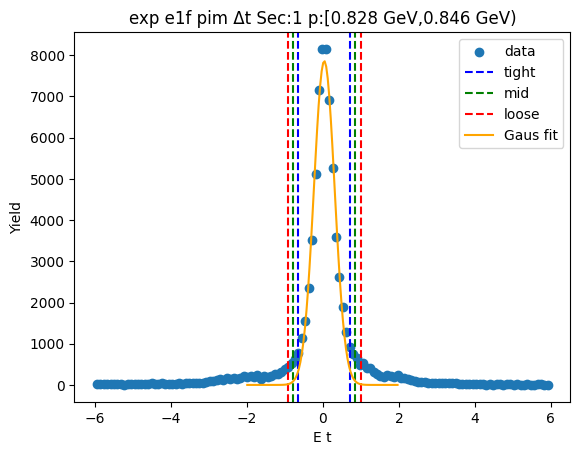

-0.6469509913461138 0.7147827064218237
-0.7831243611229076 0.8509560761986176
-0.9192977308997013 0.9871294459754113


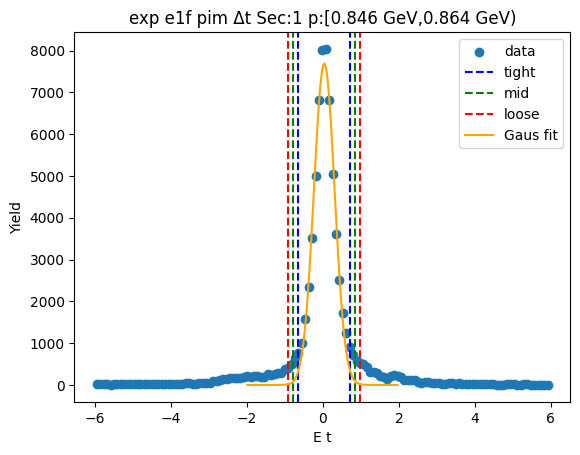

-0.6368615902395843 0.7087428365351979
-0.7714220329170625 0.843303279212676
-0.9059824755945407 0.9778637218901542


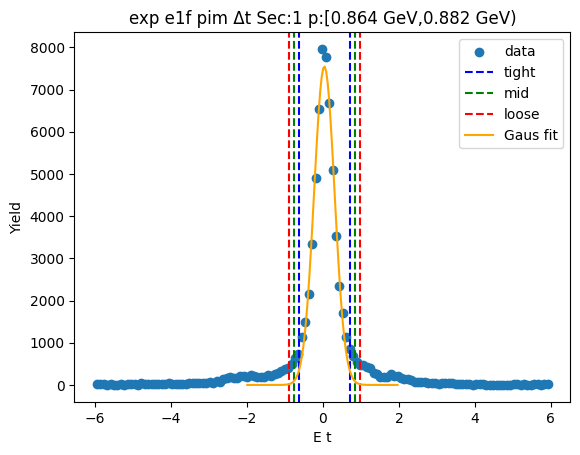

-0.6472181343309578 0.7200834204966553
-0.783948289813719 0.8568135759794165
-0.9206784452964802 0.9935437314621778


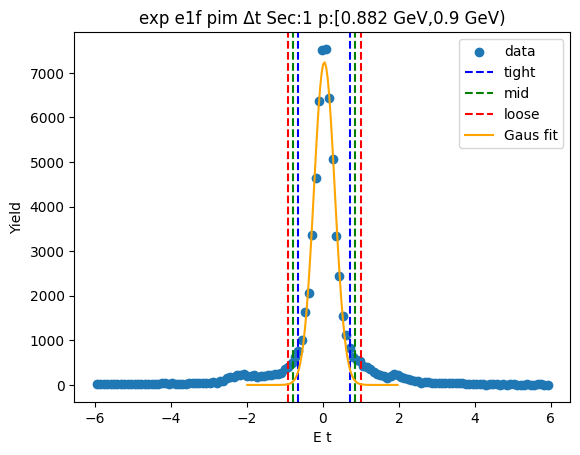

-0.6390728946629 0.7060138752639374
-0.7735815716555836 0.8405225522566211
-0.9080902486482674 0.9750312292493049


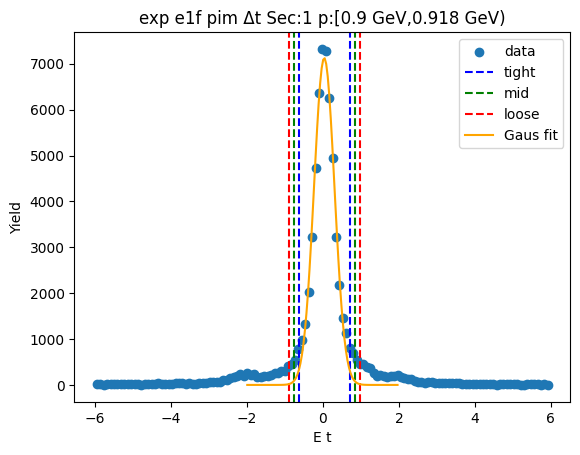

-0.639349351869821 0.7145543035832396
-0.7747397174151271 0.8499446691285457
-0.9101300829604332 0.9853350346738518


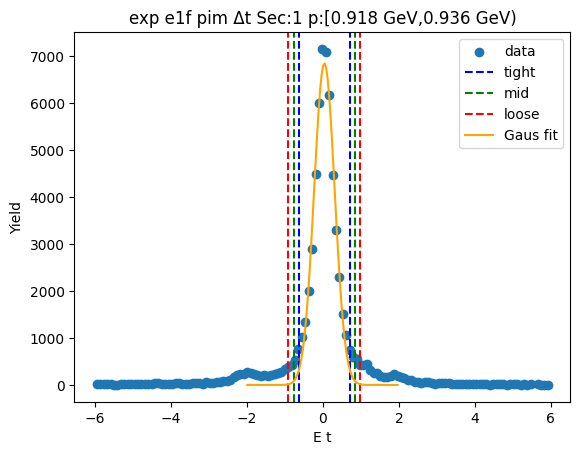

-0.6434857583657565 0.7161305747239282
-0.7794473916747249 0.8520922080328965
-0.9154090249836934 0.988053841341865


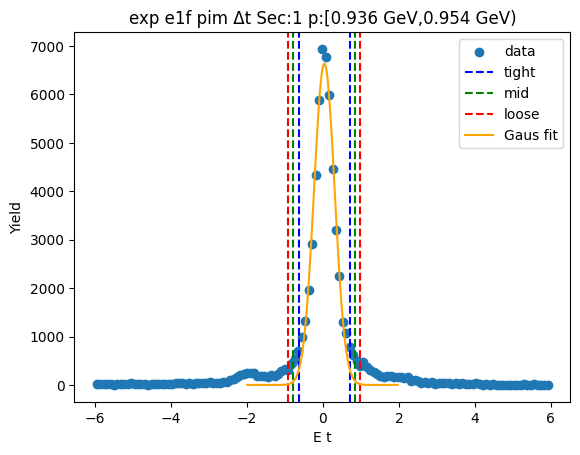

-0.6452066038006545 0.717374947997621
-0.7814647589804822 0.8536331031774487
-0.9177229141603097 0.9898912583572762


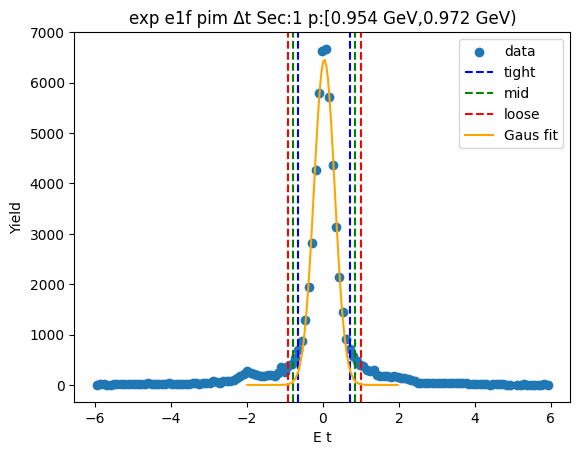

-0.6392682504813111 0.7106846431150485
-0.774263539840947 0.8456799324746844
-0.9092588292005829 0.9806752218343203


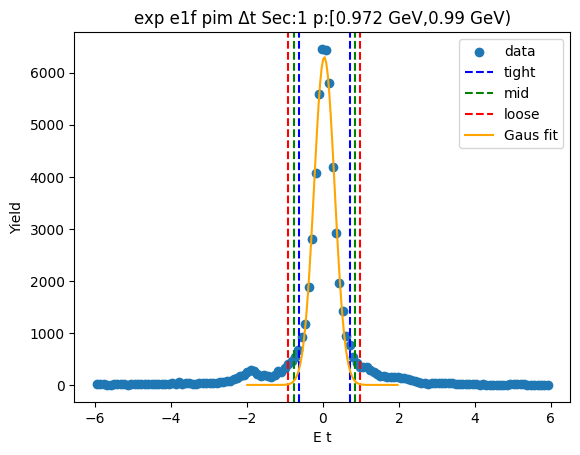

-0.6384451761632628 0.7127004383296869
-0.7735597376125577 0.8478149997789818
-0.9086742990618526 0.9829295612282767


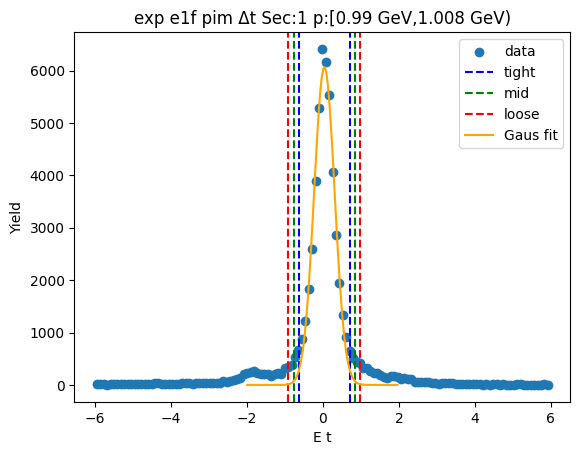

-0.6336945653295295 0.7040468292175471
-0.7674687047842372 0.8378209686722549
-0.901242844238945 0.9715951081269626


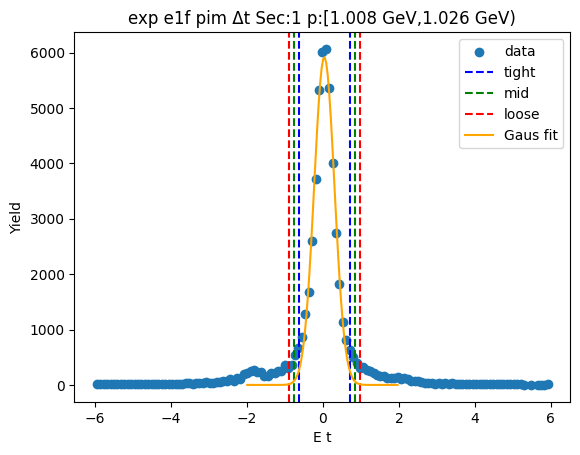

-0.6259323540374098 0.6987935554069127
-0.7584049449818421 0.831266146351345
-0.8908775359262744 0.9637387372957773


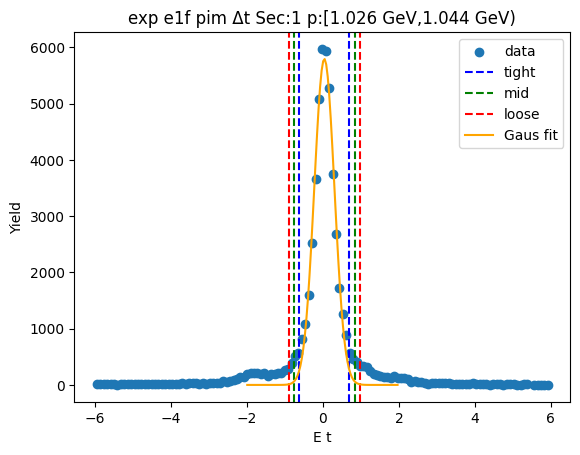

-0.6129945172842071 0.6917467744423855
-0.7434686464568665 0.8222209036150447
-0.8739427756295257 0.9526950327877042


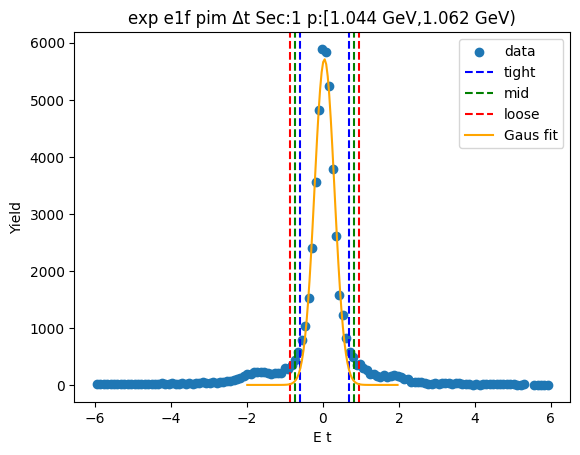

-0.6215897684429017 0.6944877694808878
-0.7531975222352806 0.8260955232732666
-0.8848052760276595 0.9577032770656455


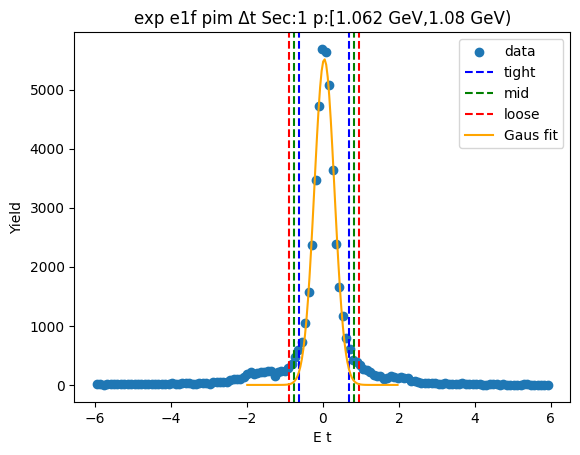

-0.6120052178152933 0.6920666238341702
-0.7424124019802396 0.8224738079991165
-0.872819586145186 0.9528809921640629


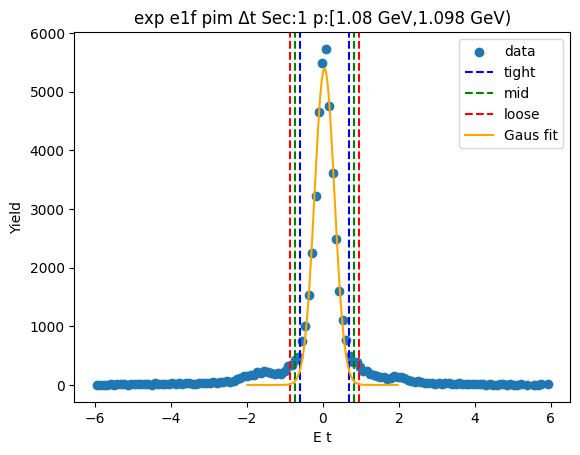

-0.6229788840139282 0.696076417055039
-0.7548844141208249 0.8279819471619356
-0.8867899442277215 0.9598874772688323


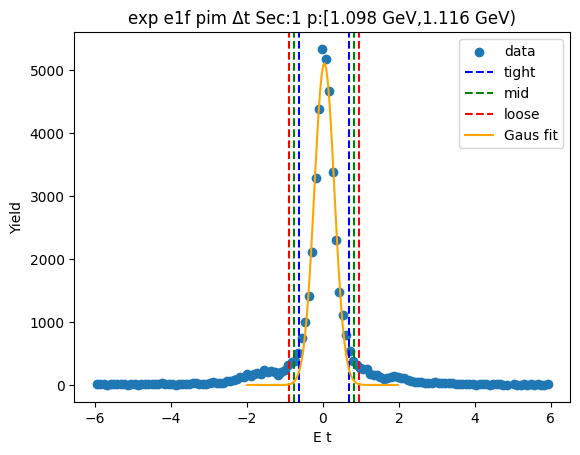

-0.6182009437921233 0.7004329446471657
-0.7500643326360522 0.8322963334910946
-0.8819277214799811 0.9641597223350235


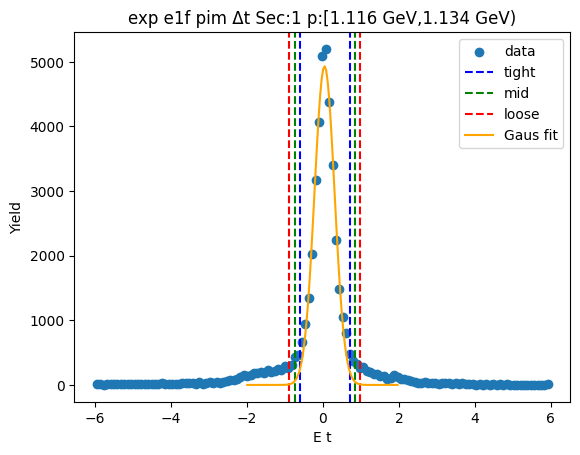

-0.6262673943281223 0.7006216753871295
-0.7589563012996475 0.8333105823586547
-0.8916452082711728 0.96599948933018


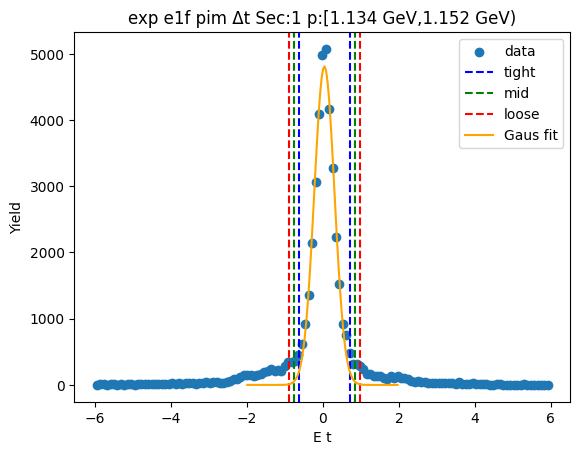

-0.6161140189693608 0.6960140745581409
-0.7473268283221111 0.8272268839108912
-0.8785396376748612 0.9584396932636413


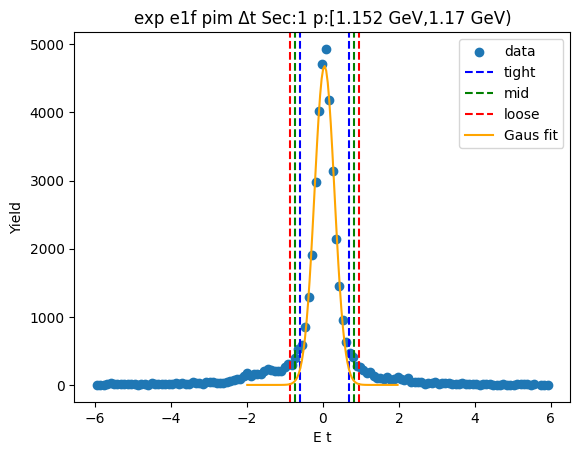

-0.6077479652092732 0.68539297234254
-0.7370620589644545 0.8147070660977214
-0.8663761527196359 0.9440211598529027


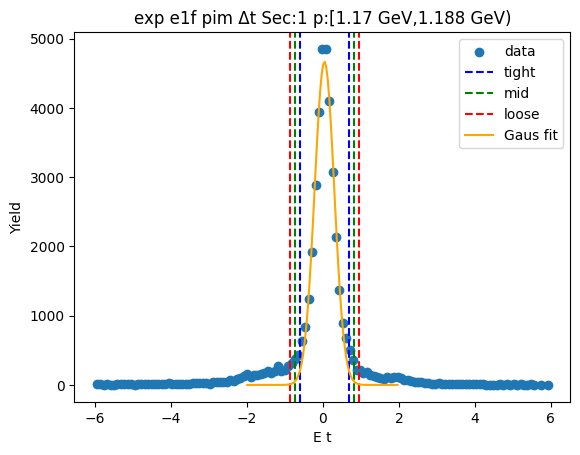

-0.6037142044274686 0.6786398825916542
-0.7319496131293808 0.8068752912935664
-0.8601850218312931 0.9351106999954787


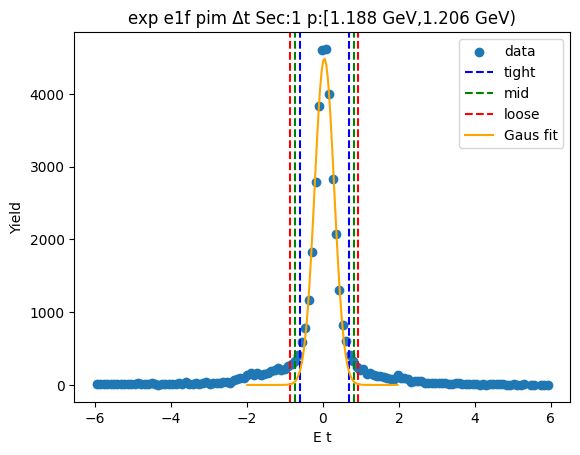

-0.606273734565548 0.6926240161094397
-0.7361635096330468 0.8225137911769385
-0.8660532847005455 0.9524035662444372


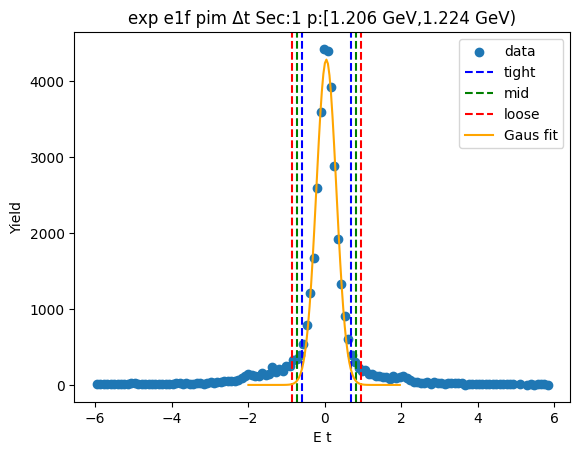

-0.5964306780546964 0.6895555991561269
-0.7250293057757787 0.8181542268772092
-0.8536279334968611 0.9467528545982915


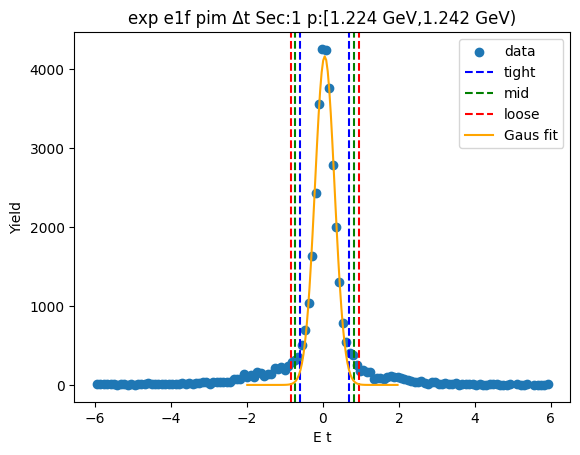

-0.6039596147261532 0.6896407055761031
-0.733319646756379 0.8190007376063289
-0.8626796787866046 0.9483607696365545


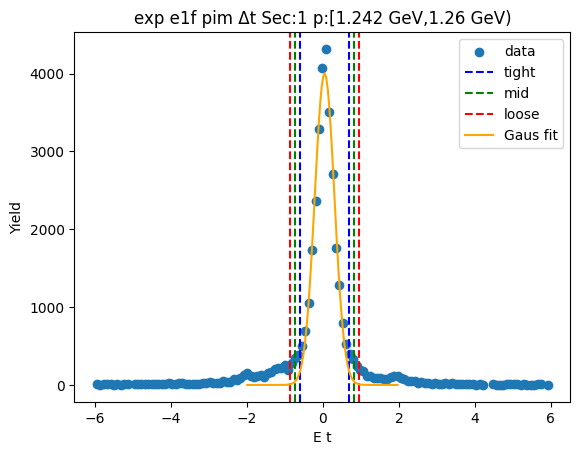

-0.6078159934867035 0.6957442778218123
-0.7381720206175549 0.8261003049526637
-0.8685280477484065 0.9564563320835153


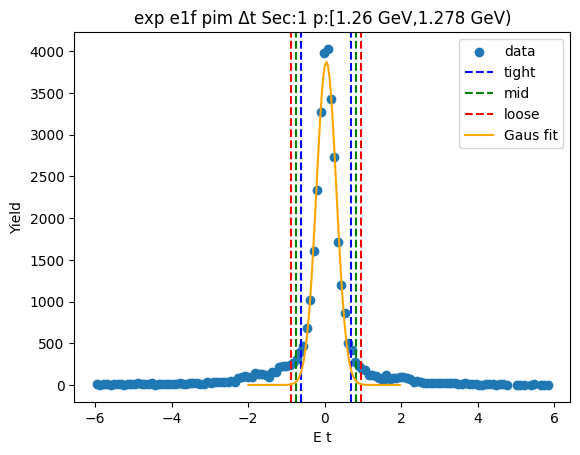

-0.5967943599295839 0.6839822324270172
-0.724872019165244 0.8120598916626773
-0.8529496784009042 0.9401375508983375


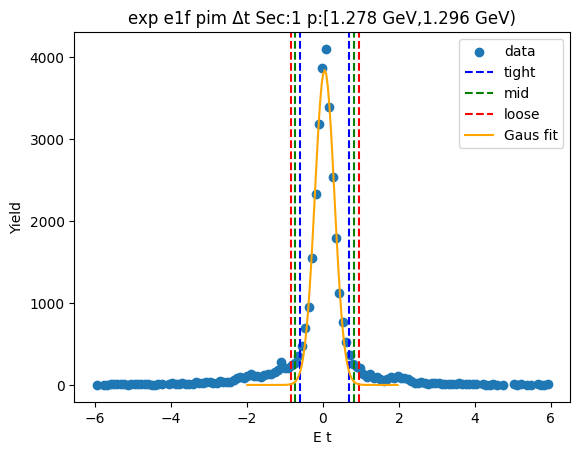

-0.5957610323318749 0.6866366483794797
-0.7240008004030104 0.8148764164506151
-0.8522405684741459 0.9431161845217506


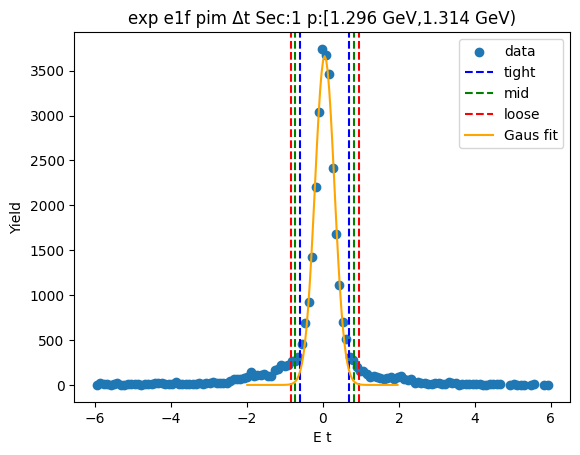

-0.598273747753959 0.6856242808024748
-0.7266635506096024 0.8140140836581182
-0.8550533534652458 0.9424038865137616


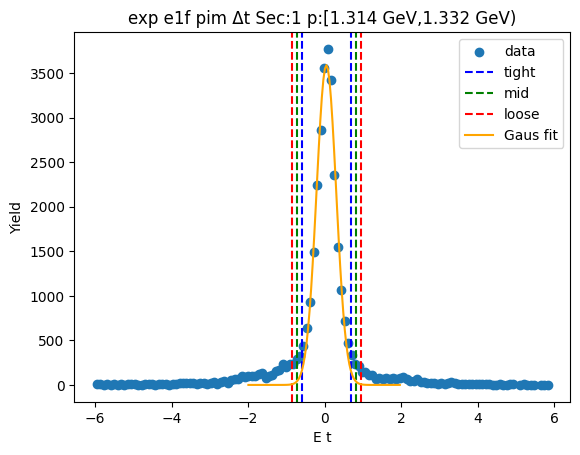

-0.5789474825510114 0.6682765233067932
-0.7036698831367918 0.7929989238925736
-0.8283922837225722 0.9177213244783541


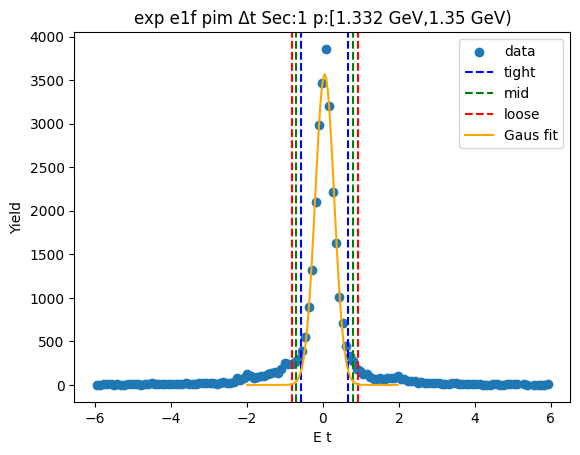

-0.5955301186861583 0.6840568589801248
-0.7234888164527866 0.8120155567467533
-0.8514475142194151 0.9399742545133816


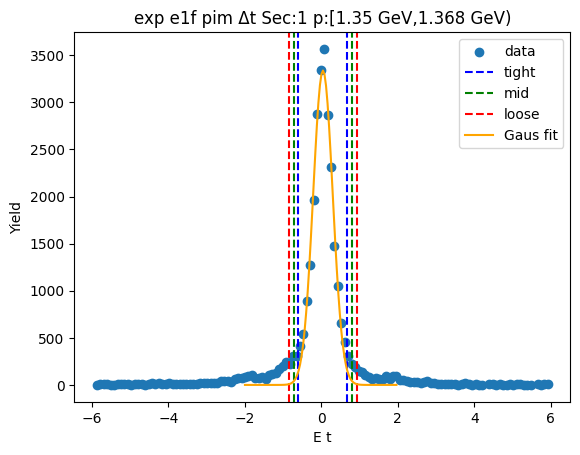

-0.5877727720907125 0.675270333573233
-0.714077082657107 0.8015746441396274
-0.8403813932235016 0.927878954706022


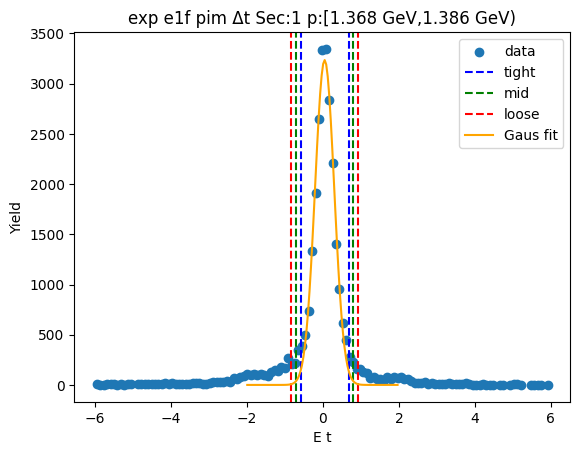

-0.5799231427710232 0.6671490531722066
-0.7046303623653463 0.7918562727665297
-0.8293375819596692 0.9165634923608527


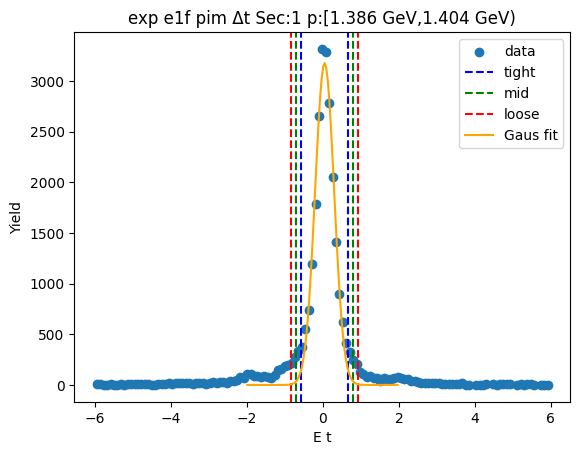

-0.5940116156437026 0.6926499949025643
-0.7226777766983293 0.821316155957191
-0.851343937752956 0.9499823170118177


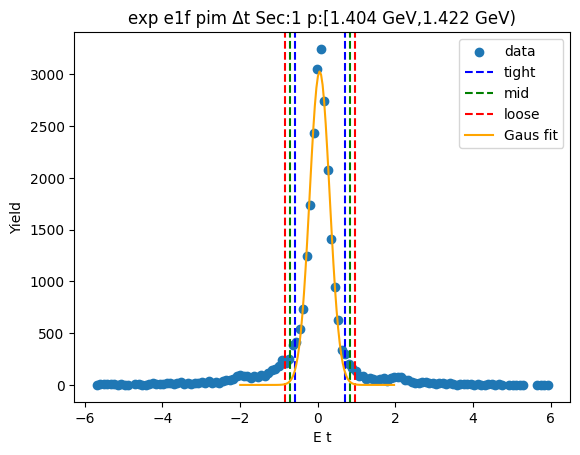

-0.5912521022529558 0.6795326355997446
-0.7183305760382258 0.8066111093850147
-0.8454090498234959 0.9336895831702847


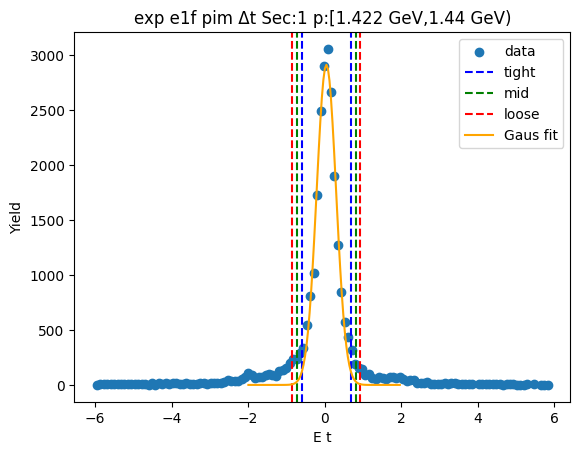

-0.5698106173333313 0.6688851273086303
-0.6936801917975273 0.7927547017728265
-0.8175497662617235 0.9166242762370227


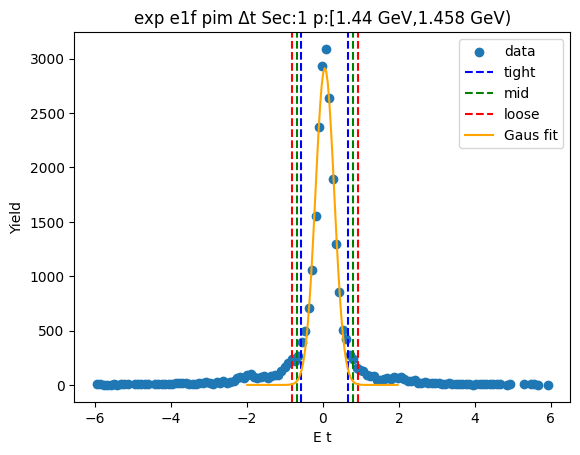

-0.5790071146090412 0.6710529598123427
-0.7040131220511795 0.796058967254481
-0.8290191294933179 0.9210649746966194


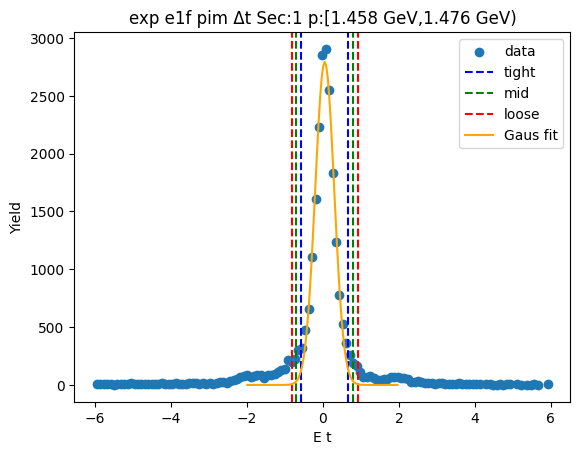

-0.5811214066326803 0.6833202546216081
-0.707565572758109 0.8097644207470368
-0.8340097388835379 0.9362085868724657


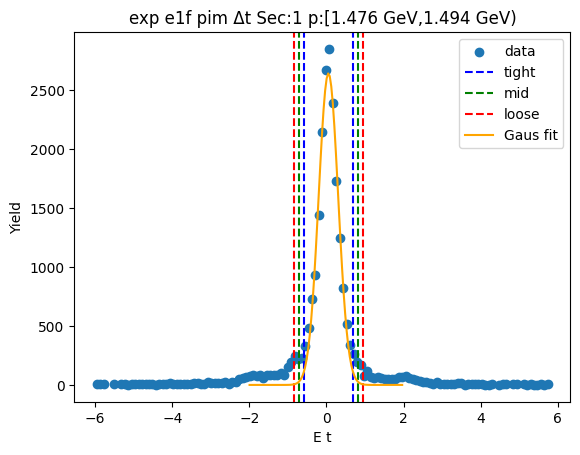

-0.5726341775637547 0.668371003108662
-0.6967346956309963 0.7924715211759037
-0.820835213698238 0.9165720392431453


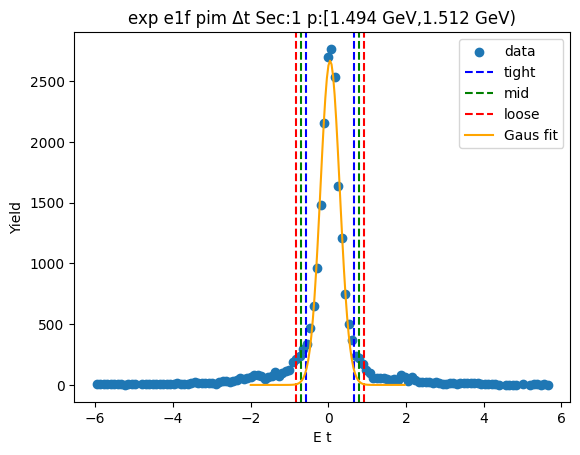

-0.5953374495795496 0.6895488638534444
-0.7238260809228491 0.8180374951967438
-0.8523147122661485 0.9465261265400433


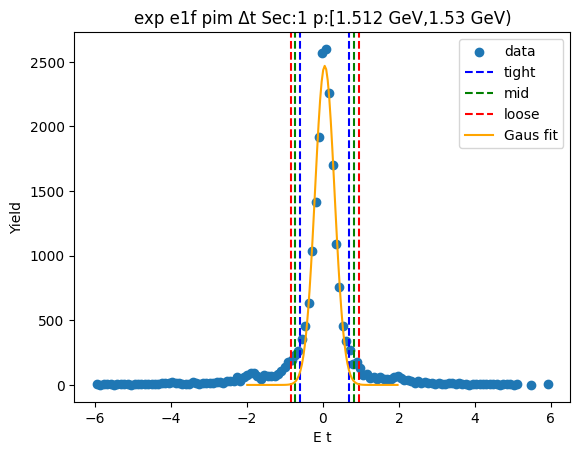

-0.567909379309957 0.6723279821208759
-0.6919331154530403 0.7963517182639591
-0.8159568515961235 0.9203754544070424


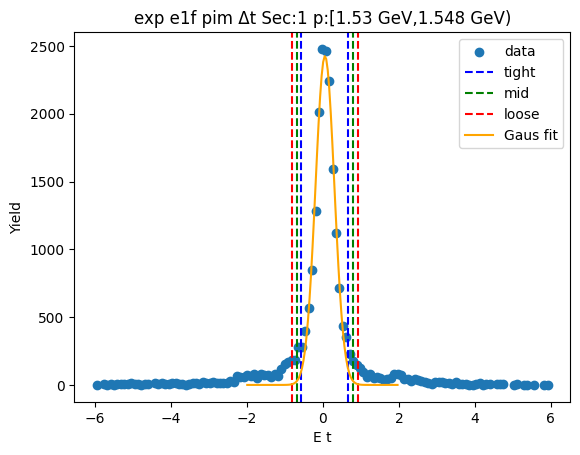

-0.5660056443427992 0.665586069351326
-0.6891648157122118 0.7887452407207386
-0.8123239870816242 0.911904412090151


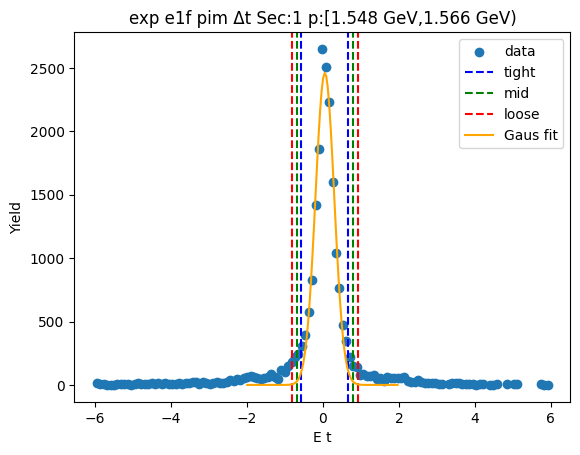

-0.5651145928221376 0.6558274373937579
-0.6872087958437271 0.7779216404153474
-0.8093029988653166 0.900015843436937


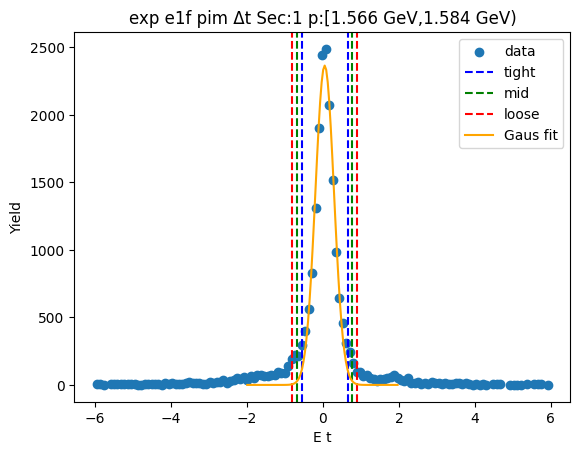

-0.5690110030932032 0.6713162232144976
-0.6930437257239732 0.7953489458452676
-0.8170764483547434 0.9193816684760378


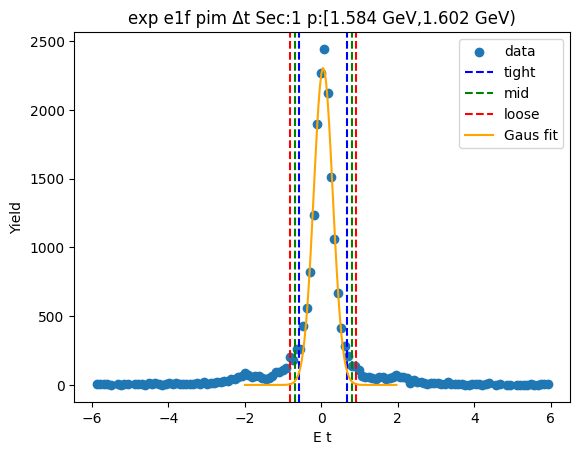

-0.593531990832533 0.6913295720346663
-0.722018147119253 0.8198157283213863
-0.850504303405973 0.9483018846081063


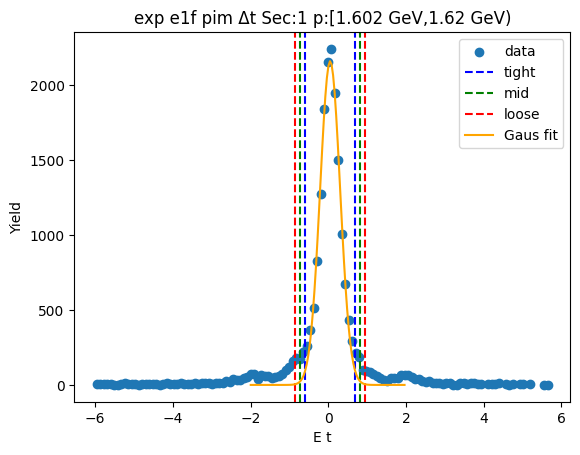

-0.5728542913385022 0.6712532295864431
-0.6972650434309967 0.7956639816789376
-0.8216757955234912 0.9200747337714321


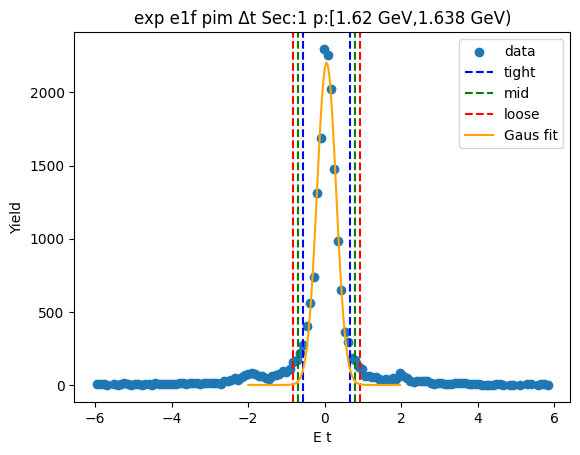

-0.5740707798888026 0.6838839970627649
-0.6998662575839594 0.8096794747579217
-0.8256617352791161 0.9354749524530784


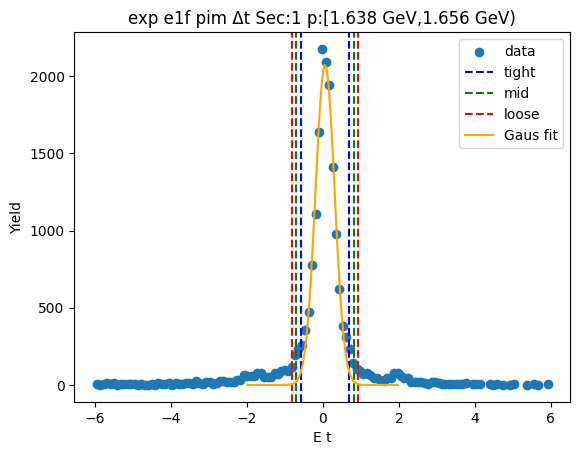

-0.5434325440112253 0.6460601746775649
-0.6623818158801043 0.7650094465464439
-0.7813310877489833 0.8839587184153229


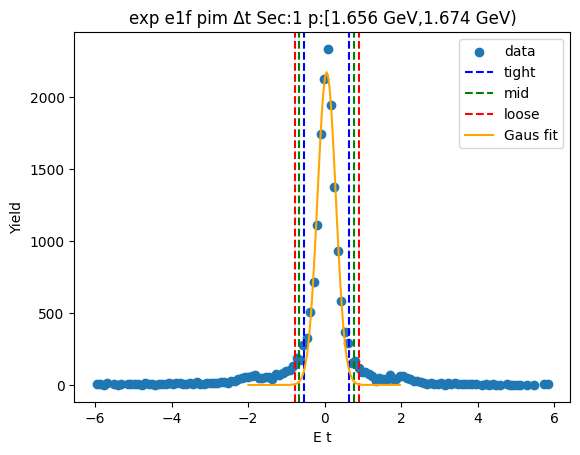

-0.5639650504950868 0.6759714783712312
-0.6879587033817186 0.799965131257863
-0.8119523562683504 0.9239587841444947


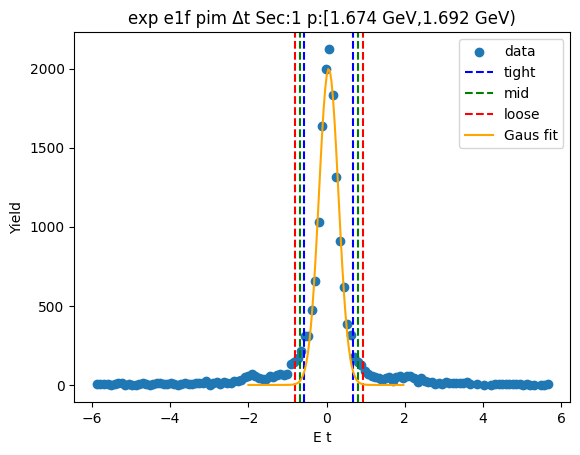

-0.5561598957658149 0.670758580716502
-0.6788517434140466 0.7934504283647337
-0.8015435910622783 0.9161422760129654


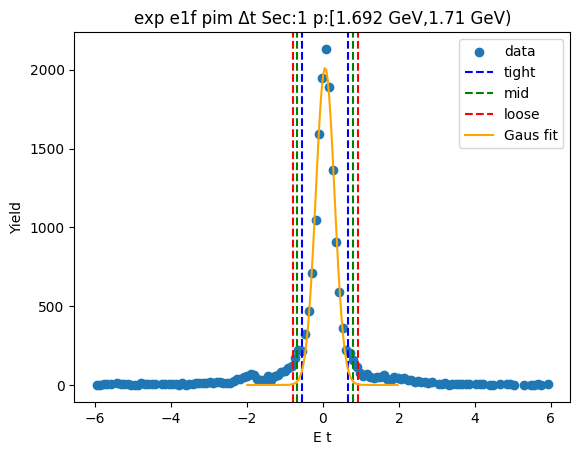

-0.5540328792762005 0.6617515793560323
-0.6756113251394237 0.7833300252192555
-0.797189771002647 0.9049084710824788


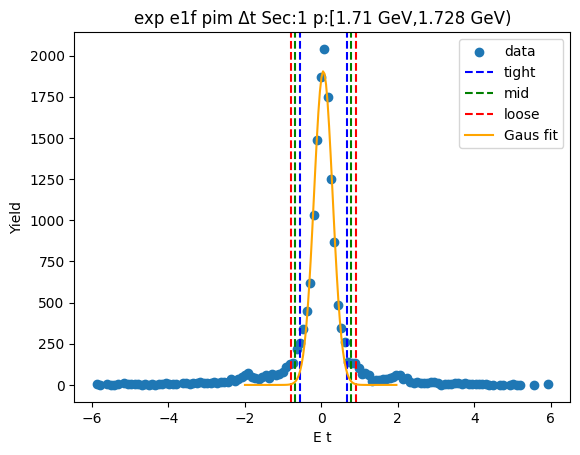

-0.5548354153230287 0.6646814436192573
-0.6767871012172573 0.7866331295134859
-0.7987387871114859 0.9085848154077145


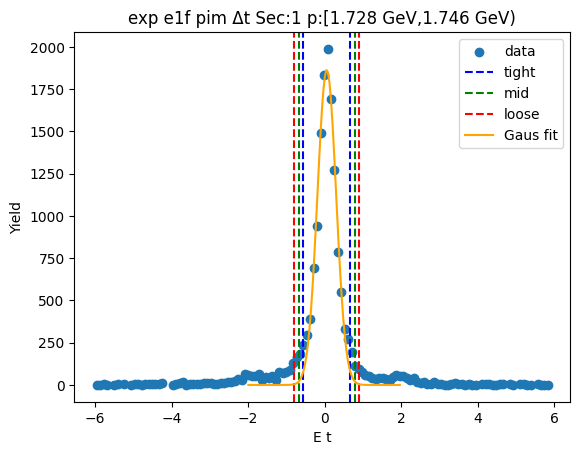

-0.5584215861362865 0.6556421314791445
-0.6798279578978296 0.7770485032406876
-0.8012343296593727 0.8984548750022308


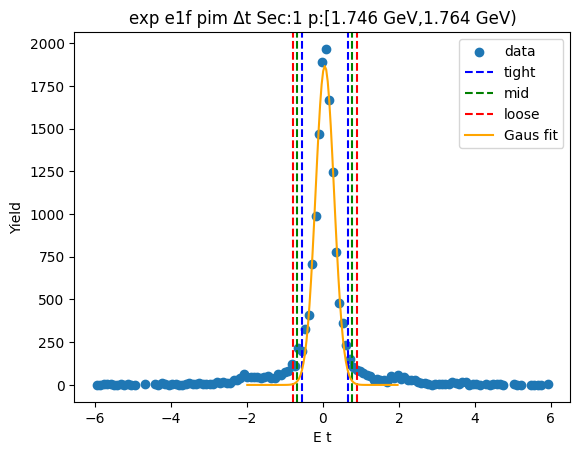

-0.5616989725510274 0.6725411737055312
-0.6851229871766832 0.795965188331187
-0.8085470018023391 0.9193892029568429


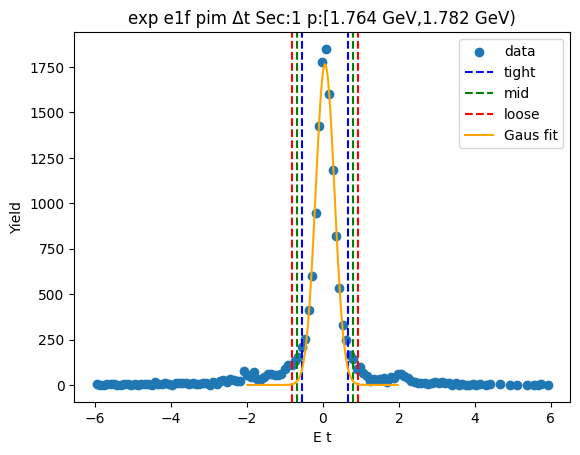

-0.5552260176845553 0.6787972960810754
-0.6786283490611182 0.8021996274576384
-0.8020306804376813 0.9256019588342015


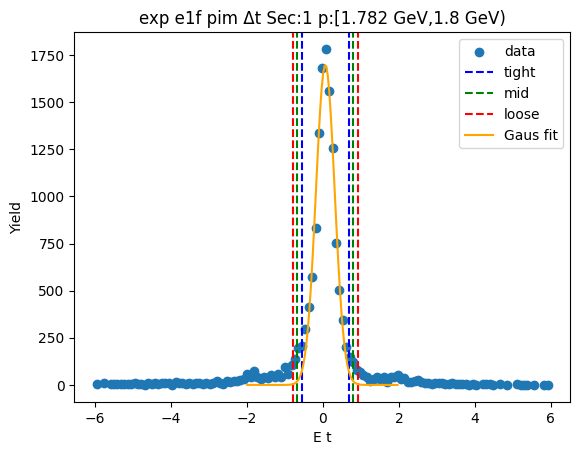

-0.5559496393965934 0.6857879194310167
-0.6801233952793543 0.8099616753137776
-0.8042971511621153 0.9341354311965386


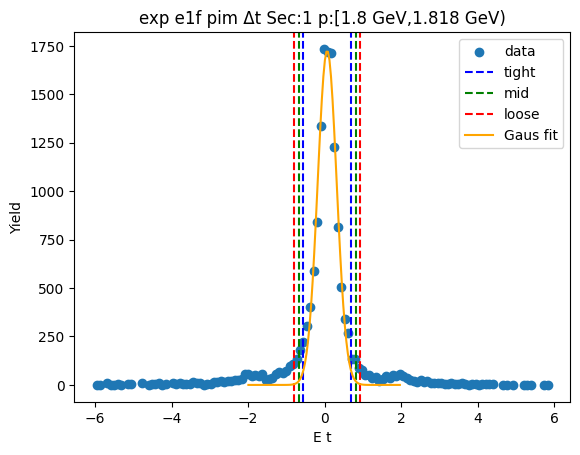

-0.5520993129553858 0.6576311710472865
-0.6730723613556531 0.7786042194475538
-0.7940454097559203 0.899577267847821


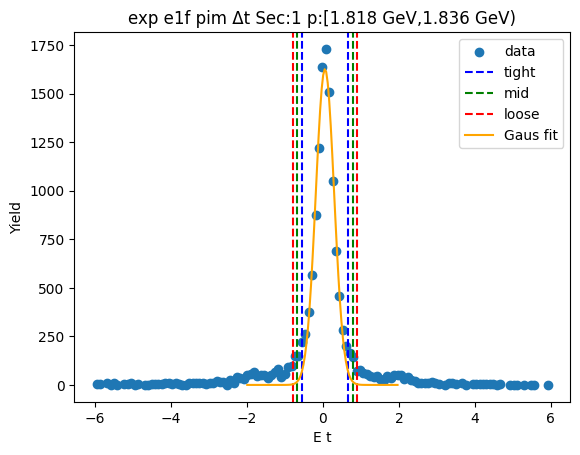

-0.5480233976511776 0.665721589023568
-0.6693978963186521 0.7870960876910426
-0.7907723949861267 0.9084705863585172


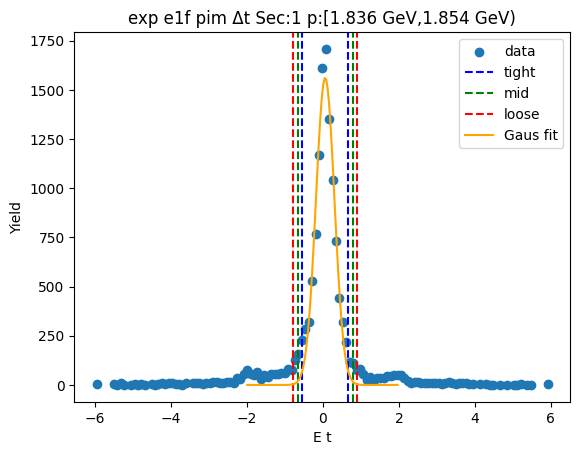

-0.5641740466288379 0.664055938277422
-0.6869970451194638 0.786878936768048
-0.8098200436100899 0.909701935258674


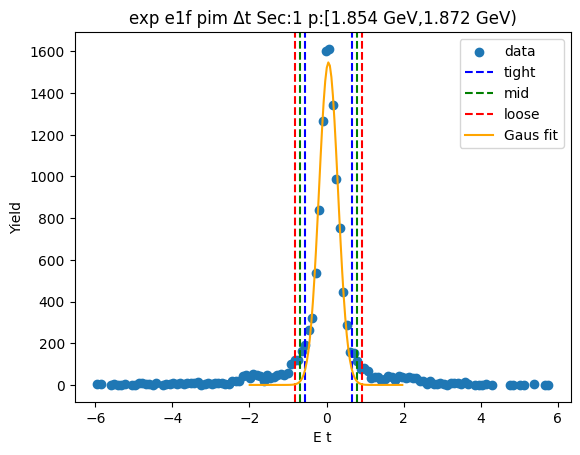

-0.5439816855985362 0.6780264163481764
-0.6661824957932074 0.8002272265428476
-0.7883833059878786 0.922428036737519


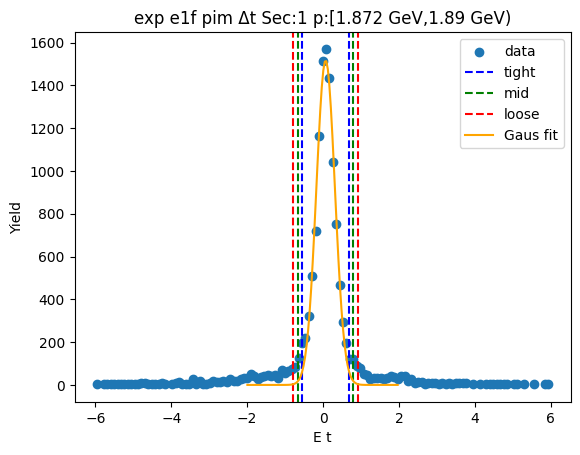

-0.5435281304237988 0.6633662554256811
-0.6642175690087467 0.784055694010629
-0.7849070075936947 0.904745132595577


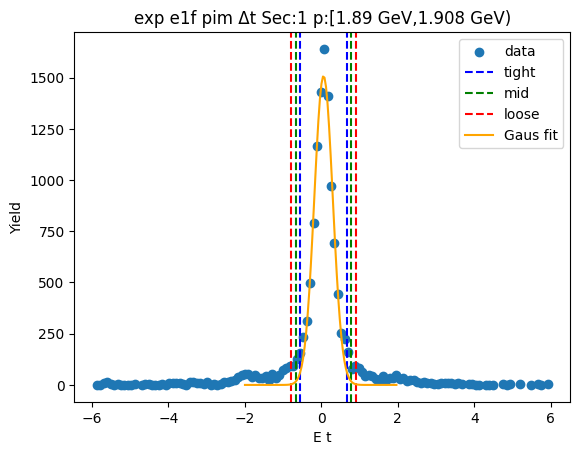

-0.5360889178167938 0.6668282116735844
-0.6563806307658315 0.7871199246226221
-0.7766723437148694 0.90741163757166


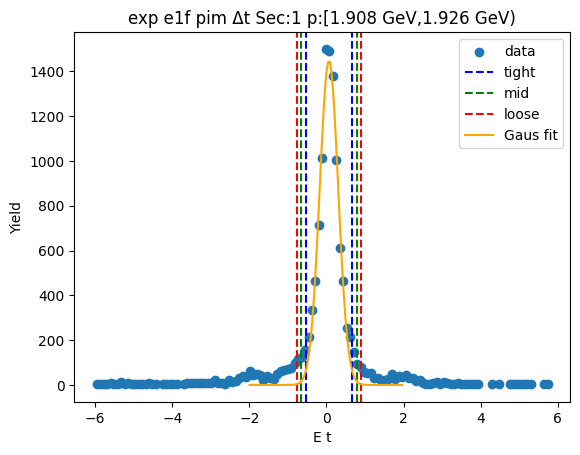

-0.5354809973531625 0.6568121338174766
-0.6547103104702264 0.7760414469345406
-0.7739396235872904 0.8952707600516046


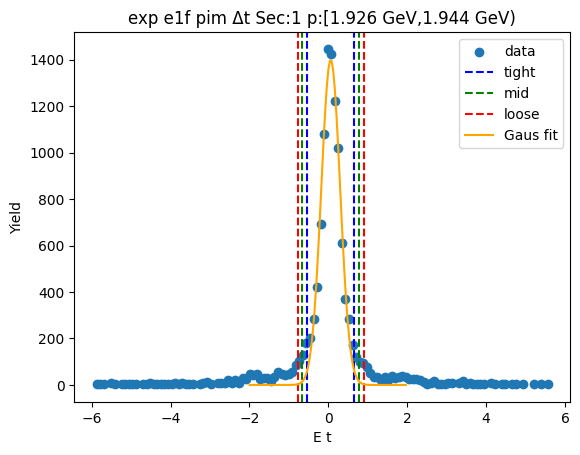

-0.5412577374602452 0.6464332408263234
-0.660026835288902 0.7652023386549802
-0.7787959331175589 0.8839714364836371


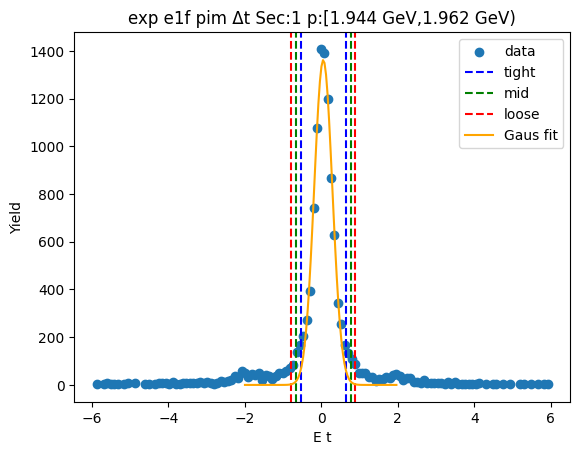

-0.5322193830894695 0.6613476010448633
-0.6515760815029027 0.7807042994582966
-0.7709327799163359 0.9000609978717298


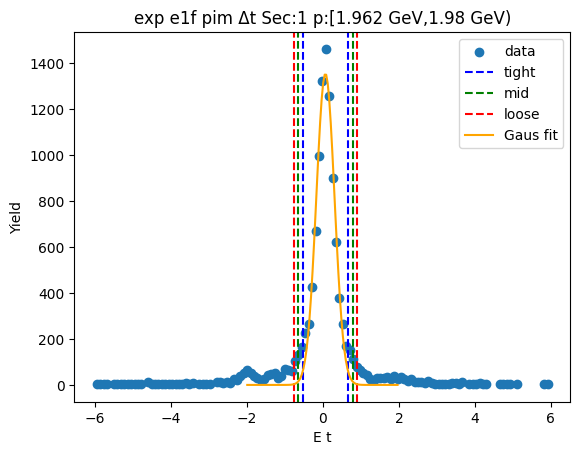

-0.5361974285874065 0.6619190426915911
-0.6560090757153062 0.7817306898194908
-0.775820722843206 0.9015423369473906


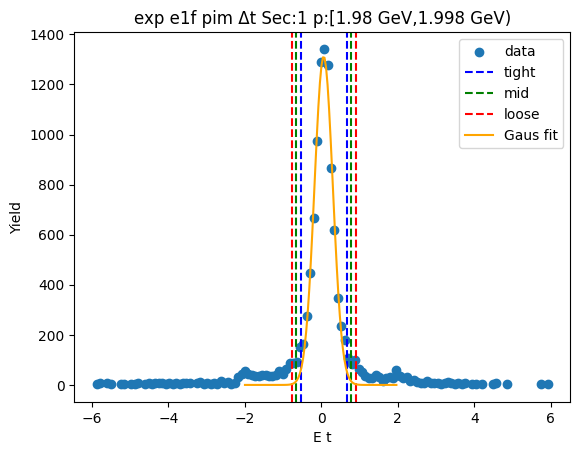

-0.5193249068744503 0.649536703380627
-0.6362110678999581 0.7664228644061347
-0.7530972289254658 0.8833090254316425


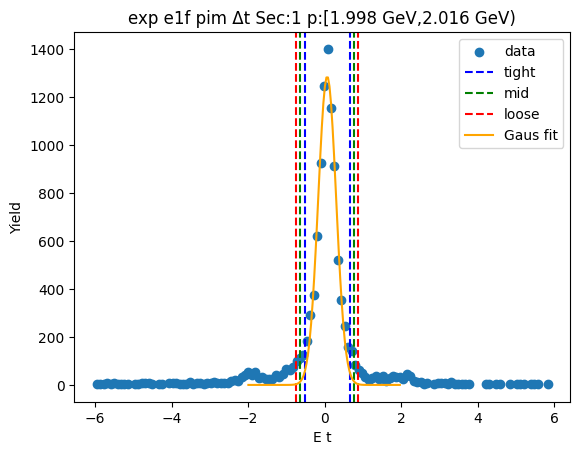

-0.5288273581846774 0.6581358385790057
-0.6475236778610457 0.776832158255374
-0.766219997537414 0.8955284779317423


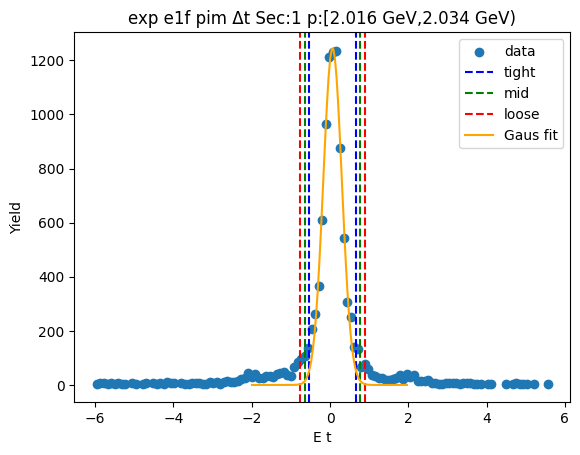

-0.5284779263763874 0.6555193268933054
-0.6468776517033566 0.7739190522202747
-0.765277377030326 0.892318777547244


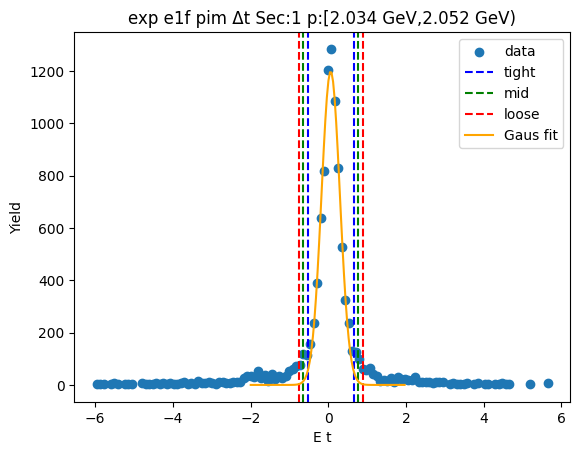

-0.5478726062998467 0.6831762651959987
-0.6709774934494313 0.8062811523455833
-0.7940823805990158 0.9293860394951678


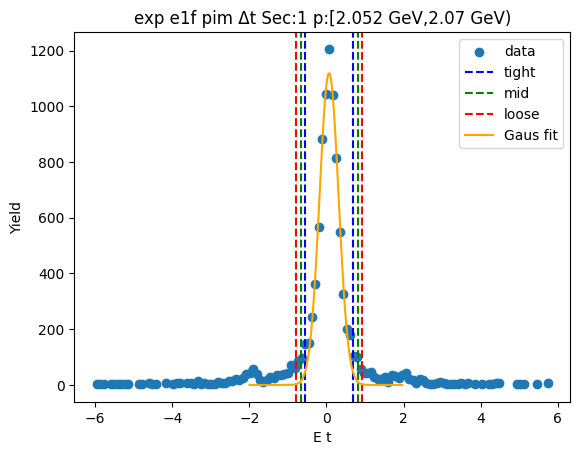

-0.5114525234470899 0.6471919119225609
-0.6273169669840549 0.7630563554595259
-0.7431814105210199 0.8789207989964909


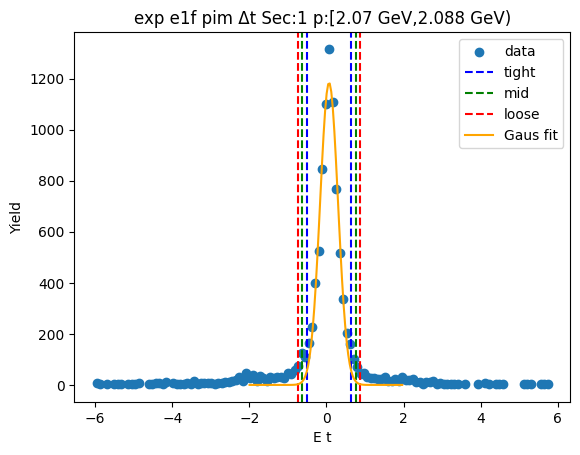

-0.5143999797802752 0.6539133565218469
-0.6312313134104874 0.7707446901520592
-0.7480626470406996 0.8875760237822713


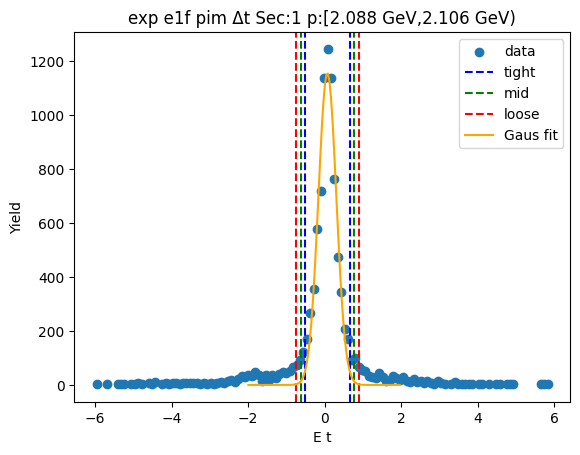

-0.5231207845274137 0.6652865018204444
-0.6419615131621995 0.7841272304552301
-0.7608022417969853 0.9029679590900159


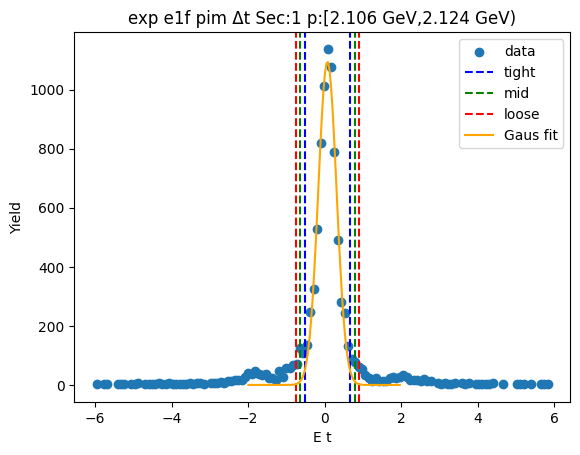

-0.5081224032441455 0.6464448600670388
-0.623579129575264 0.7619015863981573
-0.7390358559063823 0.8773583127292757


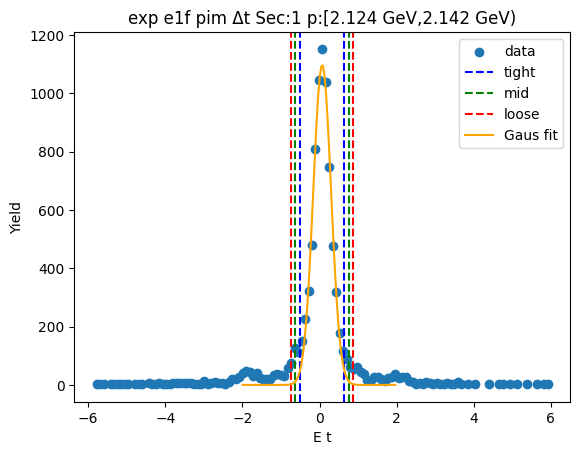

-0.503685227653358 0.640446257214936
-0.6180983761401874 0.7548594057017654
-0.7325115246270167 0.8692725541885947


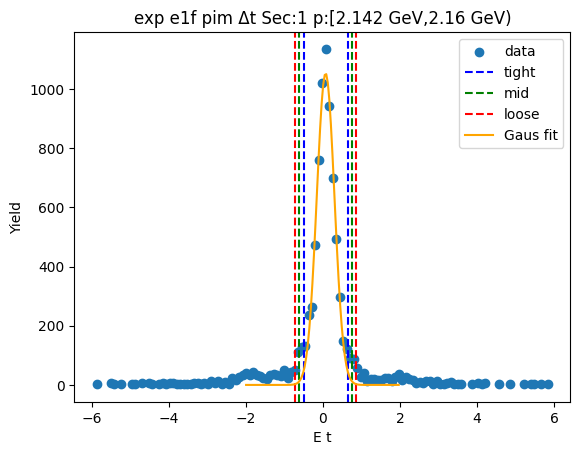

-0.5175445485728272 0.6541948859465623
-0.6347184920247662 0.7713688293985013
-0.7518924354767051 0.88854277285044


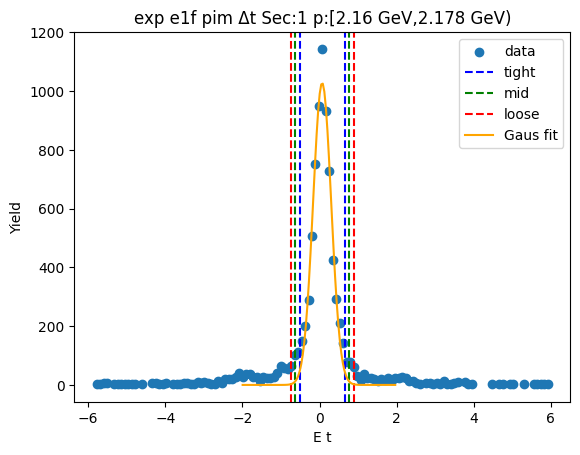

-0.5328509415858296 0.6628455085013762
-0.6524205865945502 0.7824151535100968
-0.7719902316032707 0.9019847985188174


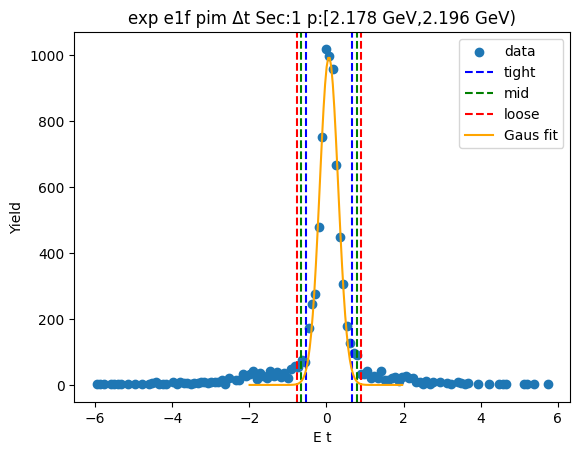

-0.5431712637526788 0.6776931527728215
-0.6652577054052289 0.7997795944253716
-0.7873441470577789 0.9218660360779216


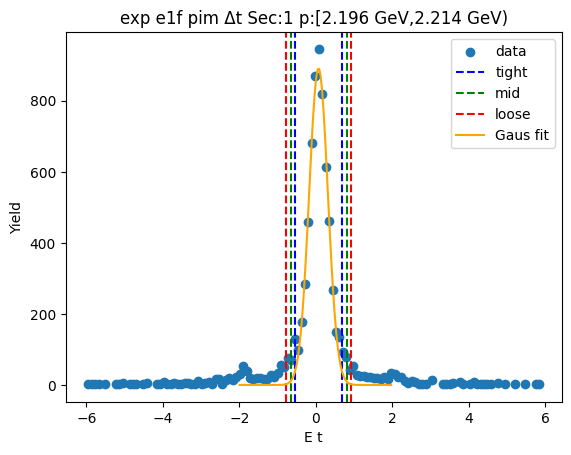

-0.5423161567067865 0.6609602903259064
-0.6626438014100557 0.7812879350291757
-0.782971446113325 0.901615579732445


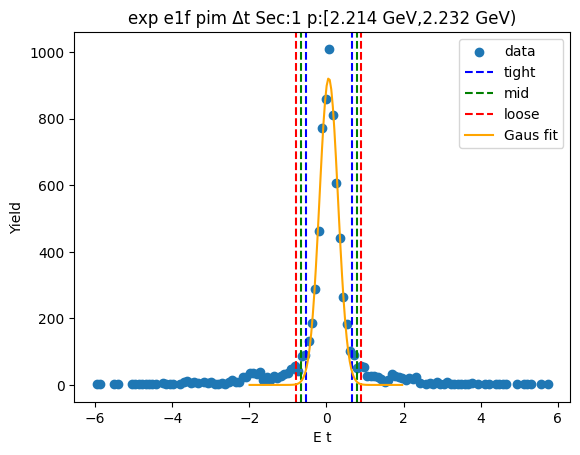

-0.5429860714018198 0.6784845413829872
-0.6651331326803005 0.8006316026614679
-0.7872801939587811 0.9227786639399486


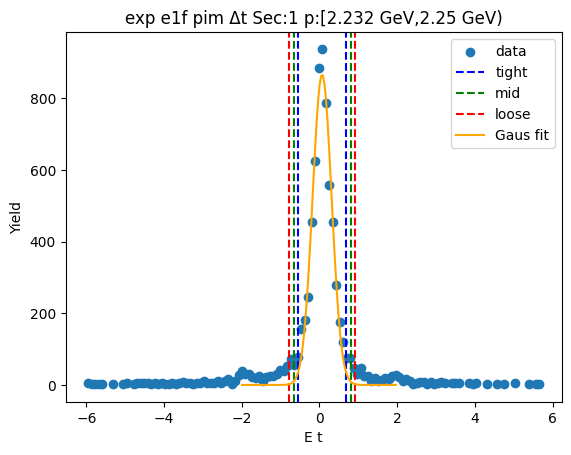

-0.49876751098691396 0.6503681051200007
-0.6136810725976055 0.7652816667306922
-0.728594634208297 0.8801952283413836


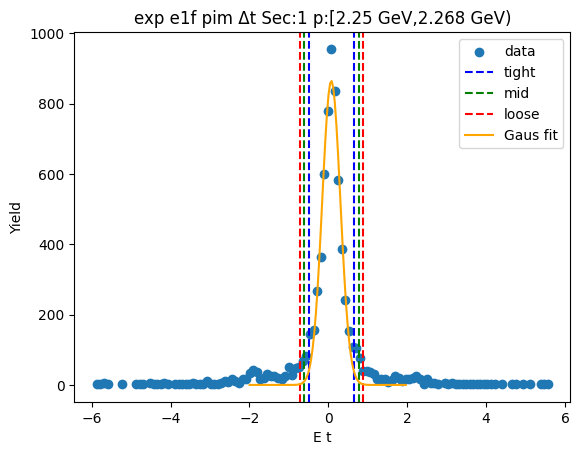

-0.49509991317075036 0.6433214936976035
-0.6089420538575857 0.7571636343844389
-0.7227841945444211 0.8710057750712743


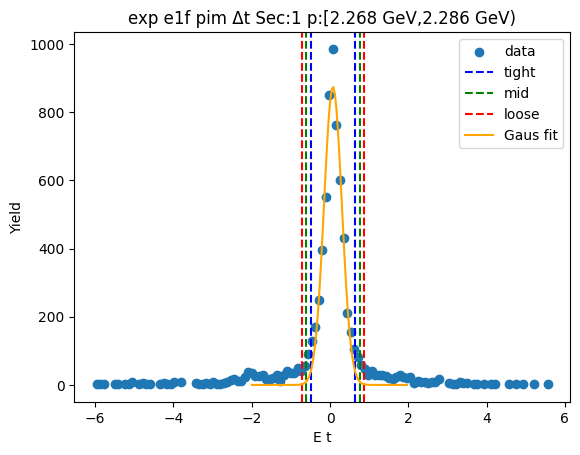

-0.5203712411340735 0.6443577473194961
-0.6368441399794305 0.7608306461648531
-0.7533170388247874 0.87730354501021


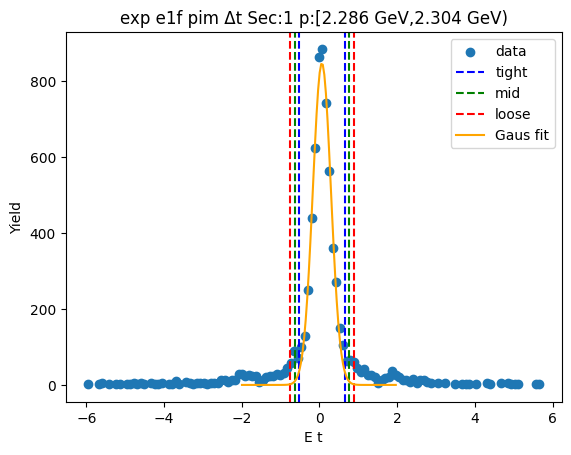

-0.5087423624292189 0.63963304928416
-0.6235799036005568 0.7544705904554979
-0.7384174447718946 0.8693081316268357


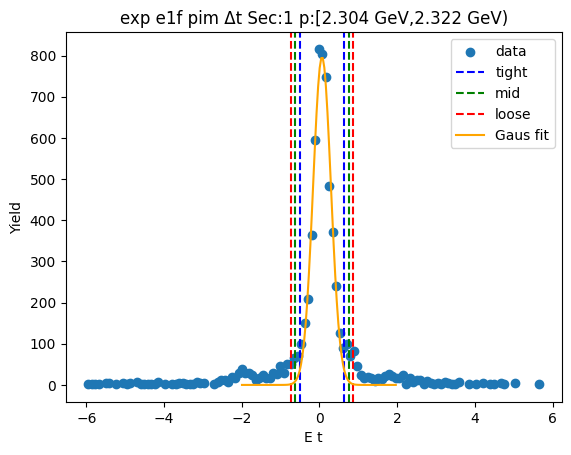

-0.48579060817053094 0.6366760665948283
-0.5980372756470669 0.7489227340713644
-0.710283943123603 0.8611694015479003


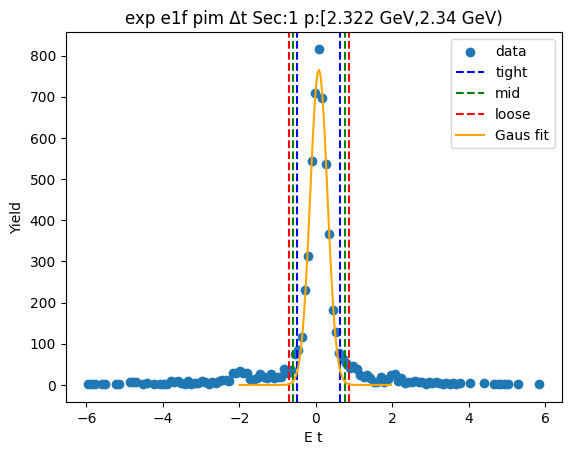

-0.48756952475546267 0.6400785980629103
-0.6003343370372999 0.7528434103447476
-0.7130991493191372 0.8656082226265849


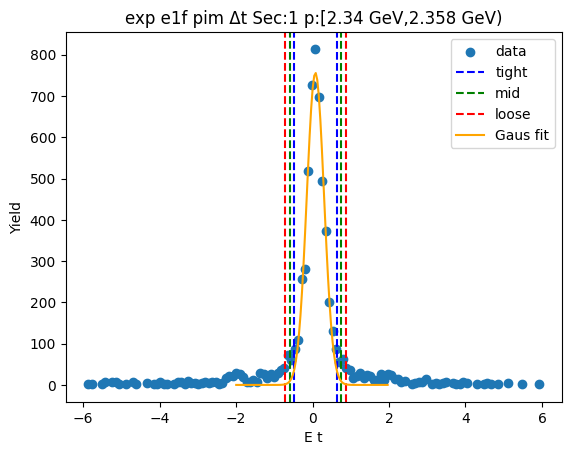

-0.530550420690442 0.6672331759115989
-0.650328780350646 0.7870115355718029
-0.7701071400108501 0.906789895232007


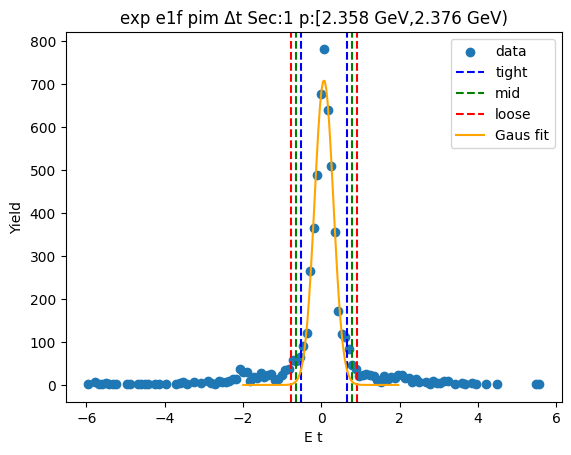

-0.5247208522017063 0.6444805732435811
-0.641640994746235 0.7614007157881099
-0.7585611372907638 0.8783208583326386


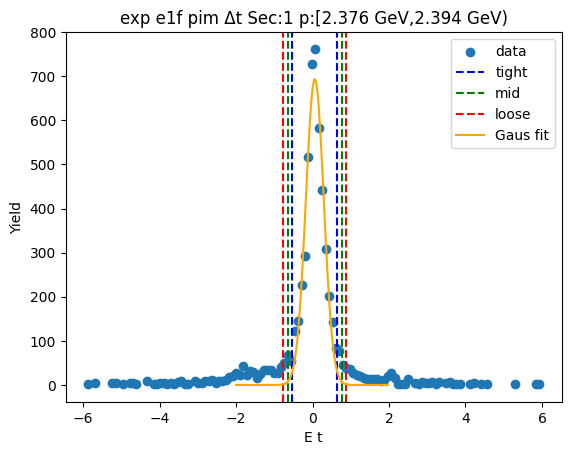

-0.9211911788943514 0.850377276812732
-1.0983480244650599 1.0275341223834404
-1.275504870035768 1.2046909679541487


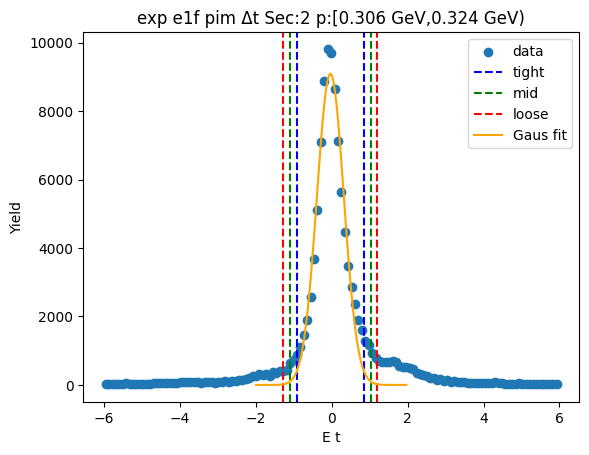

-0.8948566135937474 0.8235688048556596
-1.0666991554386878 0.9954113467006002
-1.2385416972836285 1.167253888545541


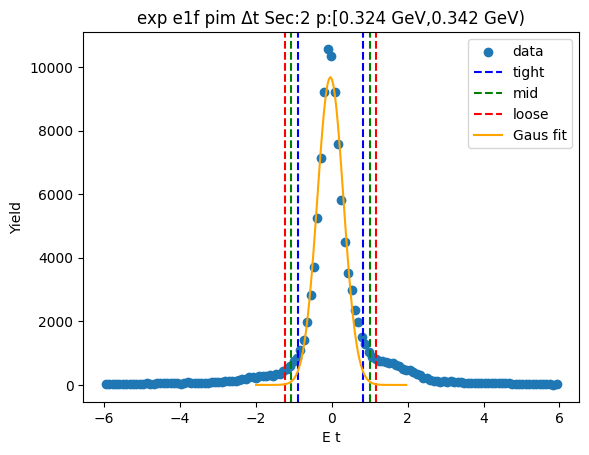

-0.8682378329408713 0.8062780184350637
-1.0356894180784648 0.9737296035726573
-1.2031410032160583 1.1411811887102508


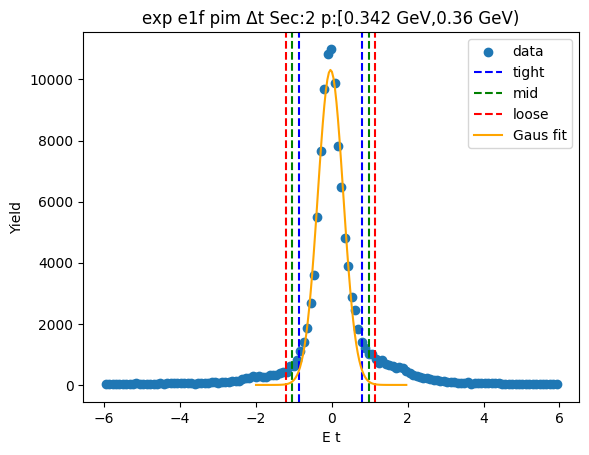

-0.8437236869782843 0.7875695953660187
-1.0068530152127146 0.950698923600449
-1.1699823434471448 1.1138282518348792


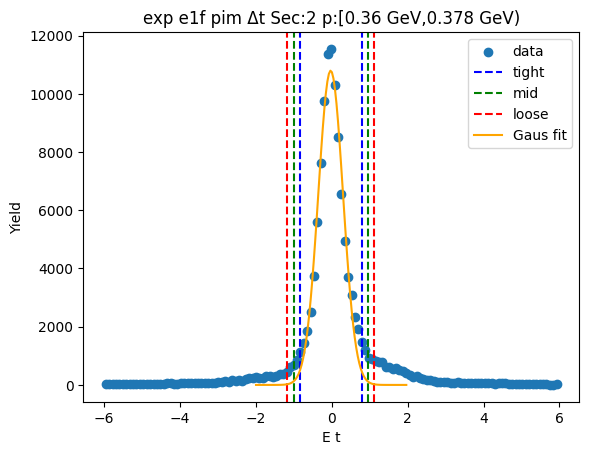

-0.8132653539102861 0.7732235436292183
-0.9719142436642366 0.9318724333831688
-1.130563133418187 1.0905213231371194


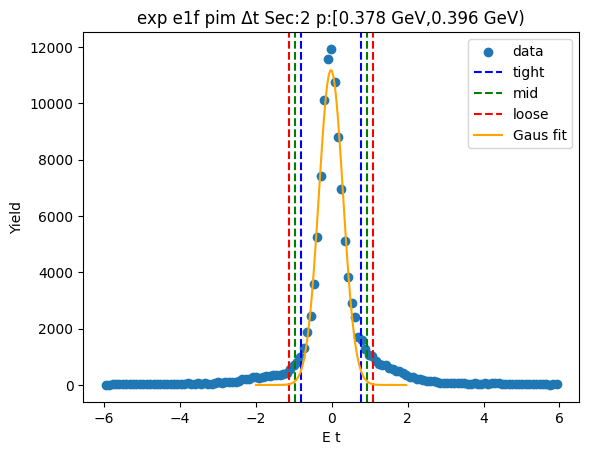

-0.8000024703582183 0.7623435758356316
-0.9562370749776032 0.9185781804550166
-1.1124716795969882 1.0748127850744016


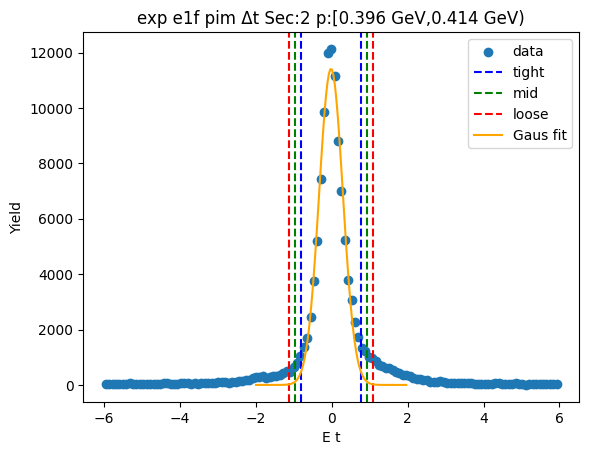

-0.7865816607923279 0.7579753172521257
-0.9410373585967734 0.9124310150565712
-1.0954930564012186 1.0668867128610167


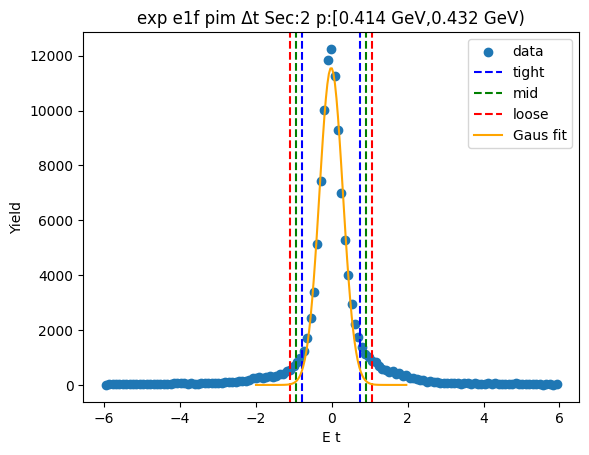

-0.7631393512399003 0.739080934803344
-0.9133613798442247 0.8893029634076685
-1.0635834084485492 1.0395249920119927


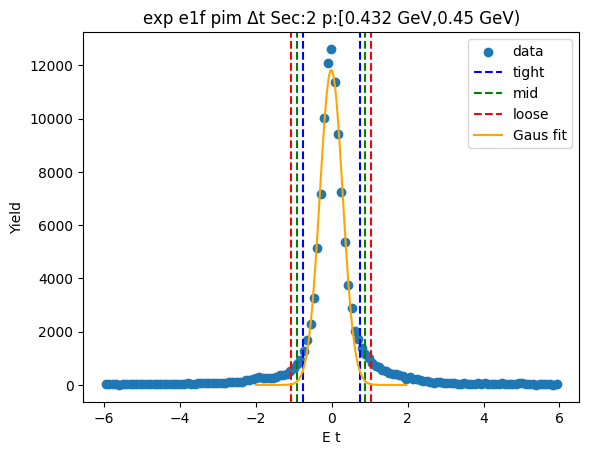

-0.7625301738064146 0.7351030299626219
-0.9122934941833183 0.8848663503395255
-1.0620568145602218 1.034629670716429


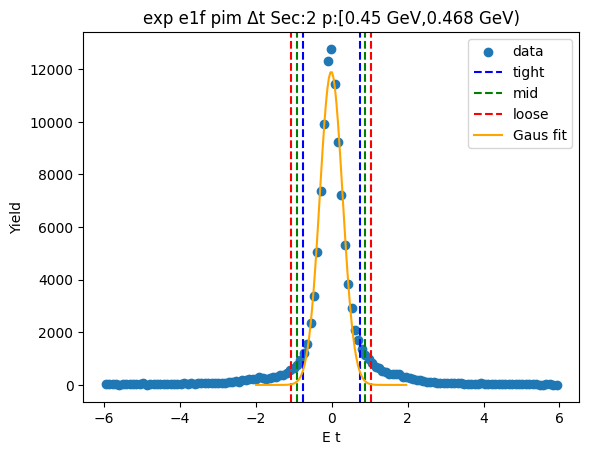

-0.7421662591577067 0.7214156994217873
-0.8885244550156561 0.8677738952797367
-1.0348826508736055 1.014132091137686


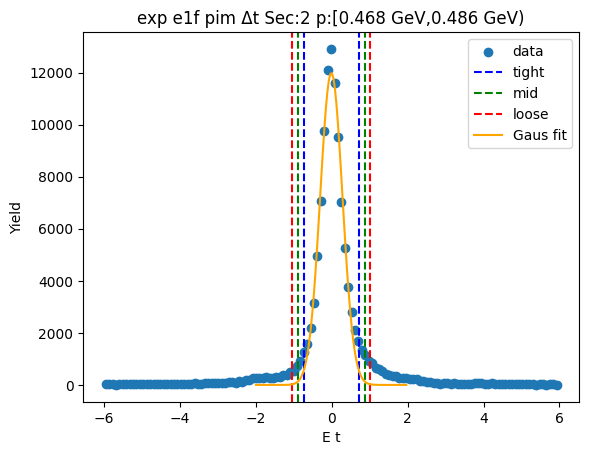

-0.7395381214635315 0.7248210361709091
-0.8859740372269755 0.8712569519343532
-1.0324099529904196 1.0176928676977972


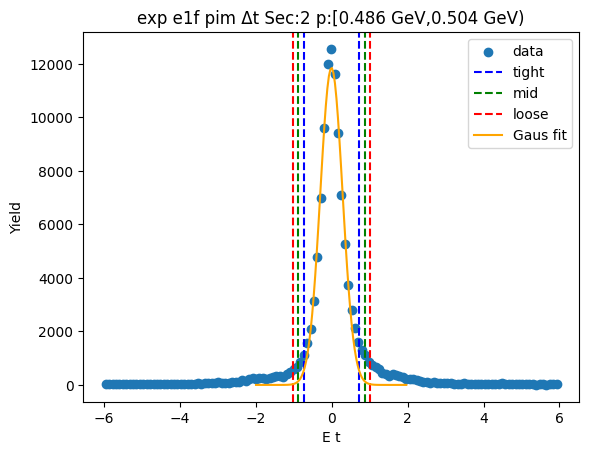

-0.7360875009903686 0.7267722567451004
-0.8823734767639155 0.8730582325186473
-1.0286594525374626 1.0193442082921942


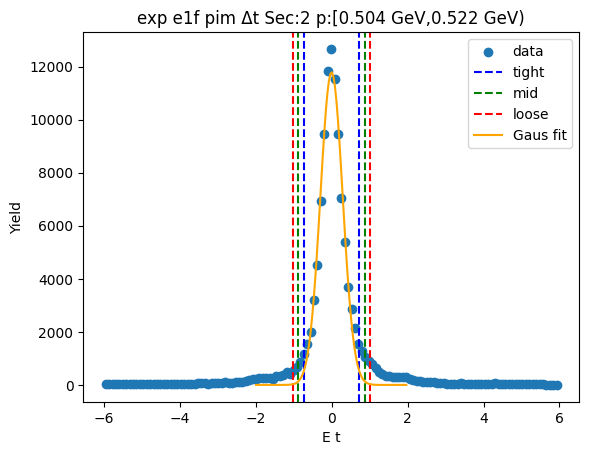

-0.7330632557919249 0.7290541225878487
-0.8792749936299022 0.8752658604258261
-1.0254867314678795 1.0214775982638034


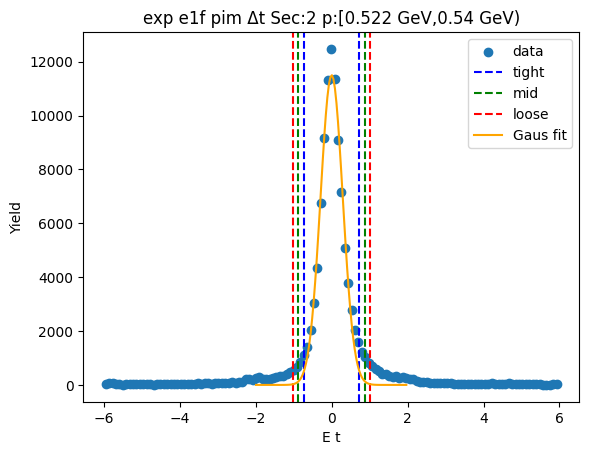

-0.7234888850764793 0.7229182920332766
-0.8681296027874549 0.8675590097442522
-1.0127703204984304 1.0121997274552277


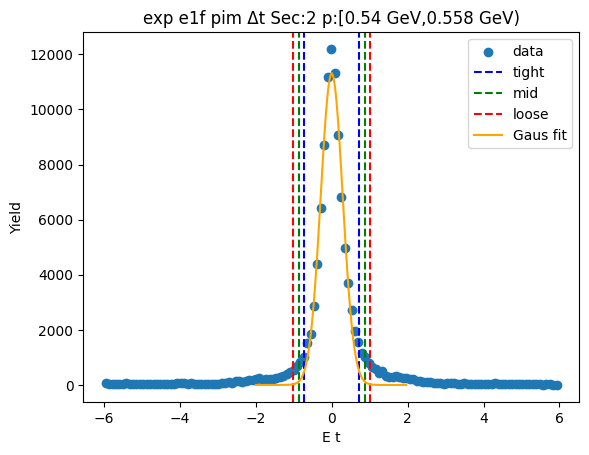

-0.7213506170957478 0.7219041548231846
-0.8656760942876409 0.8662296320150777
-1.0100015714795343 1.0105551092069711


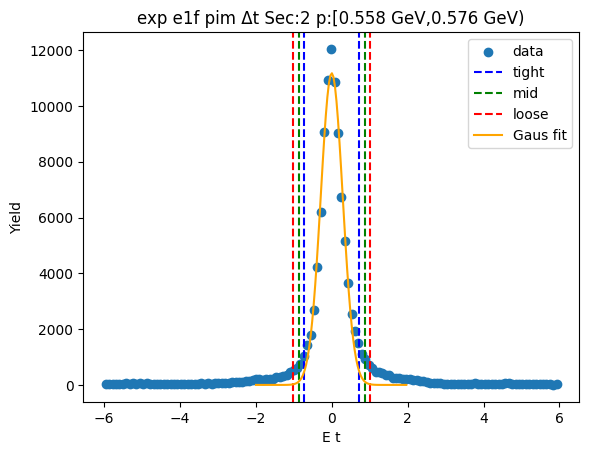

-0.7170962958261032 0.7218586514051554
-0.860991790549229 0.8657541461282812
-1.004887285272355 1.0096496408514068


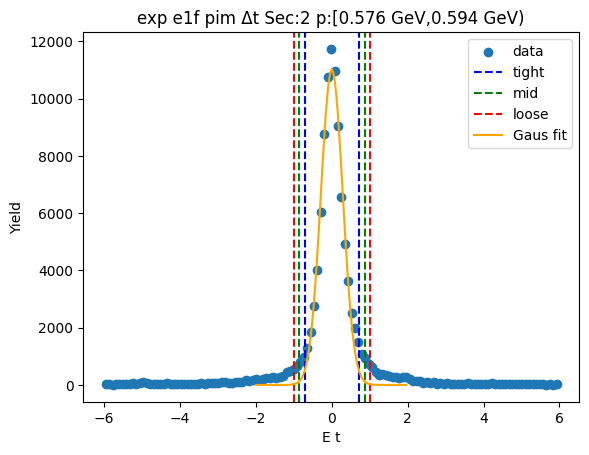

-0.7191372282400457 0.7214395983306725
-0.8631949108971174 0.8654972809877443
-1.0072525935541892 1.009554963644816


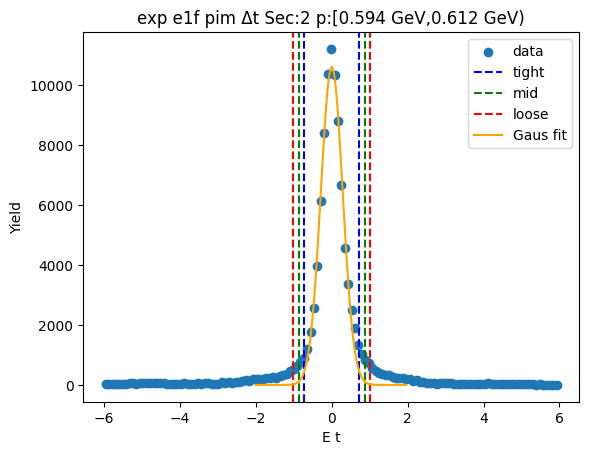

-0.701597386773781 0.7099056149169365
-0.8427476869428528 0.8510559150860083
-0.9838979871119247 0.9922062152550801


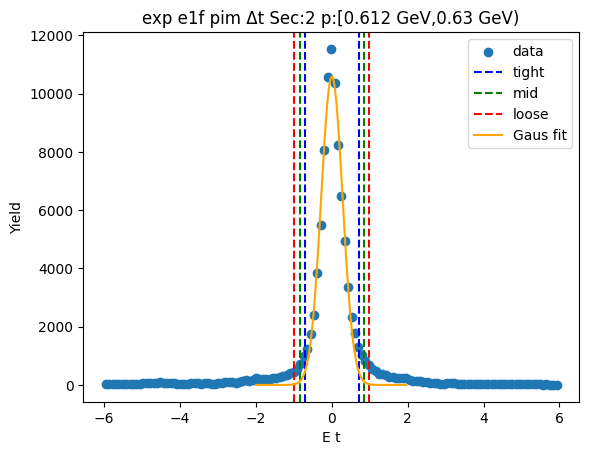

-0.7075256641214154 0.7167638277877766
-0.8499546133123346 0.8591927769786958
-0.9923835625032538 1.001621726169615


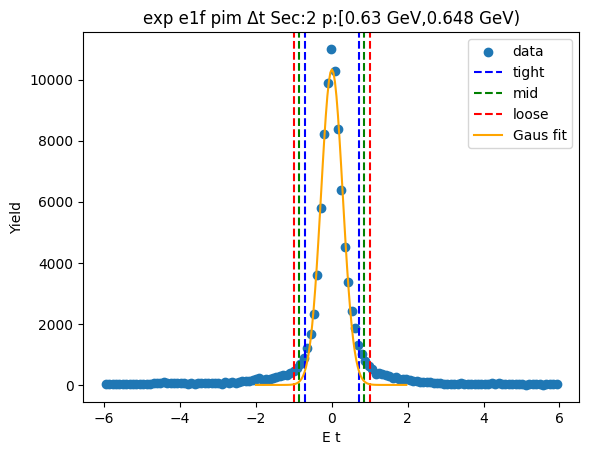

-0.7047197330488841 0.7152774429820783
-0.8467194506519803 0.8572771605851744
-0.9887191682550766 0.9992768781882707


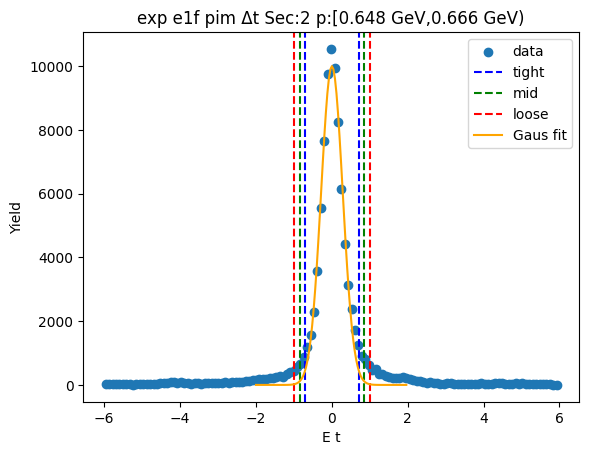

-0.6939760860054184 0.7020890463721609
-0.8335825992431762 0.8416955596099187
-0.9731891124809341 0.9813020728476766


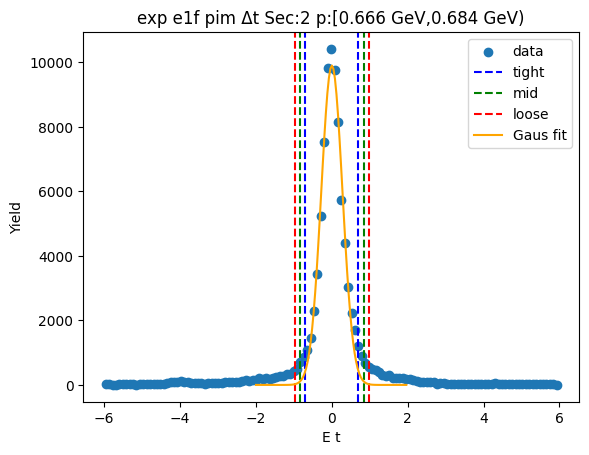

-0.7010424983755141 0.7113936470654474
-0.8422861129196102 0.8526372616095435
-0.9835297274637064 0.9938808761536396


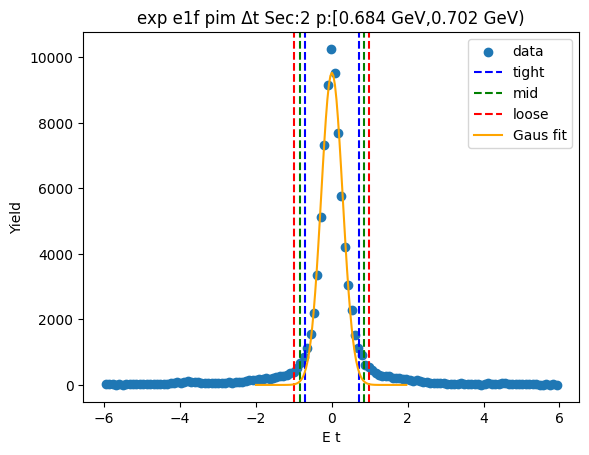

-0.6989710495740427 0.7139085362163704
-0.840259008153084 0.8551964947954117
-0.9815469667321253 0.996484453374453


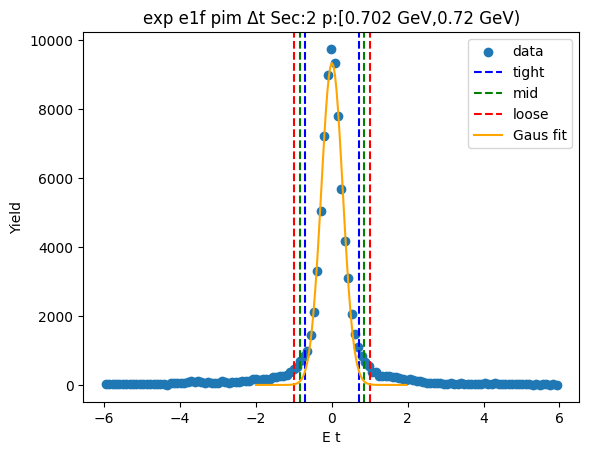

-0.6892958091548362 0.700872627770416
-0.8283126528473616 0.8398894714629414
-0.9673294965398868 0.9789063151554666


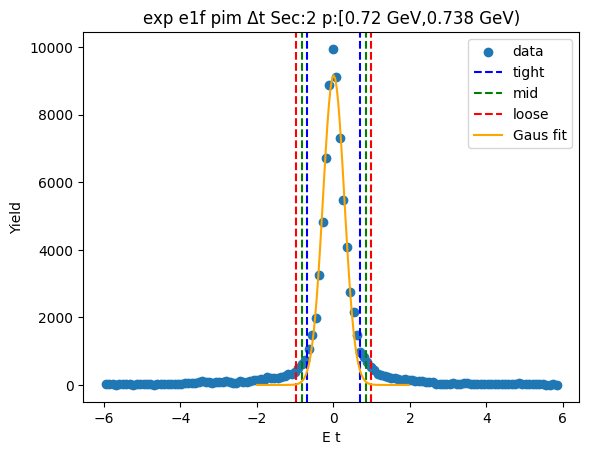

-0.6921107370531666 0.7010637680706159
-0.8314281875655449 0.8403812185829942
-0.9707456380779232 0.9796986690953725


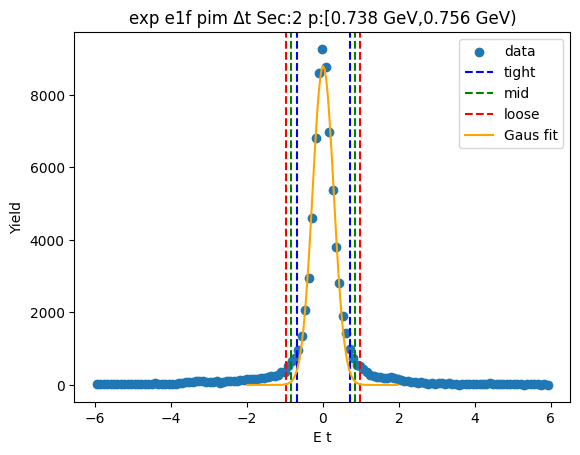

-0.6936816208367226 0.7082669737984438
-0.8338764803002393 0.8484618332619606
-0.9740713397637559 0.9886566927254772


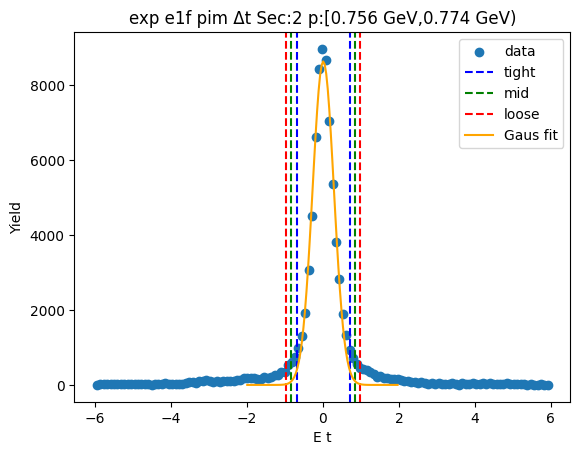

-0.6894379750411417 0.6987738808821986
-0.8282591606334757 0.8375950664745326
-0.9670803462258097 0.9764162520668667


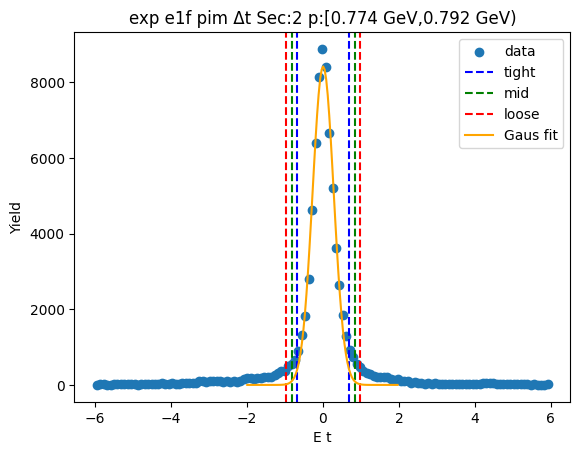

-0.7029498193734495 0.7160542456366689
-0.8448502258744612 0.8579546521376806
-0.986750632375473 0.9998550586386924


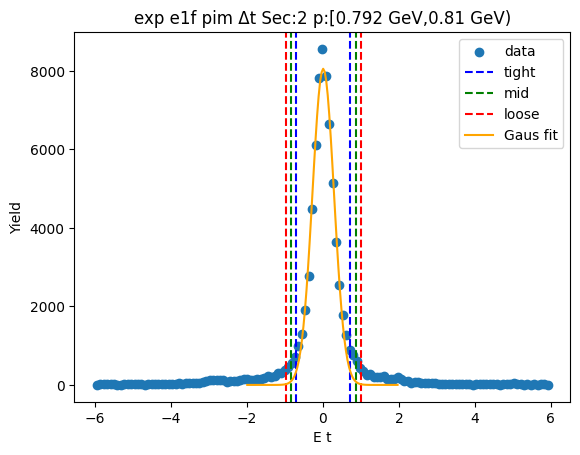

-0.6953773107314646 0.7095612139213917
-0.8358711631967501 0.8500550663866773
-0.9763650156620357 0.9905489188519628


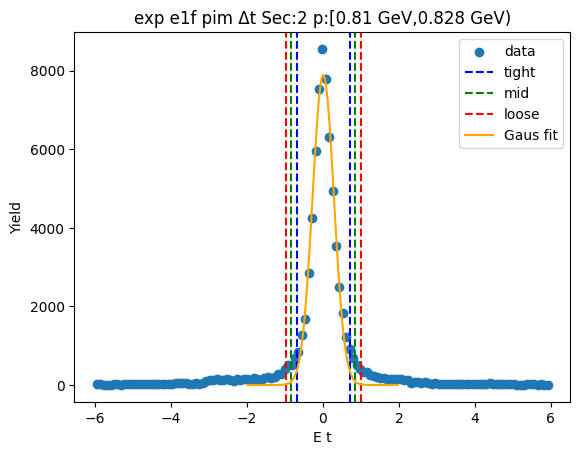

-0.6921659567780788 0.6973072496273752
-0.8311132774186243 0.8362545702679207
-0.9700605980591697 0.9752018909084661


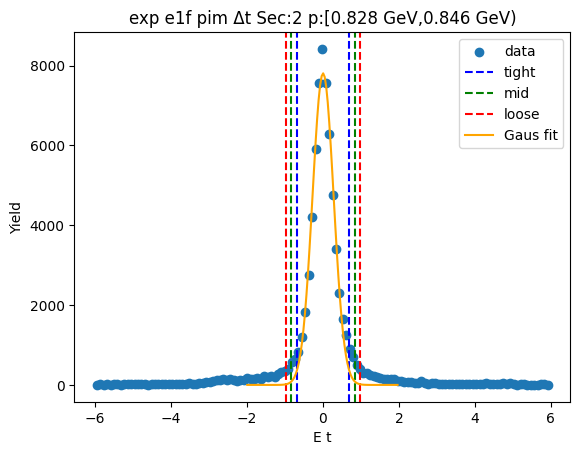

-0.6905763459719357 0.6968391185071402
-0.8293178924198433 0.8355806649550478
-0.9680594388677509 0.9743222114029554


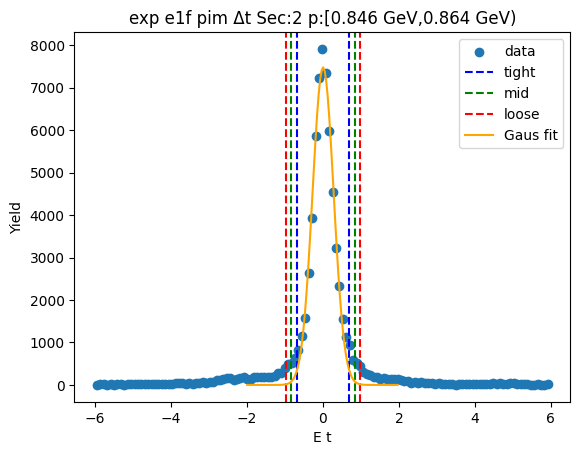

-0.6780720563586802 0.6969285852611324
-0.8155721205206615 0.8344286494231138
-0.9530721846826428 0.971928713585095


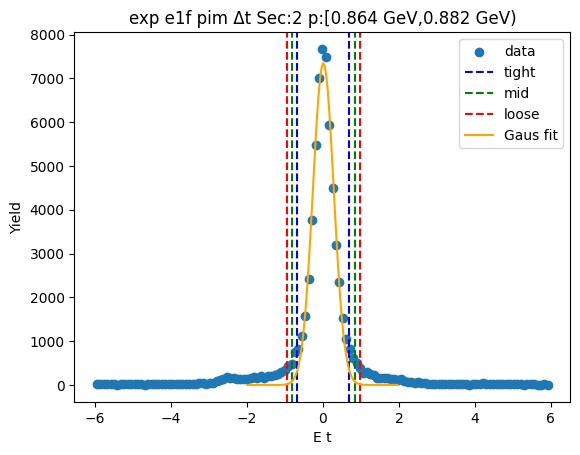

-0.686476516300655 0.6982531328862516
-0.8249494812193456 0.8367260978049422
-0.9634224461380363 0.9751990627236329


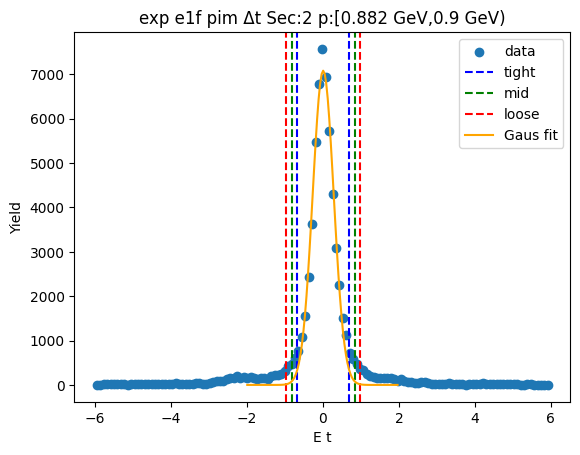

-0.676916144193277 0.6841524605377332
-0.8130230046663779 0.8202593210108341
-0.9491298651394788 0.956366181483935


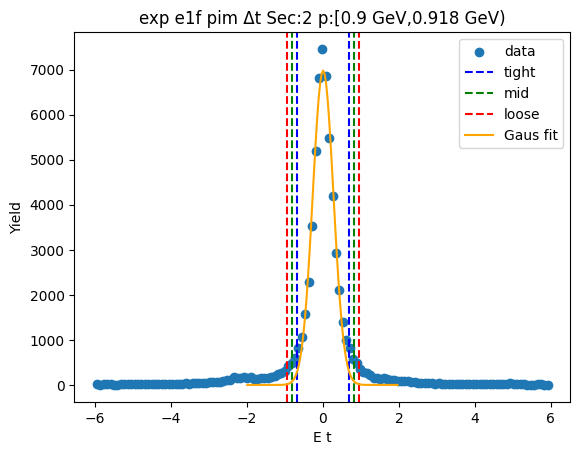

-0.6923876097574848 0.709606329257821
-0.8325870036590154 0.8498057231593515
-0.972786397560546 0.9900051170608821


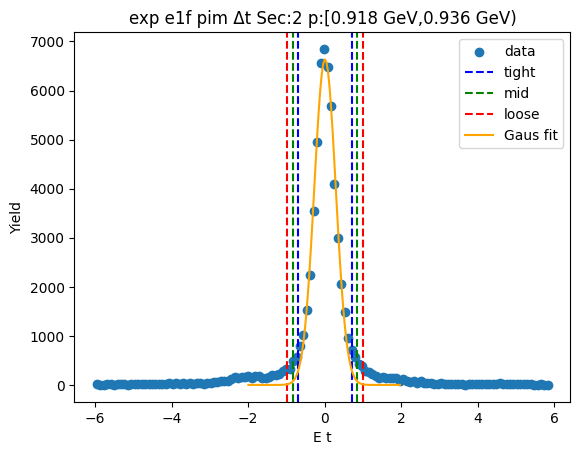

-0.6747552579101445 0.68461856876086
-0.810692640577245 0.8205559514279606
-0.9466300232443454 0.956493334095061


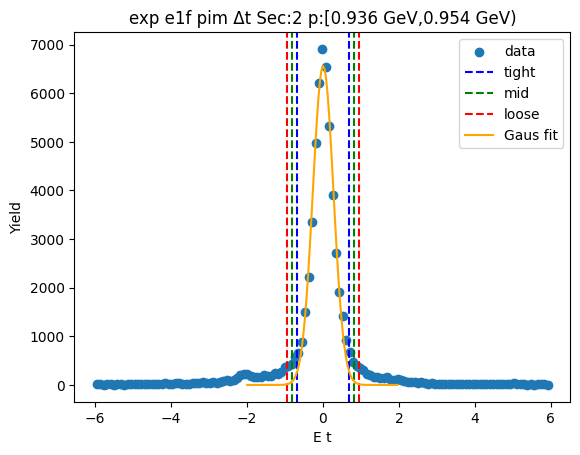

-0.675026265713383 0.6973953093252077
-0.8122684232172421 0.8346374668290668
-0.9495105807211012 0.9718796243329259


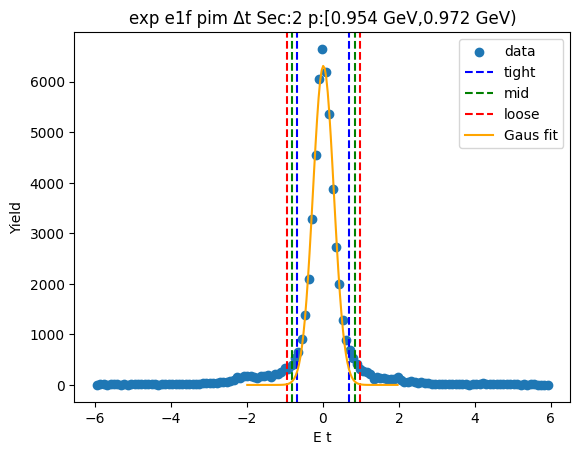

-0.6758727123222307 0.6933366710684844
-0.8127936506613023 0.830257609407556
-0.9497145890003738 0.9671785477466275


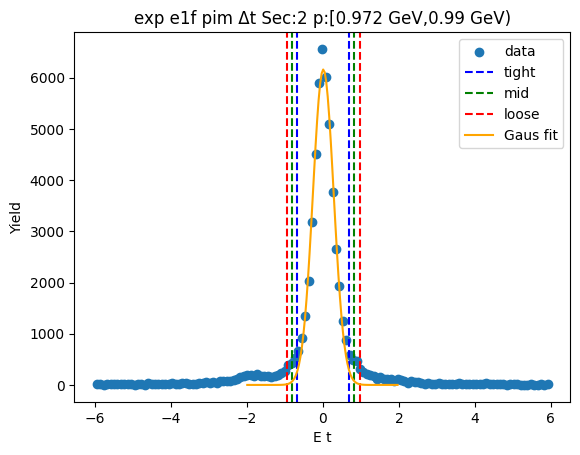

-0.6680136129791178 0.6821103497243354
-0.803026009249463 0.8171227459946806
-0.9380384055198083 0.9521351422650259


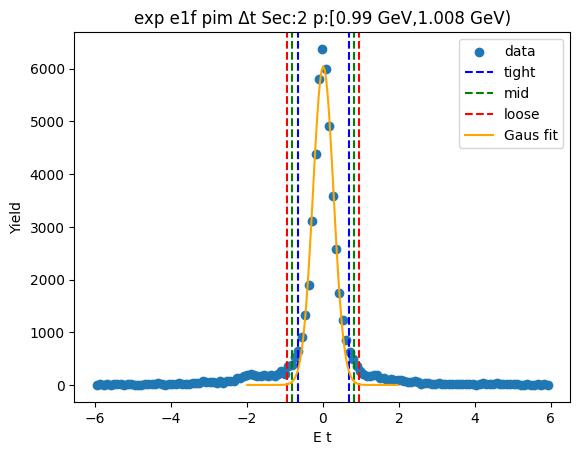

-0.6653302916177848 0.6792224072219486
-0.7997855615017581 0.8136776771059219
-0.9342408313857313 0.9481329469898951


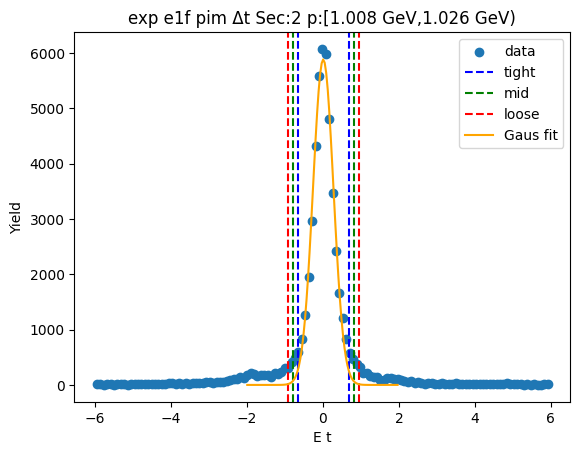

-0.6794755746301844 0.6929771054461993
-0.8167208426378227 0.8302223734538376
-0.9539661106454611 0.967467641461476


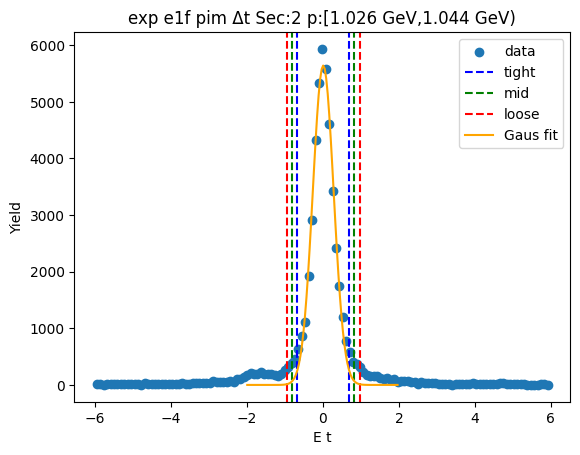

-0.6827675643166559 0.6974359025605307
-0.8207879110043744 0.8354562492482492
-0.9588082576920931 0.9734765959359679


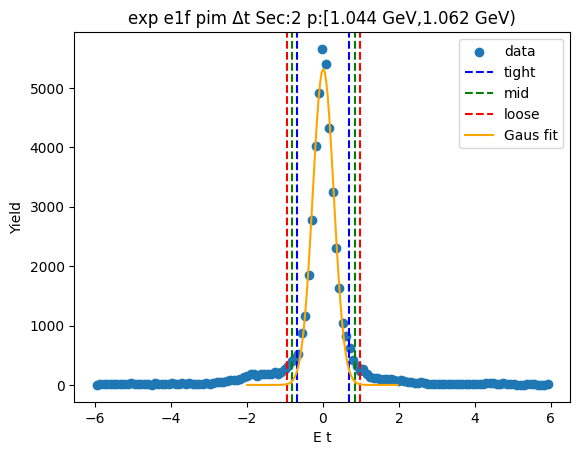

-0.6657424424659917 0.6856803481352056
-0.8008847215261113 0.8208226271953253
-0.936027000586231 0.955964906255445


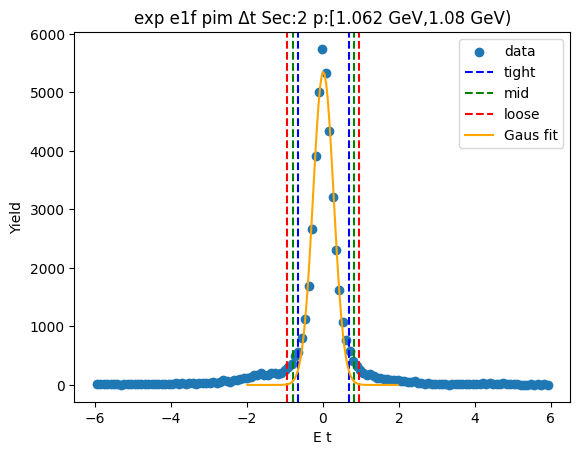

-0.6731567270480278 0.6878451626788386
-0.8092569160207145 0.8239453516515253
-0.9453571049934011 0.9600455406242119


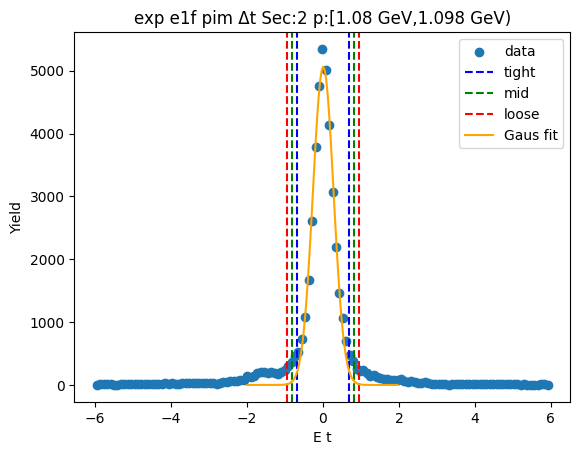

-0.6707458091221701 0.685631321503126
-0.8063835221846998 0.8212690345656557
-0.9420212352472294 0.9569067476281853


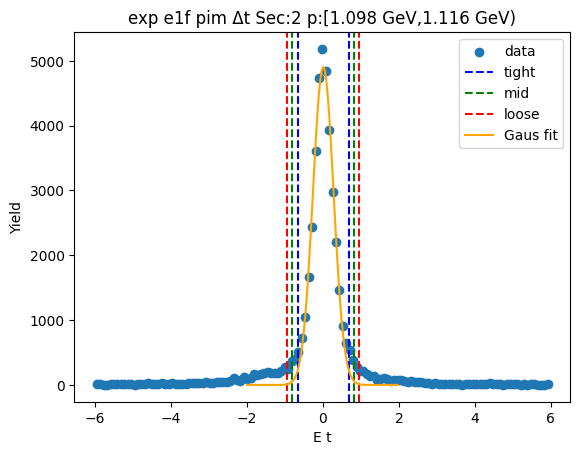

-0.6683762816234964 0.6944628494077374
-0.8046601947266198 0.8307467625108608
-0.9409441078297431 0.9670306756139841


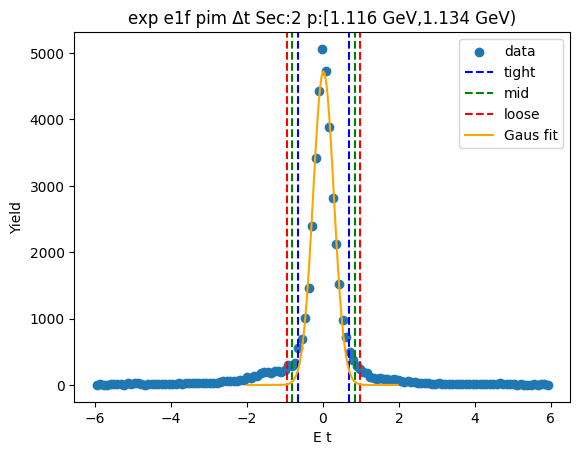

-0.6625493097092564 0.6817303093676074
-0.7969772716169429 0.8161582712752938
-0.9314052335246292 0.9505862331829802


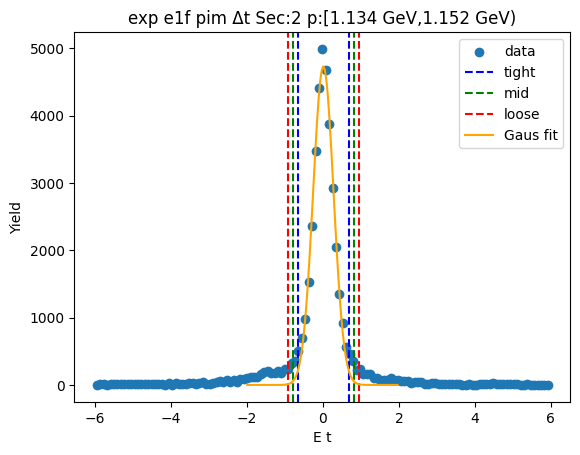

-0.6590811215163646 0.6757909038137557
-0.7925683240493765 0.8092781063467677
-0.9260555265823885 0.9427653088797797


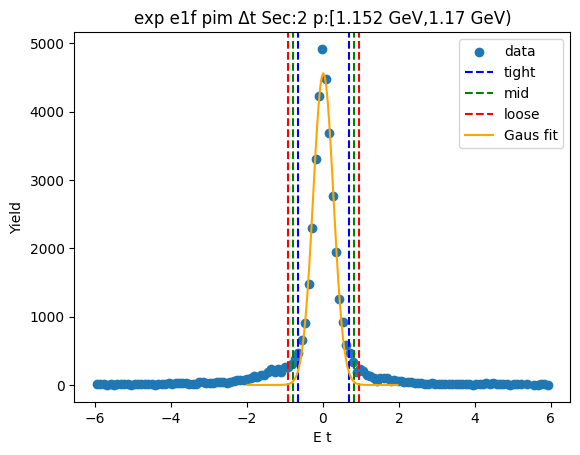

-0.6582855358236327 0.6745598553746547
-0.7915700749434614 0.8078443944944834
-0.9248546140632902 0.9411289336143122


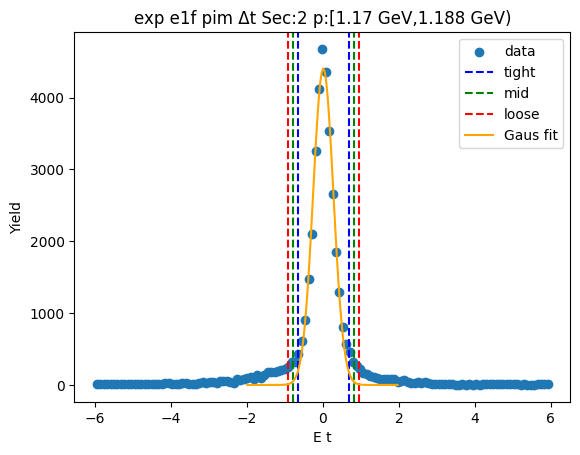

-0.6570954321541801 0.6761910651017057
-0.7904240818797688 0.8095197148272943
-0.9237527316053573 0.9428483645528829


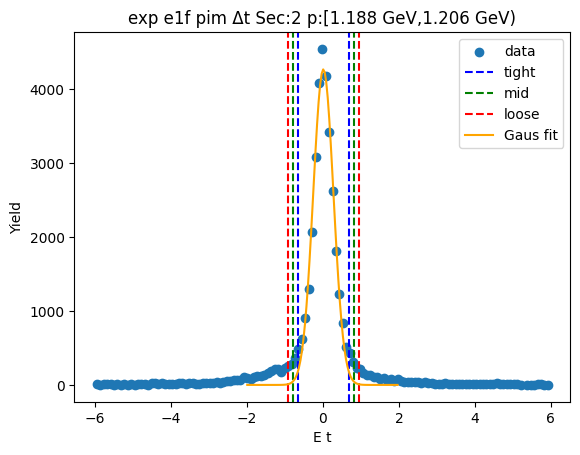

-0.6456191366834118 0.6583216581909451
-0.7760132161708475 0.7887157376783809
-0.9064072956582833 0.9191098171658166


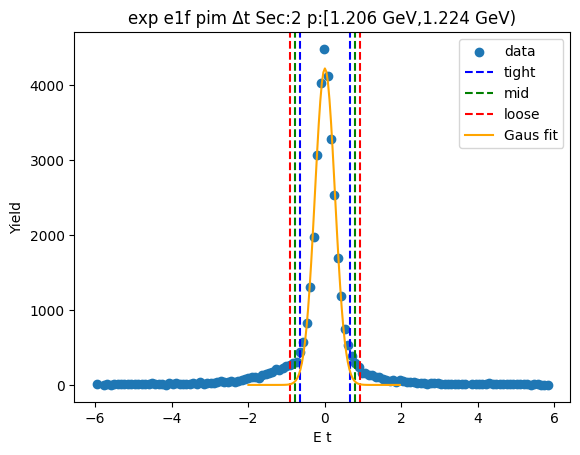

-0.66531487502353 0.6759905785138454
-0.7994454203772675 0.8101211238675828
-0.933575965731005 0.9442516692213203


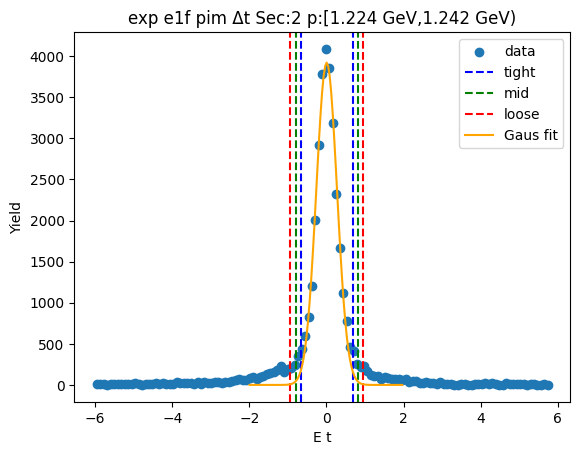

-0.6570256014996579 0.6754914405477598
-0.7902773057043998 0.8087431447525016
-0.9235290099091416 0.9419948489572434


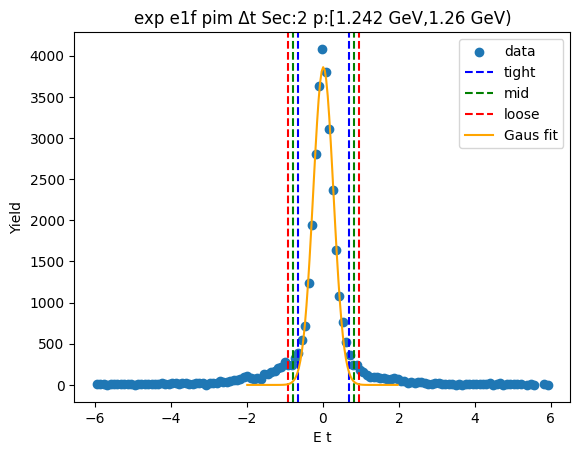

-0.6762825827387899 0.6962313658677763
-0.8135339775994466 0.833482760728433
-0.9507853724601032 0.9707341555890896


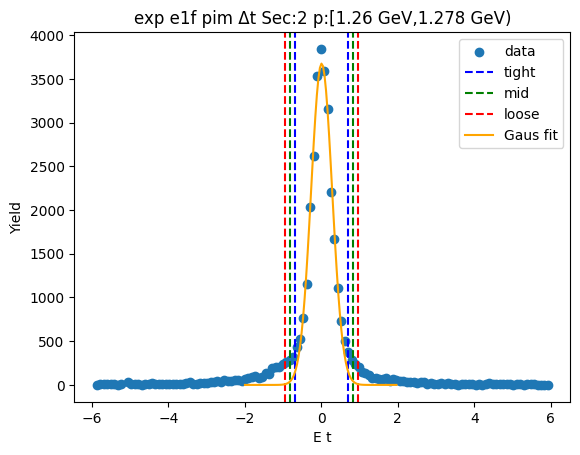

-0.6371276442019843 0.6558041618738811
-0.7664208248095709 0.7850973424814677
-0.8957140054171574 0.9143905230890542


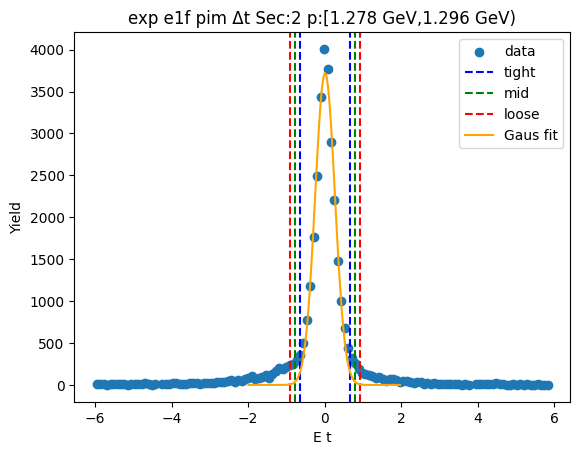

-0.6590592459260892 0.6792326719231444
-0.7928884377110126 0.8130618637080678
-0.926717629495936 0.9468910554929911


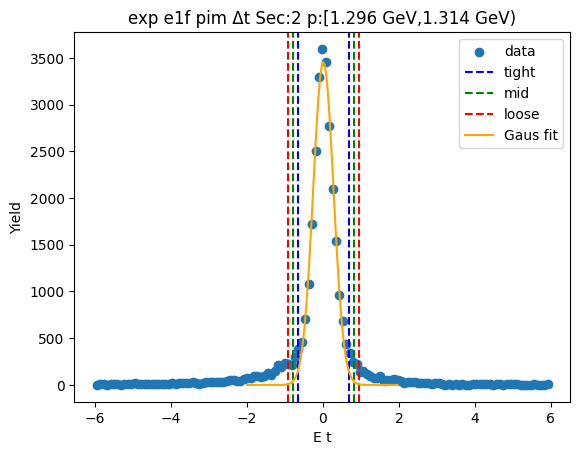

-0.6399754206278817 0.6632508131331644
-0.7702980440039864 0.793573436509269
-0.9006206673800911 0.9238960598853737


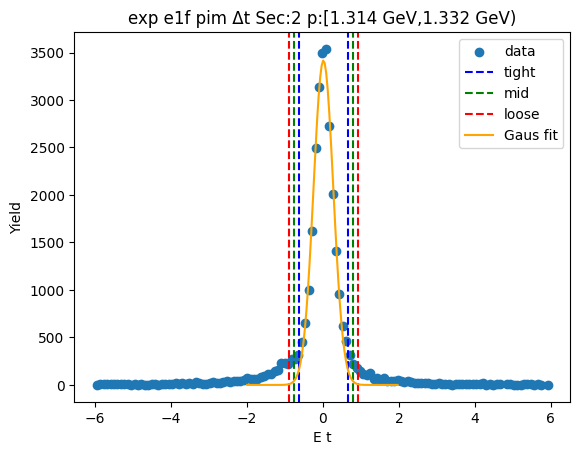

-0.6348635735493147 0.6663116426979845
-0.7649810951740447 0.7964291643227145
-0.8950986167987746 0.9265466859474444


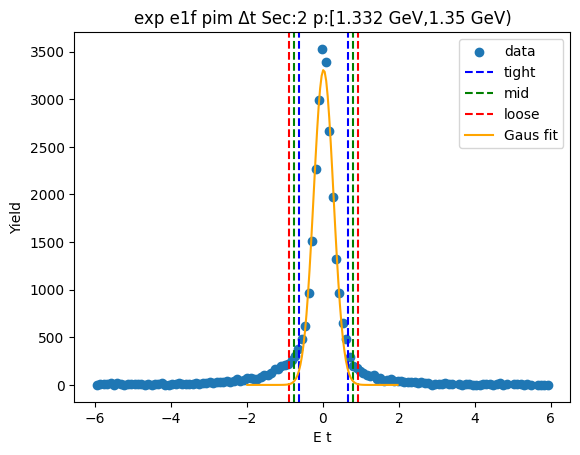

-0.6507725418904289 0.67418005466655
-0.7832678015461269 0.8066753143222479
-0.9157630612018247 0.9391705739779458


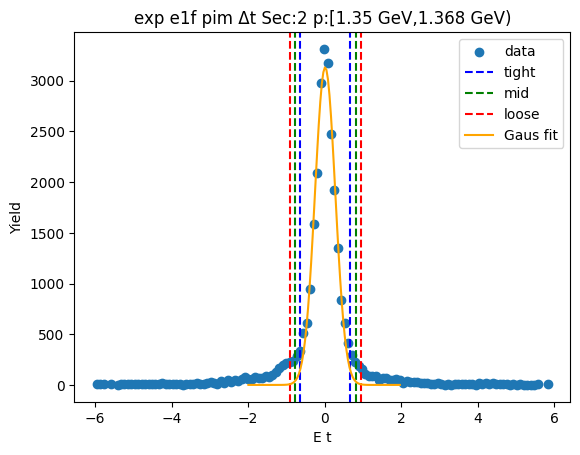

-0.6388336092985023 0.6700789826434344
-0.7697248684926961 0.8009702418376281
-0.9006161276868897 0.9318615010318217


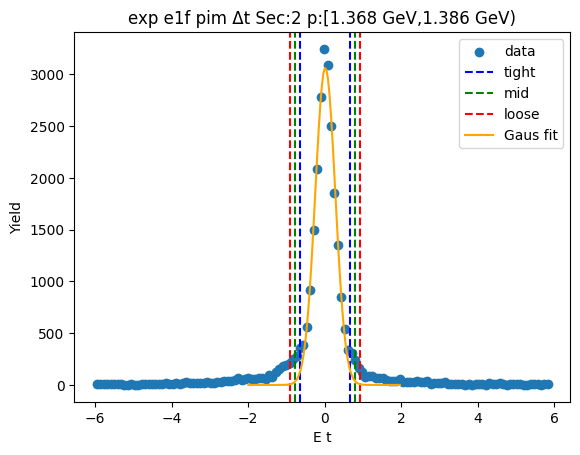

-0.6435535410194916 0.6756517998350561
-0.7754740751049463 0.8075723339205108
-0.907394609190401 0.9394928680059655


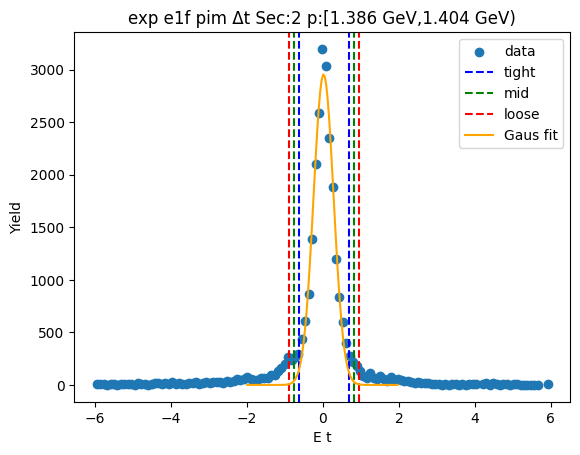

-0.6439505213811414 0.6821448131112076
-0.7765600548303764 0.8147543465604425
-0.9091695882796113 0.9473638800096774


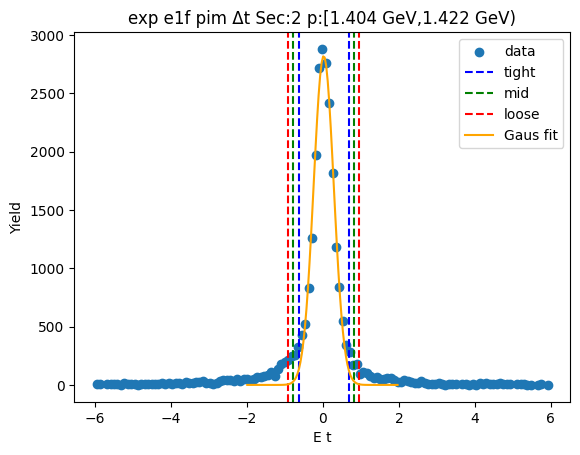

-0.6584301786478575 0.6835820831812036
-0.7926314048307637 0.8177833093641098
-0.9268326310136697 0.9519845355470159


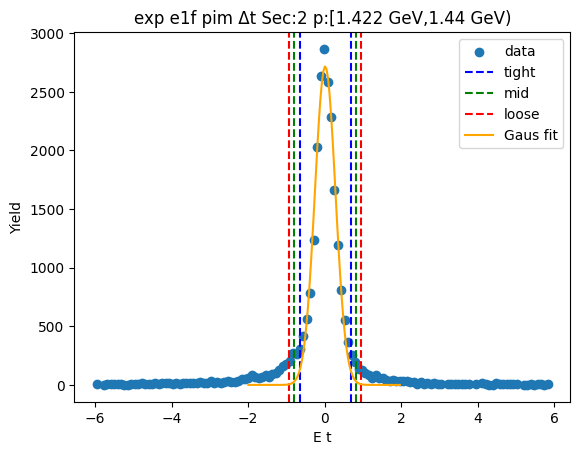

-0.6297076251623643 0.6619986134120663
-0.7588782490198075 0.7911692372695095
-0.8880488728772505 0.9203398611269525


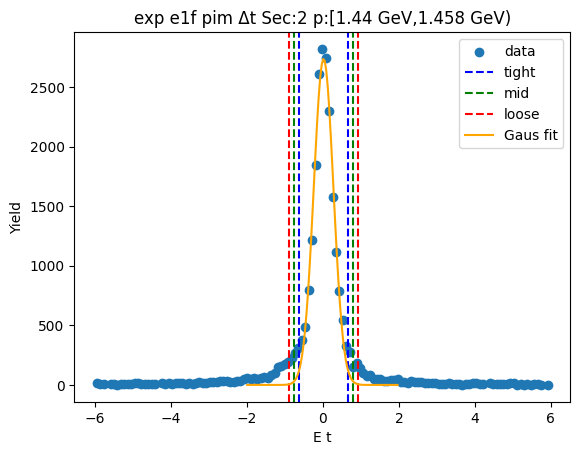

-0.6325456902297819 0.6672151943037745
-0.7625217786831376 0.7971912827571302
-0.8924978671364933 0.9271673712104859


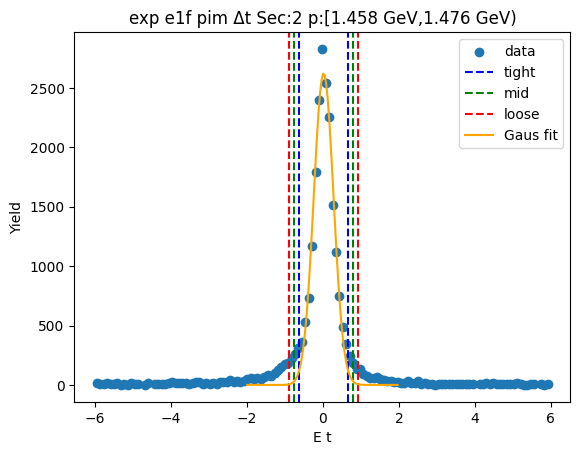

-0.6463659390166203 0.6892565664544679
-0.7799281895637292 0.8228188170015768
-0.913490440110838 0.9563810675486856


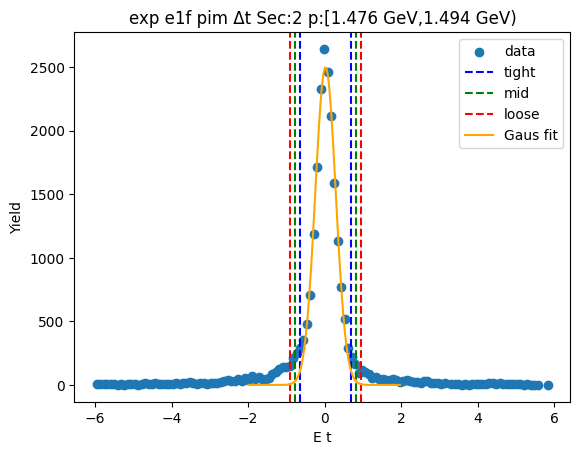

-0.6601123597191649 0.7003090211109262
-0.796154497802174 0.8363511591939352
-0.9321966358851831 0.9723932972769443


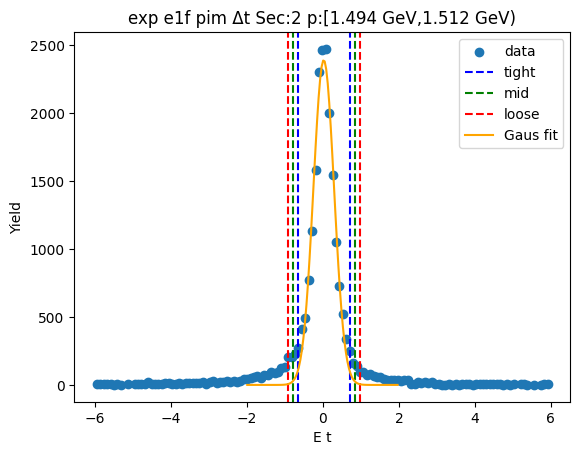

-0.6357021132841297 0.6721865213810073
-0.7664909767506434 0.802975384847521
-0.897279840217157 0.9337642483140346


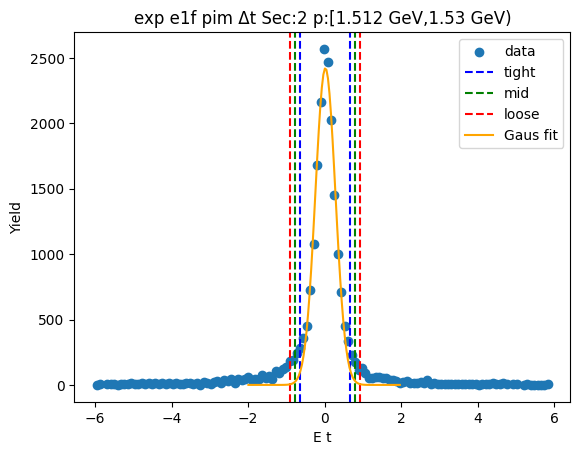

-0.6407452024764745 0.6688293239028388
-0.7717026551144057 0.79978677654077
-0.9026601077523371 0.9307442291787014


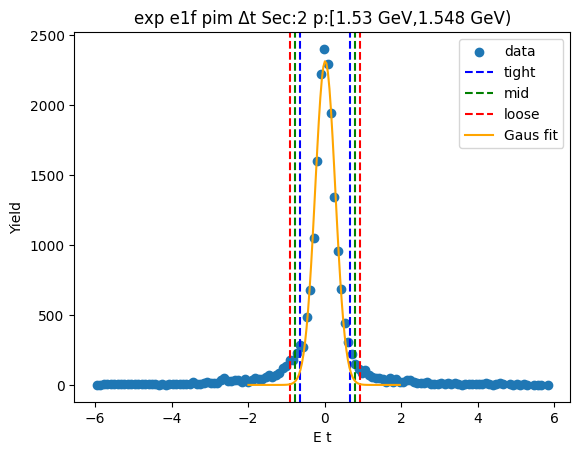

-0.6446891435060303 0.6748296526621792
-0.7766410231228512 0.8067815322790001
-0.9085929027396722 0.938733411895821


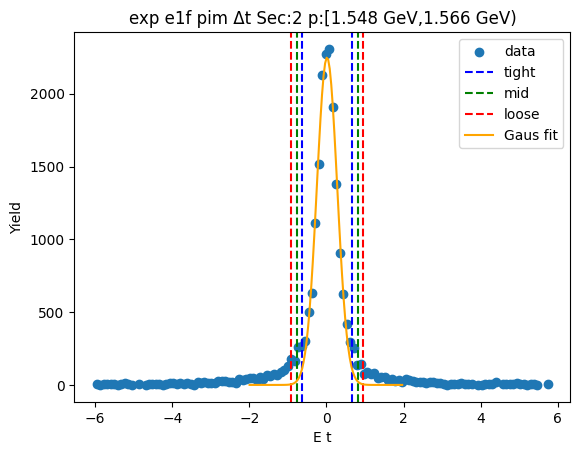

-0.6515693665871907 0.6901685724095226
-0.785743160486862 0.8243423663091939
-0.9199169543865333 0.9585161602088652


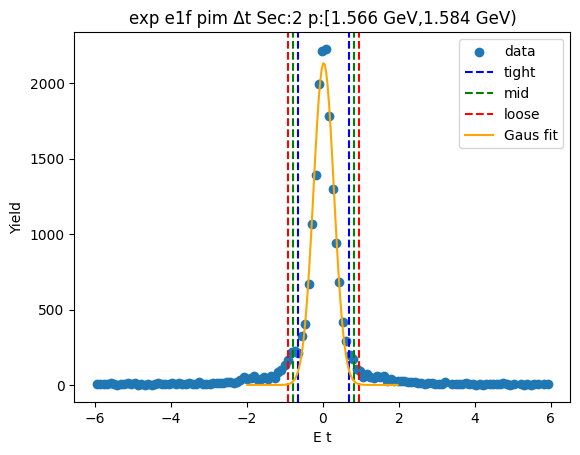

-0.6531965191300358 0.6735736216002438
-0.7858735332030637 0.8062506356732717
-0.9185505472760916 0.9389276497462996


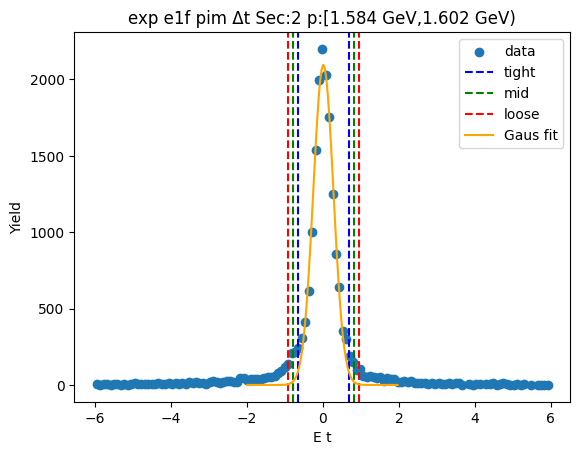

-0.6581976179559685 0.6966847859518406
-0.7936858583467495 0.8321730263426216
-0.9291740987375304 0.9676612667334025


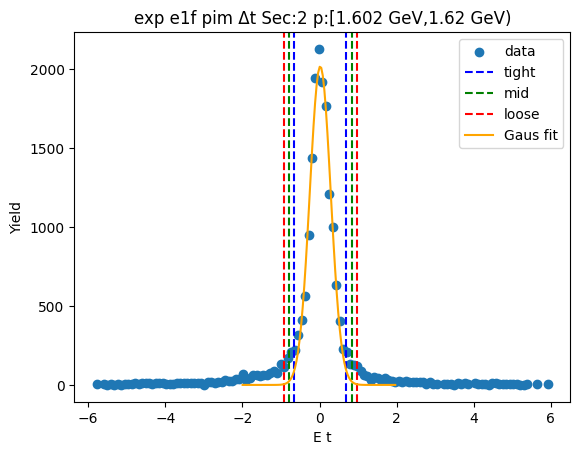

-0.6210432379665795 0.6732316932307302
-0.7504707310863103 0.8026591863504611
-0.8798982242060412 0.932086679470192


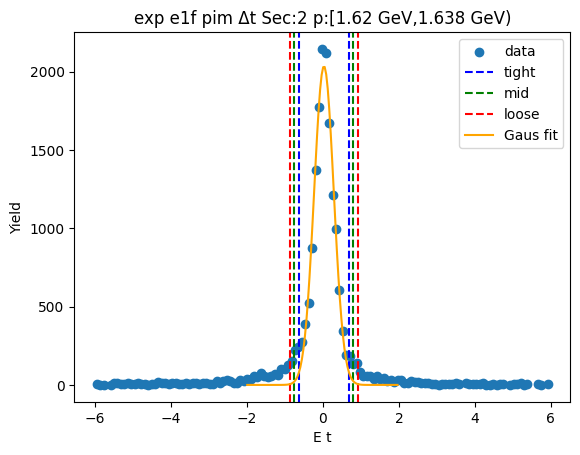

-0.6388940449284075 0.6714305367825684
-0.7699265030995052 0.802462994953666
-0.9009589612706028 0.9334954531247637


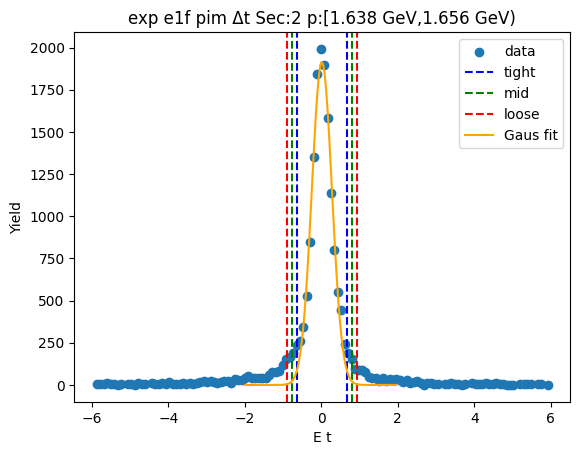

-0.6435610370407513 0.6861611313043167
-0.7765332538752582 0.8191333481388235
-0.909505470709765 0.9521055649733303


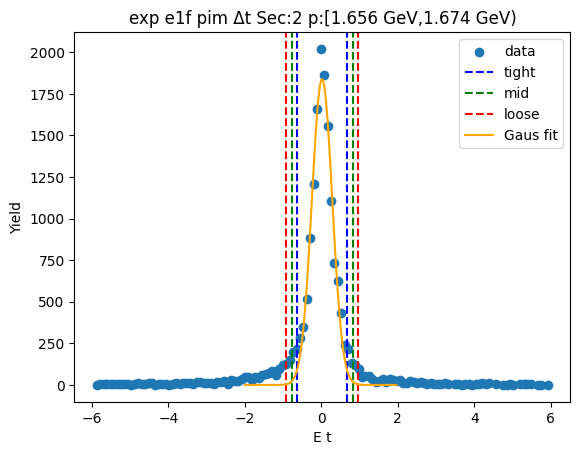

-0.6535380029738376 0.6866714719607769
-0.787558950467299 0.8206924194542383
-0.9215798979607603 0.9547133669476997


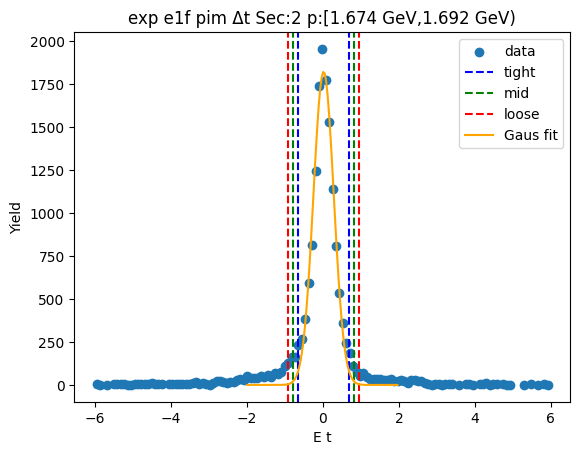

-0.6311240419209997 0.6693090175776407
-0.7611673478708638 0.7993523235275048
-0.8912106538207278 0.9293956294773689


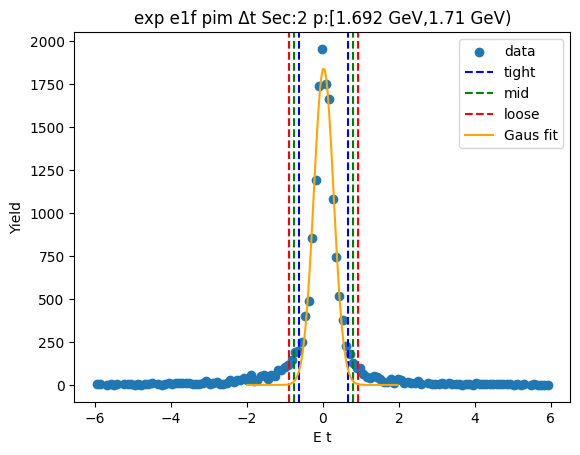

-0.6588487546516122 0.68828794875109
-0.7935624249918823 0.8230016190913602
-0.9282760953321525 0.9577152894316303


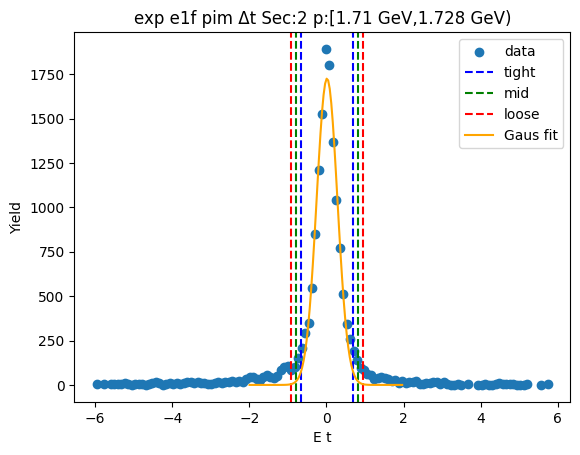

-0.6417092545769572 0.6743050390600951
-0.7733106839406624 0.8059064684238003
-0.9049121133043676 0.9375078977875055


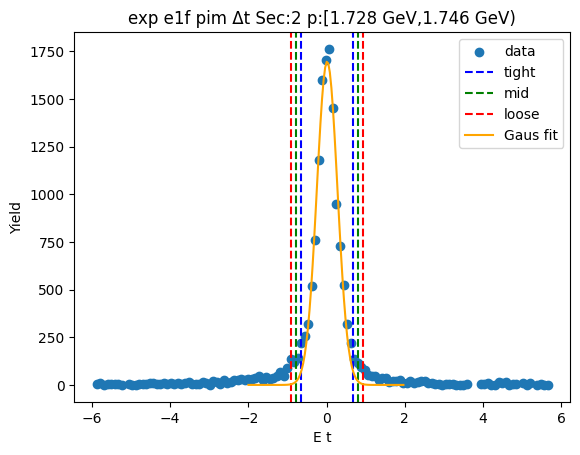

-0.6423755140462918 0.6868109658873095
-0.7752941620396518 0.8197296138806696
-0.9082128100330119 0.9526482618740296


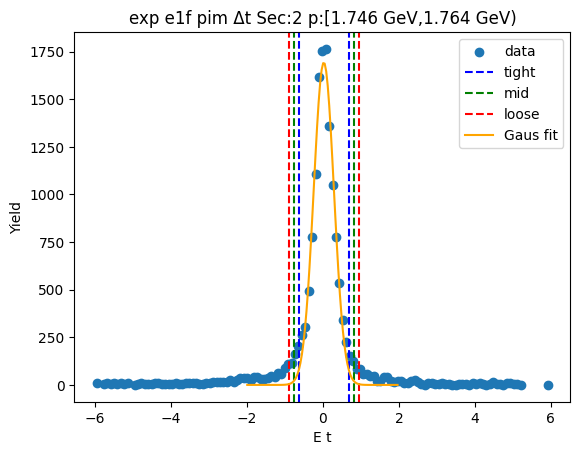

-0.6213260713796226 0.6784624489454253
-0.7513049234121273 0.80844130097793
-0.8812837754446321 0.9384201530104348


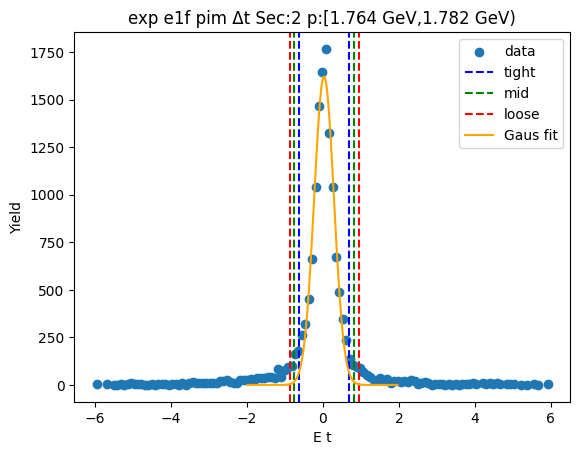

-0.6577231701530997 0.711560549821082
-0.7946515421505179 0.8484889218185002
-0.9315799141479361 0.9854172938159184


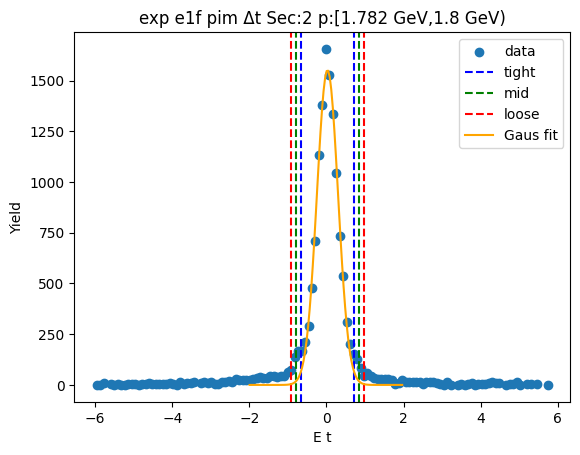

-0.65095139117604 0.7009708792279167
-0.7861436182164355 0.8361631062683123
-0.9213358452568312 0.9713553333087079


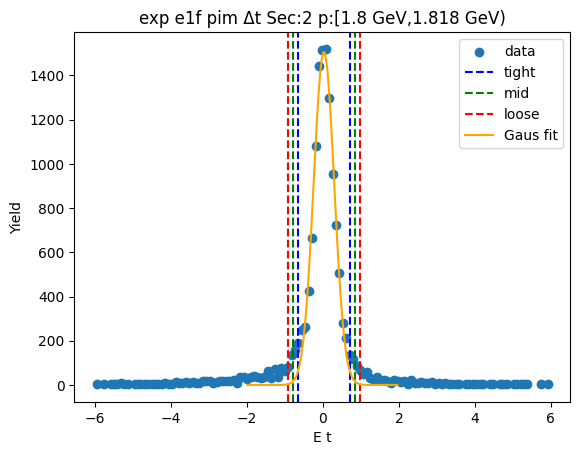

-0.6422229290911107 0.6829817220331819
-0.77474339420354 0.8155021871456112
-0.9072638593159693 0.9480226522580405


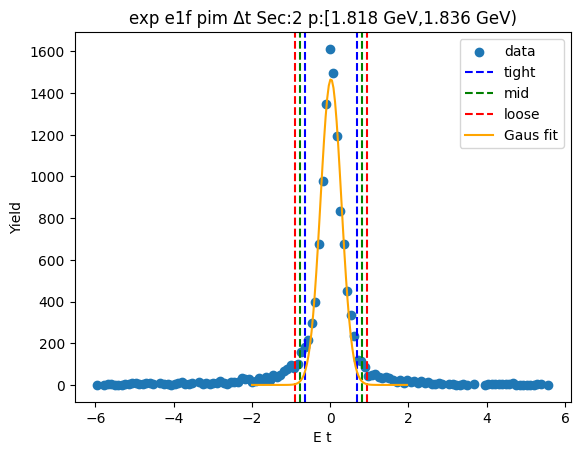

-0.6162384716130369 0.6733090784107696
-0.7451932266154176 0.8022638334131503
-0.8741479816177983 0.931218588415531


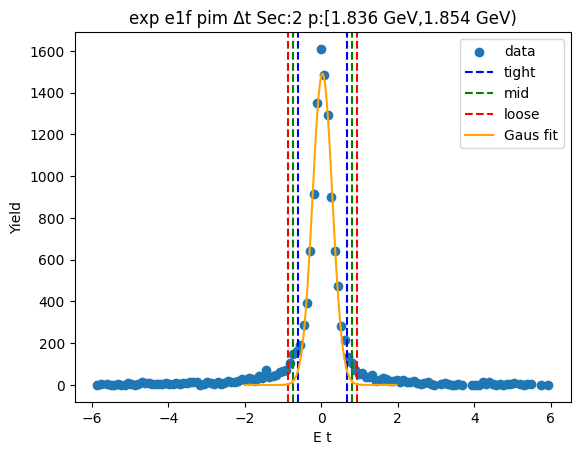

-0.6242748378147789 0.6820617533945936
-0.754908496935716 0.8126954125155308
-0.8855421560566533 0.9433290716364681


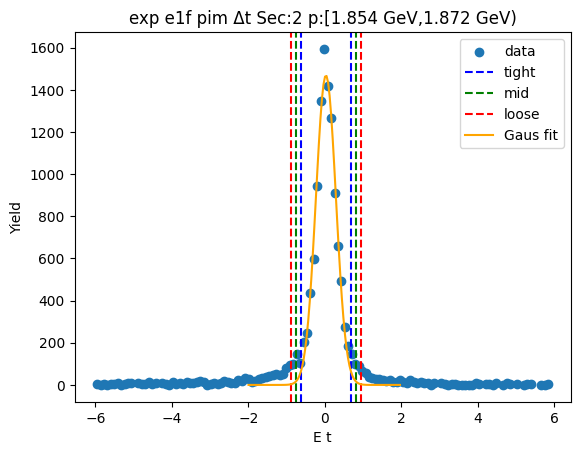

-0.6059815398693911 0.6679785043410083
-0.733377544290431 0.7953745087620482
-0.8607735487114709 0.9227705131830881


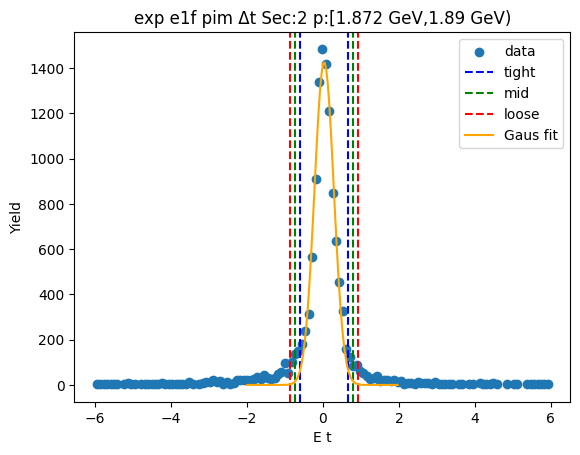

-0.6277701611745194 0.6845318344857905
-0.7590003607405504 0.8157620340518215
-0.8902305603065814 0.9469922336178525


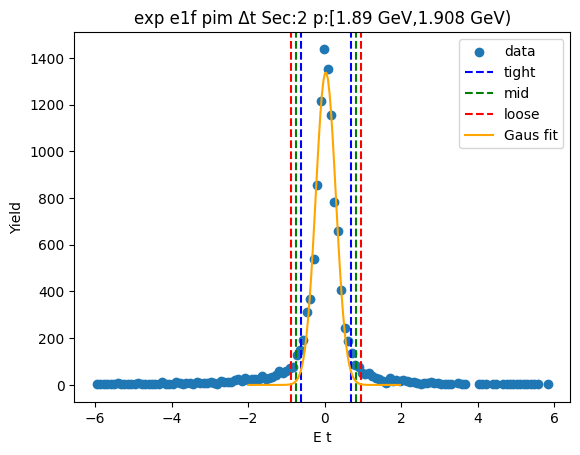

-0.6272772486337346 0.6937835648105923
-0.7593833299781674 0.8258896461550249
-0.8914894113226 0.9579957274994577


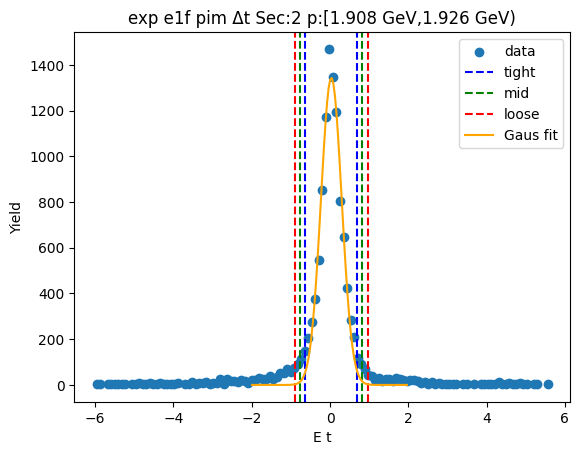

-0.6214145099903366 0.6866770122514835
-0.7522236622145188 0.8174861644756656
-0.8830328144387007 0.9482953166998476


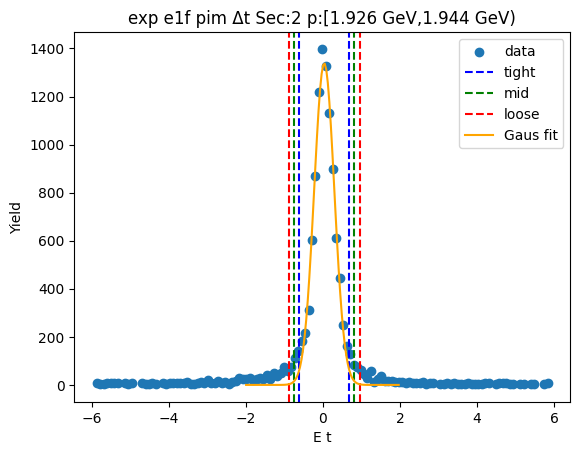

-0.6146446432621897 0.6789862241103028
-0.7440077299994389 0.808349310847552
-0.8733708167366881 0.9377123975848013


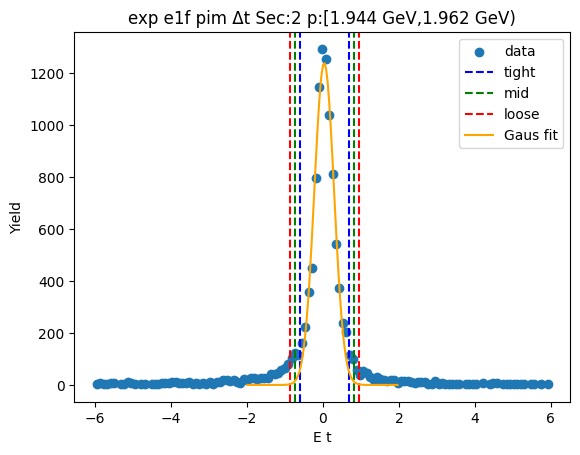

-0.6583624548835373 0.7054590234178318
-0.7947446027136742 0.8418411712479688
-0.9311267505438111 0.9782233190781057


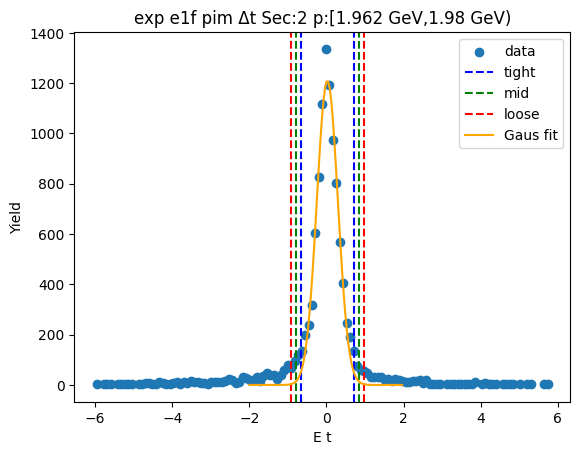

-0.6364525893743489 0.6974571302531887
-0.7698435613371027 0.8308481022159425
-0.9032345332998565 0.9642390741786963


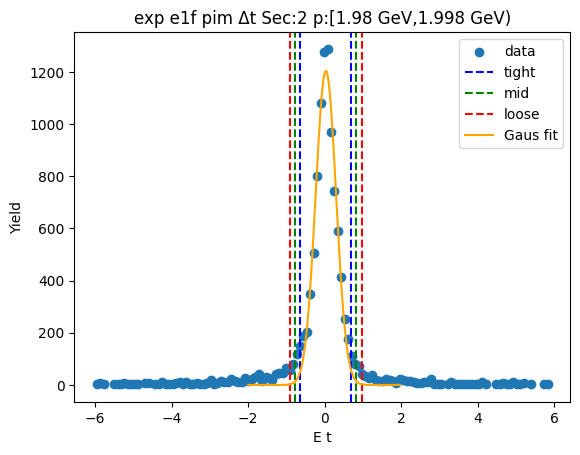

-0.632814931282048 0.6796832914957222
-0.764064753559825 0.8109331137734991
-0.895314575837602 0.9421829360512761


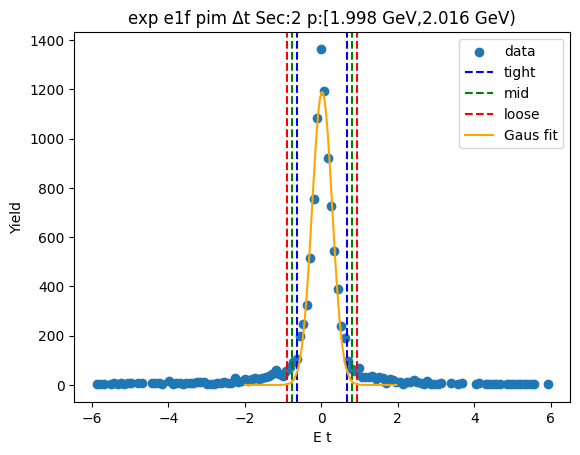

-0.6561900443538122 0.7010596712749768
-0.7919150159166912 0.8367846428378558
-0.9276399874795701 0.9725096144007347


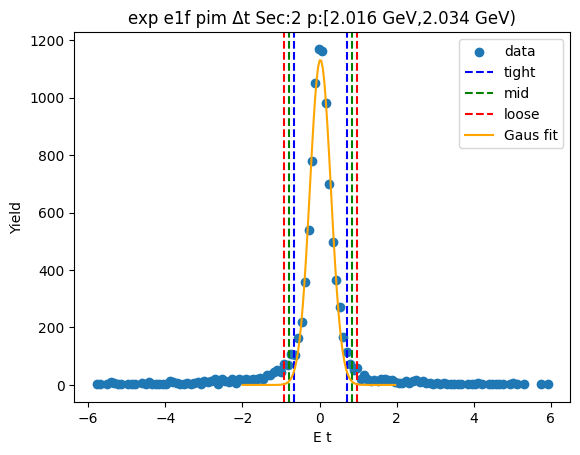

-0.6155070839551665 0.6883240629671178
-0.745890198647395 0.8187071776593463
-0.8762733133396234 0.9490902923515747


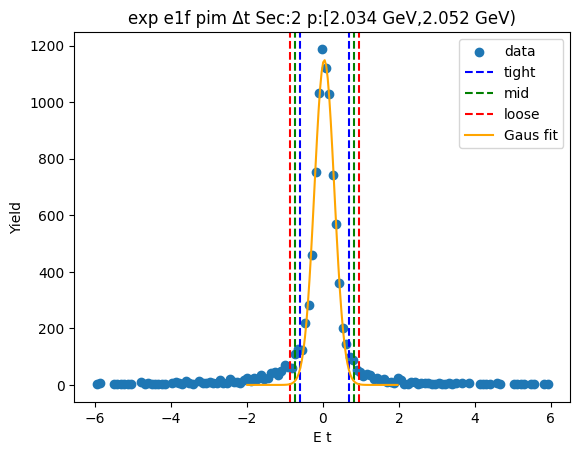

-0.6221713280034387 0.6849449357195763
-0.7528829543757402 0.8156565620918778
-0.8835945807480416 0.9463681884641792


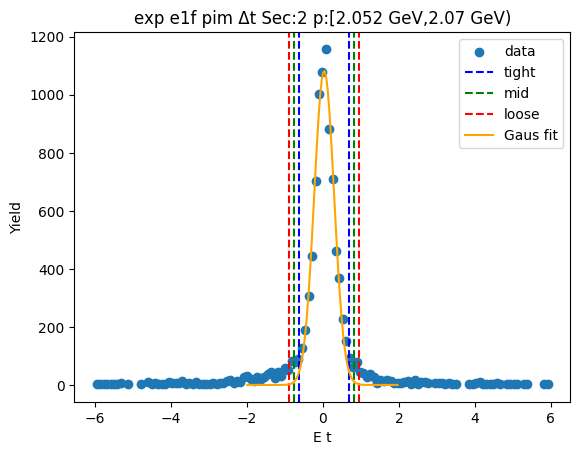

-0.5902736389104486 0.6645967093277527
-0.7157606737342687 0.7900837441515728
-0.8412477085580887 0.9155707789753929


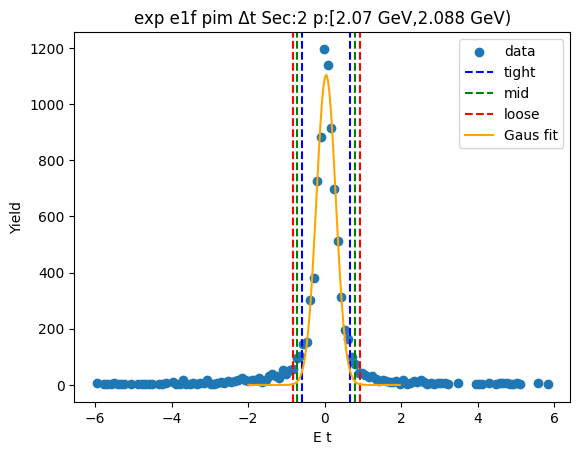

-0.6232588430769511 0.6815365774026937
-0.7537383851249155 0.8120161194506581
-0.88421792717288 0.9424956614986225


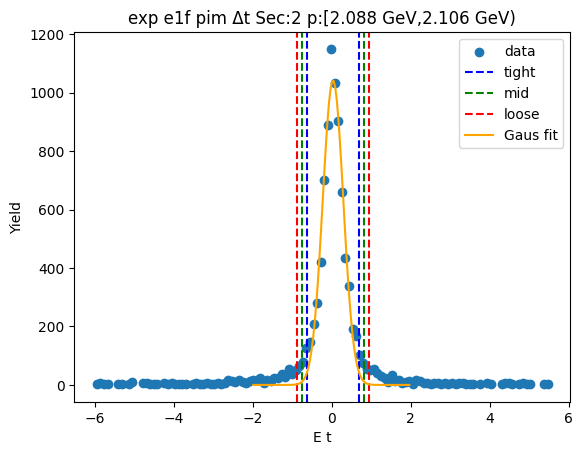

-0.5978174268185374 0.6697849278228054
-0.7245776622826717 0.7965451632869397
-0.851337897746806 0.923305398751074


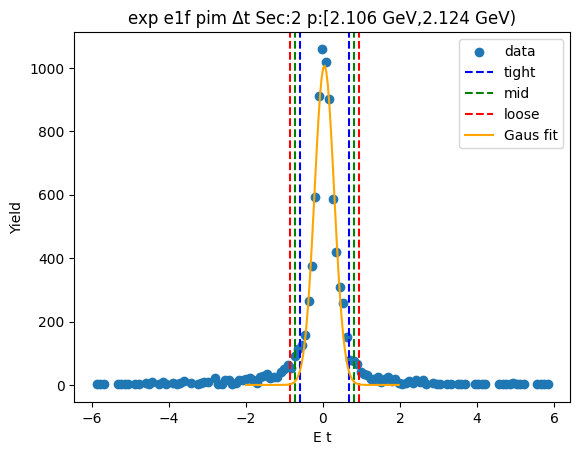

-0.58847577394808 0.6714967668750865
-0.7144730280303967 0.7974940209574032
-0.8404702821127134 0.9234912750397198


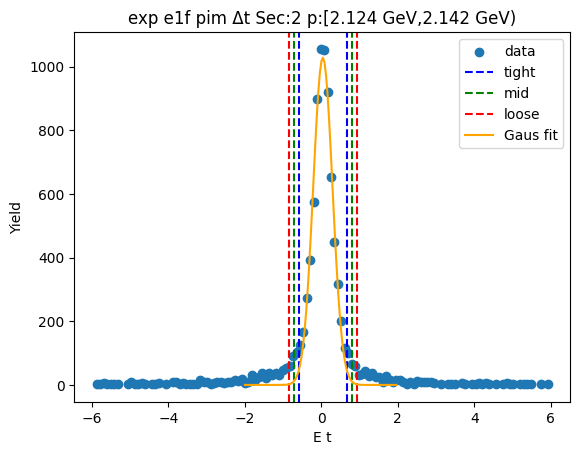

-0.6245014410200328 0.6709938077168683
-0.754050965893723 0.8005433325905585
-0.8836004907674131 0.9300928574642486


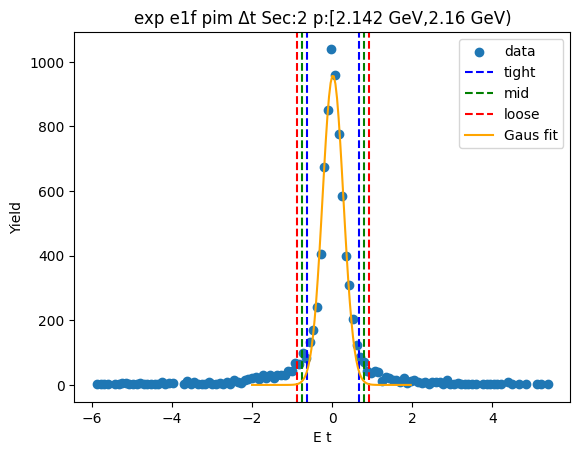

-0.634238865262057 0.7250412478101784
-0.7701668765692806 0.8609692591174019
-0.906094887876504 0.9968972704246255


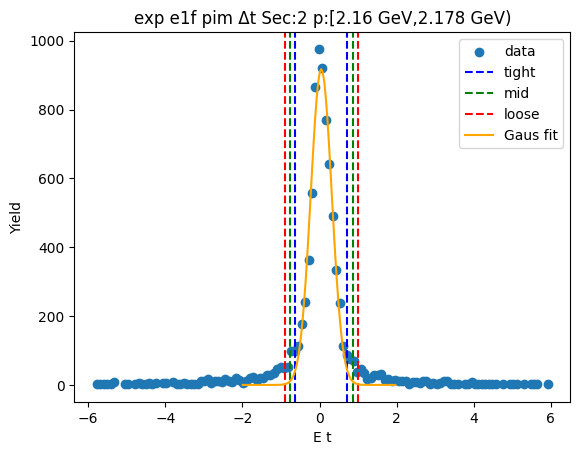

-0.6108948496138721 0.68346424397661
-0.7403307589729202 0.8129001533356581
-0.8697666683319684 0.9423360626947063


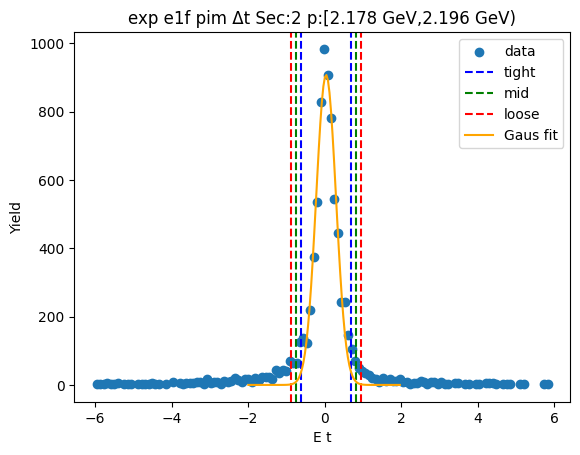

-0.5912090818927678 0.6631485192996343
-0.7166448420120081 0.7885842794188745
-0.8420806021312482 0.9140200395381147


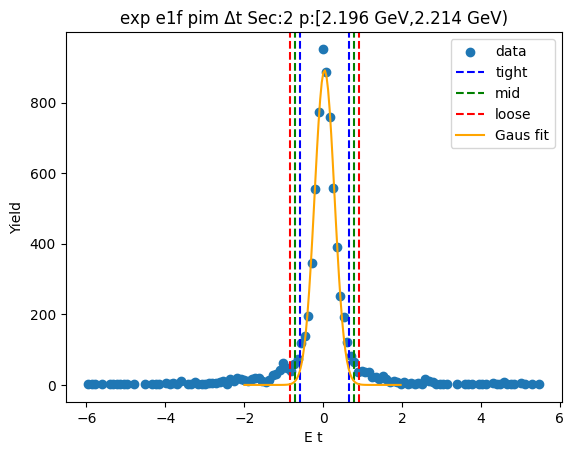

-0.595789142378947 0.6780895502916768
-0.7231770116460094 0.8054774195587393
-0.8505648809130718 0.9328652888258017


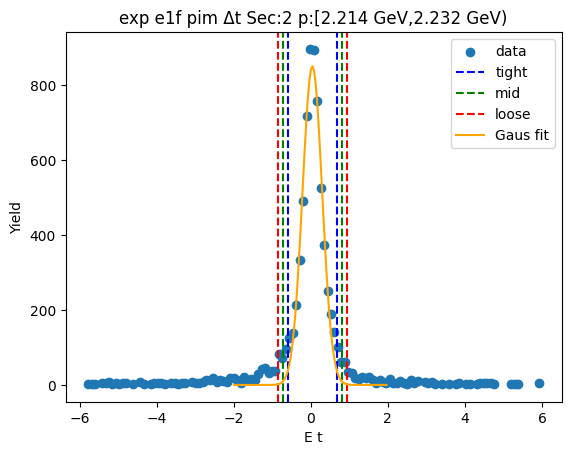

-0.5875472884275902 0.6716826635910923
-0.7134702836294585 0.7976056587929606
-0.8393932788313268 0.9235286539948289


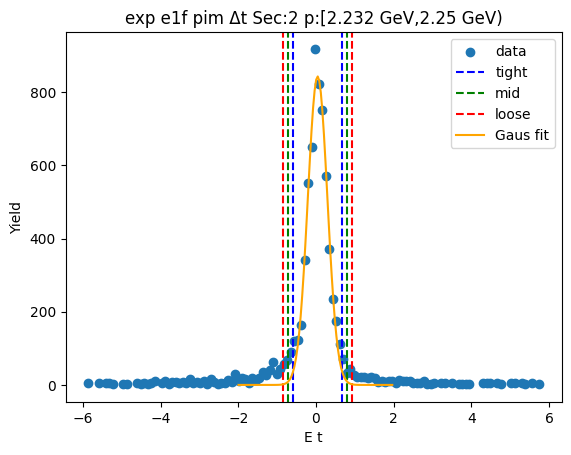

-0.6061053064592611 0.7090980737538438
-0.7376256444805717 0.8406184117751544
-0.8691459825018821 0.9721387497964649


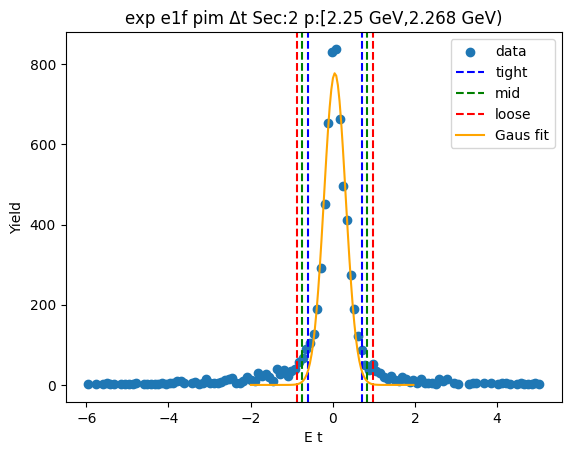

-0.598564641882757 0.6785426775591021
-0.726275373826943 0.806253409503288
-0.8539861057711289 0.933964141447474


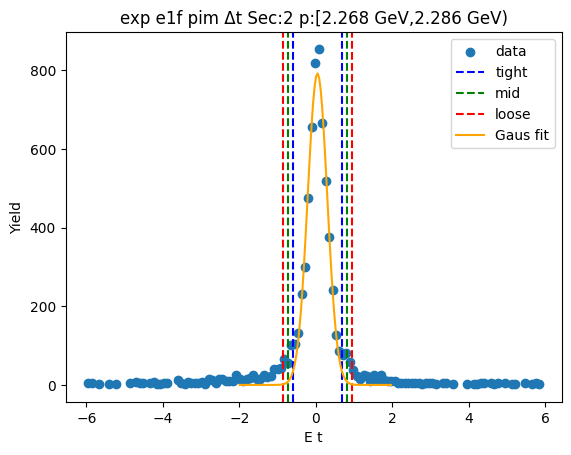

-0.6143103270076303 0.6872180951700132
-0.7444631692253947 0.8173709373877776
-0.874616011443159 0.9475237796055419


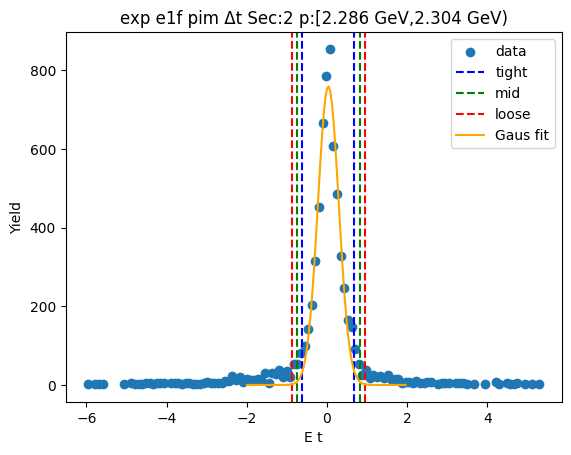

-0.5853417981520688 0.6873645153377907
-0.7126124295010546 0.8146351466867766
-0.8398830608500406 0.9419057780357626


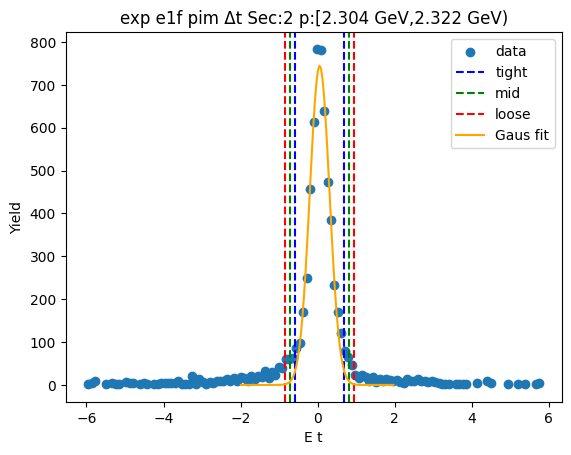

-0.5998878491343751 0.692981706234109
-0.7291748046712234 0.8222686617709574
-0.8584617602080719 0.9515556173078058


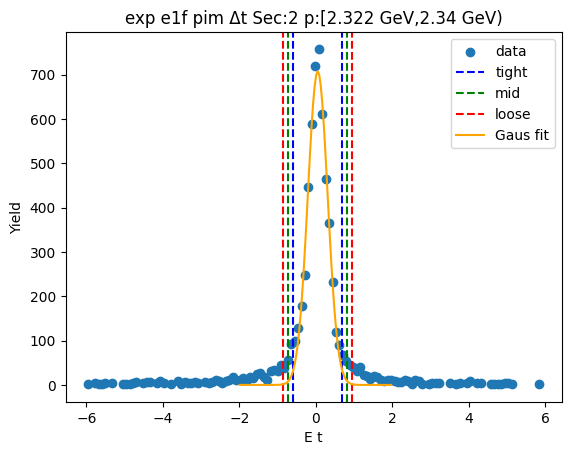

-0.5910215970644305 0.7045461996612973
-0.7205783767370033 0.8341029793338701
-0.8501351564095762 0.963659759006443


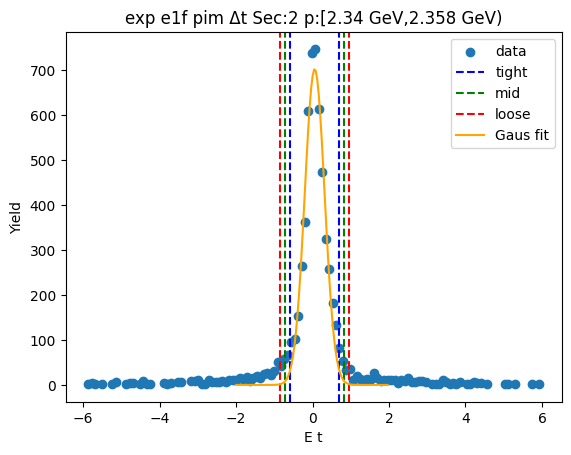

-0.6089226879884581 0.677448618722451
-0.7375598186595489 0.8060857493935418
-0.8661969493306397 0.9347228800646327


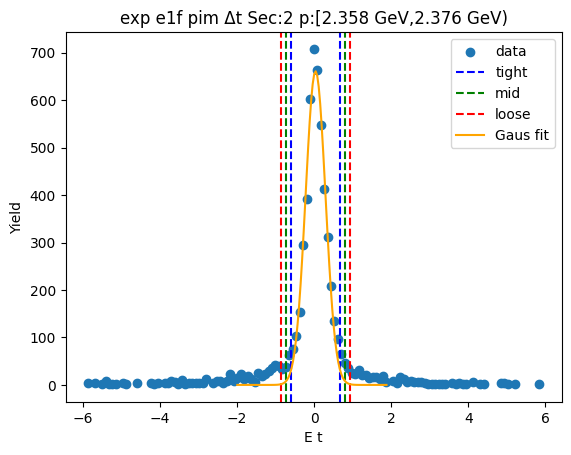

-0.534034774679673 0.6232646772700099
-0.6497647198746412 0.7389946224649782
-0.7654946650696095 0.8547245676599464


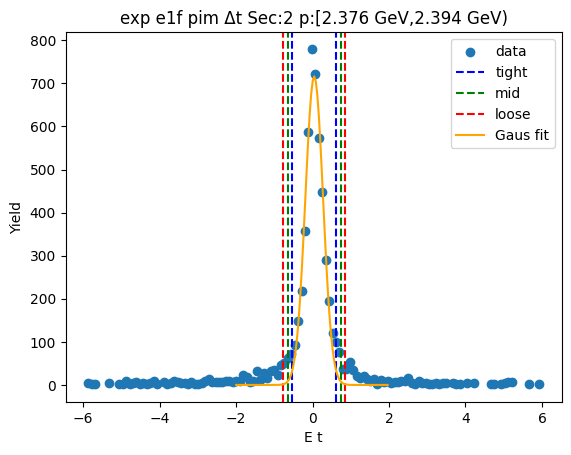

-0.8911171522757614 0.7669618589052817
-1.0569250533938659 0.9327697600233861
-1.22273295451197 1.0985776611414901


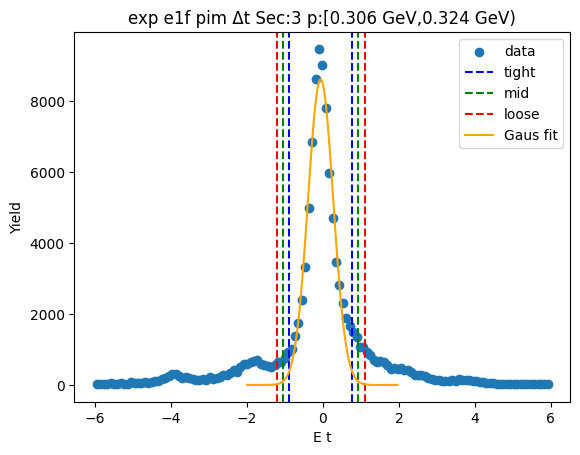

-0.8630496586965556 0.7498668228654372
-1.024341306852755 0.9111584710216365
-1.1856329550089542 1.072450119177836


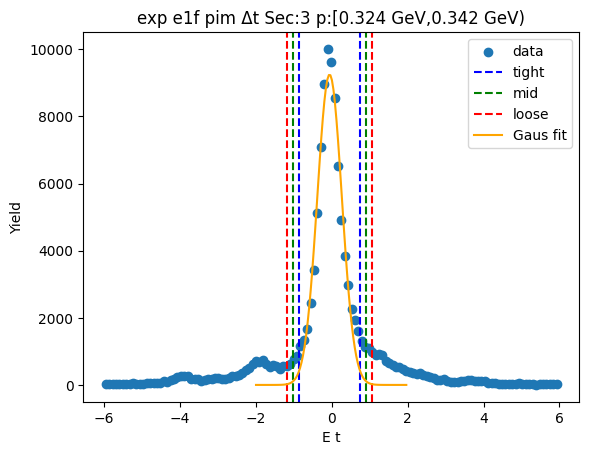

-0.8365226689054718 0.7349117353831071
-0.9936661093343298 0.892055175811965
-1.1508095497631876 1.049198616240823


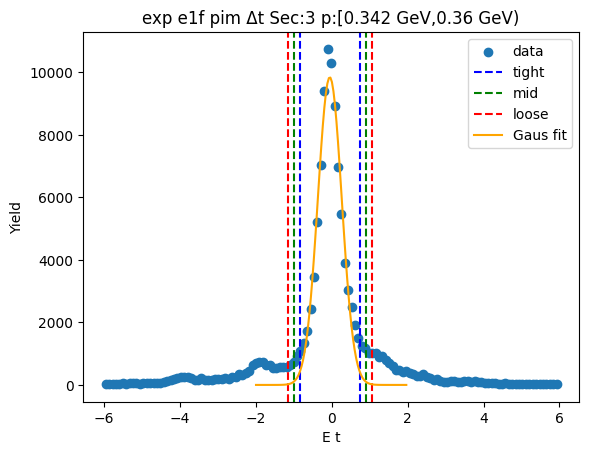

-0.8184565541619951 0.7196555669692283
-0.9722677662751176 0.8734667790823507
-1.12607897838824 1.027277991195473


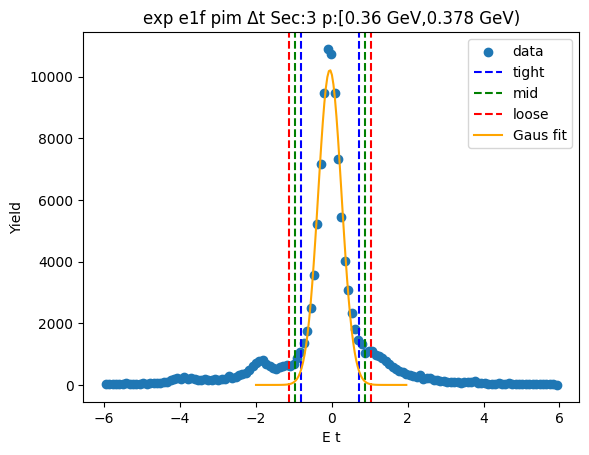

-0.7994756314878876 0.7086903296825978
-0.950292227604936 0.8595069257996463
-1.1011088237219846 1.010323521916695


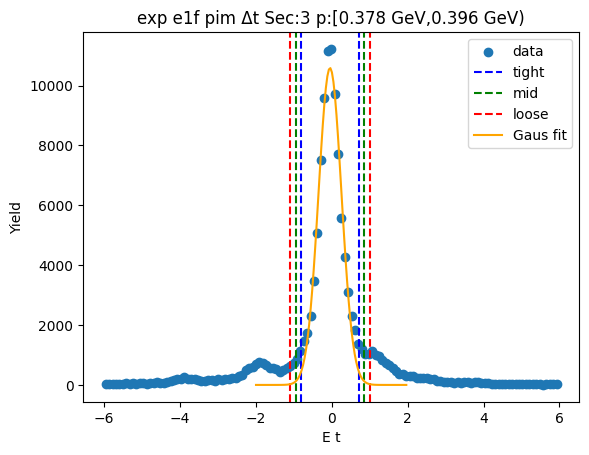

-0.7880244428861274 0.6970620756001853
-0.9365330947347587 0.8455707274488166
-1.0850417465833901 0.9940793792974479


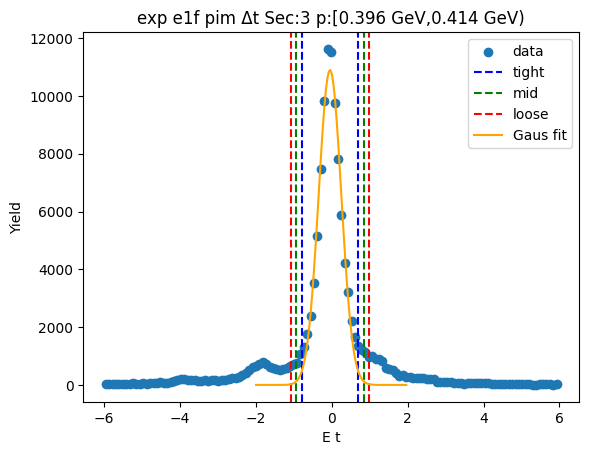

-0.7723938429488576 0.6848649126347895
-0.9181197185072224 0.8305907881931544
-1.063845594065587 0.9763166637515189


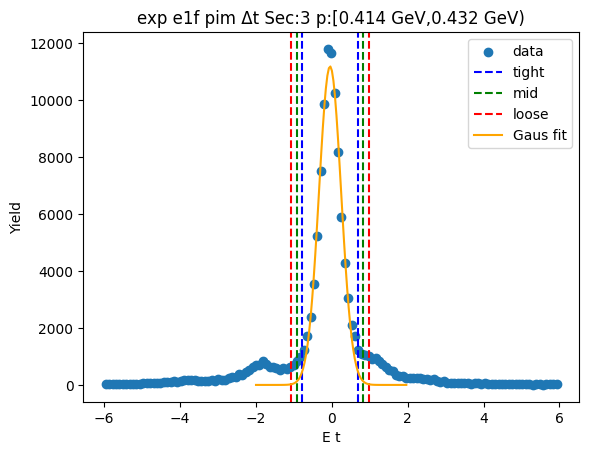

-0.7491326694688452 0.6747683625685874
-0.8915227726725885 0.8171584657723308
-1.0339128758763316 0.959548568976074


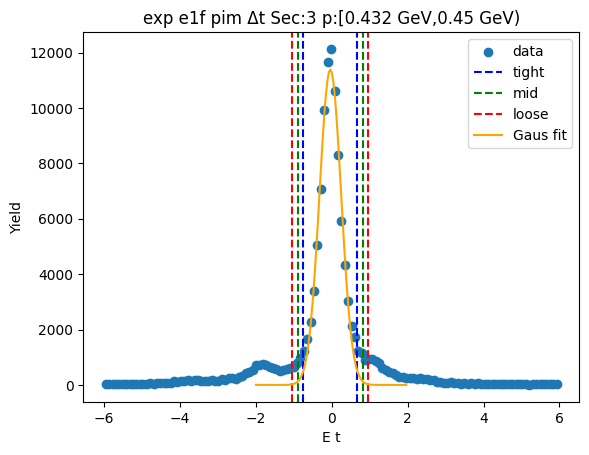

-0.7438211120562355 0.6705035327520914
-0.8852535765370682 0.8119359972329241
-1.0266860410179008 0.9533684617137568


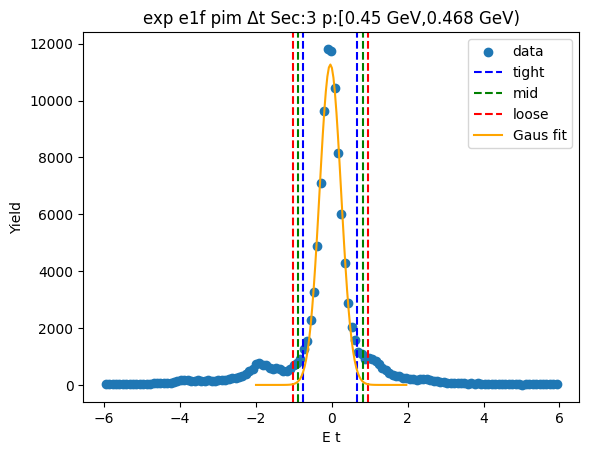

-0.7397098915521554 0.668538016327012
-0.880534682340072 0.8093628071149287
-1.021359473127989 0.9501875979028455


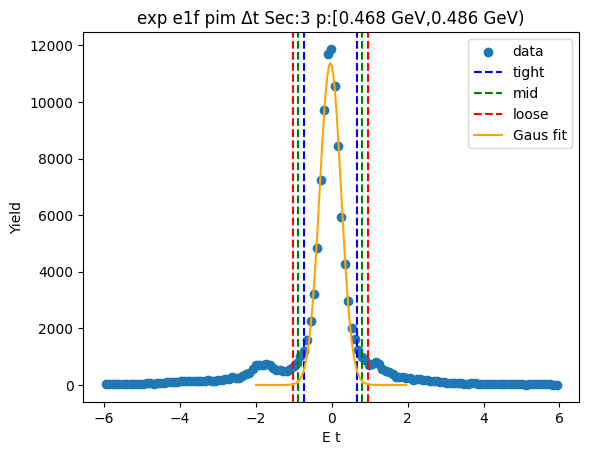

-0.7333709935641058 0.6630402152108062
-0.873012114441597 0.8026813360882974
-1.012653235319088 0.9423224569657885


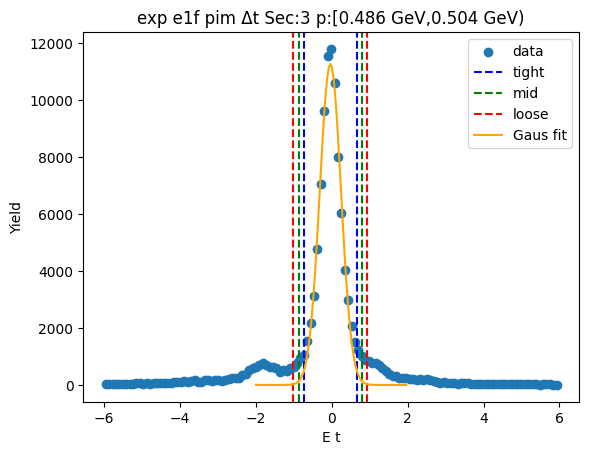

-0.723541635830473 0.6544561972384343
-0.8613414191373638 0.7922559805453251
-0.9991412024442546 0.9300557638522159


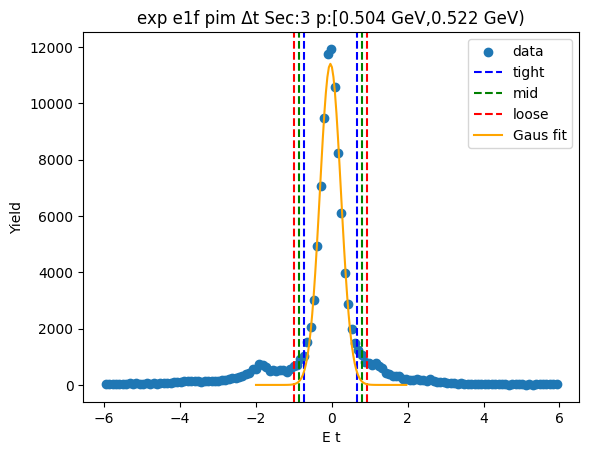

-0.7066436245815965 0.6438166444794139
-0.8416896514876976 0.778862671385515
-0.9767356783937986 0.913908698291616


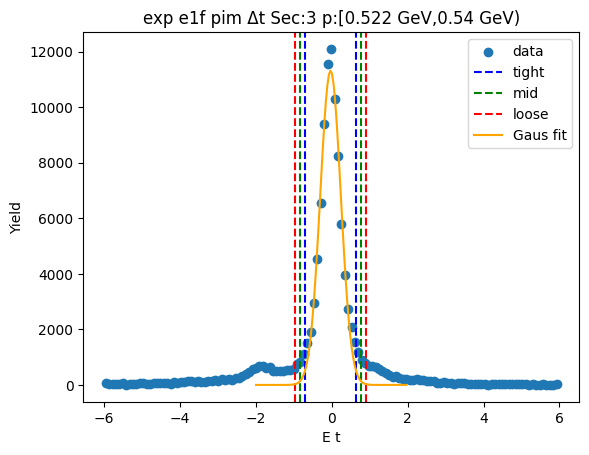

-0.7181317921737063 0.6550589160362965
-0.8554508629947066 0.7923779868572969
-0.9927699338157069 0.9296970576782971


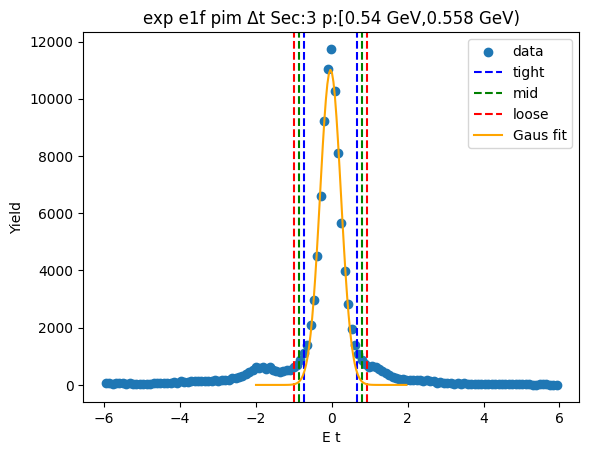

-0.7068226371441996 0.6445764510205664
-0.8419625459606761 0.7797163598370429
-0.9771024547771526 0.9148562686535194


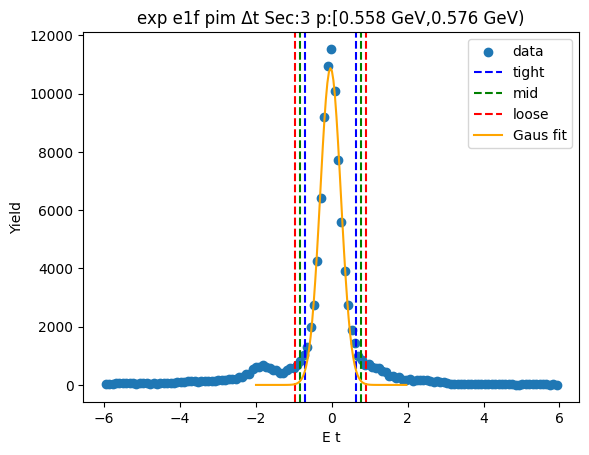

-0.6983262880149932 0.6395714665938781
-0.8321160634758804 0.7733612420547653
-0.9659058389367675 0.9071510175156524


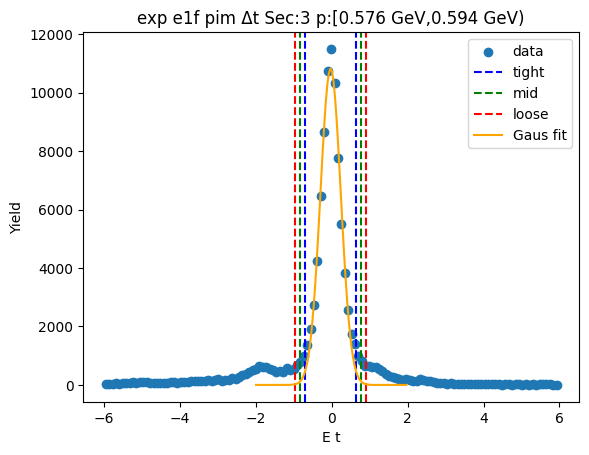

-0.6970182550964188 0.6307928371794522
-0.8297993643240058 0.7635739464070392
-0.9625804735515929 0.8963550556346264


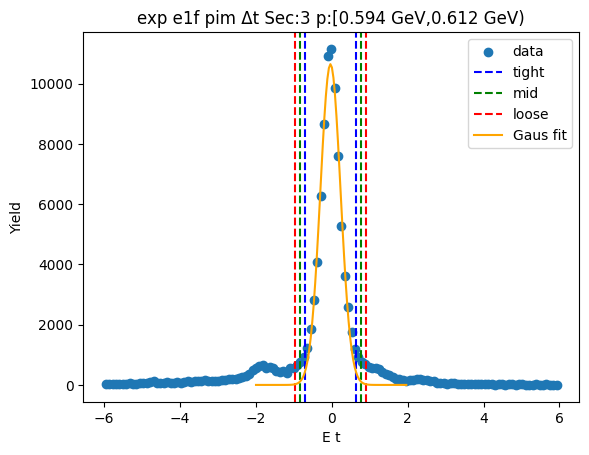

-0.6875575558518886 0.6311732317644941
-0.8194306346135269 0.7630463105261325
-0.9513037133751653 0.8949193892877708


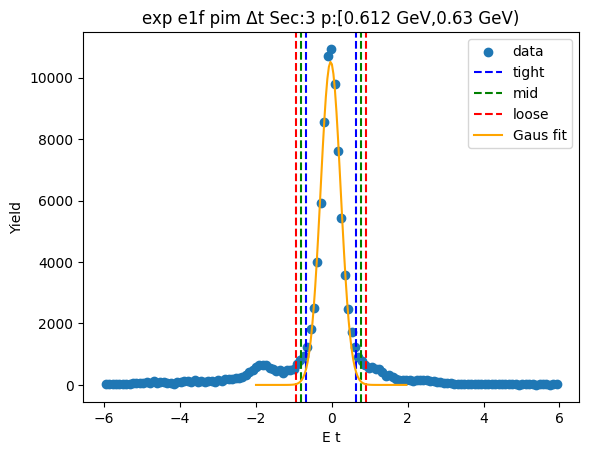

-0.6923348329734808 0.6404771219901461
-0.8256160284698435 0.7737583174865088
-0.9588972239662062 0.9070395129828716


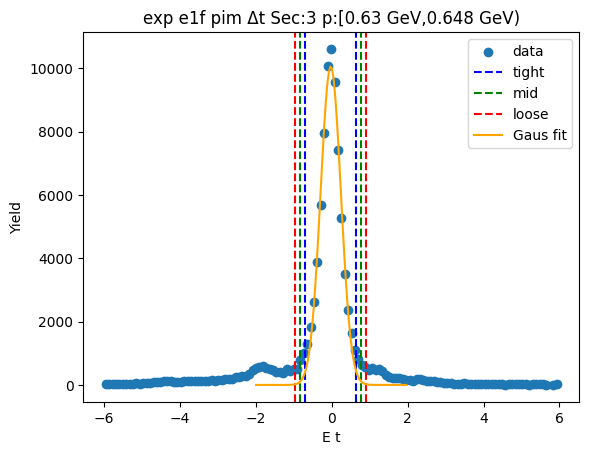

-0.6909486562968005 0.63756273096852
-0.8237997950233324 0.770413869695052
-0.9566509337498644 0.903265008421584


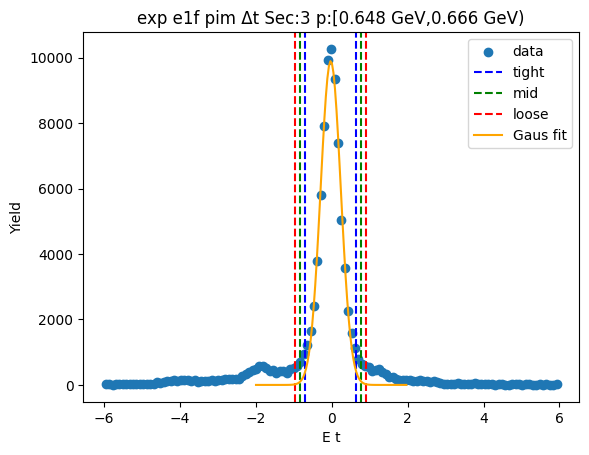

-0.6927173140931545 0.6397734236519687
-0.8259663878676667 0.7730224974264809
-0.9592154616421791 0.9062715712009932


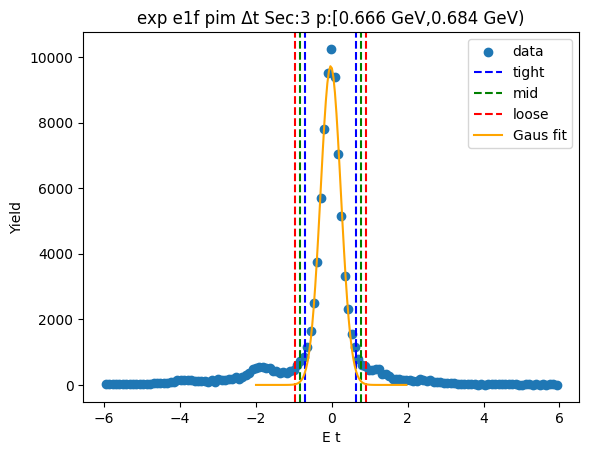

-0.6865244500203092 0.6283502601760411
-0.8180119210399442 0.7598377311956762
-0.9494993920595793 0.8913252022153113


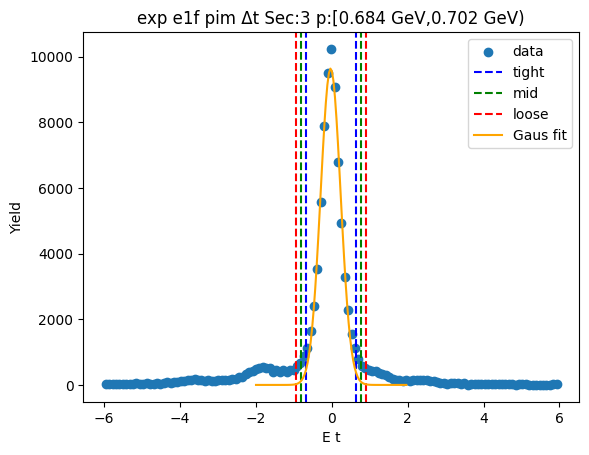

-0.6733869925648746 0.6151712349315619
-0.8022428153145181 0.7440270576812055
-0.9310986380641617 0.872882880430849


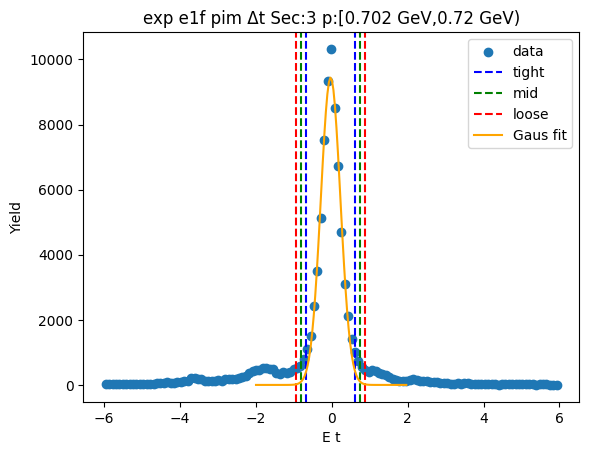

-0.6736629195747708 0.6239129139597603
-0.8034205029282239 0.7536704973132134
-0.933178086281677 0.8834280806666666


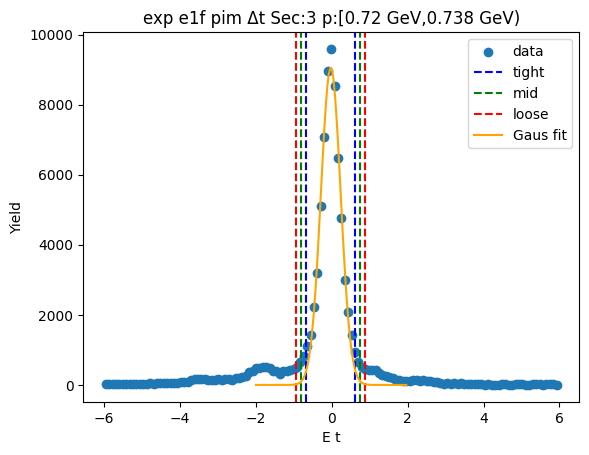

-0.6795666578136984 0.6257111636653646
-0.8100944399616048 0.756238945813271
-0.9406222221095111 0.8867667279611773


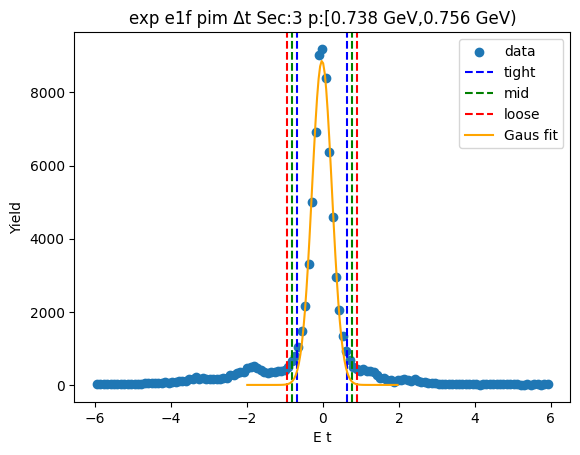

-0.6742476185288652 0.6191440864988677
-0.8035867890316384 0.7484832570016409
-0.9329259595344116 0.8778224275044141


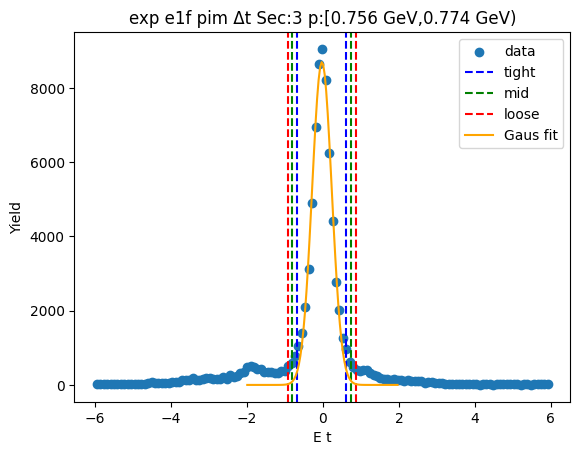

-0.6744331622402517 0.6167649258441872
-0.8035529710486957 0.7458847346526312
-0.9326727798571397 0.8750045434610749


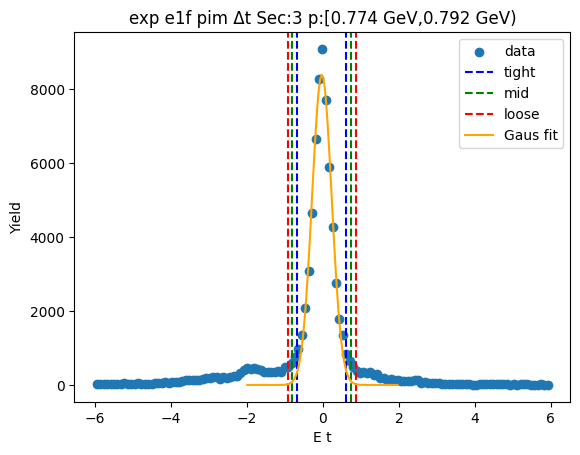

-0.6627066581489449 0.6088150577320952
-0.789858829737049 0.7359672293201993
-0.917011001325153 0.8631194009083033


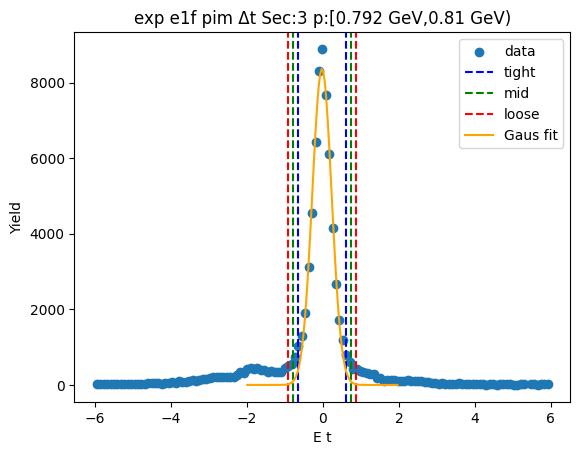

-0.6732582631777676 0.6110565444650694
-0.8016897439420514 0.7394880252293532
-0.9301212247063351 0.8679195059936369


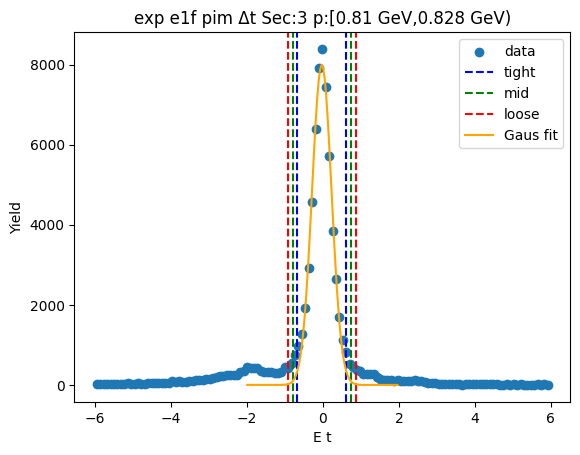

-0.6735101316364178 0.6142008037294204
-0.8022812251730017 0.7429718972660043
-0.9310523187095856 0.8717429908025882


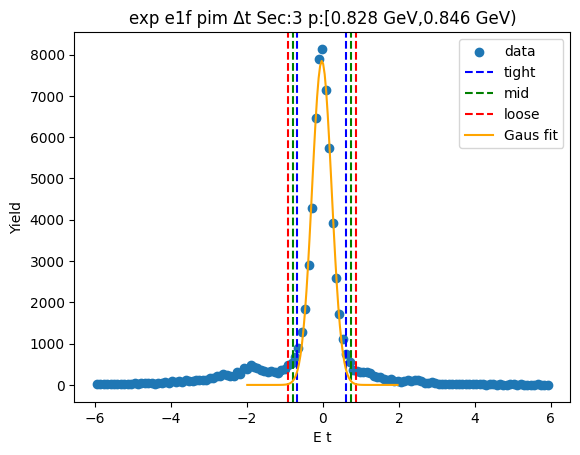

-0.6744314891423492 0.6217741690608091
-0.8040520549626651 0.751394734881125
-0.933672620782981 0.8810153007014409


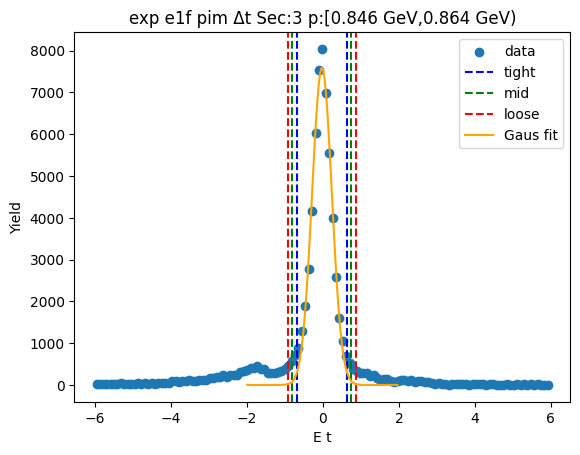

-0.6754583275434488 0.6127349306775632
-0.80427765336555 0.7415542564996644
-0.9330969791876512 0.8703735823217656


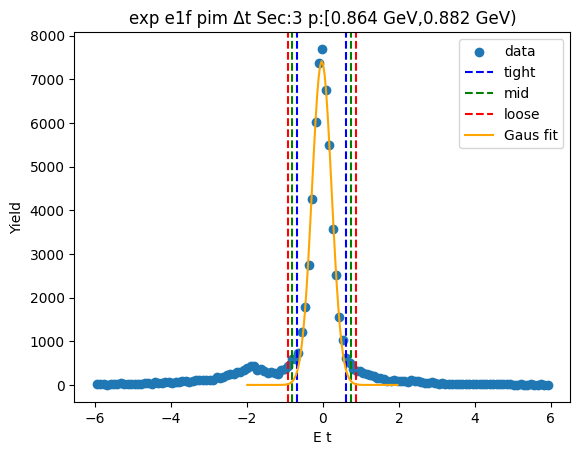

-0.6631942486081499 0.6099995440285024
-0.7905136278718152 0.7373189232921677
-0.9178330071354804 0.864638302555833


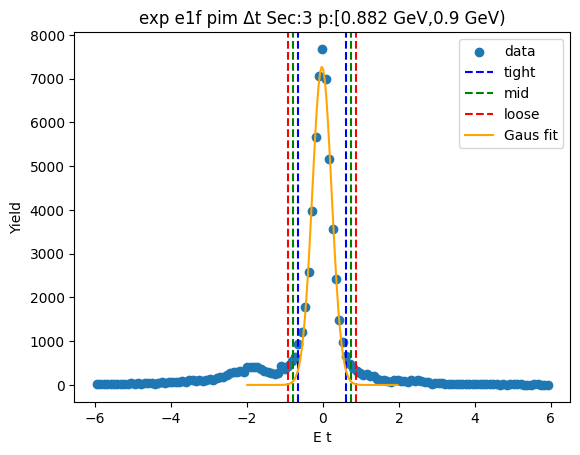

-0.6633617959968177 0.601937371599419
-0.7898917127564413 0.7284672883590426
-0.916421629516065 0.8549972051186663


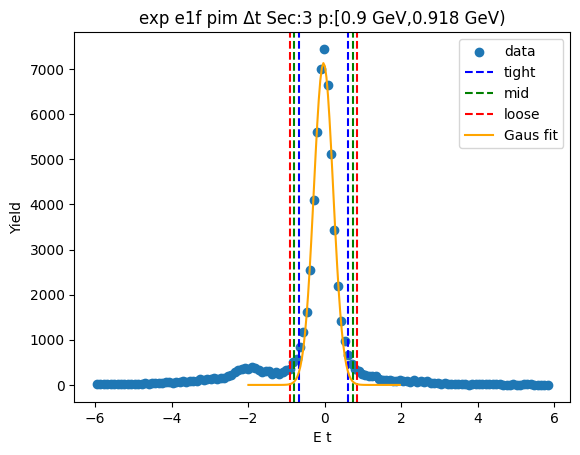

-0.6674984600411331 0.601794699576351
-0.7944277760028816 0.7287240155380995
-0.92135709196463 0.8556533314998479


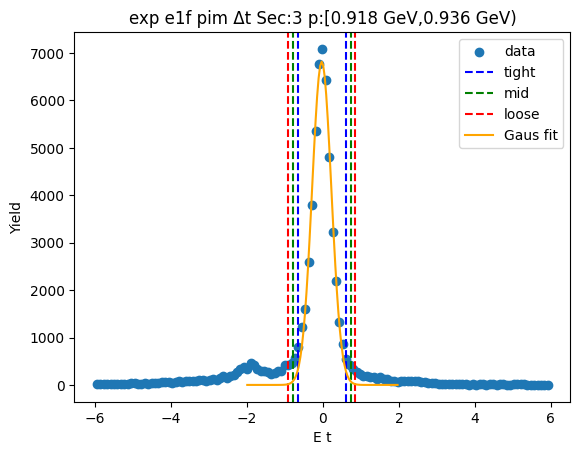

-0.6559097574376942 0.5986356776313269
-0.7813643009445963 0.724090221138229
-0.9068188444514984 0.8495447646451311


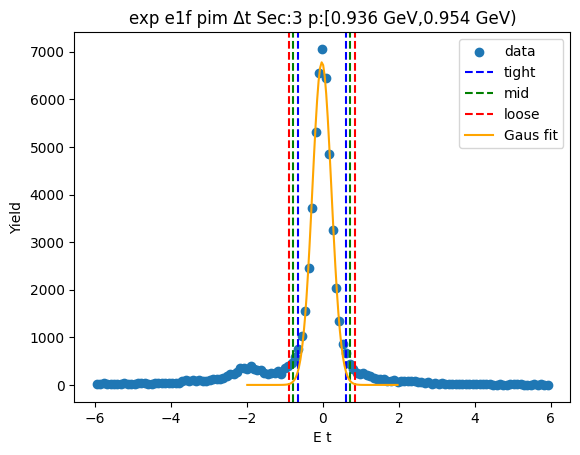

-0.6541165260728082 0.5835101054026838
-0.7778791892203575 0.707272768550233
-0.9016418523679066 0.8310354316977822


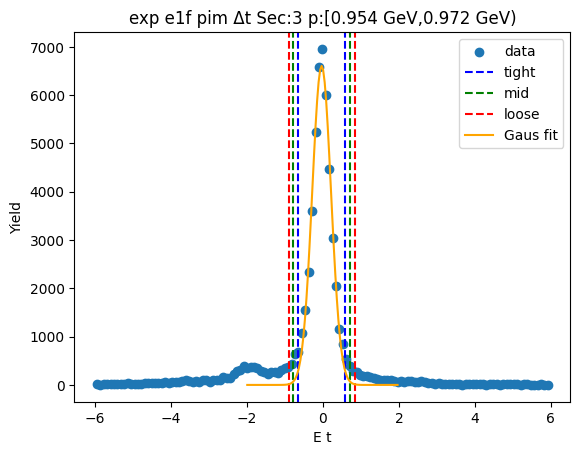

-0.6675642173510254 0.600988740784542
-0.7944195131645823 0.7278440365980988
-0.9212748089781391 0.8546993324116556


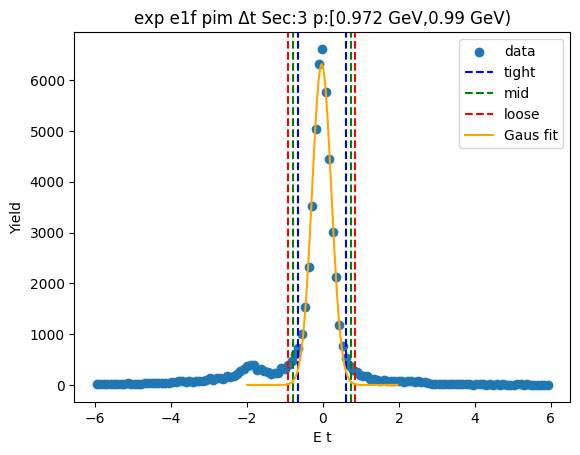

-0.6528374770873467 0.5875905941375564
-0.776880284209837 0.7116334012600467
-0.9009230913323274 0.8356762083825371


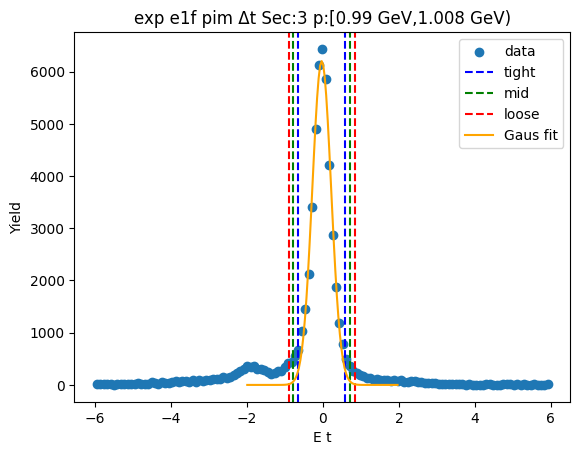

-0.6546011891364407 0.5958677609631375
-0.7796480841463986 0.7209146559730955
-0.9046949791563564 0.8459615509830533


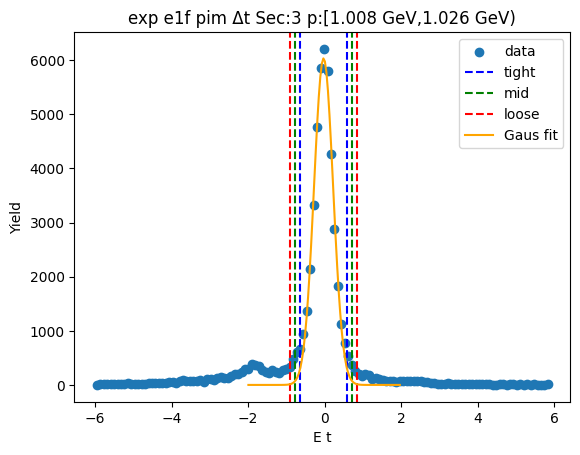

-0.6532144958898153 0.5839629645604939
-0.7769322419348462 0.7076807106055248
-0.9006499879798772 0.8313984566505558


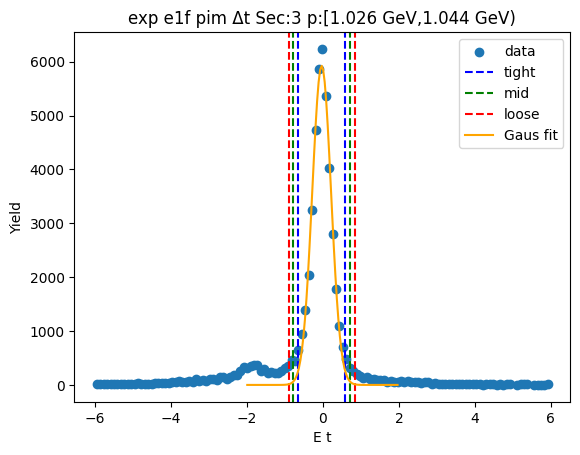

-0.6540398324243234 0.5875635088711016
-0.7782001665538659 0.7117238430006442
-0.9023605006834085 0.8358841771301867


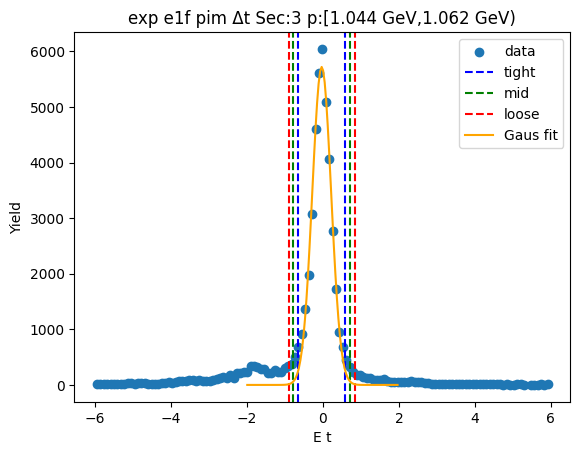

-0.6700819149908545 0.6024003460471857
-0.7973301410946584 0.7296485721509897
-0.9245783671984624 0.8568967982547937


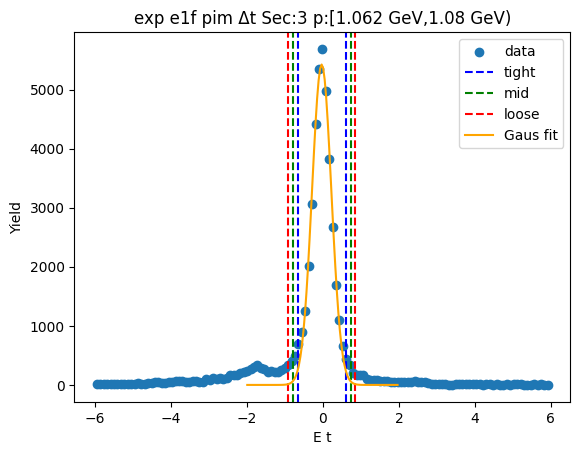

-0.6555715851275863 0.5902194446378424
-0.7801506881041291 0.7147985476143852
-0.904729791080672 0.8393776505909281


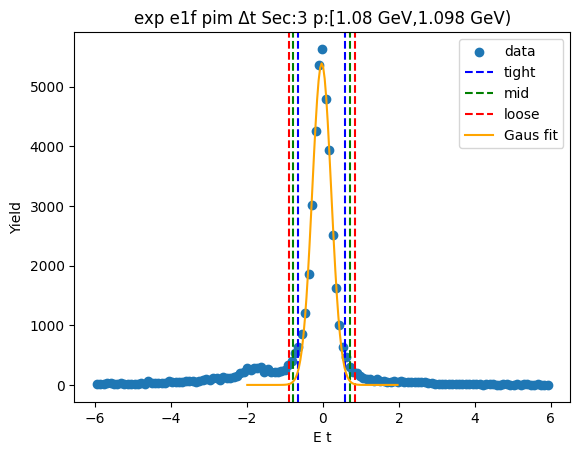

-0.6427354494329682 0.5697070035929401
-0.7639796947355592 0.6909512488955311
-0.88522394003815 0.8121954941981219


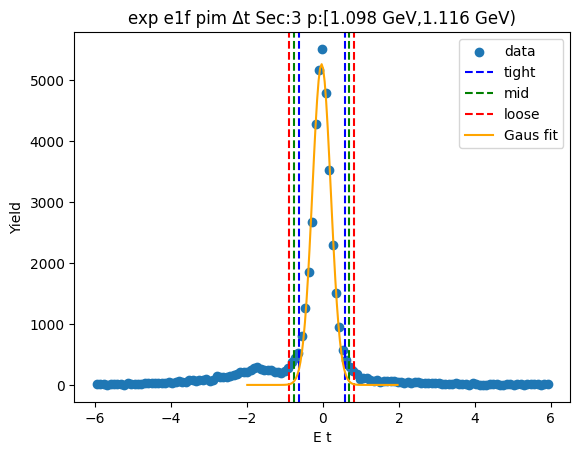

-0.6521209004093853 0.5795395412524349
-0.7752869445755672 0.7027055854186168
-0.8984529887417493 0.8258716295847989


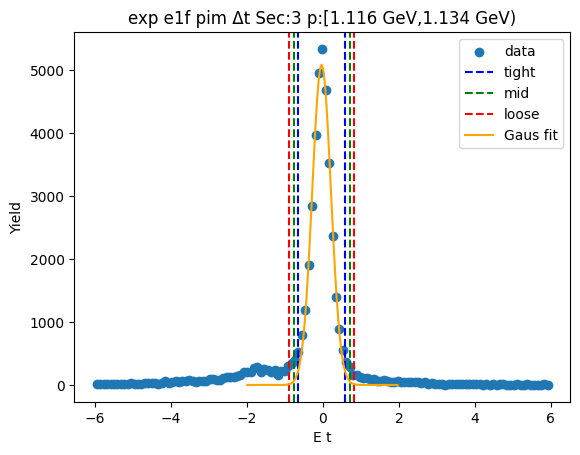

-0.6523829030460426 0.5888675162378636
-0.7765079449744332 0.7129925581662542
-0.9006329869028239 0.8371176000946449


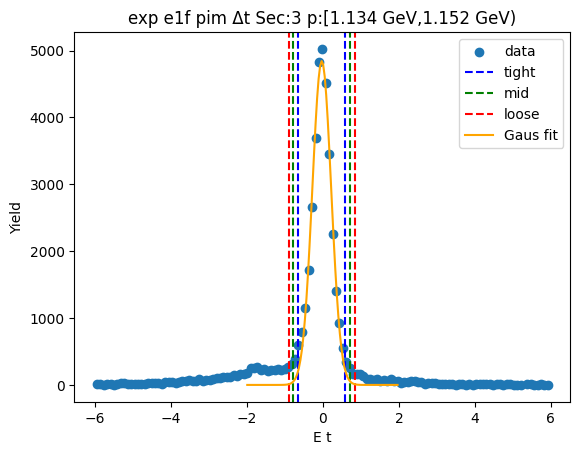

-0.6629260539650967 0.5857476182939207
-0.7877934211909985 0.7106149855198225
-0.9126607884169002 0.8354823527457242


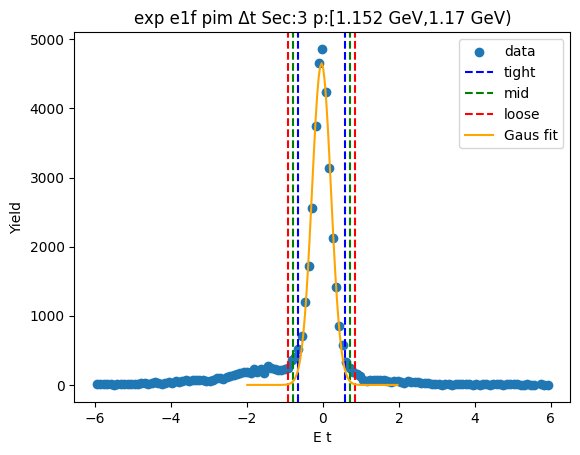

-0.6444460712701008 0.5720044386517387
-0.7660911222622848 0.6936494896439227
-0.8877361732544687 0.8152945406361066


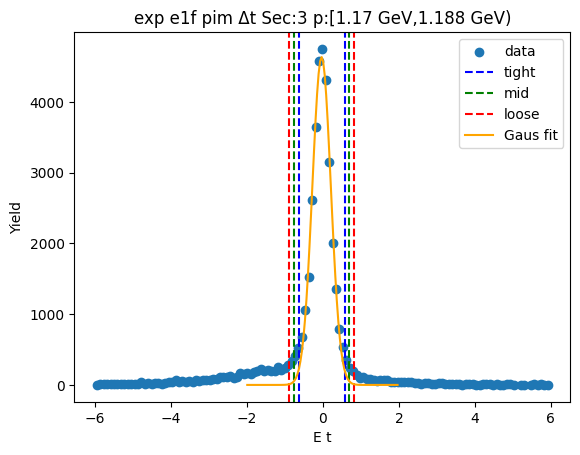

-0.6523817353105503 0.5744036738761891
-0.7750602762292244 0.6970822147948631
-0.8977388171478983 0.819760755713537


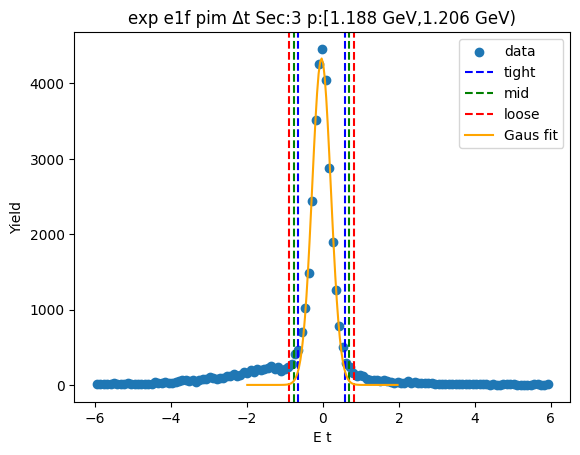

-0.64277565864386 0.5743096315226797
-0.764484187660514 0.6960181605393336
-0.8861927166771679 0.8177266895559876


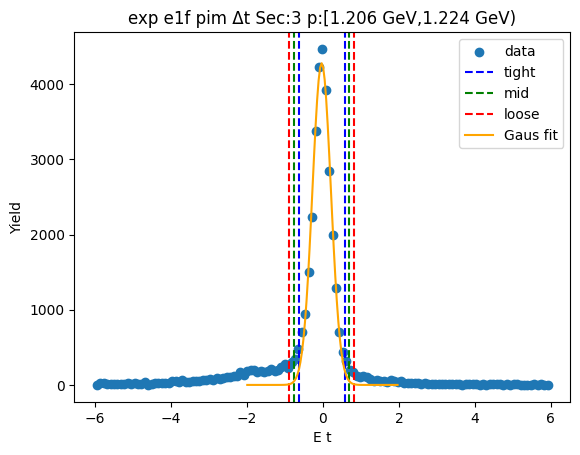

-0.632604772945672 0.5699185831993444
-0.7528571085601736 0.6901709188138461
-0.8731094441746753 0.8104232544283477


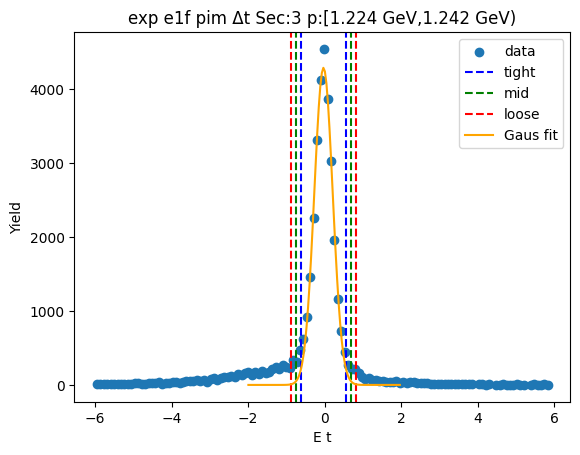

-0.6213971769600255 0.5635841112712463
-0.7398953057831527 0.6820822400943735
-0.8583934346062798 0.8005803689175006


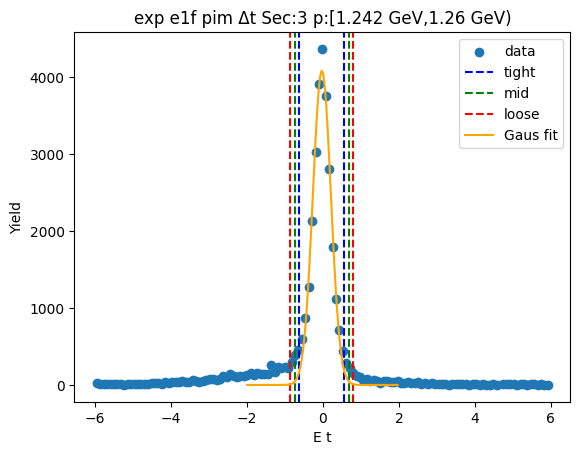

-0.621537122707546 0.5625546309754125
-0.7399462980758419 0.6809638063437083
-0.8583554734441378 0.7993729817120042


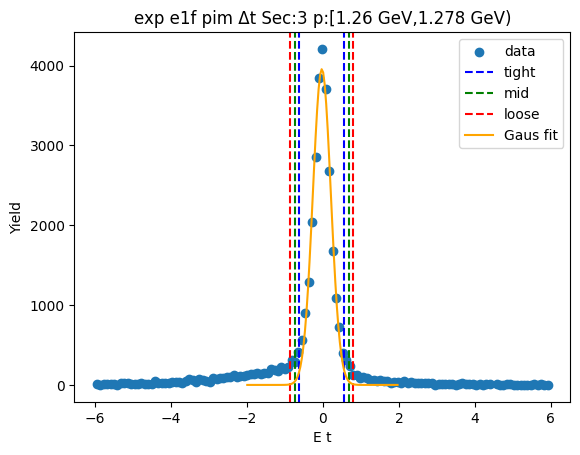

-0.6285389881628188 0.5702873633118869
-0.7484216233102895 0.6901699984593576
-0.86830425845776 0.8100526336068281


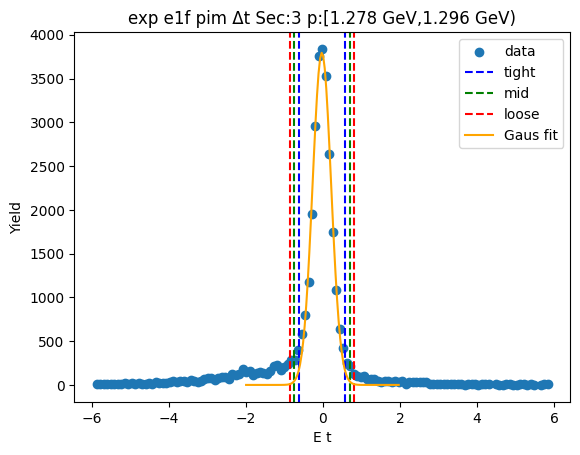

-0.6412440142932738 0.5658204733084538
-0.7619504630534465 0.6865269220686264
-0.8826569118136193 0.8072333708287992


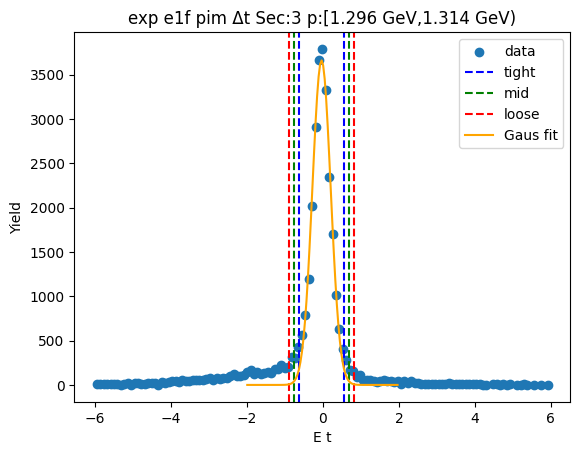

-0.6235328015384404 0.5584370672026583
-0.7417297884125503 0.6766340540767682
-0.8599267752866602 0.7948310409508781


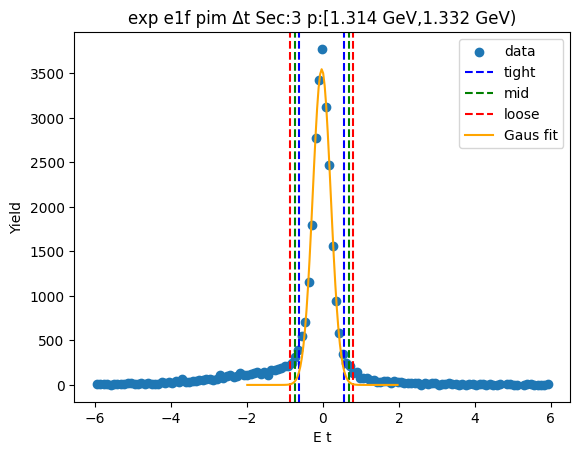

-0.6223825087053848 0.554014169984495
-0.7400221765743727 0.671653837853483
-0.8576618444433608 0.789293505722471


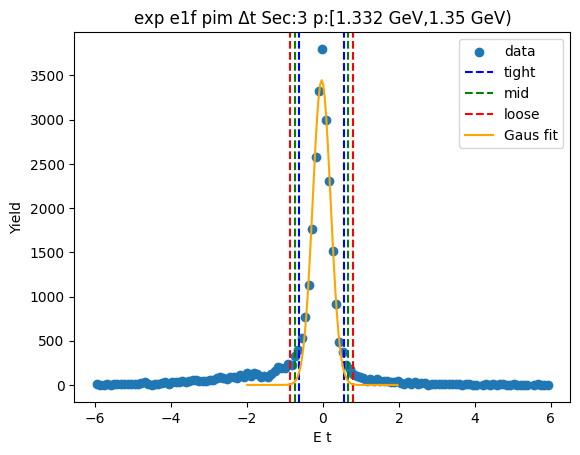

-0.6333587891282504 0.5701055304940548
-0.753705221090481 0.6904519624562854
-0.8740516530527115 0.8107983944185159


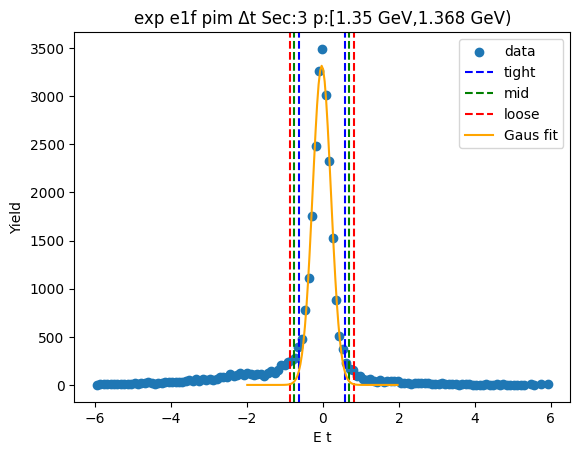

-0.6309250342191941 0.5594806047580059
-0.7499655981169141 0.6785211686557259
-0.8690061620146341 0.7975617325534459


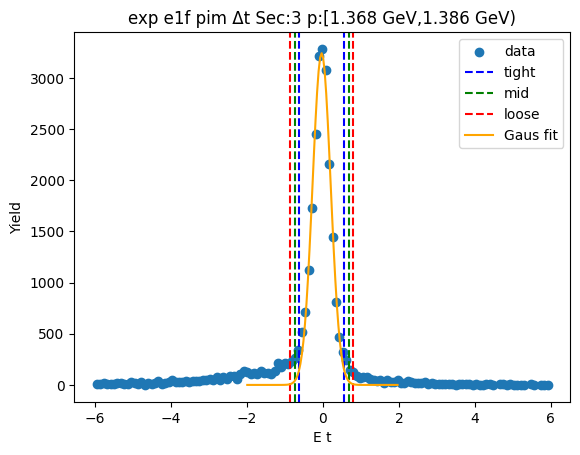

-0.6388714996202817 0.5659185706072137
-0.7593505066430312 0.6863975776299632
-0.8798295136657808 0.8068765846527128


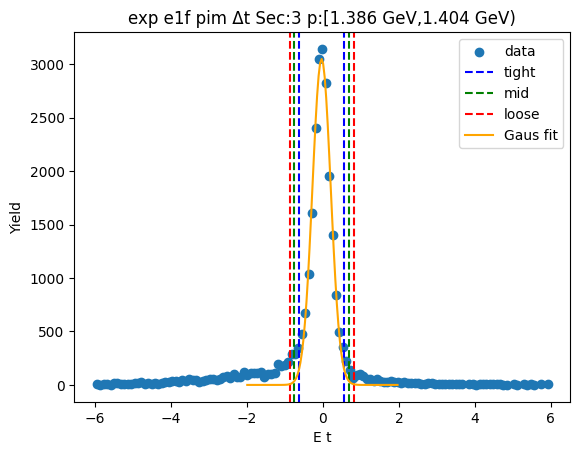

-0.6378629956665981 0.5639330307058698
-0.7580425983038449 0.6841126333431166
-0.8782222009410917 0.8042922359803634


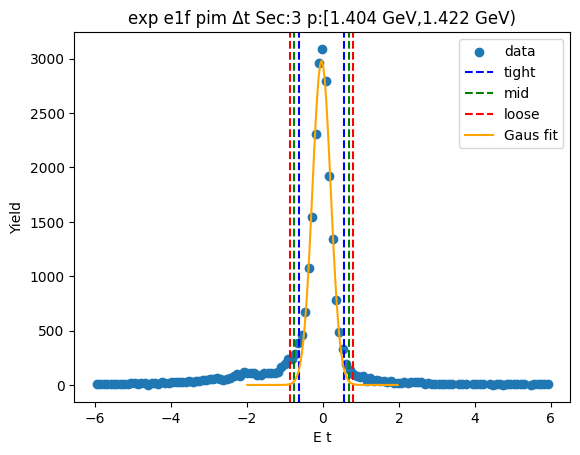

-0.6086034843787509 0.5366556732795682
-0.7231294001445827 0.6511815890454
-0.8376553159104146 0.765707504811232


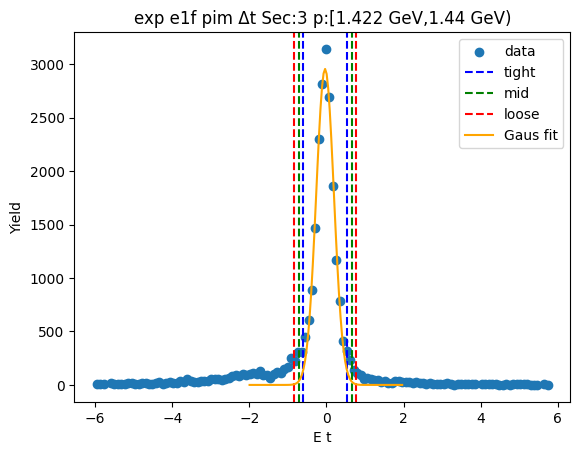

-0.6057464069601057 0.5405910657691437
-0.7203801542330307 0.6552248130420687
-0.8350139015059557 0.7698585603149937


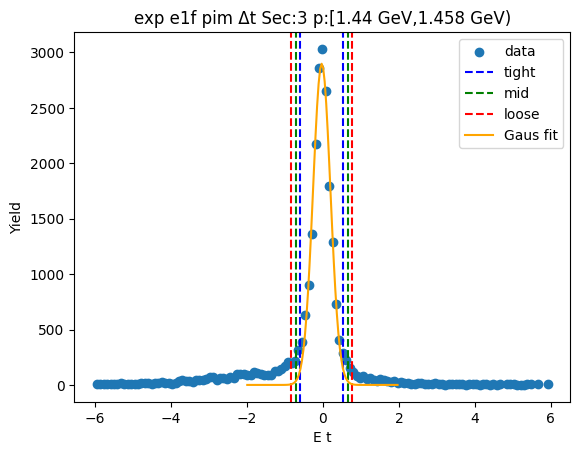

-0.6193323451218598 0.5602314575560252
-0.7372887253896482 0.6781878378238136
-0.8552451056574366 0.7961442180916021


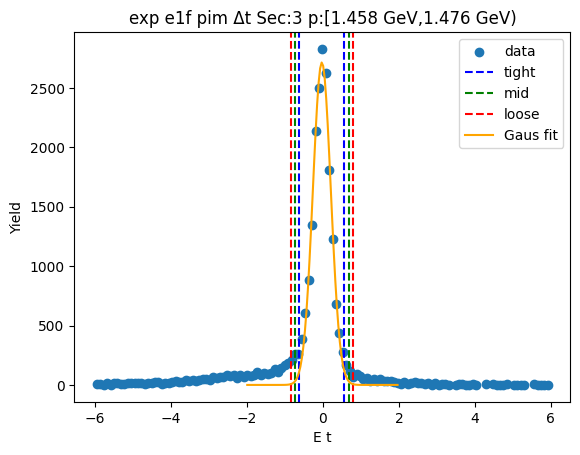

-0.638294572924526 0.5660444069267099
-0.7587284709096496 0.6864783049118335
-0.8791623688947732 0.8069122028969571


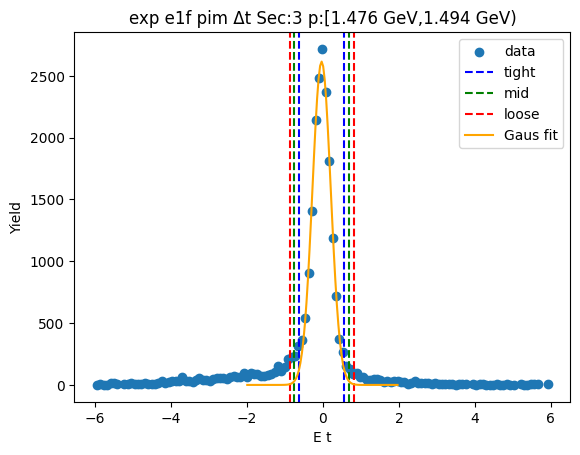

-0.6080109229749134 0.5575603463233282
-0.7245680499047376 0.6741174732531523
-0.8411251768345618 0.7906746001829765


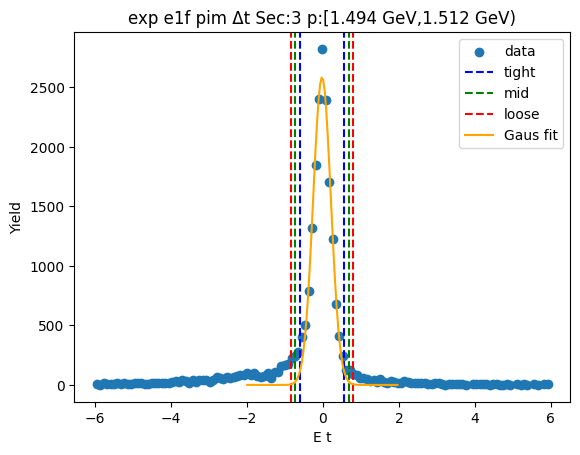

-0.6324644550607454 0.557406133473134
-0.7514515139141333 0.6763931923265218
-0.8704385727675213 0.7953802511799098


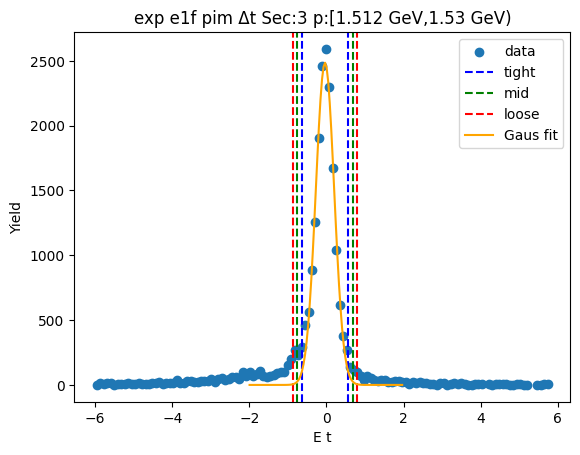

-0.6306279383853486 0.5596038697800254
-0.749651119201886 0.6786270505965628
-0.8686743000184234 0.7976502314131002


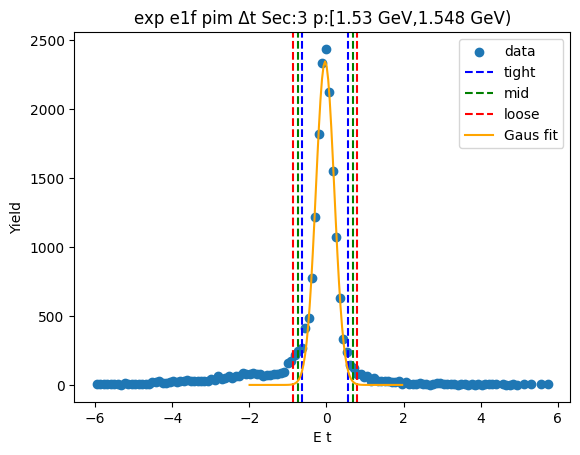

-0.6133002490555888 0.5546685211682059
-0.7300971260779683 0.6714653981905854
-0.8468940031003477 0.7882622752129648


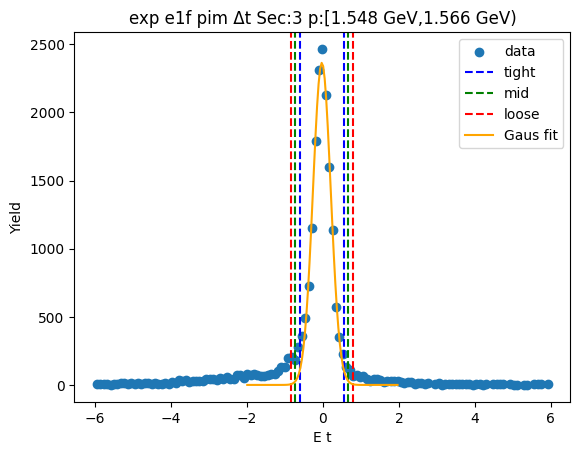

-0.6305606965999254 0.5537139295285914
-0.7489881592127771 0.6721413921414431
-0.8674156218256288 0.7905688547542948


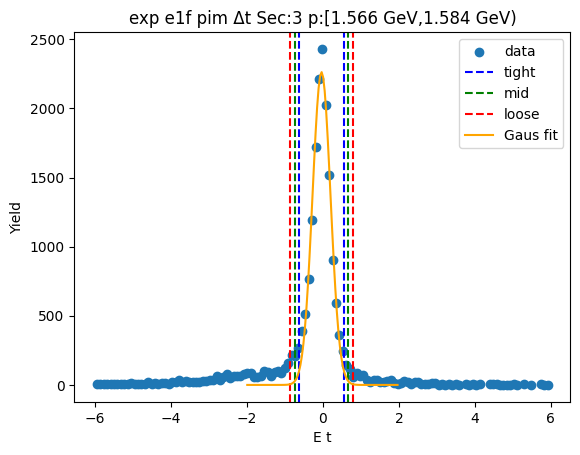

-0.6064755044069802 0.5359035977541778
-0.720713414623096 0.6501415079702937
-0.8349513248392118 0.7643794181864094


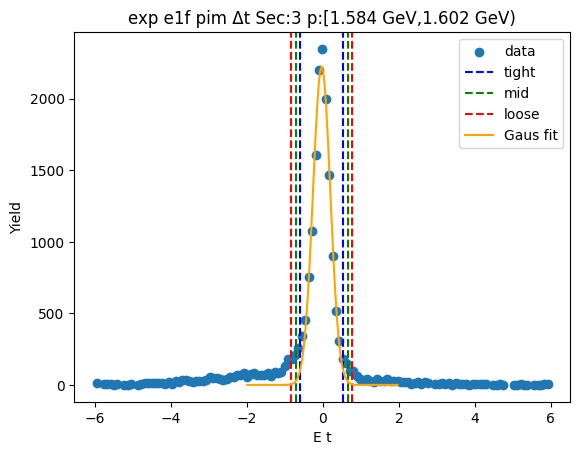

-0.599327244774644 0.5404319563377808
-0.7133031648858866 0.6544078764490234
-0.8272790849971291 0.7683837965602659


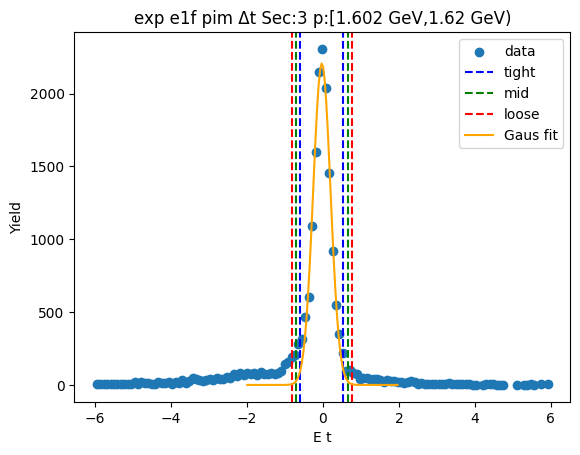

-0.5916812292140567 0.5328414776561645
-0.7041334999010789 0.6452937483431866
-0.816585770588101 0.7577460190302088


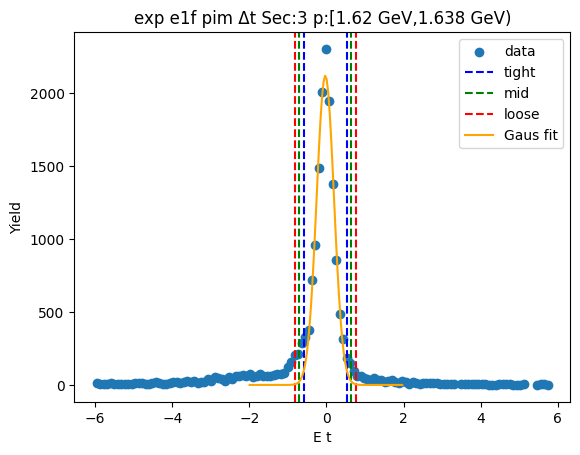

-0.622318990902545 0.5605539090790188
-0.7406062809007015 0.6788411990771752
-0.8588935708988579 0.7971284890753316


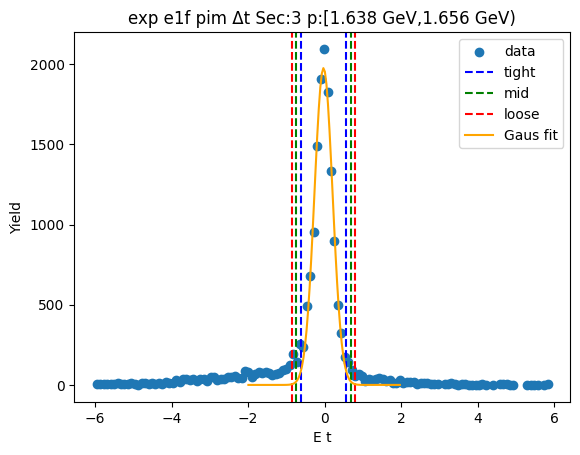

-0.6070775849859718 0.5349786979498674
-0.7212832132795557 0.6491843262434513
-0.8354888415731396 0.7633899545370353


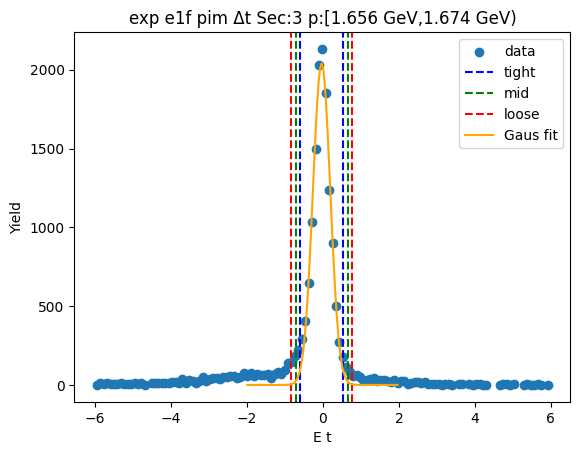

-0.613895216258053 0.5549388048624319
-0.7307786183701015 0.6718222069744804
-0.84766202048215 0.7887056090865289


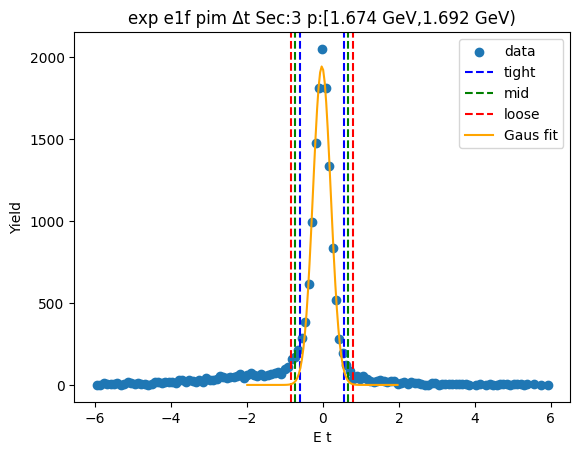

-0.6103780411534231 0.5424614848398409
-0.7256619937527495 0.6577454374391674
-0.8409459463520759 0.7730293900384937


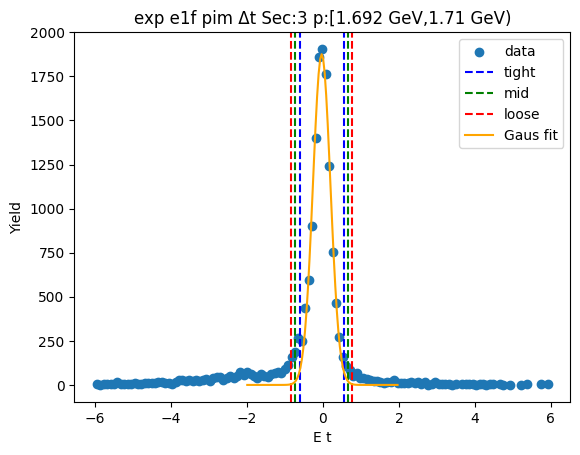

-0.5872265098708204 0.5298861813763015
-0.6989377789955326 0.6415974505010137
-0.8106490481202447 0.7533087196257259


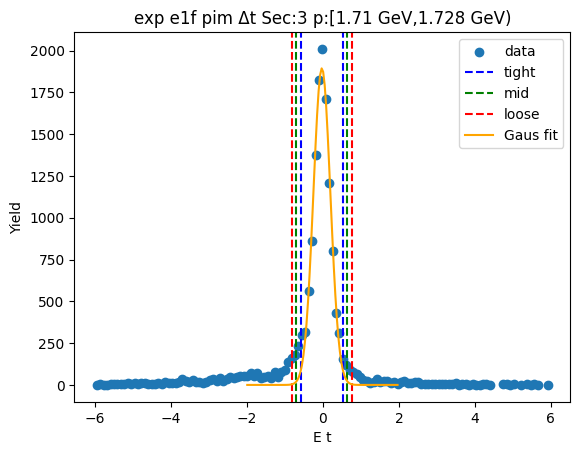

-0.5970929268922139 0.5350255681014032
-0.7103047763915756 0.6482374176007649
-0.8235166258909373 0.7614492671001266


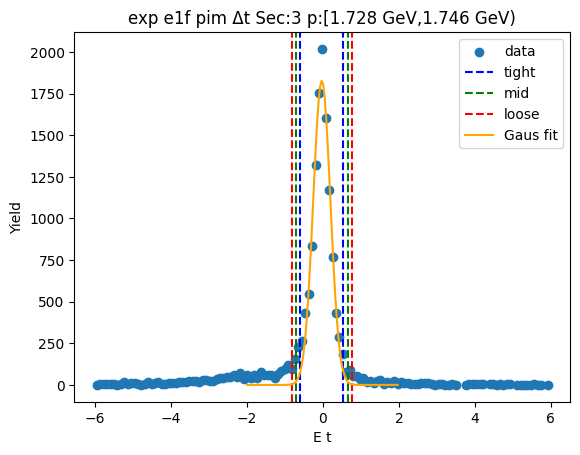

-0.5941908189790391 0.5283066024054396
-0.7064405611174871 0.6405563445438875
-0.818690303255935 0.7528060866823354


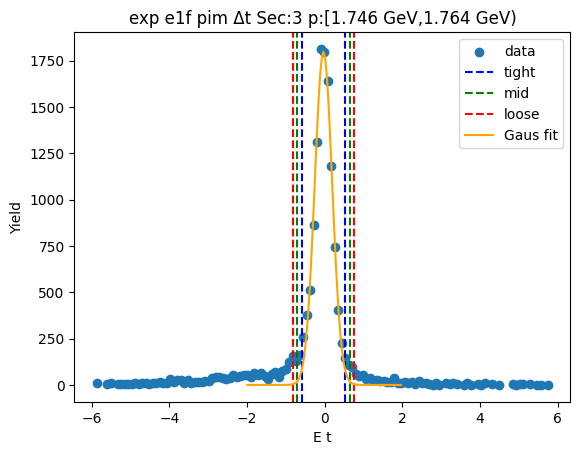

-0.5901165118032329 0.528589068965737
-0.7019870698801298 0.6404596270426339
-0.8138576279570269 0.752330185119531


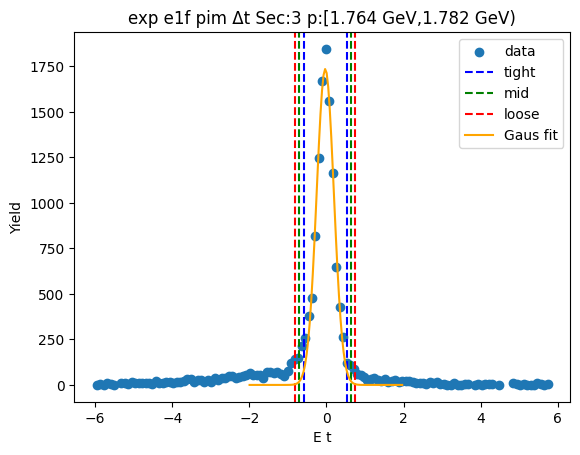

-0.6180623729148234 0.5598960429826148
-0.7358582145045672 0.6776918845723586
-0.8536540560943111 0.7954877261621025


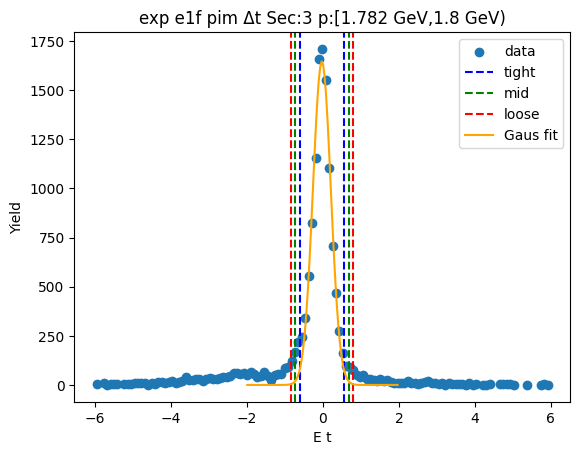

-0.5920293084225695 0.5257299046768183
-0.7038052297325083 0.6375058259867571
-0.8155811510424471 0.7492817472966959


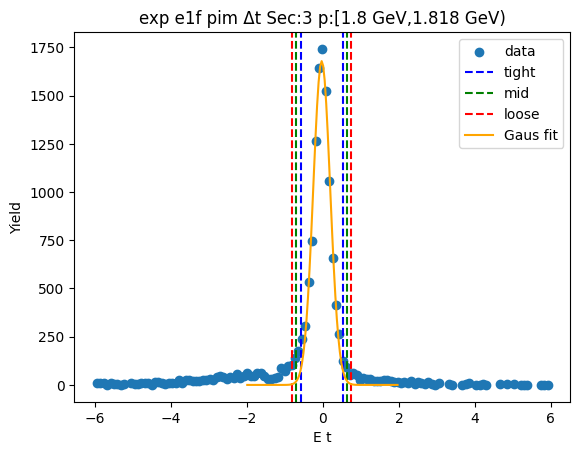

-0.5760698914538795 0.5209271274094356
-0.685769593340211 0.6306268292957671
-0.7954692952265425 0.7403265311820986


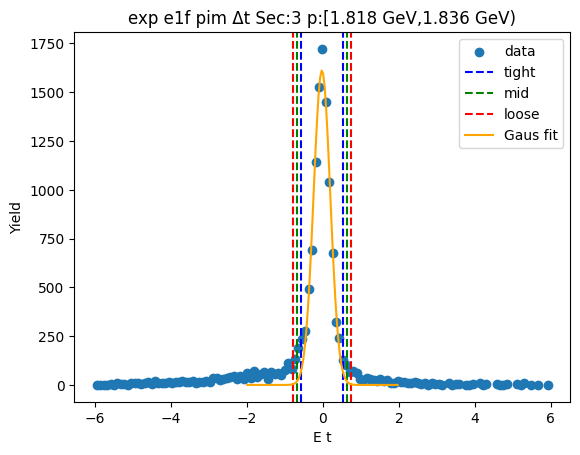

-0.5899690082758026 0.5390916698063731
-0.7028750760840202 0.6519977376145908
-0.8157811438922378 0.7649038054228083


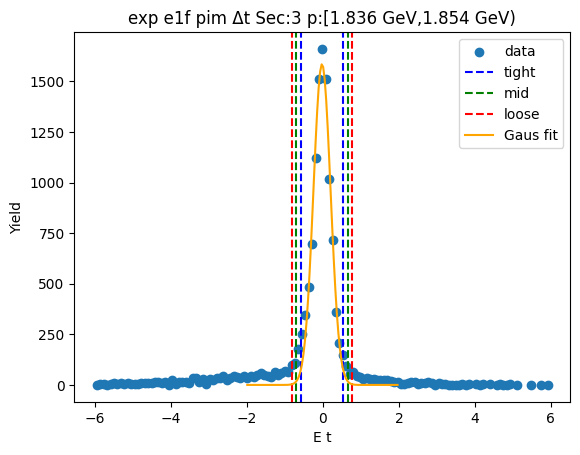

-0.5834196168795649 0.5152833558516647
-0.6932899141526878 0.6251536531247877
-0.8031602114258108 0.7350239503979107


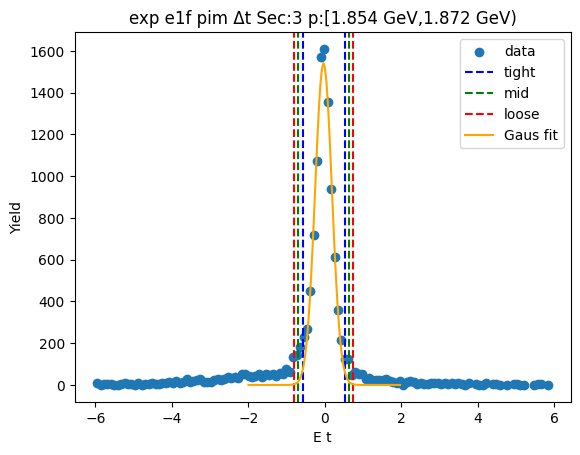

-0.555148562977933 0.5002586330506195
-0.6606892825807882 0.6057993526534746
-0.7662300021836435 0.7113400722563299


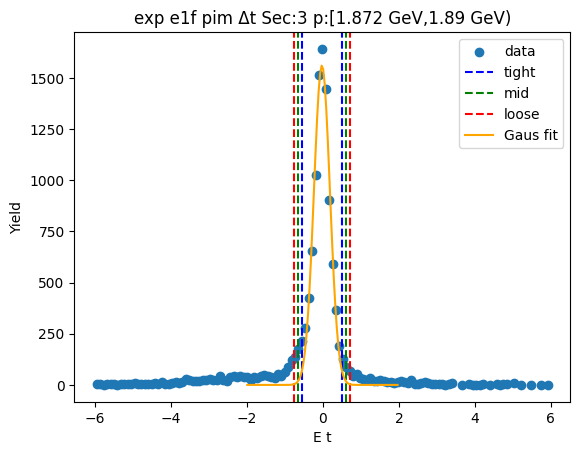

-0.5565606875269482 0.4918536318134876
-0.6614021194609918 0.5966950637475312
-0.7662435513950354 0.7015364956815748


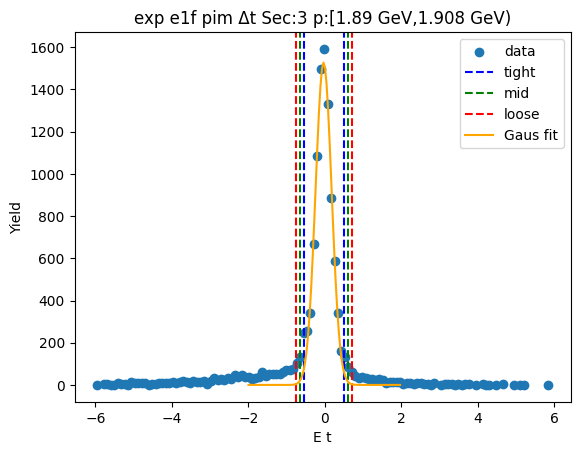

-0.5800762648335632 0.5171045264639992
-0.6897943439633195 0.6268226055937555
-0.7995124230930757 0.7365406847235116


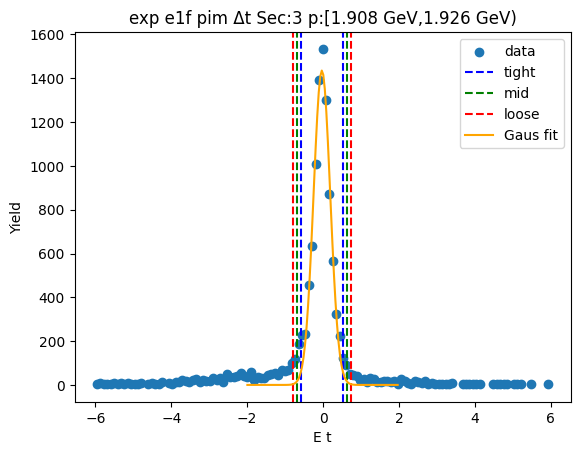

-0.5925217110738578 0.5297919478426459
-0.704753076965508 0.6420233137342962
-0.8169844428571584 0.7542546796259466


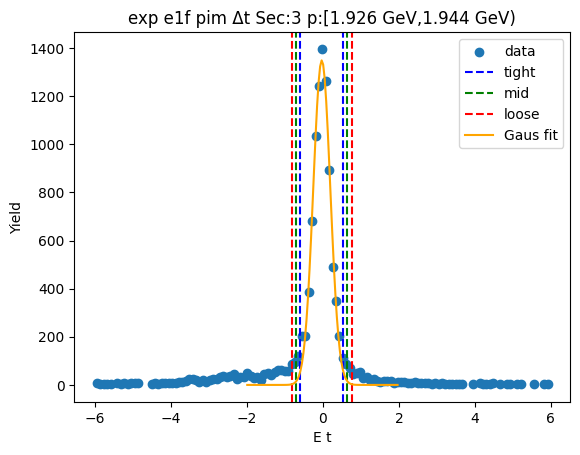

-0.5925660716022007 0.5420554693243359
-0.7060282256948544 0.6555176234169896
-0.8194903797875079 0.7689797775096432


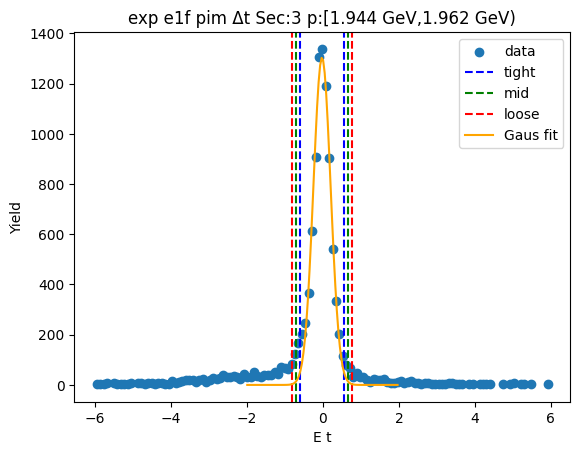

-0.5643019151380678 0.5167761870943194
-0.6724097253613065 0.6248839973175581
-0.7805175355845453 0.7329918075407968


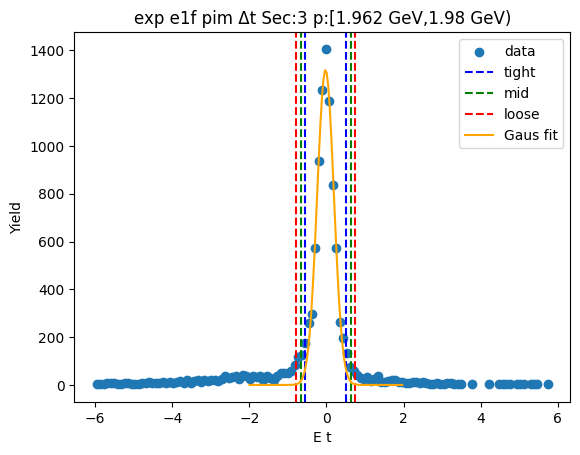

-0.5664914806042255 0.5090980023783994
-0.674050428902488 0.6166569506766619
-0.7816093772007505 0.7242158989749244


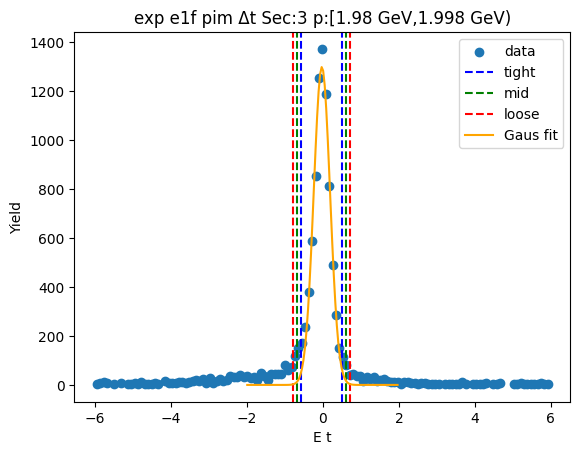

-0.5715246448053347 0.5193088819827204
-0.6806079974841402 0.6283922346615259
-0.7896913501629458 0.7374755873403315


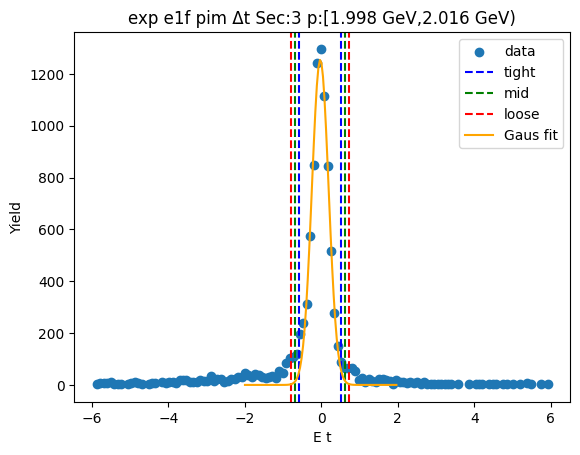

-0.558988571001658 0.5056864606149072
-0.6654560741633144 0.6121539637765636
-0.771923577324971 0.7186214669382202


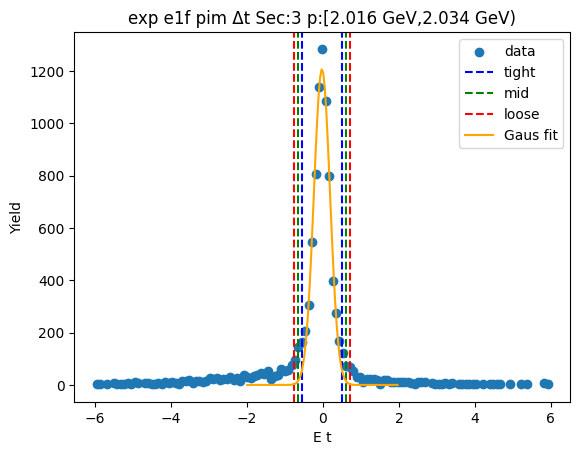

-0.5729558214566783 0.5250217711685923
-0.6827535807192054 0.6348195304311194
-0.7925513399817324 0.7446172896936464


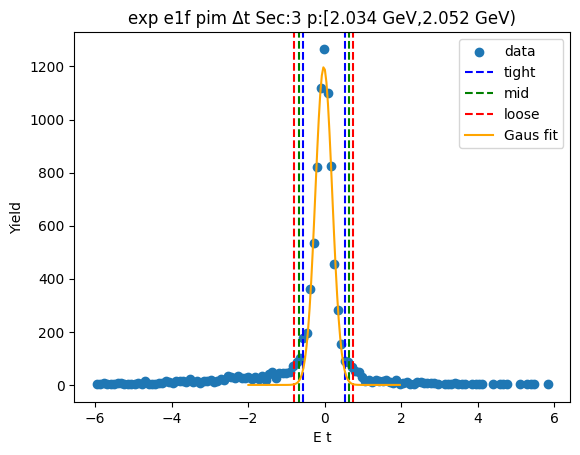

-0.5975708566908055 0.5271581348968551
-0.7100437558495716 0.6396310340556213
-0.8225166550083377 0.7521039332143874


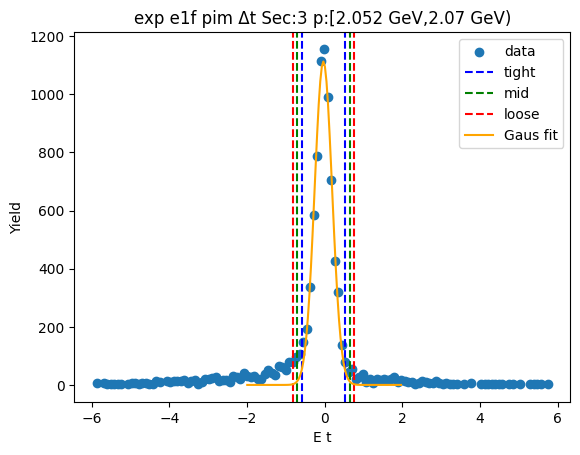

-0.5763240498532517 0.5183769879587855
-0.6857941536344555 0.6278470917399893
-0.7952642574156592 0.737317195521193


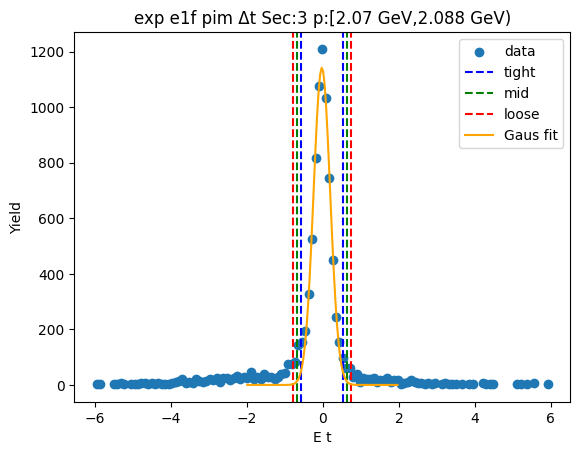

-0.5630343834855751 0.5081695828217427
-0.6701547801163068 0.6152899794524744
-0.7772751767470387 0.7224103760832061


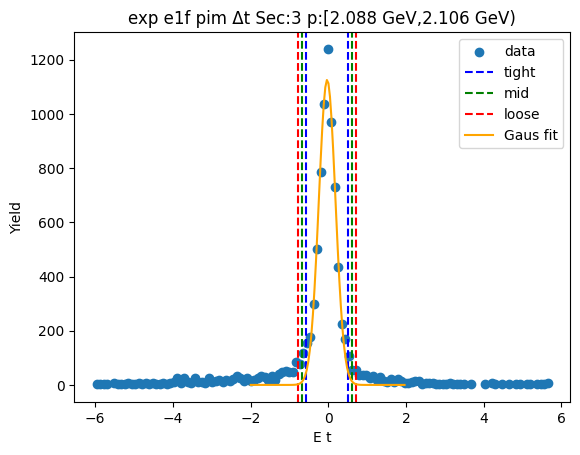

-0.5456405913302661 0.4900671401885056
-0.6492113644821432 0.5936379133403827
-0.7527821376340205 0.69720868649226


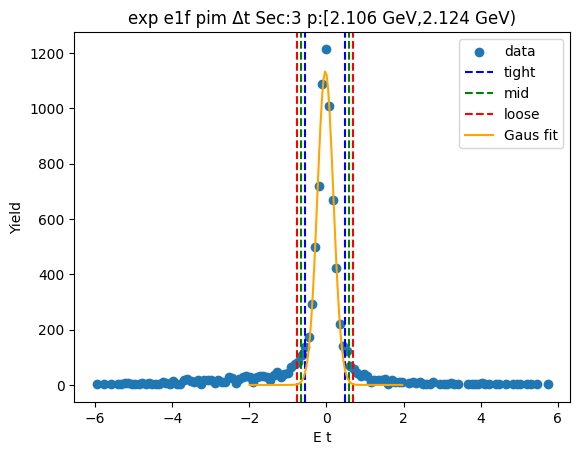

-0.5614458578253172 0.5173093559240847
-0.6693213792002575 0.6251848772990249
-0.7771969005751976 0.7330603986739651


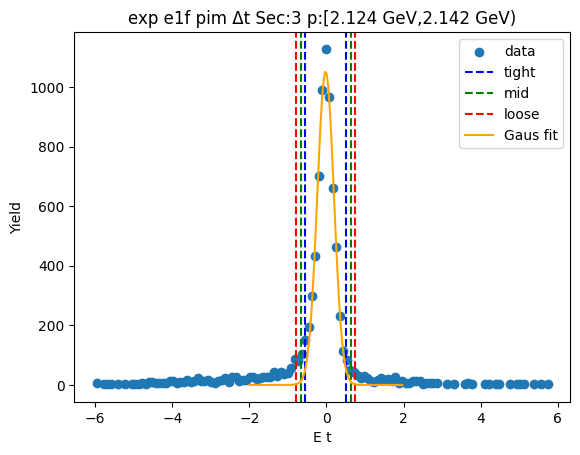

-0.5742032306345469 0.5231553309039808
-0.6839390867883997 0.6328911870578335
-0.7936749429422525 0.7426270432116864


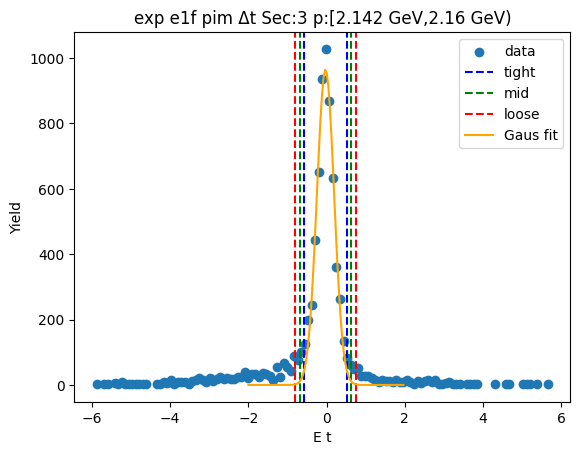

-0.5777118954881734 0.5289516292195554
-0.6883782479589462 0.6396179816903282
-0.7990446004297191 0.7502843341611012


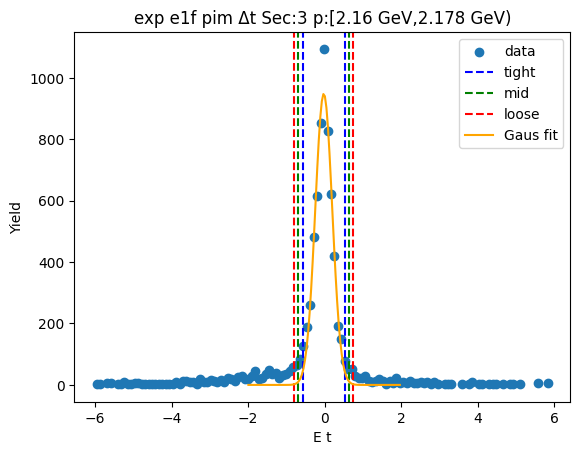

-0.5537533519095205 0.5086610605170984
-0.6599947931521823 0.6149025017597602
-0.7662362343948442 0.7211439430024221


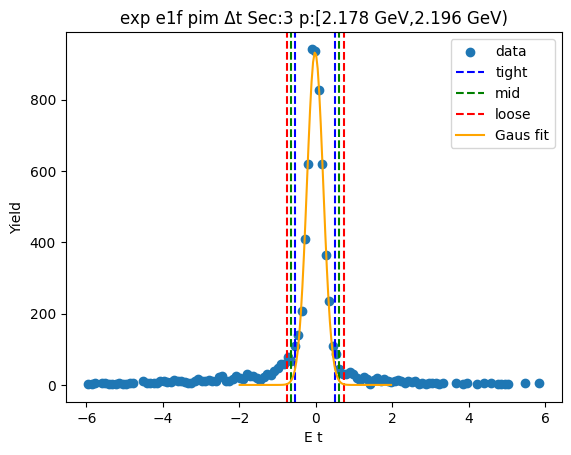

-0.570847445841494 0.5120934972042606
-0.6791415401460694 0.6203875915088359
-0.7874356344506449 0.7286816858134114


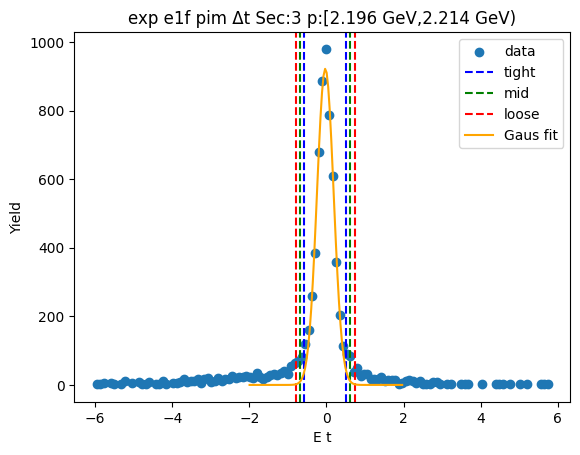

-0.5314431882572273 0.48959870641019915
-0.6335473777239699 0.5917028958769418
-0.7356515671907126 0.6938070853436845


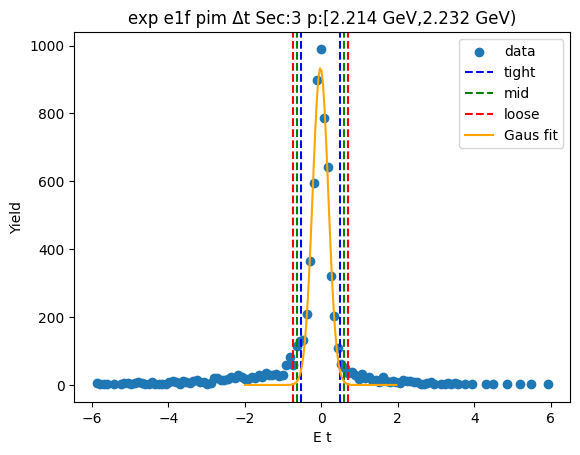

-0.5629988367698536 0.49569043383301403
-0.6688677638301403 0.6015593608933008
-0.7747366908904272 0.7074282879535876


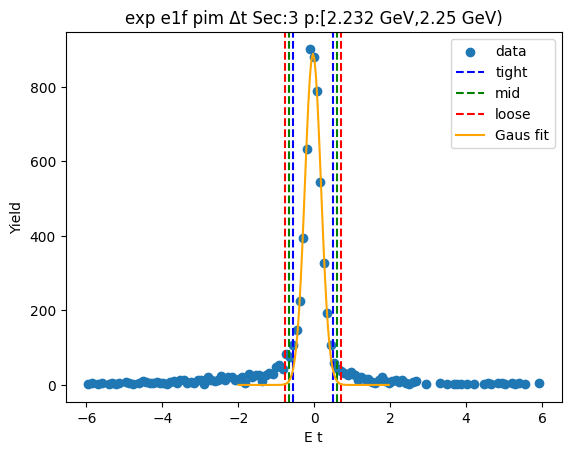

-0.563924686080363 0.5156271082878835
-0.6718798655171876 0.6235822877247081
-0.7798350449540122 0.7315374671615328


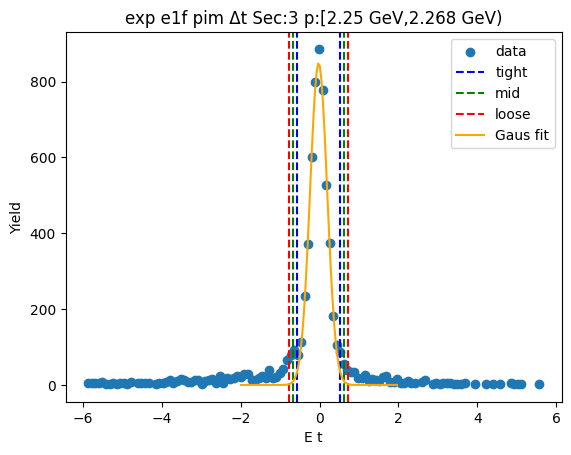

-0.5317936398111677 0.4923205435603168
-0.6342050581483161 0.5947319618974651
-0.7366164764854646 0.6971433802346136


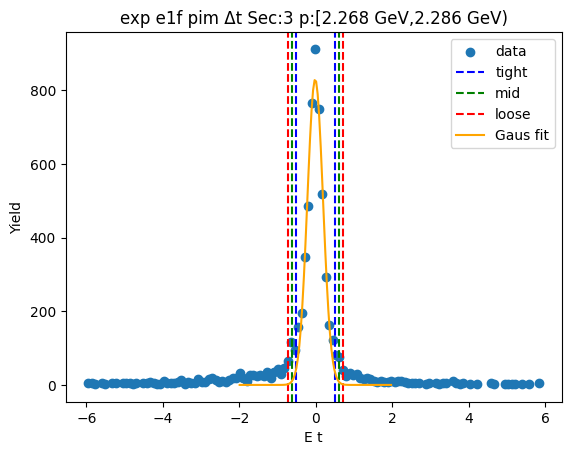

-0.5440754715579577 0.5117352033680111
-0.6496565390505545 0.617316270860608
-0.7552376065431514 0.7228973383532049


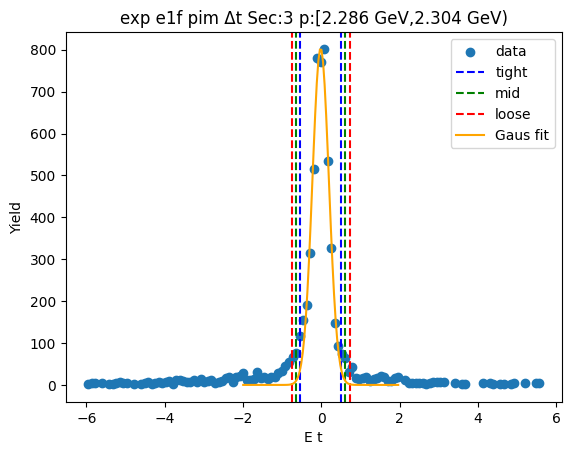

-0.5528507574212324 0.5218858413857058
-0.6603244173019263 0.6293595012663997
-0.76779807718262 0.7368331611470935


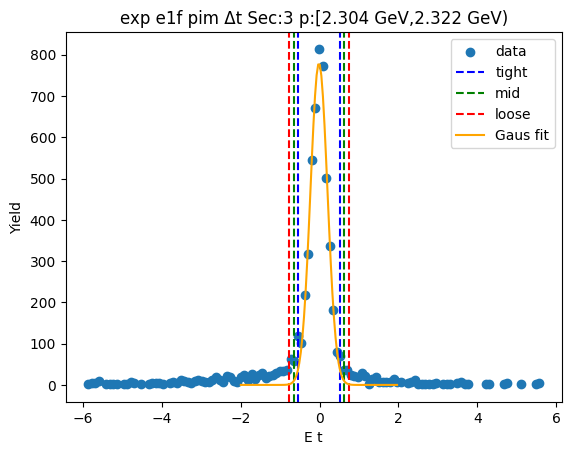

-0.5688558923574389 0.5105715578830303
-0.6767986373814858 0.6185143029070772
-0.7847413824055328 0.7264570479311242


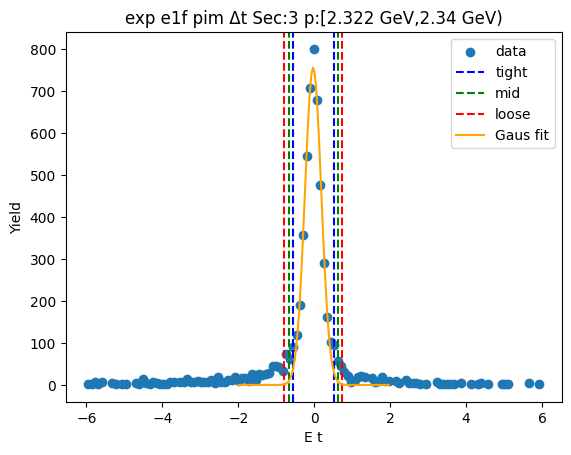

-0.5594082484403259 0.531485131859145
-0.668497586470273 0.6405744698890922
-0.77758692450022 0.7496638079190392


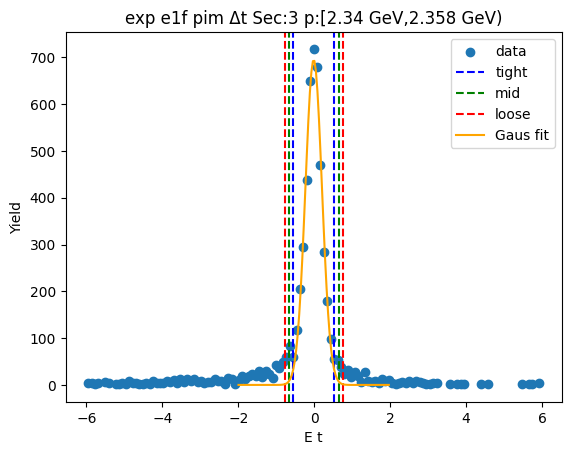

-0.5555931016440884 0.4999117079582867
-0.6611435826043259 0.6054621889185243
-0.7666940635645634 0.7110126698787618


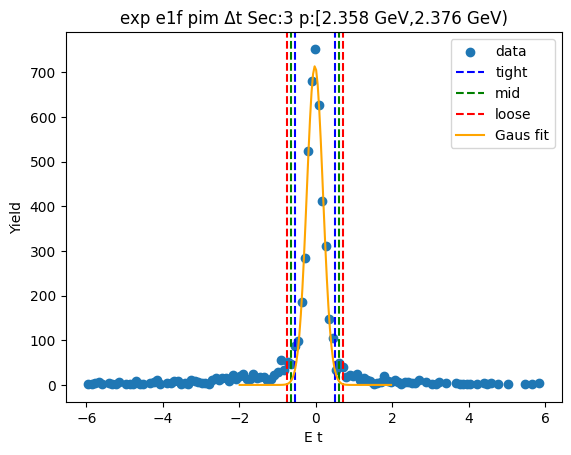

-0.5716119863837924 0.5331713322365731
-0.682090318245829 0.6436496640986097
-0.7925686501078655 0.7541279959606462


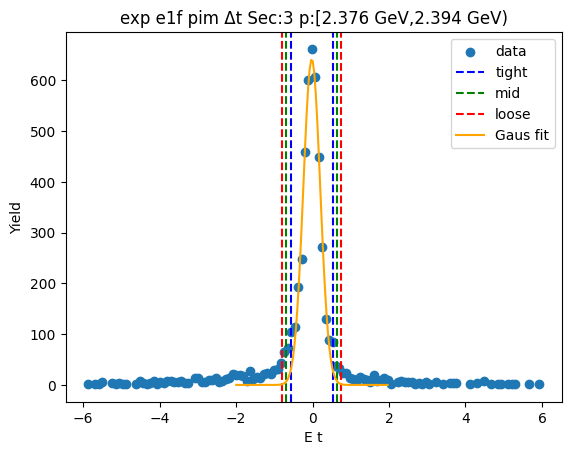

-0.8972459826330421 0.7646140157877748
-1.0634319824751237 0.9308000156298564
-1.2296179823172055 1.0969860154719382


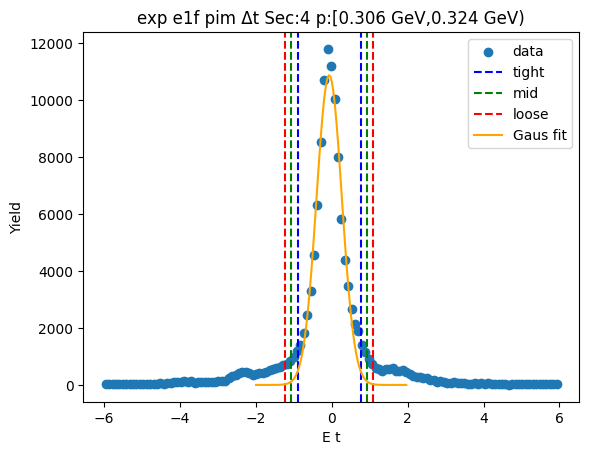

-0.8761972207269768 0.7523159152991765
-1.039048534329592 0.9151672289017919
-1.2018998479322076 1.0780185425044073


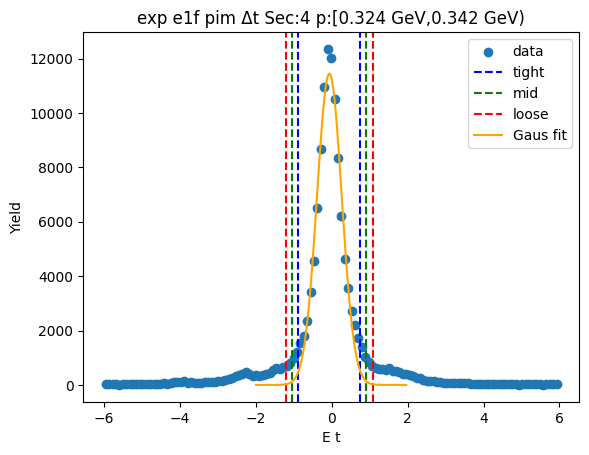

-0.8582444863407904 0.7441835767077379
-1.0184872926456432 0.9044263830125907
-1.1787300989504959 1.0646691893174436


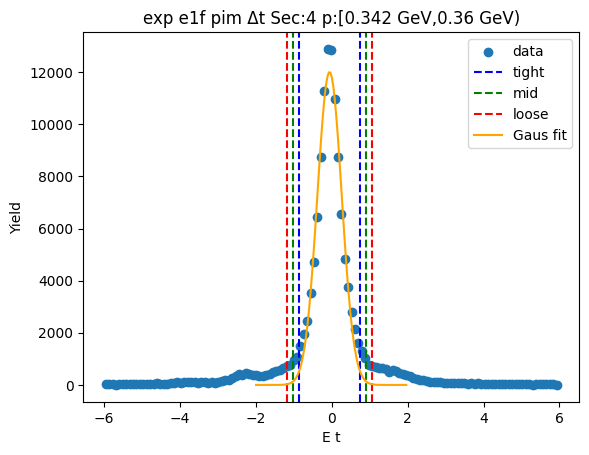

-0.8412220797262782 0.7299954649768903
-0.998343834196595 0.8871172194472071
-1.1554655886669118 1.0442389739175237


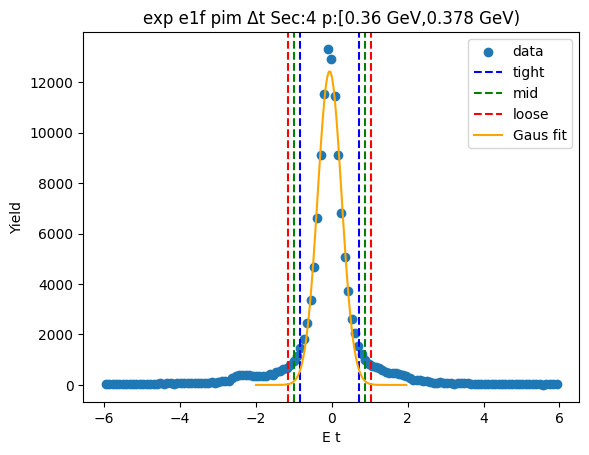

-0.8261872744414428 0.7163262634074316
-0.9804386282263303 0.8705776171923191
-1.1346899820112175 1.0248289709772065


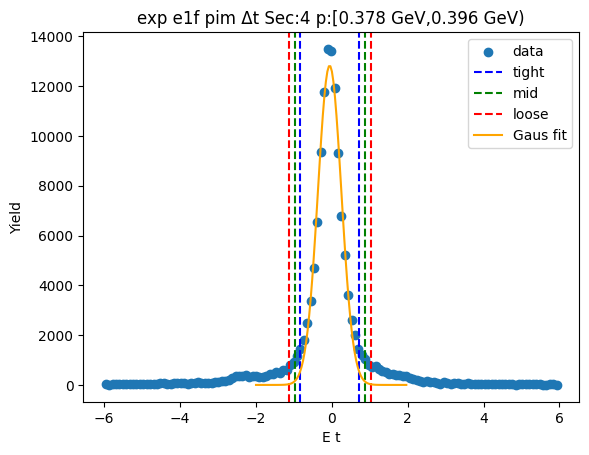

-0.8122449274455859 0.7059004396209752
-0.9640594641522419 0.8577149763276312
-1.1158740008588979 1.0095295130342874


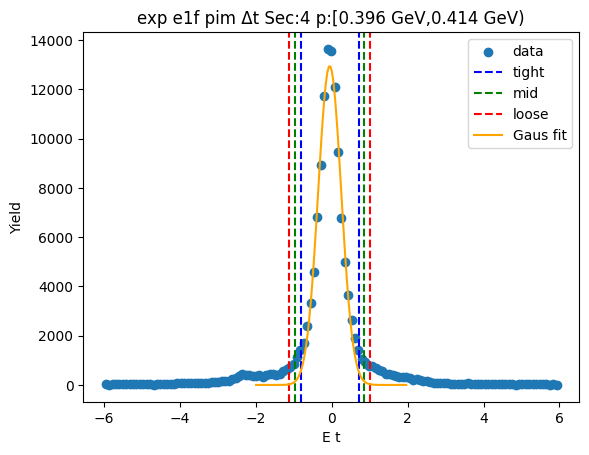

-0.7920337861861465 0.6880926891555298
-0.940046433720314 0.8361053366896973
-1.0880590812544817 0.984117984223865


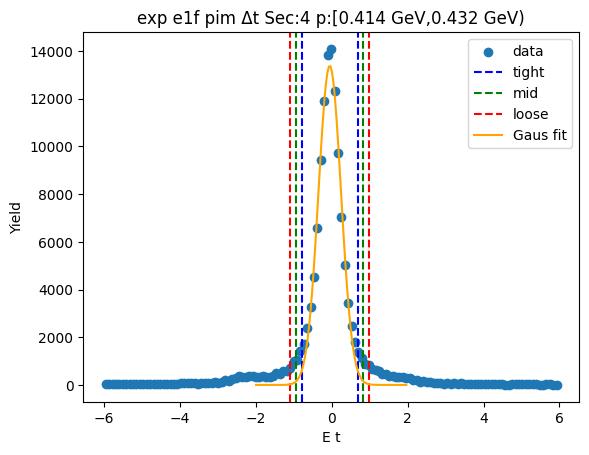

-0.7834448320576727 0.6833153447635275
-0.9301208497397927 0.8299913624456475
-1.0767968674219126 0.9766673801277675


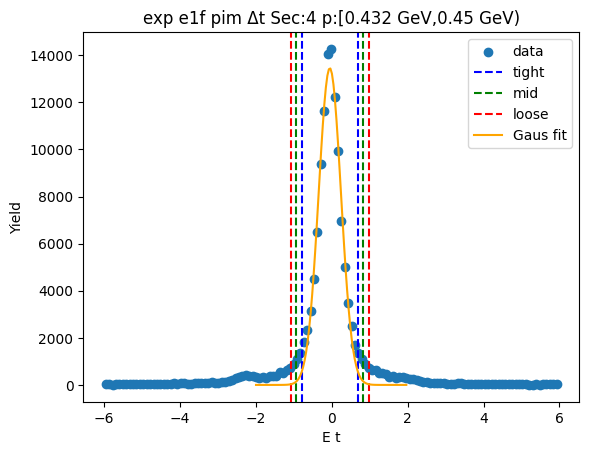

-0.7696531431398307 0.6736887391433503
-0.9139873313681487 0.8180229273716683
-1.058321519596467 0.9623571155999865


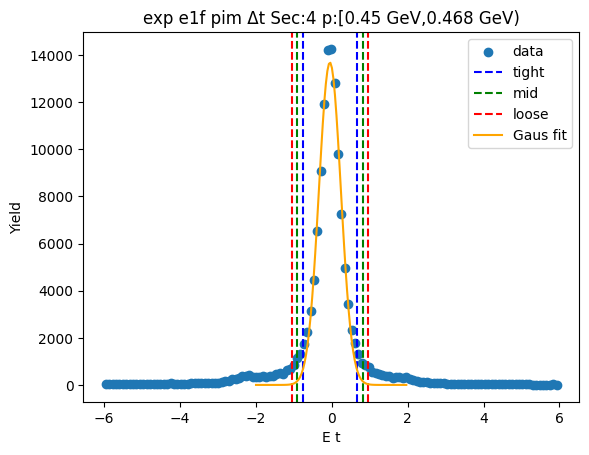

-0.7644591402489926 0.6671958541575307
-0.9076246396896449 0.810361353598183
-1.0507901391302972 0.9535268530388352


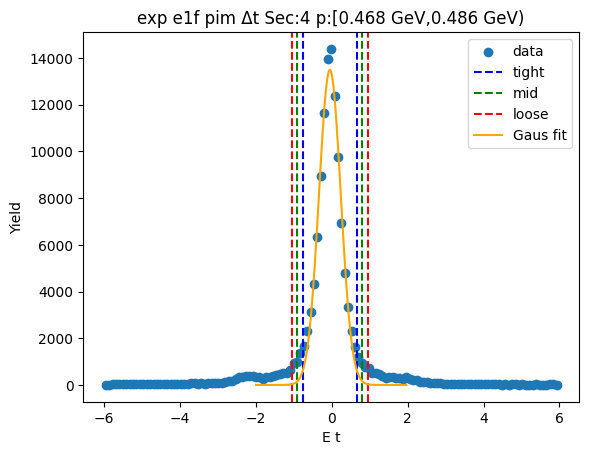

-0.7545627342553407 0.6648042157832177
-0.8964994292591966 0.8067409107870733
-1.0384361242630524 0.9486776057909292


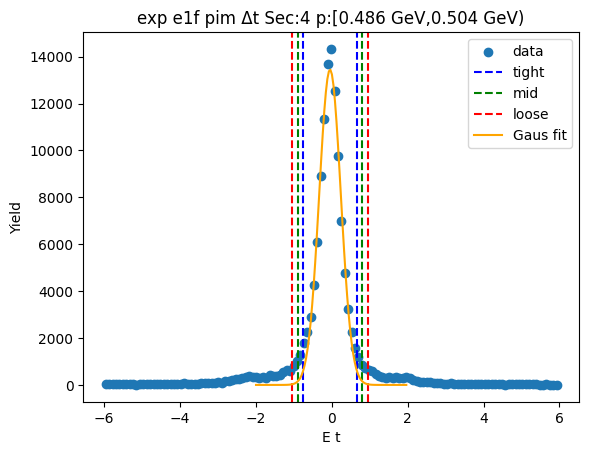

-0.7524245139158307 0.659815378723169
-0.8936485031797305 0.8010393679870689
-1.0348724924436306 0.9422633572509688


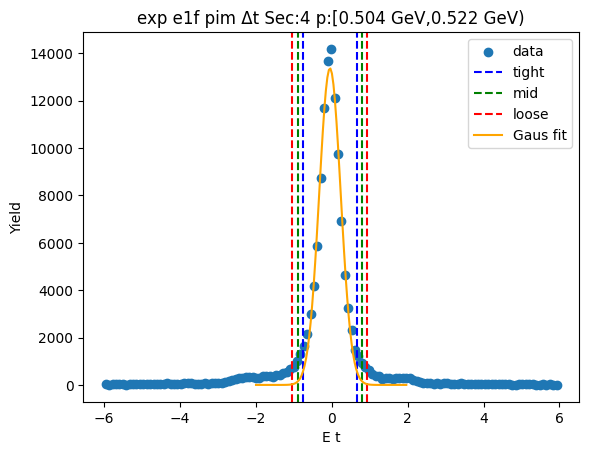

-0.7443532913616265 0.6501221817443766
-0.8838008386722269 0.789569729054977
-1.0232483859828274 0.9290172763655774


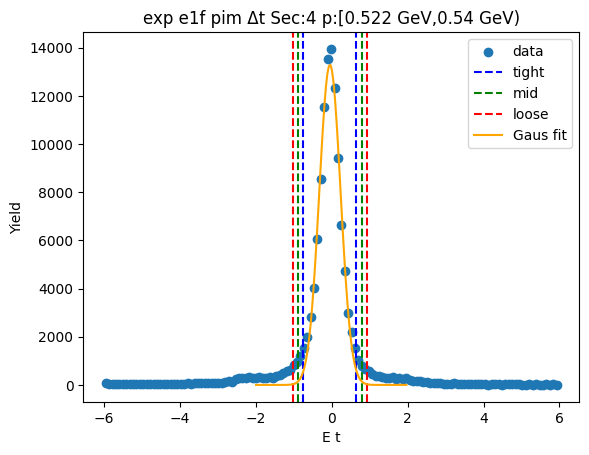

-0.7295695767343682 0.6400118048401875
-0.8665277148918237 0.776969942997643
-1.0034858530492792 0.9139280811550985


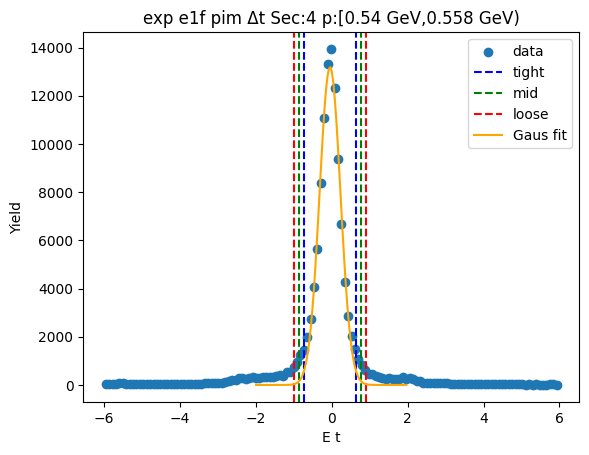

-0.7324260555767004 0.6424269477139246
-0.869911355905763 0.7799122480429872
-1.0073966562348255 0.9173975483720496


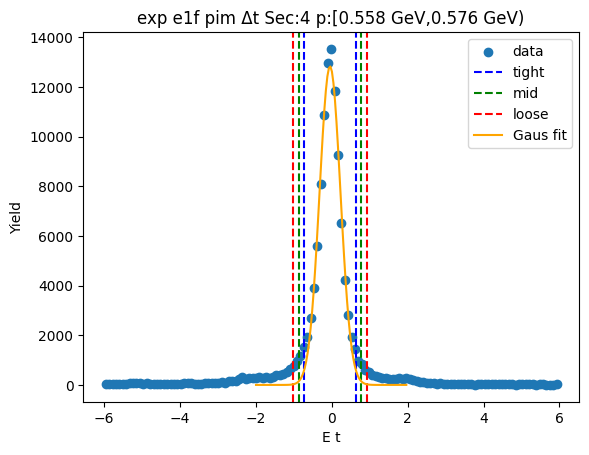

-0.7421139009309643 0.6444208553700208
-0.8807673765610627 0.7830743310001193
-1.0194208521911612 0.9217278066302177


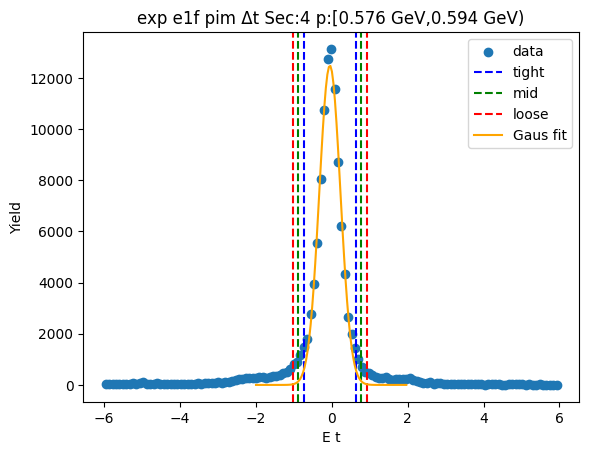

-0.7294034992126217 0.6402872582279129
-0.8663725749566751 0.7772563339719663
-1.0033416507007287 0.9142254097160197


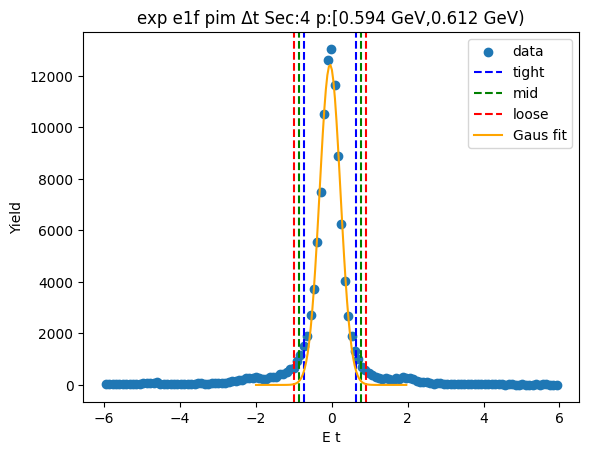

-0.7251620531842036 0.6323846944288971
-0.8609167279455135 0.7681393691902071
-0.9966714027068236 0.9038940439515172


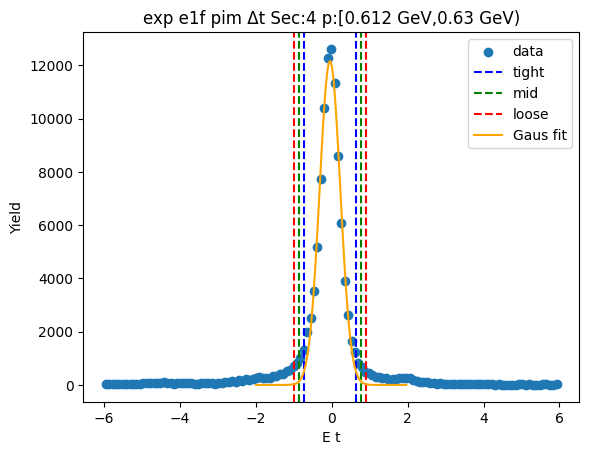

-0.7284558992672598 0.6314901989665076
-0.8644505090906365 0.7674848087898845
-1.0004451189140133 0.9034794186132611


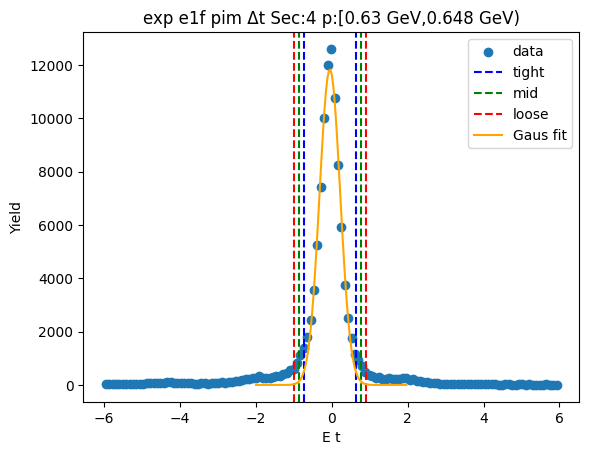

-0.7243792488425271 0.627282437680851
-0.859545417494865 0.7624486063331889
-0.9947115861472029 0.8976147749855268


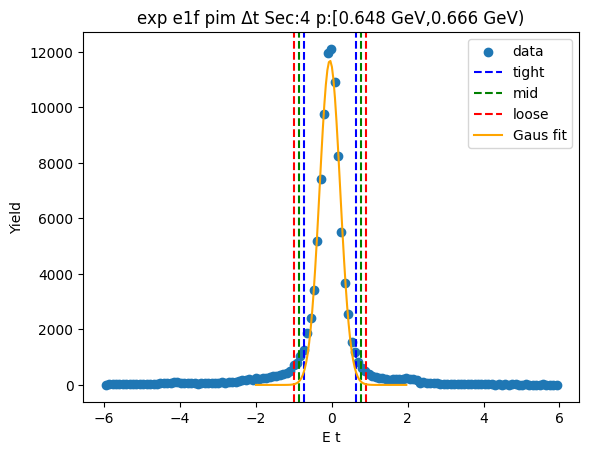

-0.7184309441724204 0.6214192992530665
-0.8524159685149691 0.7554043235956153
-0.9864009928575178 0.8893893479381639


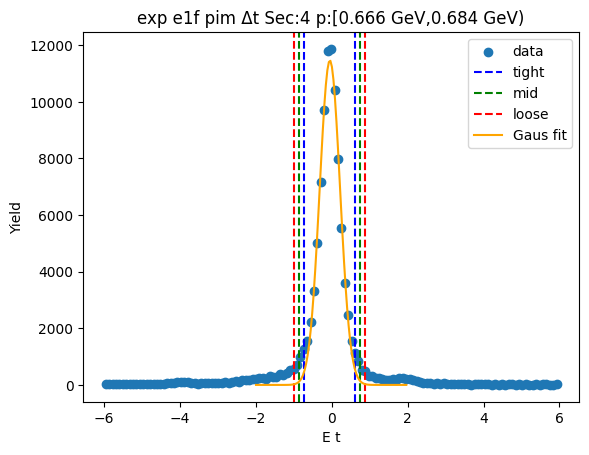

-0.7294361033709382 0.6305004191058698
-0.8654297556186191 0.7664940713535507
-1.0014234078663 0.9024877236012315


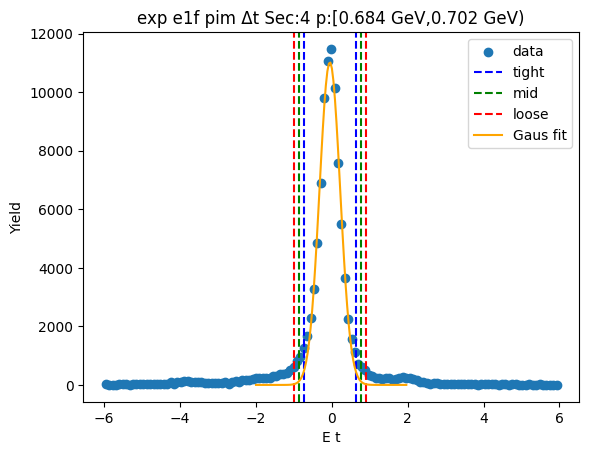

-0.7234137887001721 0.622883100616856
-0.858043477631875 0.7575127895485589
-0.9926731665635777 0.8921424784802618


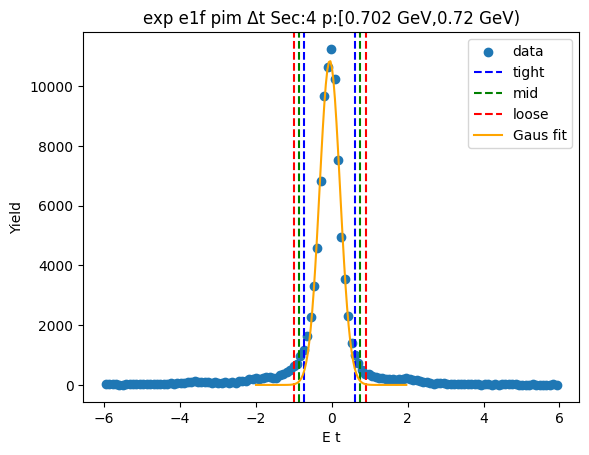

-0.7158614309321892 0.618843021636701
-0.8493318761890783 0.7523134668935901
-0.9828023214459674 0.8857839121504791


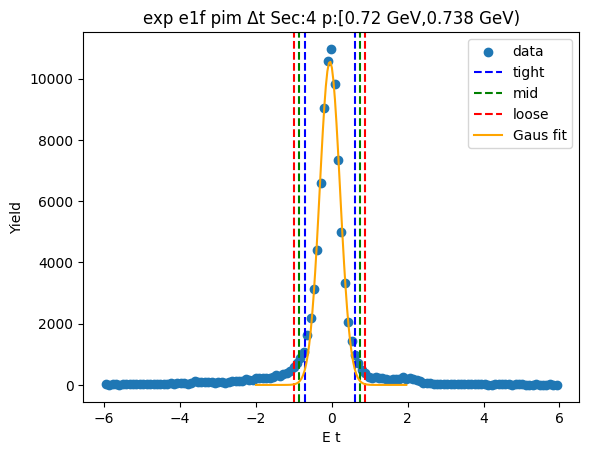

-0.7222463433237621 0.6272729374853737
-0.8571982714046756 0.7622248655662872
-0.9921501994855892 0.8971767936472008


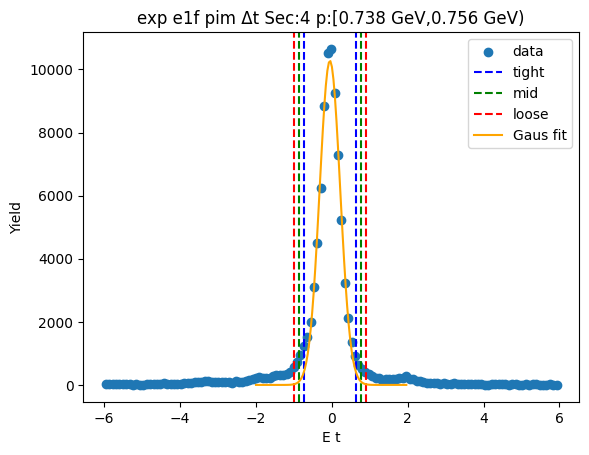

-0.7166837787064091 0.6193997245170066
-0.8502921290287506 0.7530080748393484
-0.9839004793510924 0.8866164251616899


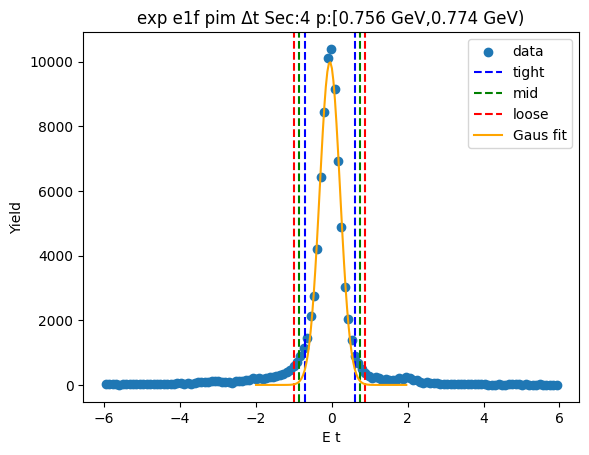

-0.7135396840168556 0.615770776874354
-0.8464707301059765 0.7487018229634749
-0.9794017761950975 0.8816328690525959


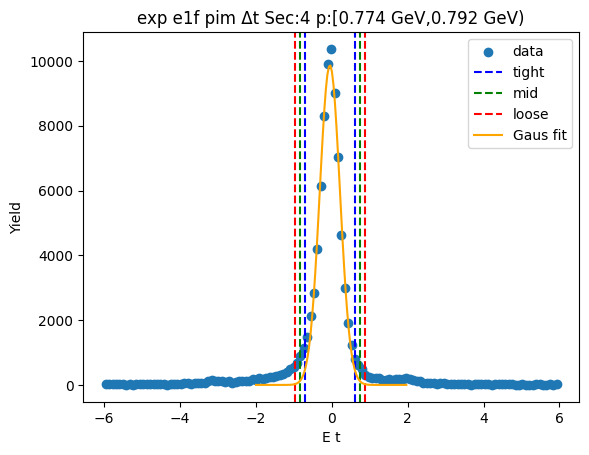

-0.7189792356595969 0.618616264100507
-0.8527387856356073 0.7523758140765174
-0.9864983356116177 0.8861353640525278


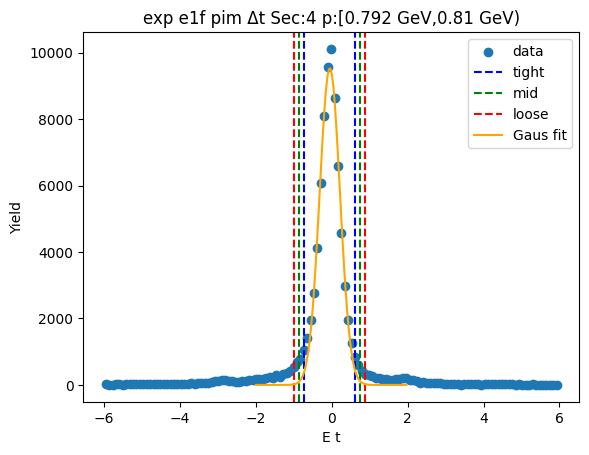

-0.7202402169816824 0.6178901364988685
-0.8540532523297374 0.7517031718469235
-0.9878662876777925 0.8855162071949786


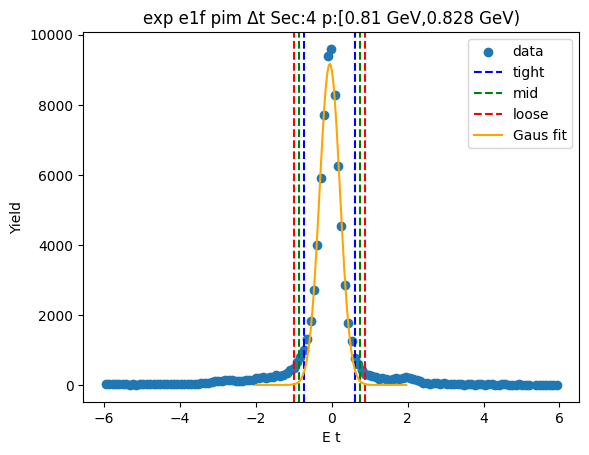

-0.7077799582713191 0.6045974249879007
-0.839017696597241 0.7358351633138226
-0.970255434923163 0.8670729016397446


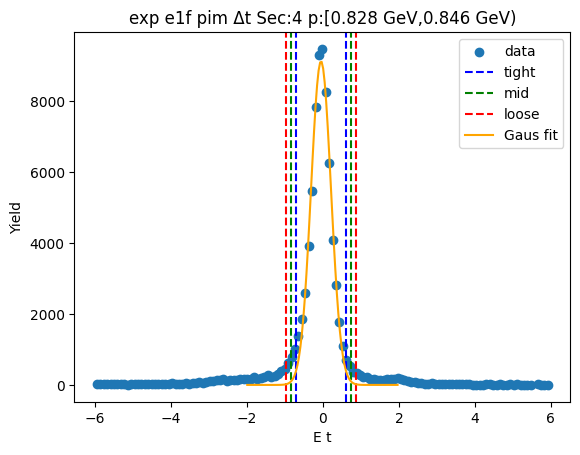

-0.713014893958036 0.6051891456172743
-0.844835297915567 0.7370095495748054
-0.976655701873098 0.8688299535323364


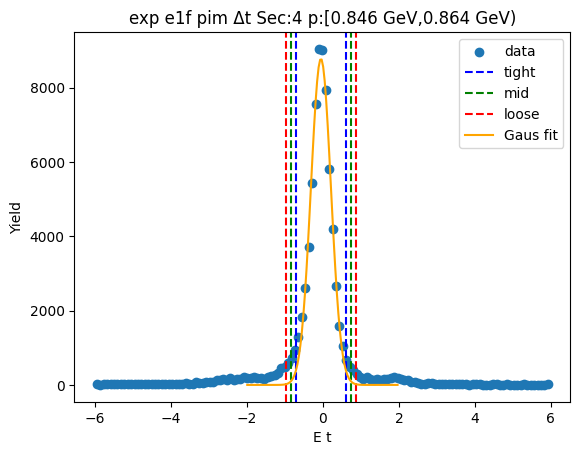

-0.7143063558181594 0.6062437118442813
-0.8463613625844035 0.7382987186105254
-0.9784163693506476 0.8703537253767695


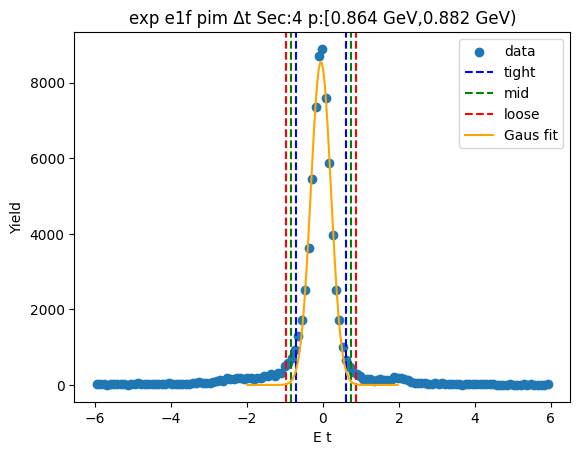

-0.7157108411234576 0.611949456526689
-0.8484768708884723 0.7447154862917037
-0.9812429006534871 0.8774815160567184


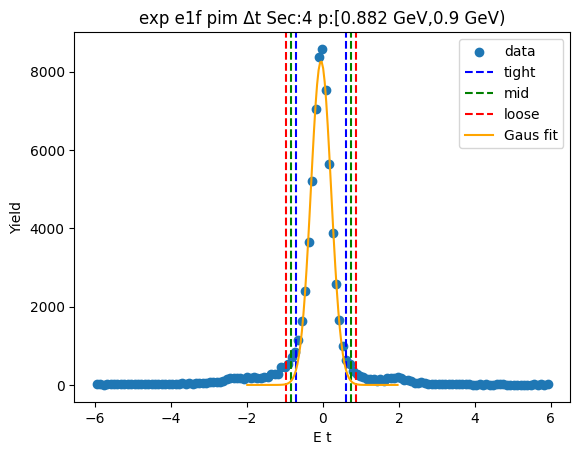

-0.7094753864671295 0.6012805630287223
-0.8405509814167147 0.7323561579783073
-0.9716265763662999 0.8634317529278925


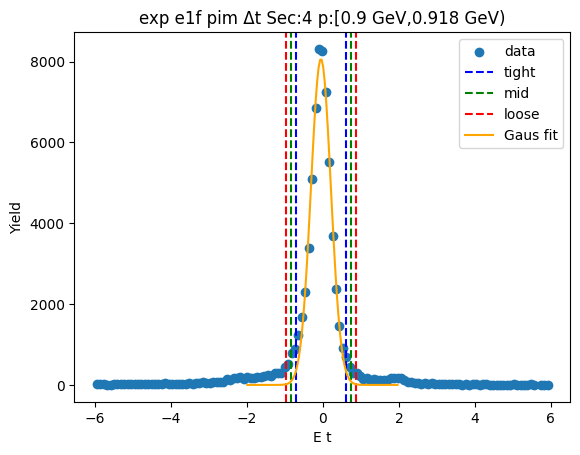

-0.7131865847744112 0.597973233985855
-0.8443025666504379 0.7290892158618817
-0.9754185485264646 0.8602051977379084


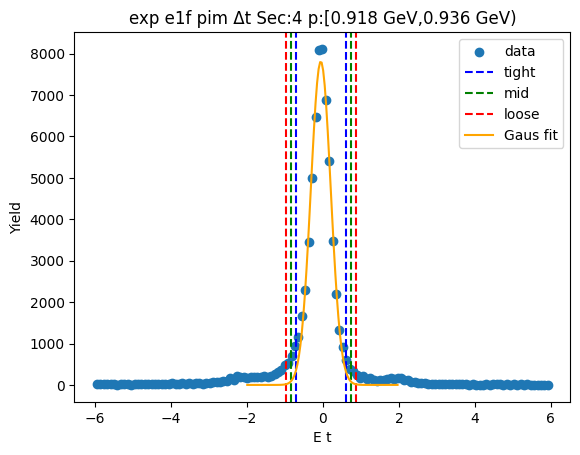

-0.712081709843279 0.60155934141839
-0.8434458149694458 0.7329234465445568
-0.9748099200956127 0.8642875516707237


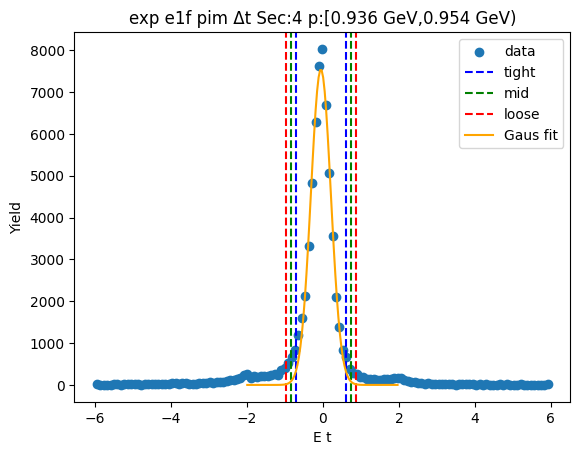

-0.70814622109254 0.5967788312432012
-0.838638726326114 0.7272713364767752
-0.9691312315596882 0.8577638417103494


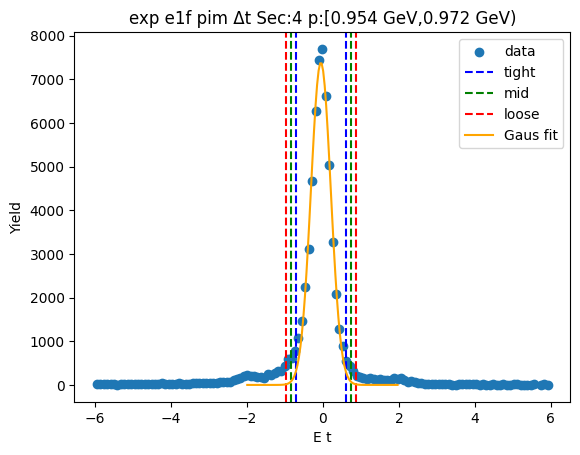

-0.7115003457391945 0.5916994364341598
-0.84182032395653 0.7220194146514952
-0.9721403021738654 0.8523393928688306


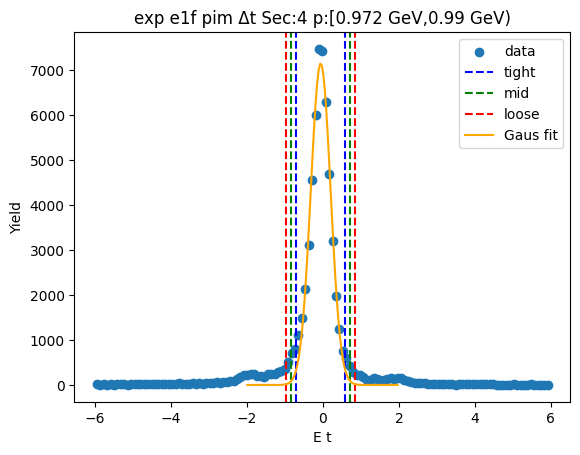

-0.7020676330442321 0.5895650094663774
-0.8312308972952931 0.7187282737174383
-0.960394161546354 0.8478915379684993


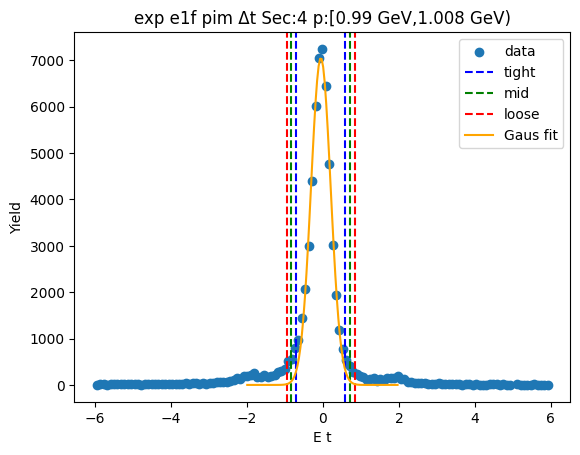

-0.7109360596529269 0.5862360290836087
-0.8406532685265805 0.7159532379572623
-0.9703704774002341 0.8456704468309159


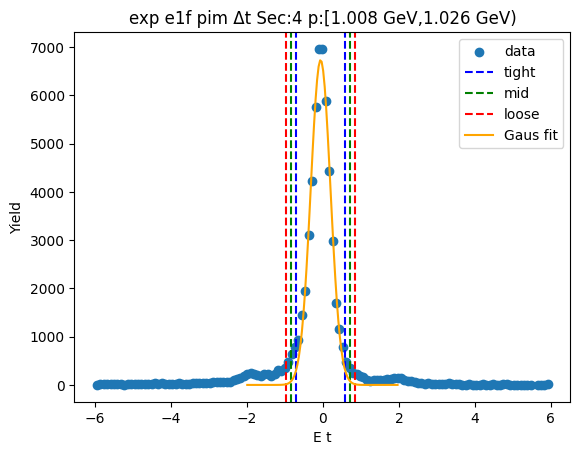

-0.7074119340072864 0.5869432622114807
-0.8368474536291631 0.7163787818333575
-0.9662829732510398 0.8458143014552342


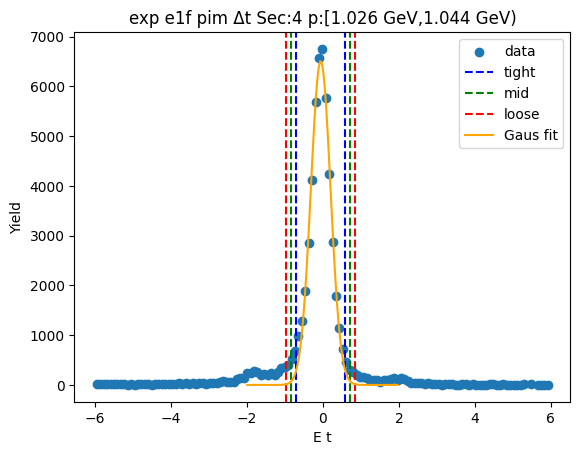

-0.7031772911170429 0.5818716847031635
-0.8316821886990634 0.7103765822851841
-0.9601870862810841 0.8388814798672047


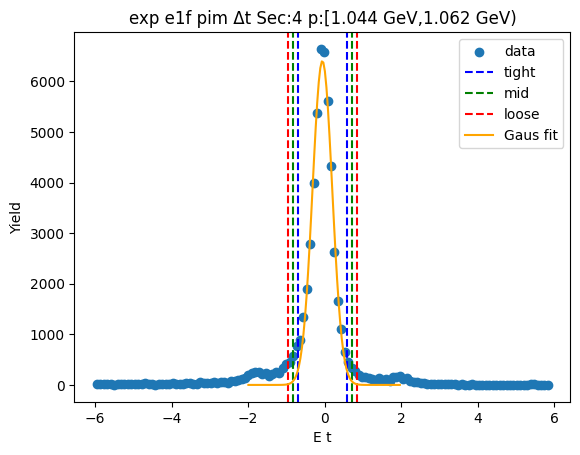

-0.7015462806196505 0.5858033056028357
-0.8302812392418992 0.7145382642250844
-0.9590161978641478 0.843273222847333


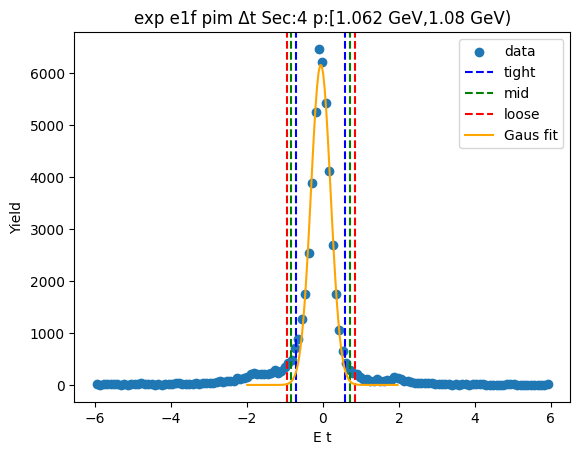

-0.701552487258965 0.5847881069116044
-0.8301865466760219 0.7134221663286613
-0.9588206060930788 0.8420562257457183


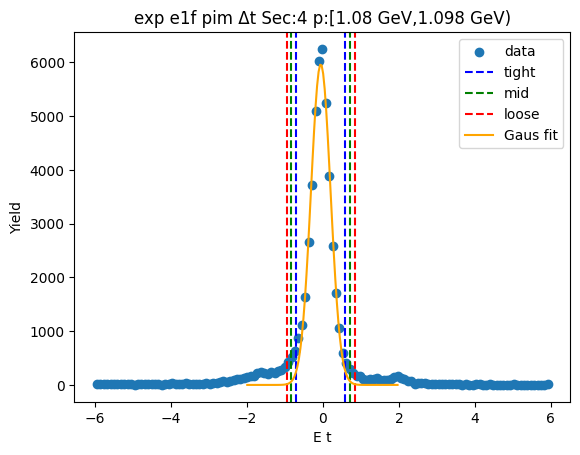

-0.7124413670698251 0.5939875579152363
-0.8430842595683312 0.7246304504137424
-0.9737271520668374 0.8552733429122485


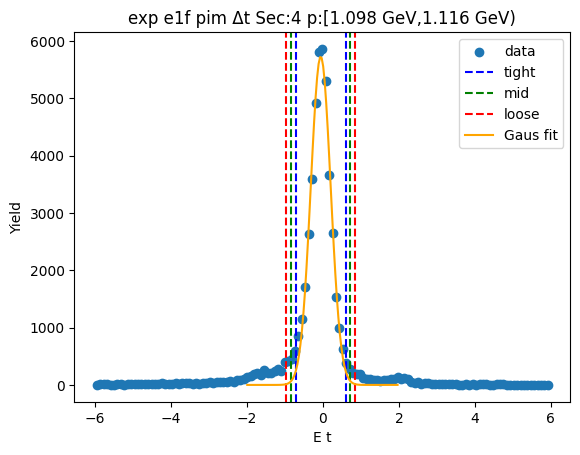

-0.6970506544555835 0.575106841972034
-0.8242664040983453 0.7023225916147958
-0.951482153741107 0.8295383412575575


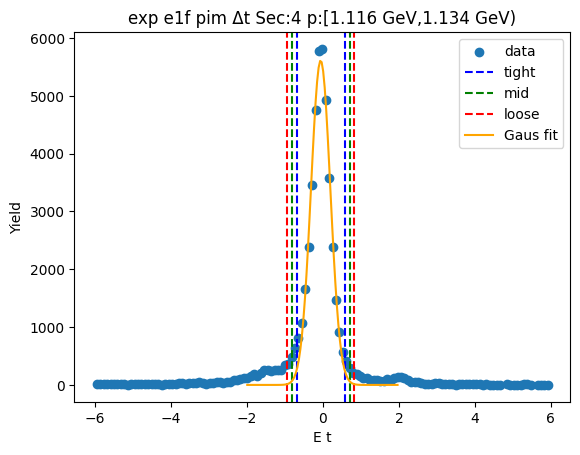

-0.7047076996022315 0.5838507297454334
-0.8335635425369979 0.7127065726801999
-0.9624193854717644 0.8415624156149664


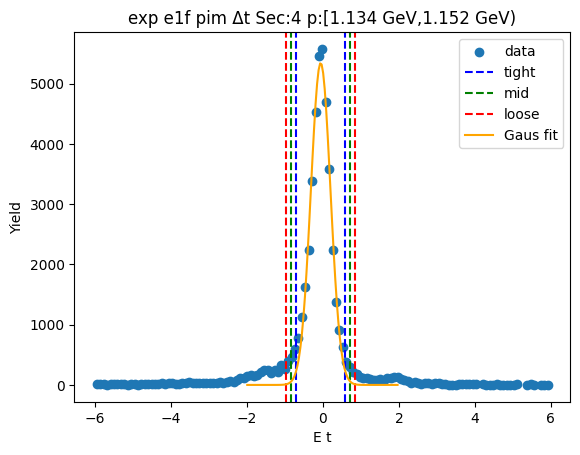

-0.677940848219469 0.5631576876502381
-0.8020507018064398 0.6872675412372089
-0.9261605553934105 0.8113773948241796


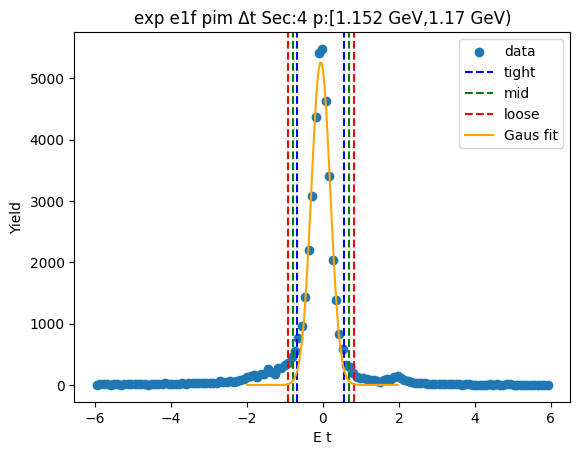

-0.696281841442111 0.5781742729896437
-0.8237274528852866 0.7056198844328193
-0.951173064328462 0.8330654958759948


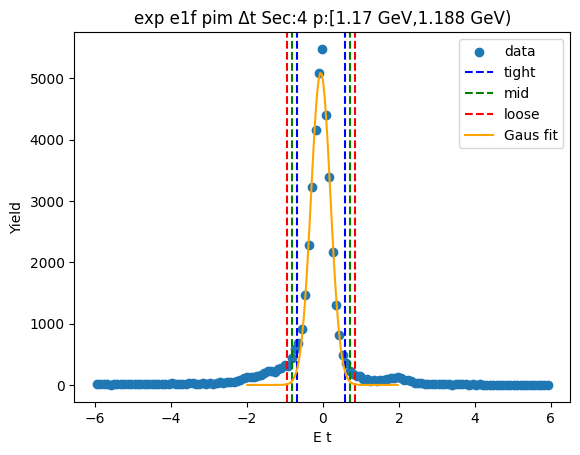

-0.6989484829568946 0.576437874681424
-0.8264871187207266 0.703976510445256
-0.9540257544845584 0.8315151462090878


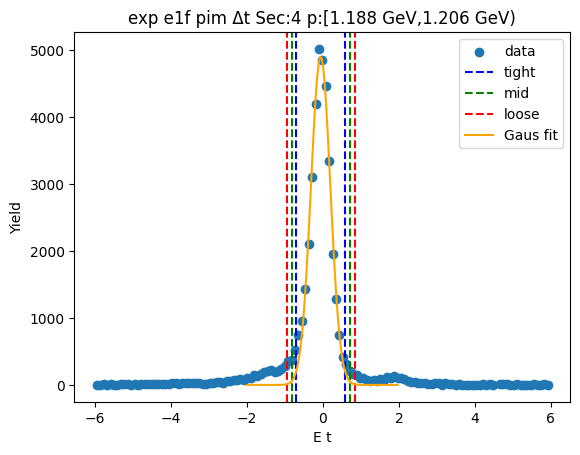

-0.7056315634812907 0.5815169400525072
-0.8343464138346705 0.7102317904058869
-0.9630612641880503 0.8389466407592667


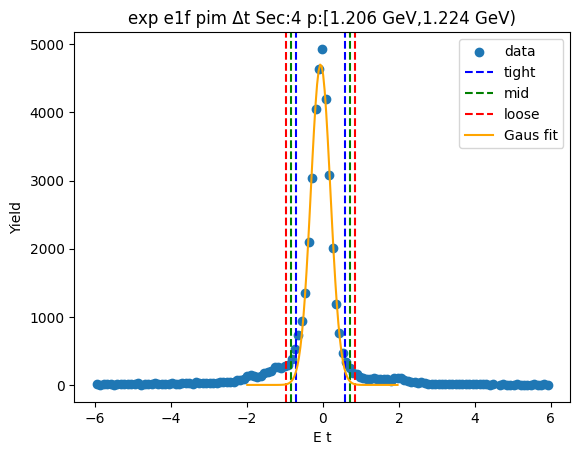

-0.6978011057650274 0.5778430730760059
-0.8253655236491307 0.7054074909601092
-0.9529299415332341 0.8329719088442126


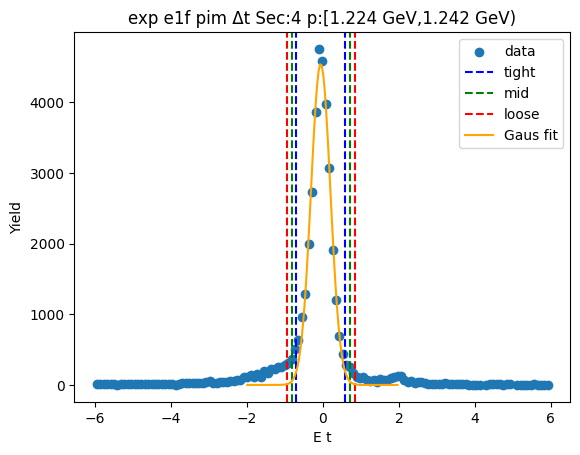

-0.6917635680427137 0.5744395974223142
-0.8183838845892165 0.7010599139688171
-0.9450042011357194 0.8276802305153199


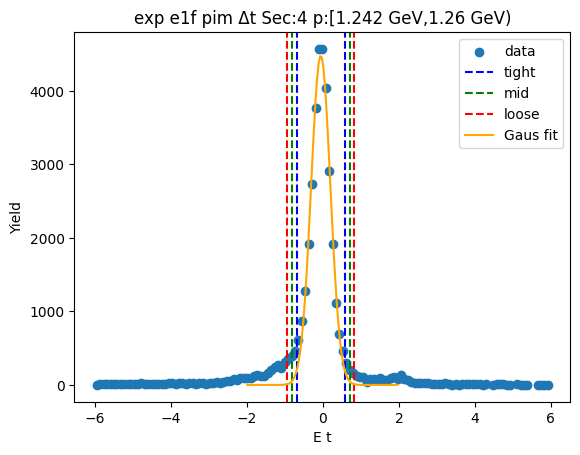

-0.6882087567117641 0.570131166714291
-0.8140427490543696 0.6959651590568965
-0.9398767413969751 0.821799151399502


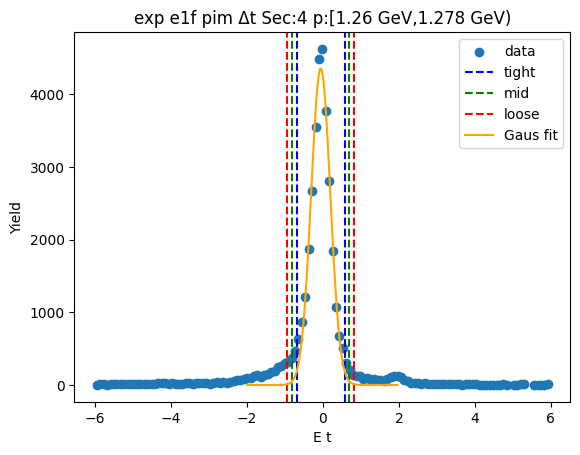

-0.6923592015712212 0.5631134576770902
-0.8179064674960523 0.6886607236019215
-0.9434537334208835 0.8142079895267527


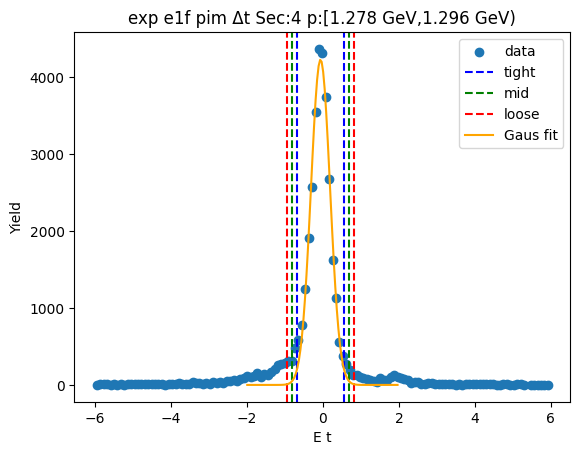

-0.6801109975909897 0.56157718394053
-0.8042798157441418 0.6857460020936821
-0.9284486338972937 0.809914820246834


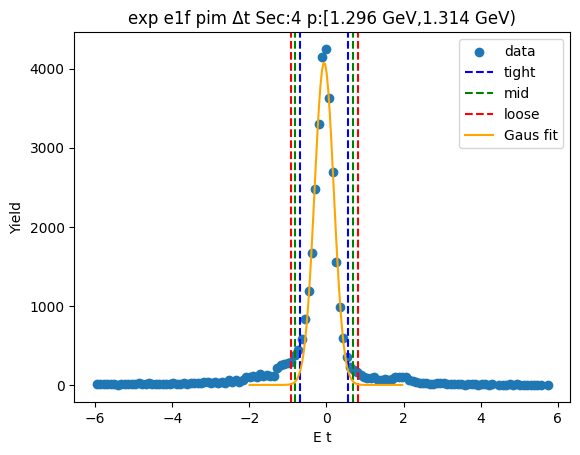

-0.6980302414474953 0.5796112206585788
-0.8257943876581028 0.7073753668691863
-0.9535585338687101 0.8351395130797937


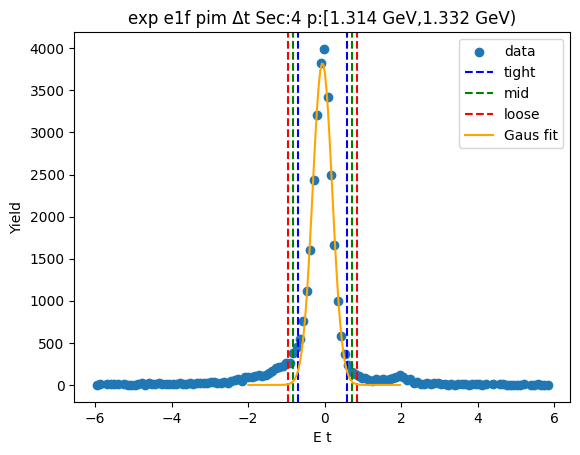

-0.6777311215138537 0.5598871231540472
-0.8014929459806439 0.6836489476208374
-0.925254770447434 0.8074107720876275


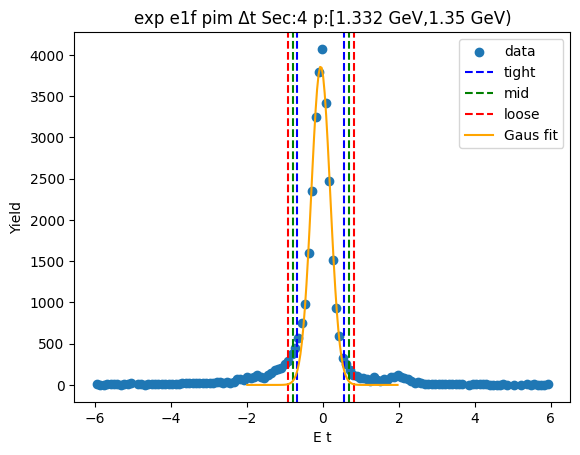

-0.675038398062748 0.5524946830174454
-0.7977917061707674 0.6752479911254649
-0.9205450142787868 0.7980012992334842


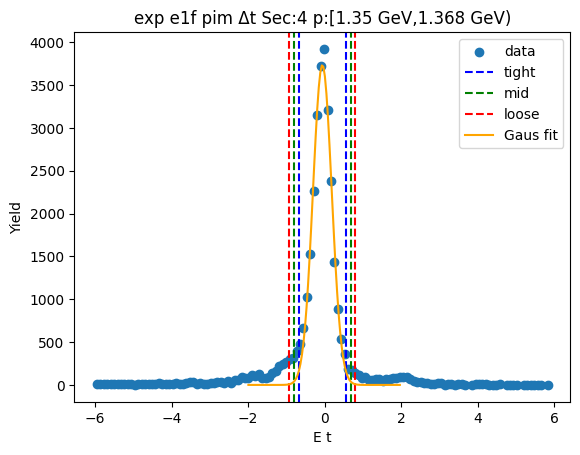

-0.6939450326464166 0.5665579344566093
-0.8199953293567193 0.692608231166912
-0.9460456260670219 0.8186585278772146


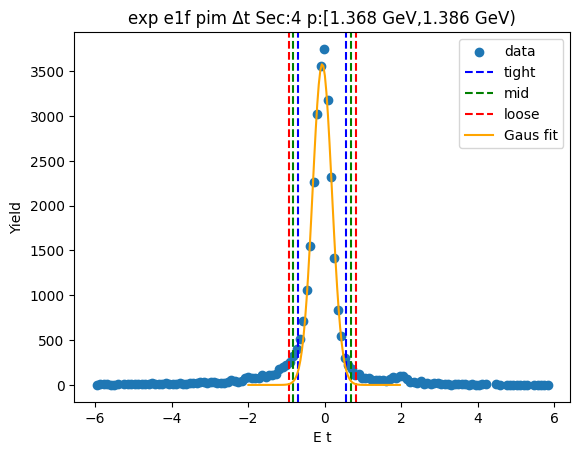

-0.6716424274118217 0.5591469966337089
-0.7947213698163746 0.6822259390382619
-0.9178003122209277 0.805304881442815


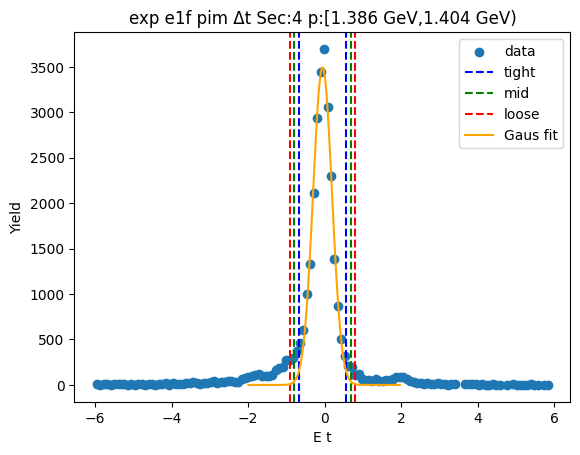

-0.6895245550172009 0.5612764540000892
-0.8146046559189298 0.6863565549018181
-0.9396847568206588 0.8114366558035471


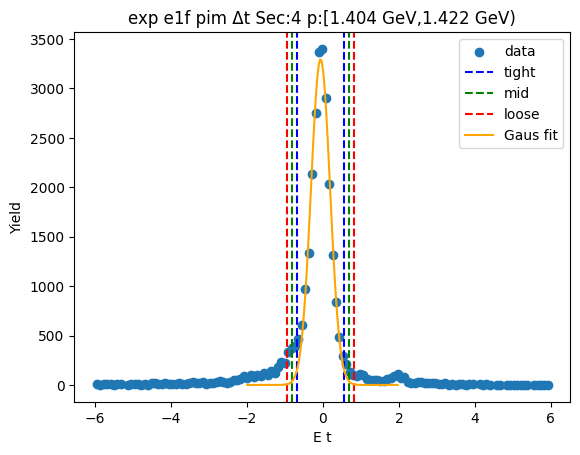

-0.6762251703535047 0.5564220611900765
-0.7994898935078627 0.6796867843444347
-0.9227546166622209 0.8029515074987927


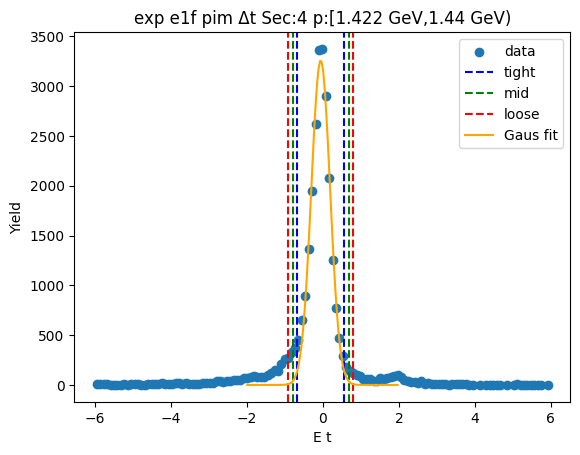

-0.6673137495486655 0.5505987700847742
-0.7891050015120096 0.6723900220481183
-0.9108962534753535 0.7941812740114622


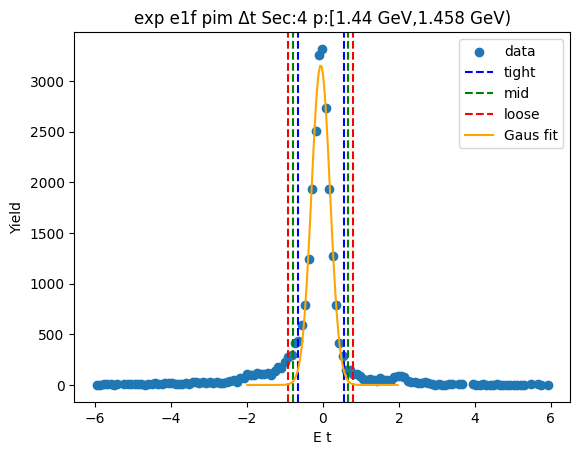

-0.6892918538025451 0.5652126768235294
-0.8147423068651525 0.6906631298861368
-0.9401927599277599 0.8161135829487441


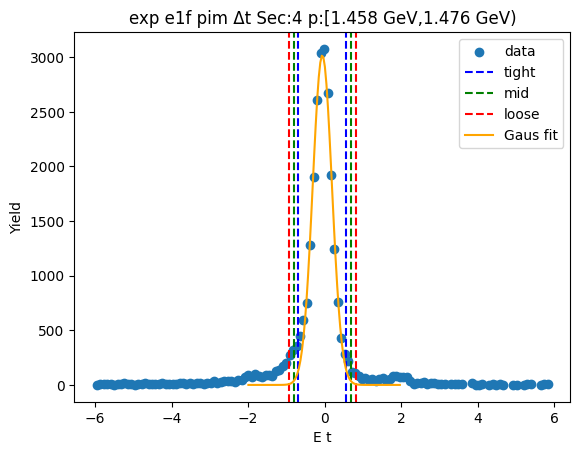

-0.6913752906822358 0.5778625382516155
-0.8182990735756209 0.7047863211450006
-0.9452228564690061 0.8317101040383857


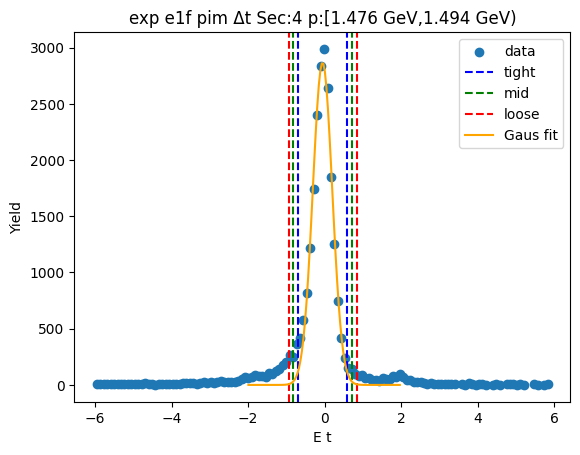

-0.6864763482394165 0.5591841574858054
-0.8110423988119387 0.6837502080583276
-0.9356084493844609 0.8083162586308498


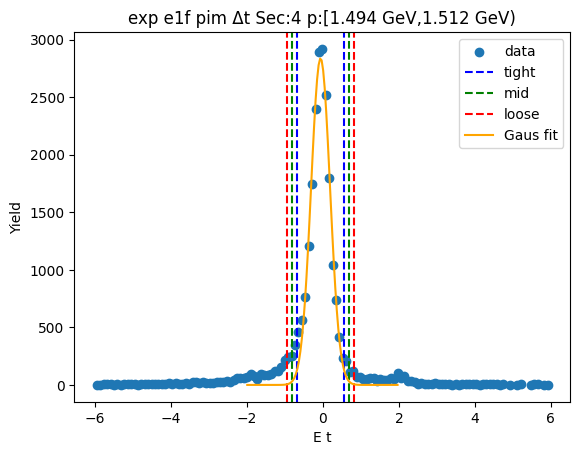

-0.663016082745371 0.5479899831889457
-0.7841166893388027 0.6690905897823773
-0.9052172959322344 0.790191196375809


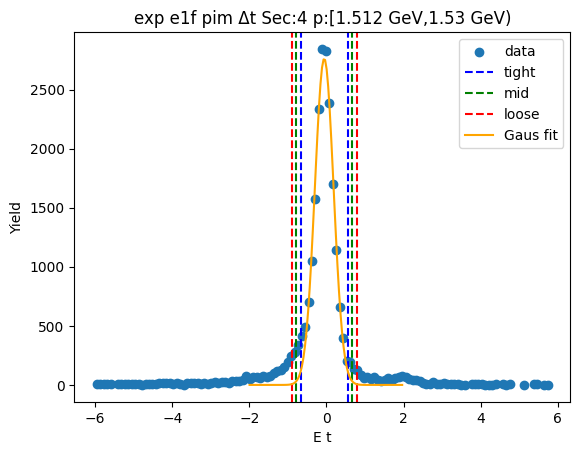

-0.6804140465888245 0.5620589439529667
-0.8046613456430036 0.6863062430071458
-0.9289086446971828 0.810553542061325


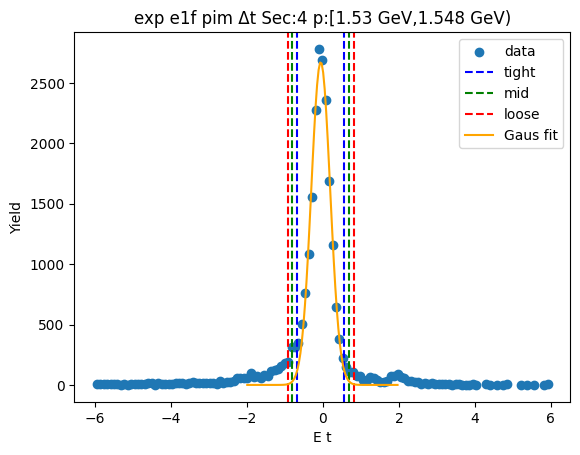

-0.6856622824286127 0.564099116820886
-0.8106384223535625 0.6890752567458358
-0.9356145622785125 0.8140513966707857


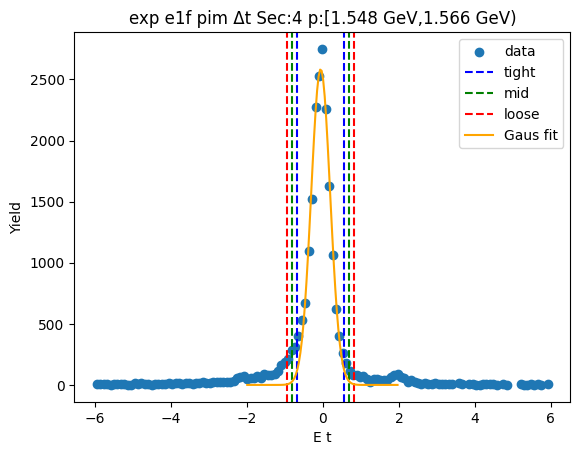

-0.6752304712010622 0.5607714725121449
-0.7988306655723829 0.6843716668834656
-0.9224308599437034 0.8079718612547864


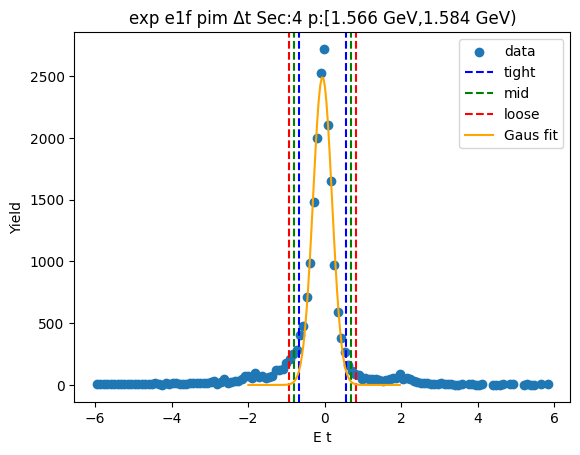

-0.6743642275022698 0.5623760497018117
-0.7980382552226779 0.6860500774222198
-0.921712282943086 0.8097241051426279


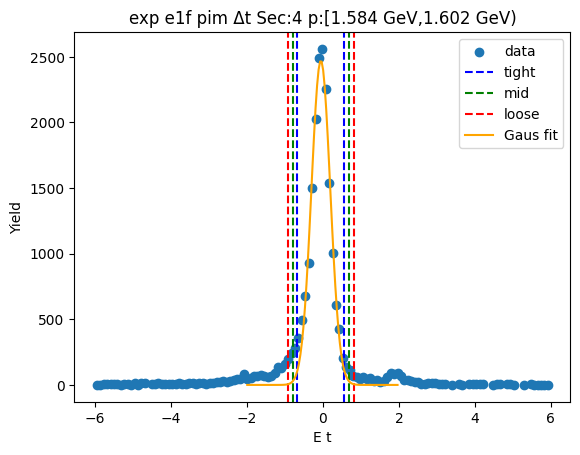

-0.6843080695585491 0.5743240745589133
-0.8101712839702954 0.7001872889706596
-0.9360344983820417 0.8260505033824059


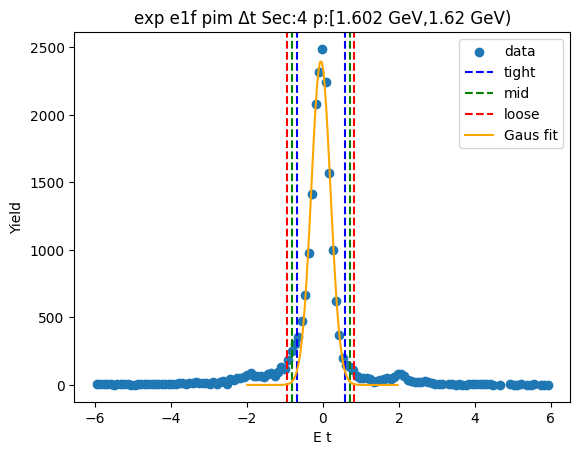

-0.6888074778321577 0.563386357508073
-0.8140268613661807 0.688605741042096
-0.9392462449002038 0.8138251245761191


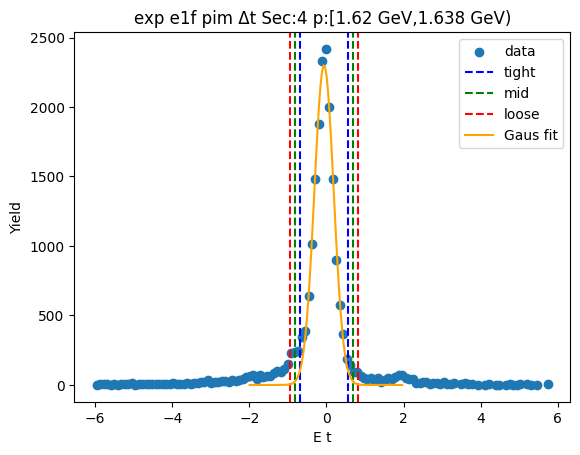

-0.6850560951500831 0.5737265408498787
-0.8109343587500792 0.6996048044498748
-0.9368126223500755 0.825483068049871


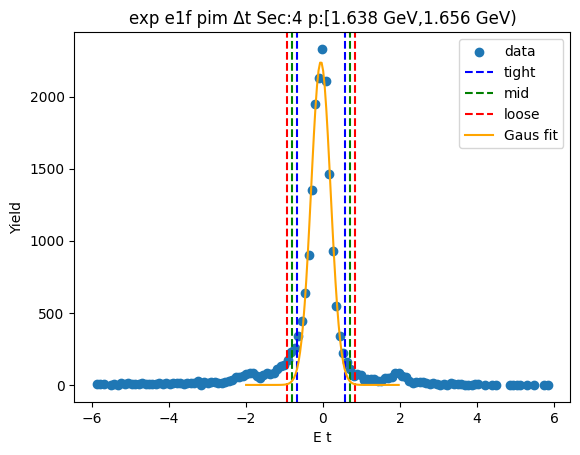

-0.6616946822862237 0.5504820505189763
-0.7829123555667437 0.6716997237994962
-0.9041300288472637 0.7929173970800162


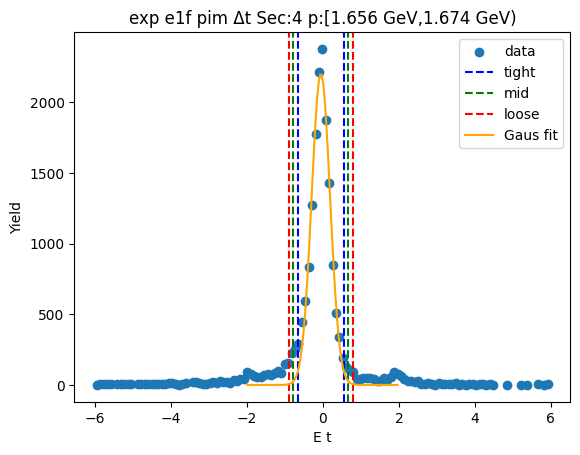

-0.6799587356684363 0.5653269175519758
-0.8044873009904776 0.6898554828740171
-0.9290158663125188 0.8143840481960583


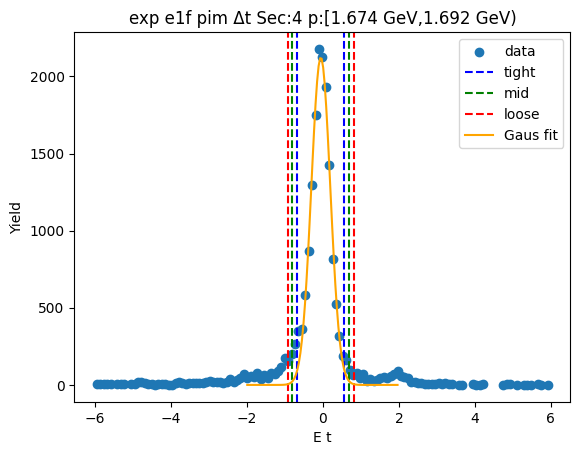

-0.6958627526157842 0.5683736373743048
-0.8222863916147932 0.6947972763733138
-0.9487100306138021 0.8212209153723227


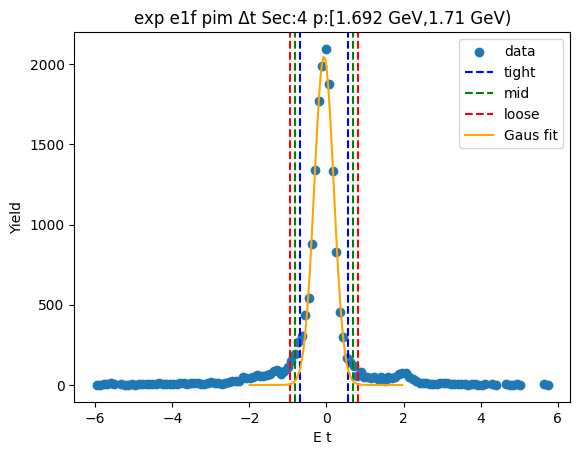

-0.6628007811745784 0.550142280975761
-0.7840950873896123 0.6714365871907949
-0.9053893936046463 0.7927308934058289


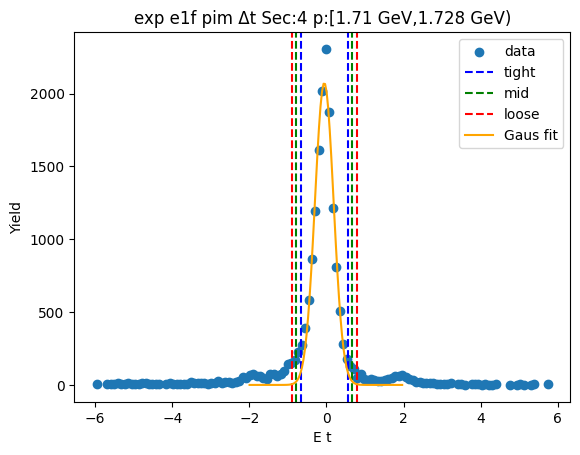

-0.6616141960909878 0.5479546271908833
-0.7825710784191748 0.6689115095190703
-0.903527960747362 0.7898683918472574


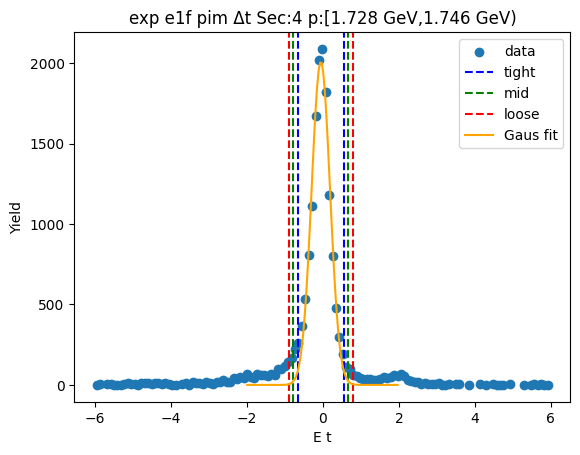

-0.6572737465619042 0.5461926460585566
-0.7776203858239503 0.6665392853206027
-0.8979670250859965 0.7868859245826488


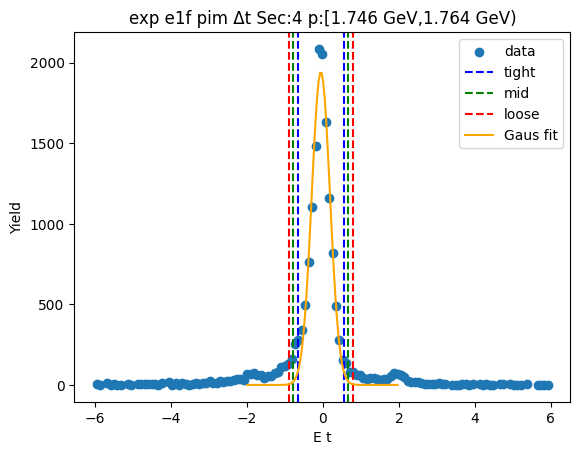

-0.6675923461061591 0.5609353499960513
-0.7904451157163802 0.6837881196062724
-0.9132978853266013 0.8066408892164935


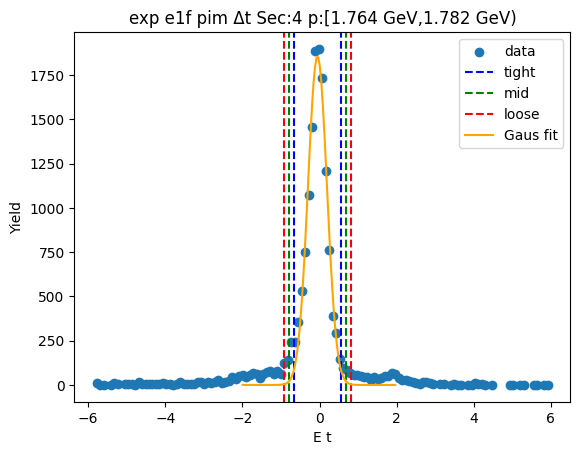

-0.6634226852563507 0.5389608191181101
-0.7836610356937969 0.6591991695555562
-0.9038993861312429 0.7794375199930023


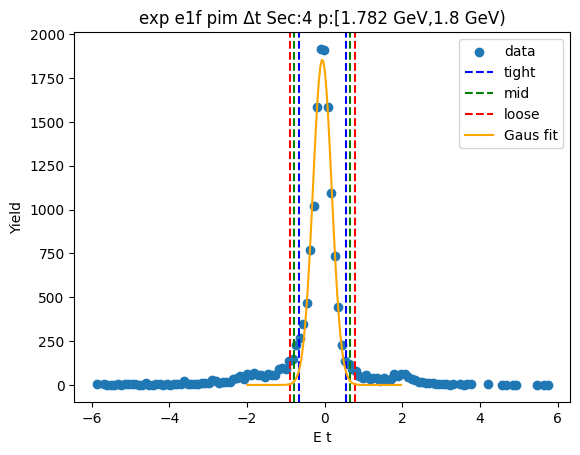

-0.6550693457900986 0.5412184385964977
-0.7746981242287583 0.6608472170351574
-0.8943269026674179 0.780475995473817


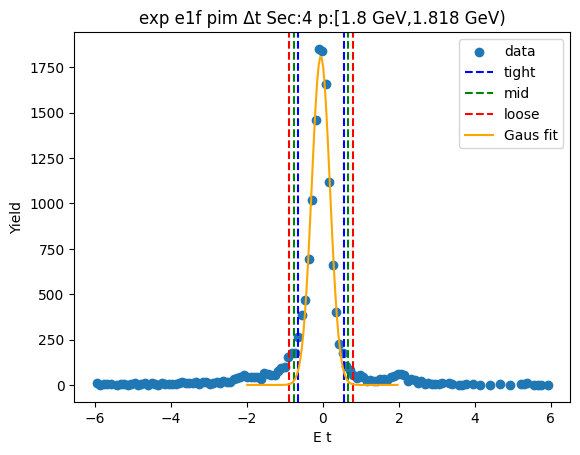

-0.6576279901630737 0.5440276774601664
-0.7777935569253978 0.6641932442224905
-0.8979591236877218 0.7843588109848145


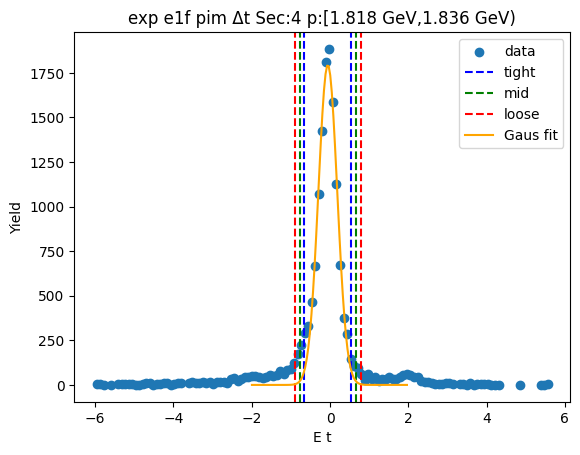

-0.6508085968339486 0.535600527891256
-0.7694495093064692 0.6542414403637765
-0.8880904217789896 0.7728823528362969


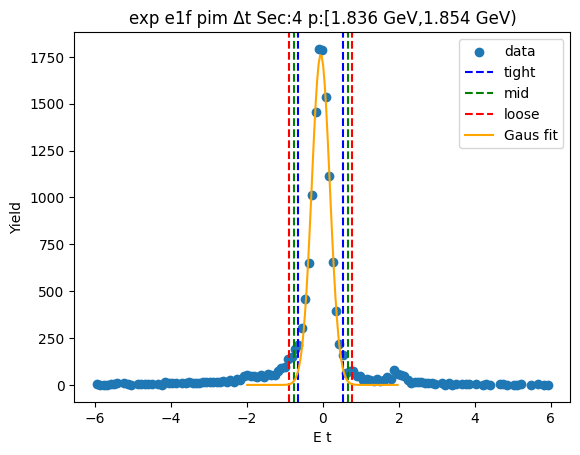

-0.6602894900437982 0.530161849081295
-0.7793346239563075 0.6492069829938043
-0.8983797578688167 0.7682521169063136


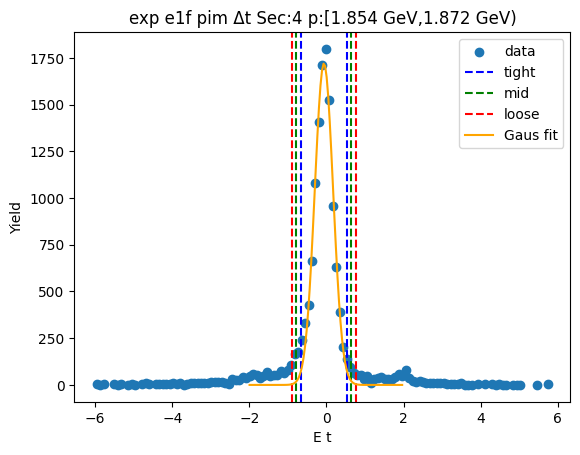

-0.6687425690703478 0.5521979499419457
-0.7908366209715771 0.6742920018431751
-0.9129306728728065 0.7963860537444044


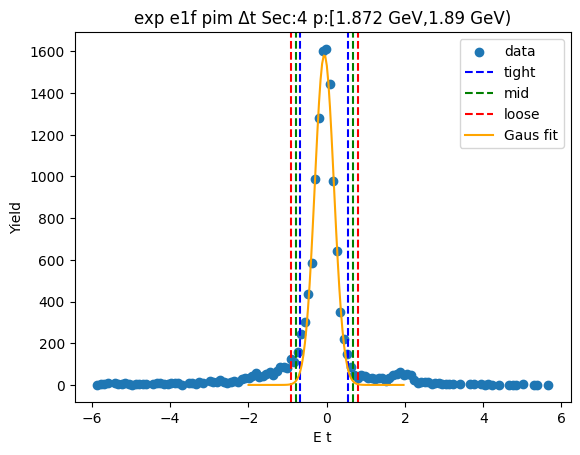

-0.6517952224835947 0.5291283519960478
-0.769887579931559 0.6472207094440121
-0.8879799373795233 0.7653130668919764


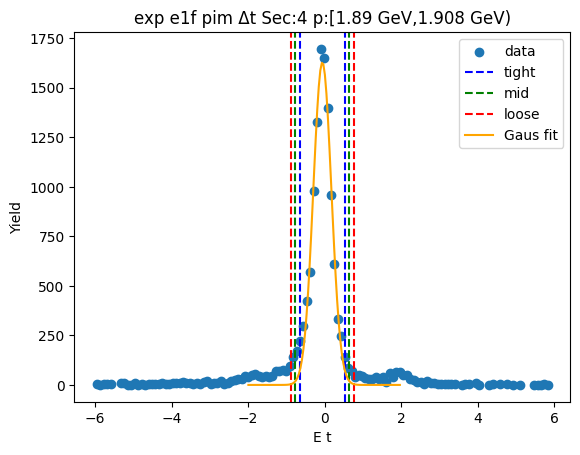

-0.6737670923219428 0.5471492149973021
-0.7958587230538673 0.6692408457292266
-0.9179503537857917 0.791332476461151


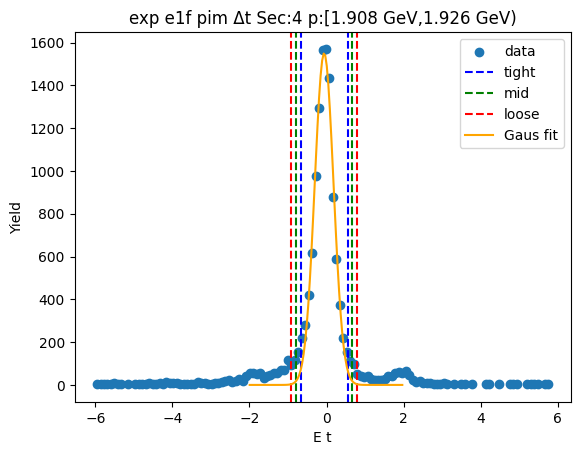

-0.6749164579942387 0.5566638017350206
-0.7980744839671647 0.6798218277079466
-0.9212325099400906 0.8029798536808725


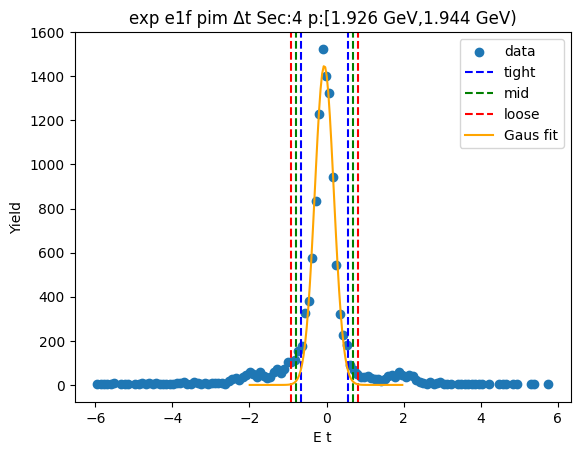

-0.6423647079777035 0.5251073335275767
-0.7591119121282316 0.6418545376781047
-0.8758591162787597 0.7586017418286328


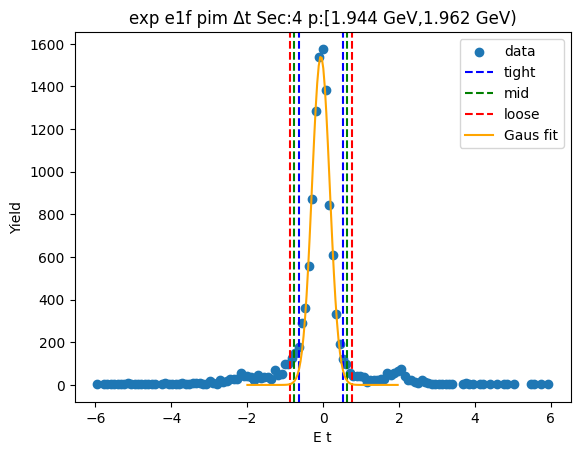

-0.663090203718581 0.5372848801249205
-0.7831277121029311 0.6573223885092706
-0.9031652204872812 0.7773598968936207


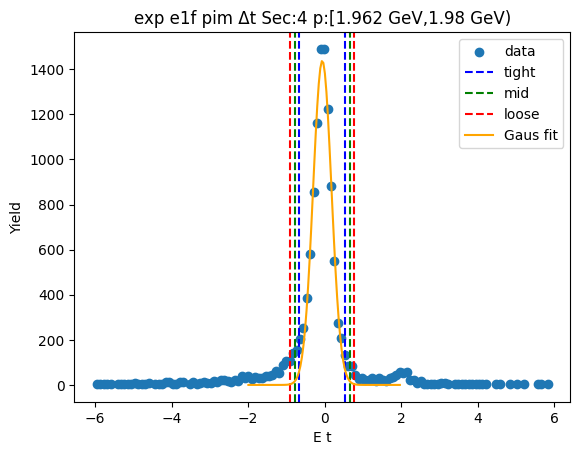

-0.6524963115530638 0.5494136488692909
-0.7726873075952992 0.6696046449115264
-0.8928783036375347 0.7897956409537619


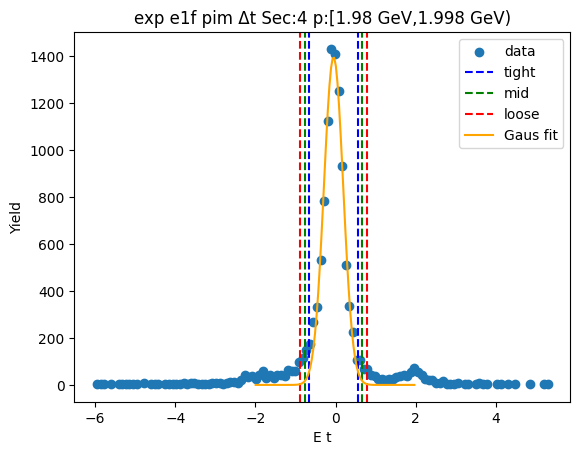

-0.6492519127623269 0.5414870323122656
-0.7683258072697862 0.6605609268197249
-0.8873997017772455 0.7796348213271842


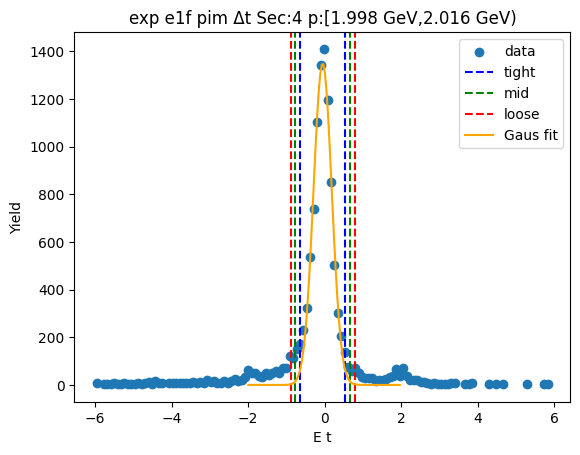

-0.6761203461167503 0.5590575088134894
-0.7996381316097743 0.6825752943065133
-0.9231559171027982 0.8060930797995373


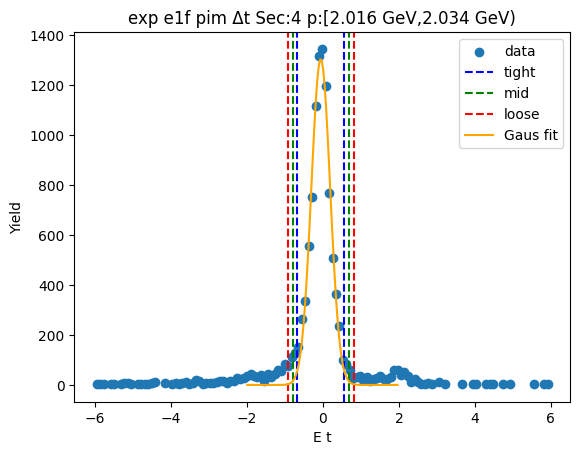

-0.6614186031590595 0.5568856589033006
-0.7832490293652956 0.6787160851095366
-0.9050794555715317 0.8005465113157727


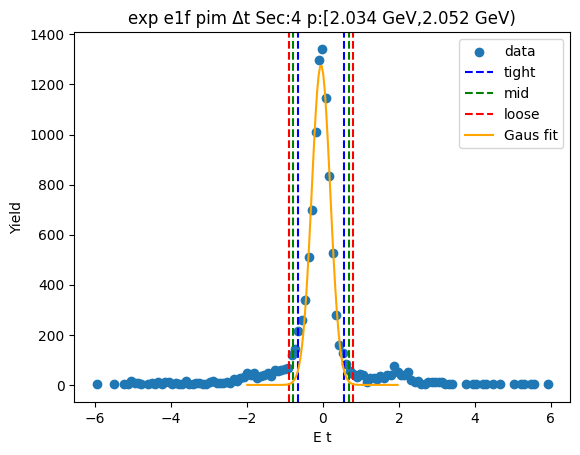

-0.6577553091162801 0.5329886839759225
-0.7768297084255004 0.6520630832851427
-0.8959041077347206 0.771137482594363


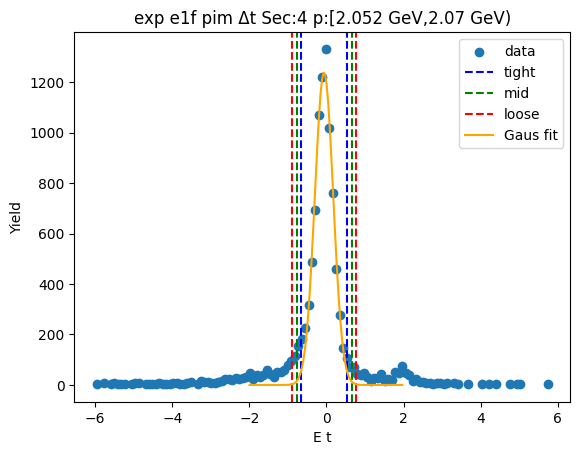

-0.6412416064444594 0.5399127450568454
-0.7593570415945898 0.6580281802069758
-0.8774724767447203 0.7761436153571063


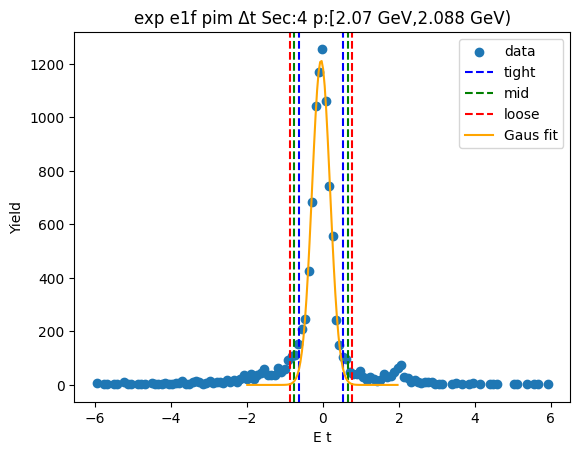

-0.6525273860290093 0.5497234977053336
-0.7727524744024437 0.6699485860787677
-0.8929775627758778 0.7901736744522021


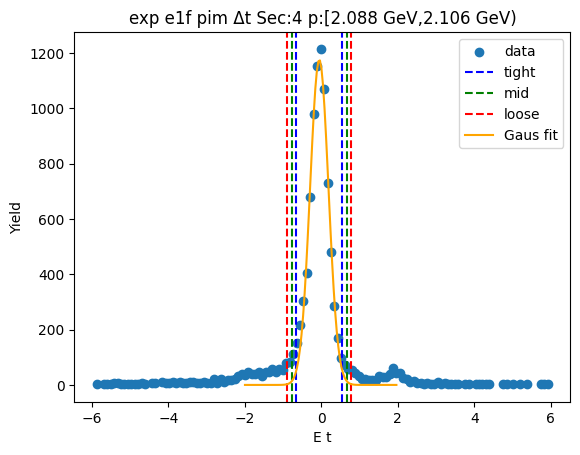

-0.6542389809136315 0.5521529214845367
-0.7748781711534484 0.6727921117243535
-0.8955173613932652 0.7934313019641703


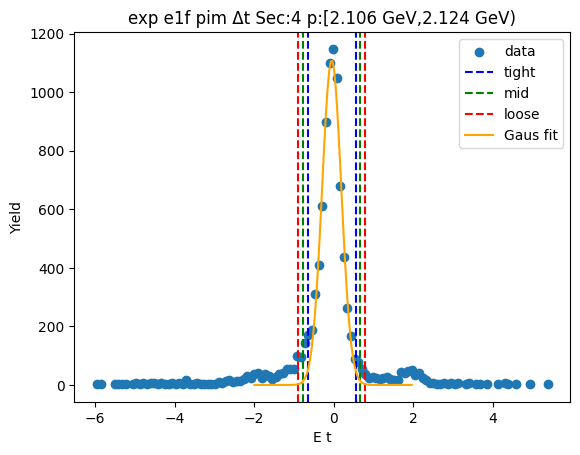

-0.667121748421416 0.554480861784469
-0.7892820094420044 0.6766411228050574
-0.911442270462593 0.7988013838256459


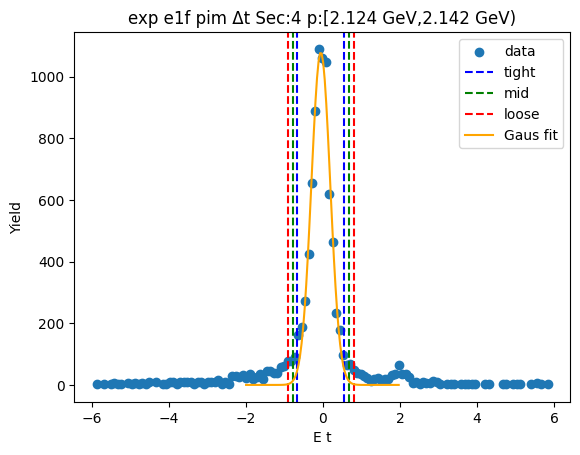

-0.6409302904915559 0.5365762256022235
-0.758680942100934 0.6543268772116015
-0.8764315937103119 0.7720775288209795


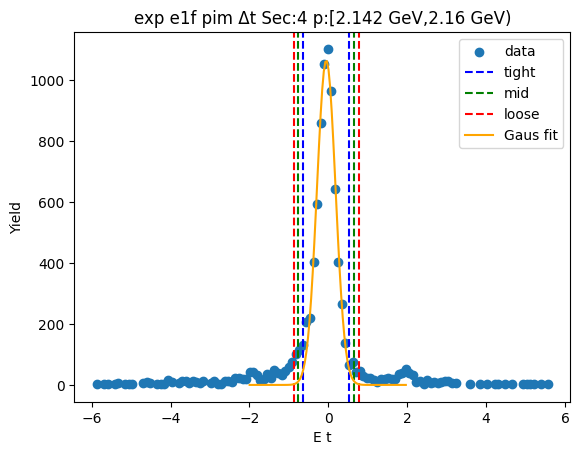

-0.6372440663322869 0.5197689982468823
-0.7529453727902038 0.6354703047047991
-0.8686466792481208 0.7511716111627161


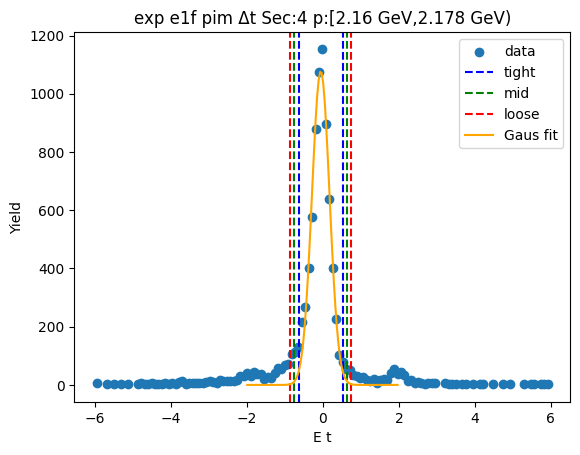

-0.6514210434699832 0.5364171650113696
-0.7702048643181184 0.6552009858595048
-0.8889886851662536 0.77398480670764


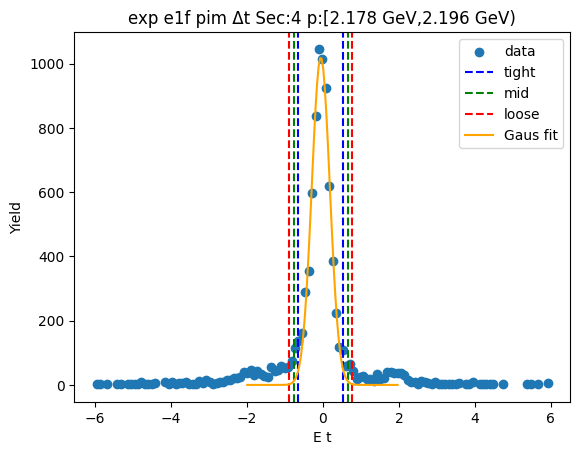

-0.6279100136826019 0.5428186094735714
-0.7449828759982193 0.6598914717891888
-0.8620557383138366 0.7769643341048061


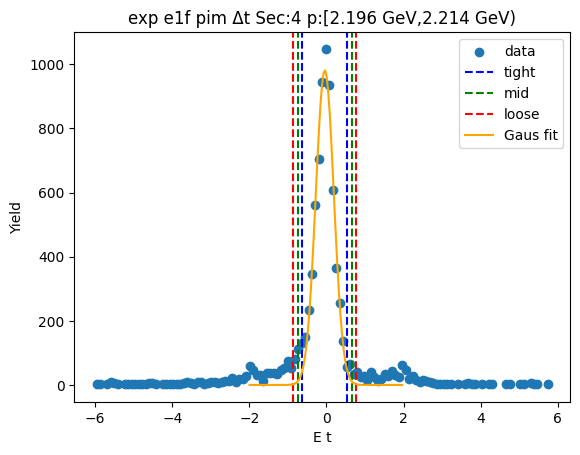

-0.6393875452564323 0.5286026442942428
-0.7561865642114998 0.6454016632493103
-0.8729855831665673 0.7622006822043778


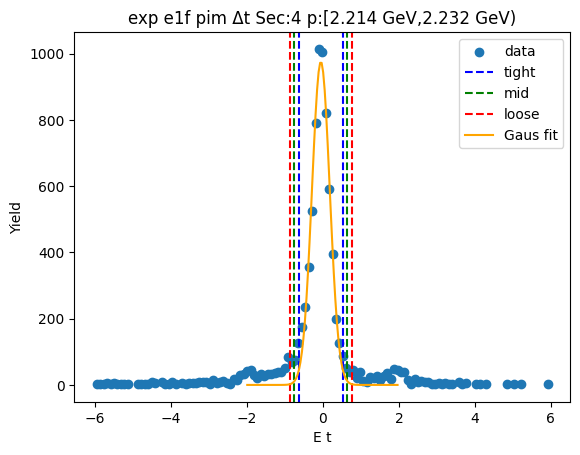

-0.6389224210839882 0.5506385069618281
-0.7578785138885699 0.6695945997664098
-0.8768346066931515 0.7885506925709914


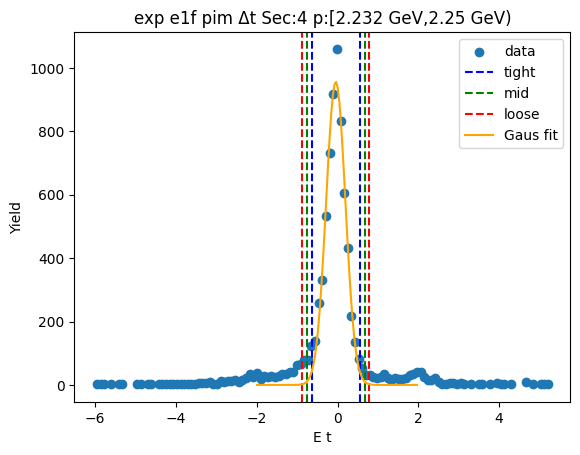

-0.6319049791244192 0.535590288928366
-0.7486545059296978 0.6523398157336446
-0.8654040327349763 0.7690893425389231


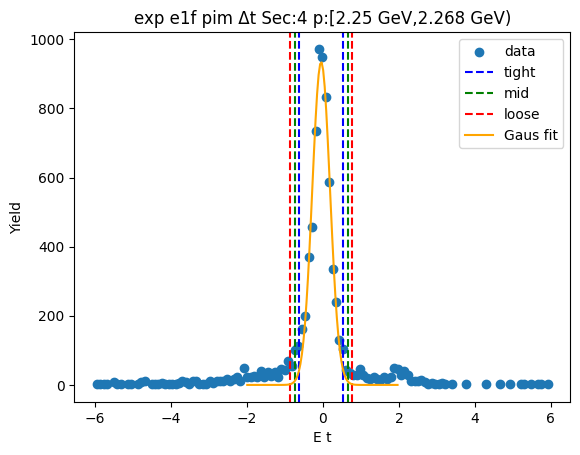

-0.6532381588467157 0.5311720974757898
-0.7716791844789662 0.6496131231080403
-0.8901202101112168 0.7680541487402909


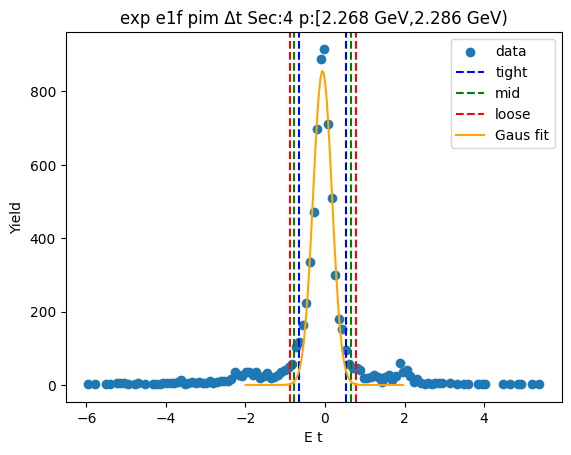

-0.6553158153610417 0.5412681764456775
-0.7749742145417137 0.6609265756263495
-0.8946326137223856 0.7805849748070214


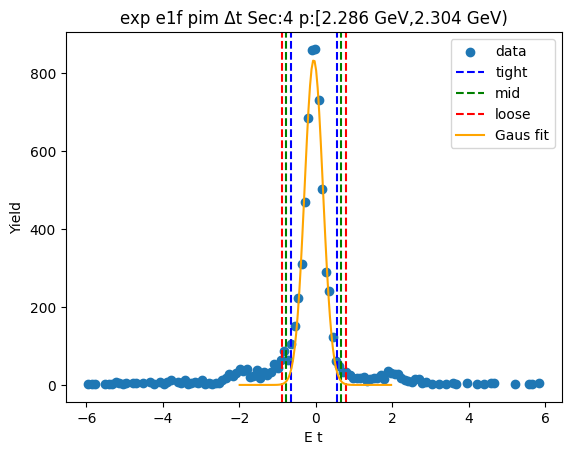

-0.6535592528132762 0.542823122255984
-0.7731974903202022 0.66246135976291
-0.8928357278271283 0.782099597269836


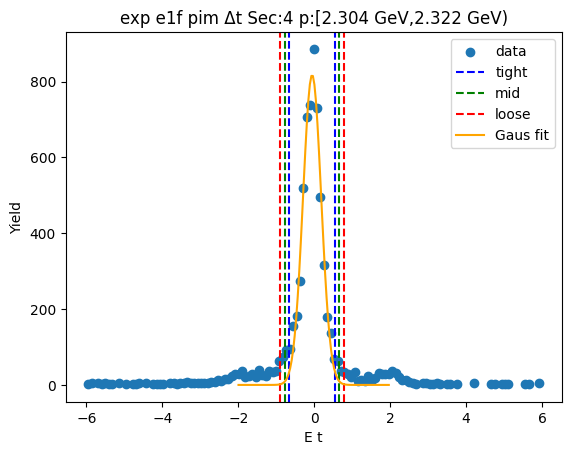

-0.6223078307963529 0.5203987312060784
-0.736578486996596 0.6346693874063215
-0.8508491431968391 0.7489400436065646


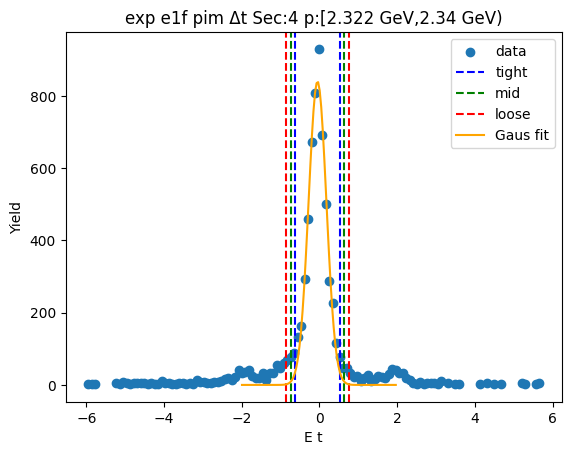

-0.6187417679009305 0.5273722951311438
-0.7333531742041379 0.6419837014343512
-0.8479645805073454 0.7565951077375587


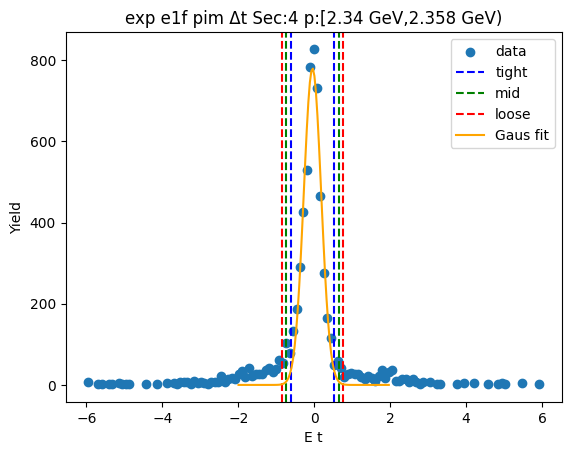

-0.6248481949515526 0.5318129822304539
-0.7405143126697533 0.6474790999486546
-0.856180430387954 0.7631452176668553


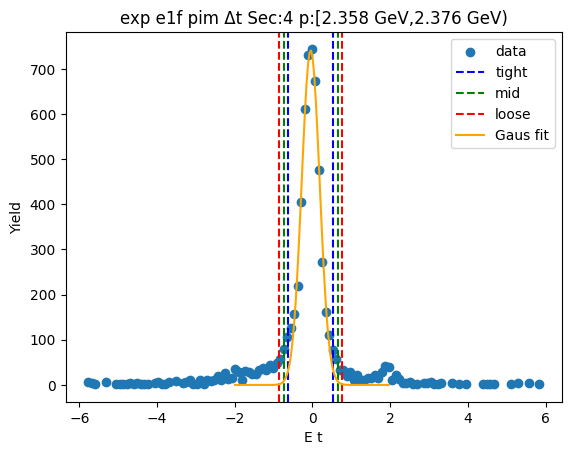

-0.6049231627500432 0.5281367364951891
-0.7182291526745664 0.6414427264197123
-0.8315351425990897 0.7547487163442356


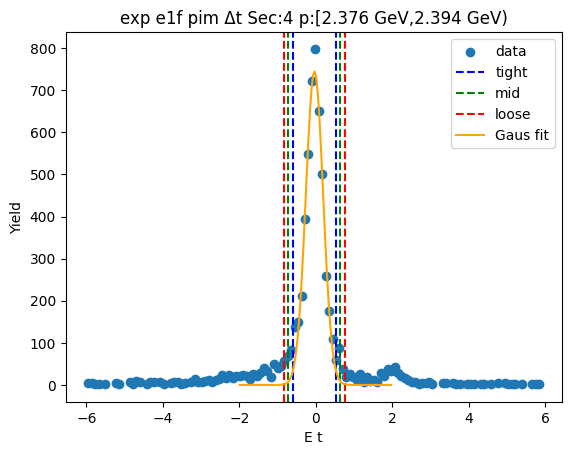

-1.0237181430887103 0.8230025554296593
-1.2083902129405475 1.0076746252814965
-1.3930622827923844 1.1923466951333335


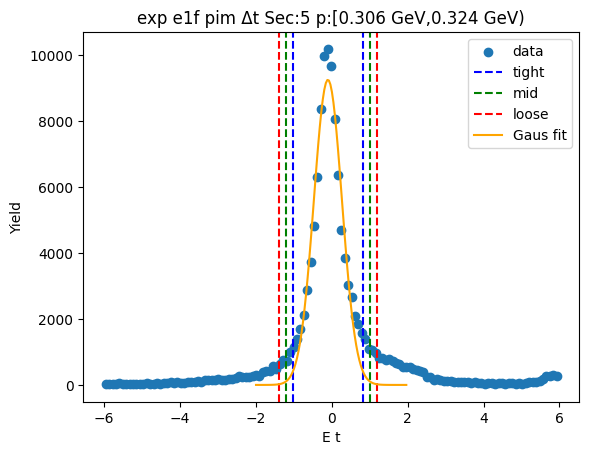

-0.987492717307566 0.797489762984634
-1.1659909653367861 0.9759880110138541
-1.344489213366006 1.154486259043074


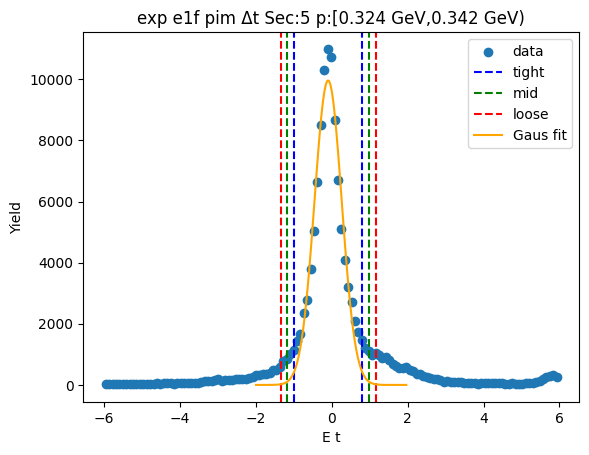

-0.9506805957373358 0.7647870001706644
-1.122227355328136 0.9363337597614644
-1.293774114918936 1.1078805193522643


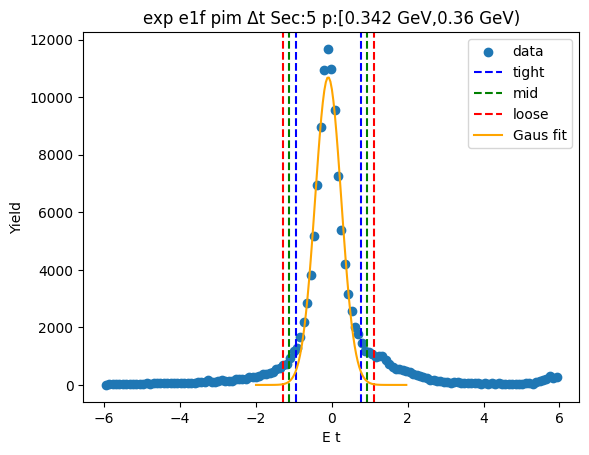

-0.9296598944525907 0.7529193068430833
-1.097917814582158 0.9211772269726506
-1.2661757347117255 1.0894351471022181


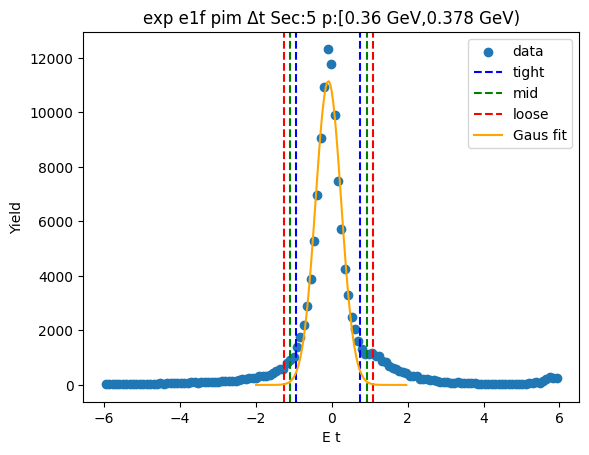

-0.8981136438745826 0.7276092399535997
-1.060685932257401 0.890181528336418
-1.2232582206402192 1.052753816719236


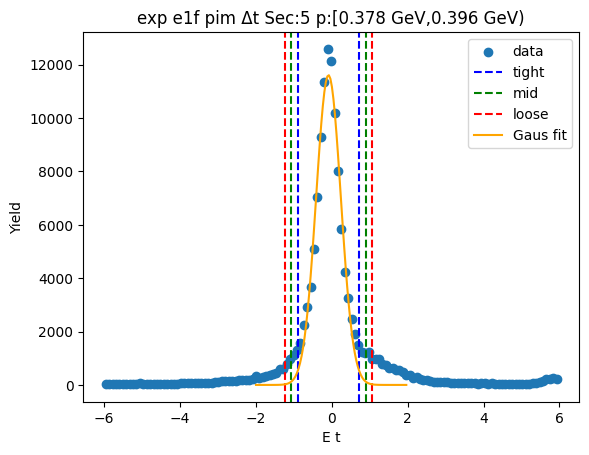

-0.8809244533005274 0.7161542159206038
-1.0406323202226404 0.8758620828427168
-1.2003401871447537 1.03556994976483


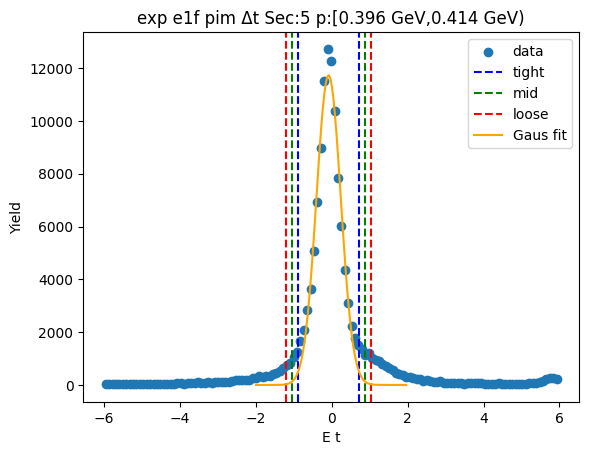

-0.8774907001245175 0.7071367249757857
-1.0359534426345476 0.865599467485816
-1.194416185144578 1.0240622099958465


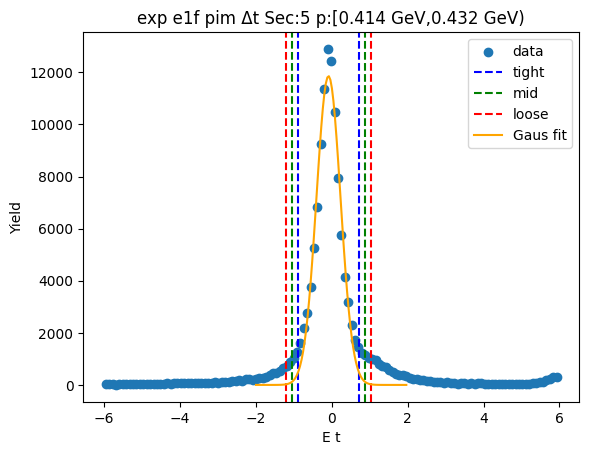

-0.855358821812221 0.6948528144527013
-1.0103799854387134 0.8498739780791936
-1.1654011490652056 1.0048951417056857


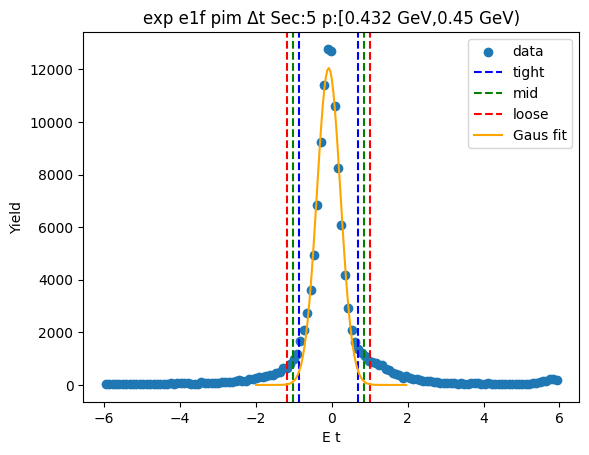

-0.8545533061111288 0.6898800121409205
-1.0089966379363335 0.8443233439661254
-1.1634399697615385 0.9987666757913303


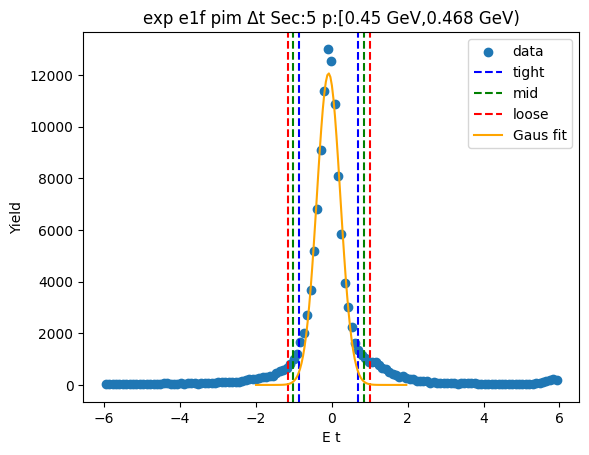

-0.8441552962234613 0.6863801369941609
-0.9972088395452234 0.839433680315923
-1.1502623828669858 0.9924872236376854


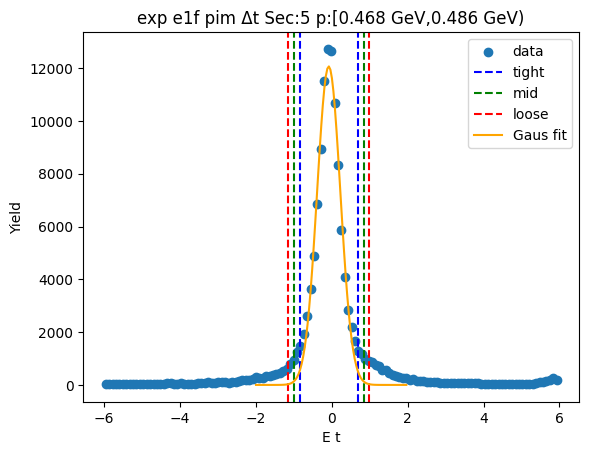

-0.835305985878494 0.6815197198015776
-0.9869885564465012 0.8332022903695847
-1.1386711270145082 0.9848848609375919


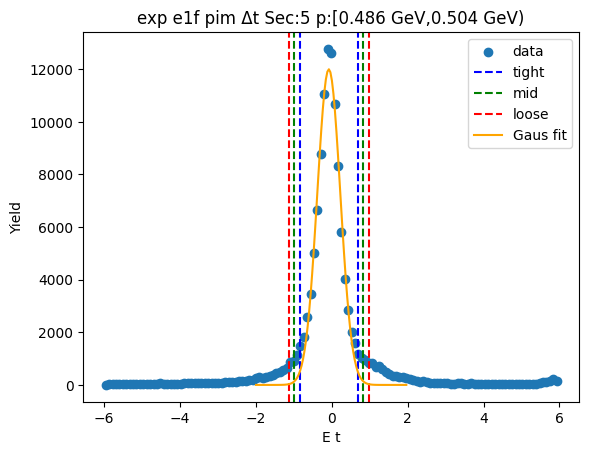

-0.8287638994378532 0.6705676399324039
-0.978697053374879 0.8205007938694296
-1.1286302073119048 0.9704339478064554


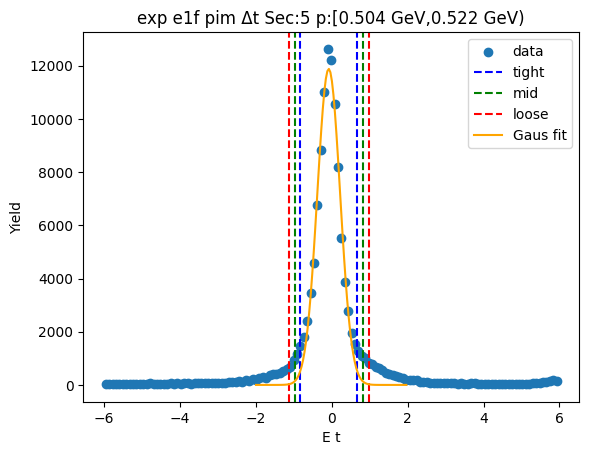

-0.822893724921507 0.6726364487103335
-0.9724467422846911 0.8221894660735175
-1.1219997596478752 0.9717424834367016


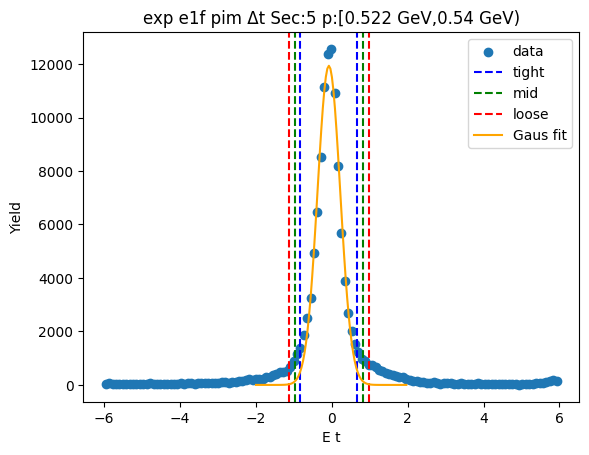

-0.816600505629703 0.668173872575657
-0.9650779434502389 0.8166513103961929
-1.113555381270775 0.9651287482167289


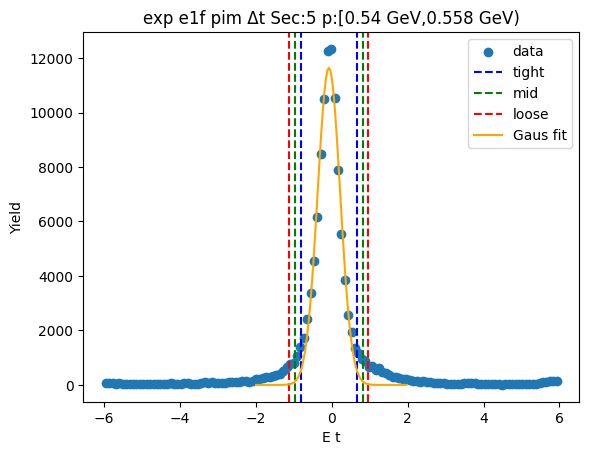

-0.8036283680576161 0.6595866061952814
-0.9499498654829057 0.8059081036205711
-1.0962713629081955 0.9522296010458609


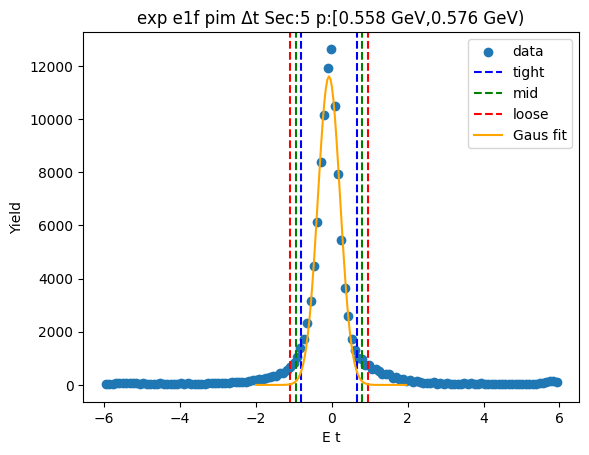

-0.8018802367331448 0.6604443002955003
-0.9481126904360092 0.8066767539983647
-1.0943451441388738 0.9529092077012292


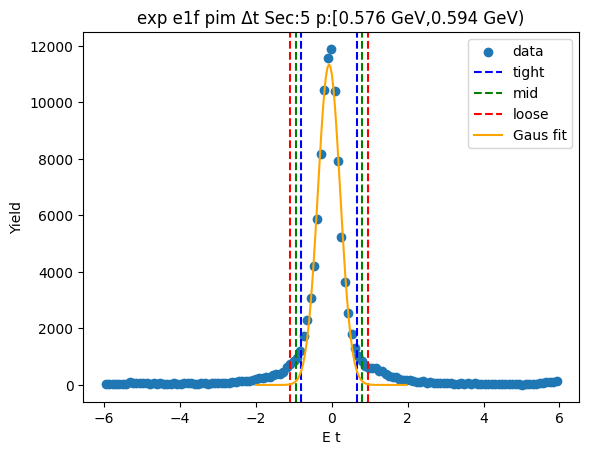

-0.7981447511356649 0.6502034617595497
-0.9429795724251864 0.7950382830490712
-1.087814393714708 0.9398731043385927


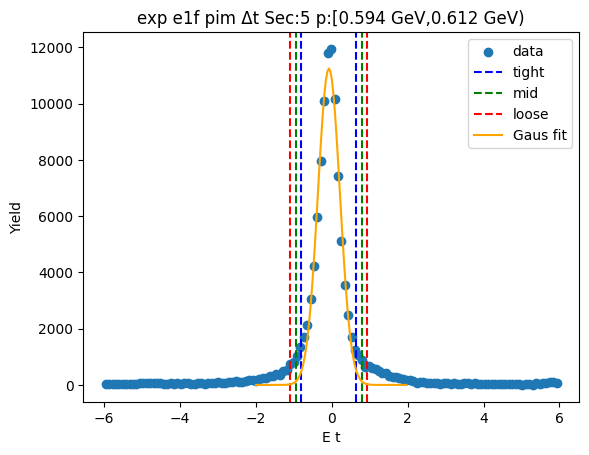

-0.8025785153003373 0.6644617089700742
-0.9492825377273784 0.8111657313971152
-1.0959865601544196 0.9578697538241565


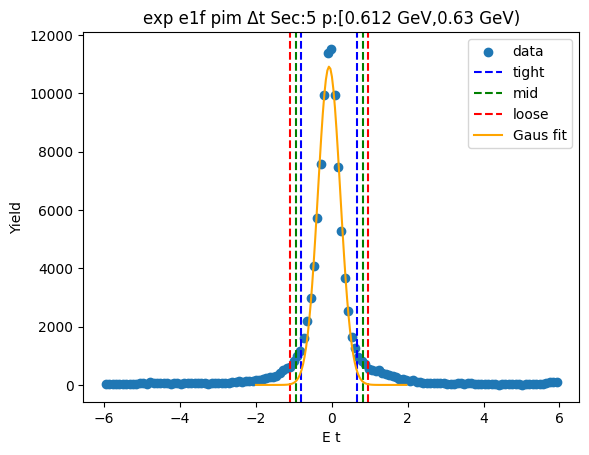

-0.8036568532914248 0.6551727456565883
-0.9495398131862262 0.8010557055513897
-1.0954227730810275 0.9469386654461911


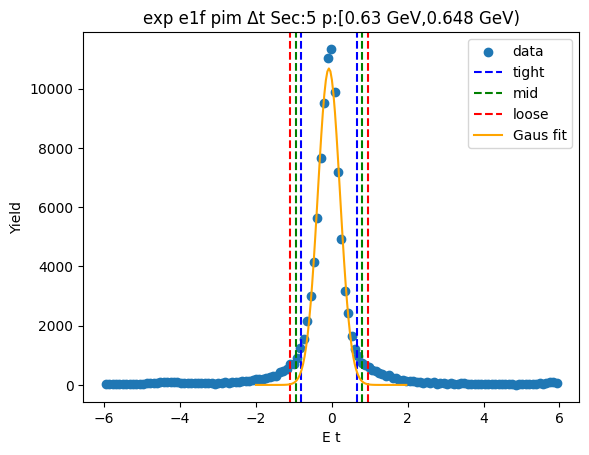

-0.8075239251939654 0.662830949712385
-0.9545594126846005 0.8098664372030201
-1.1015949001752356 0.9569019246936552


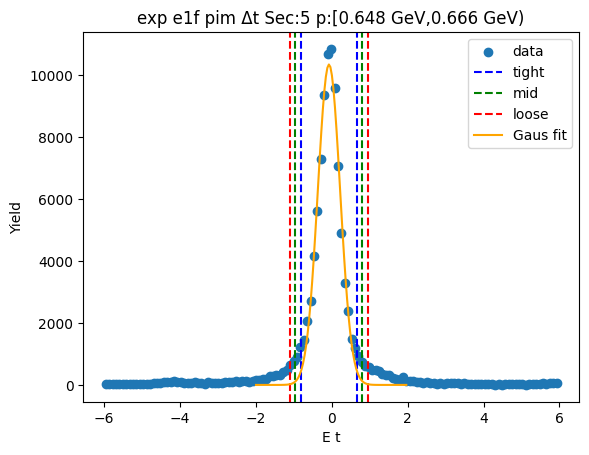

-0.7987454602624249 0.6542994861663092
-0.9440499549052982 0.7996039808091825
-1.0893544495481715 0.9449084754520559


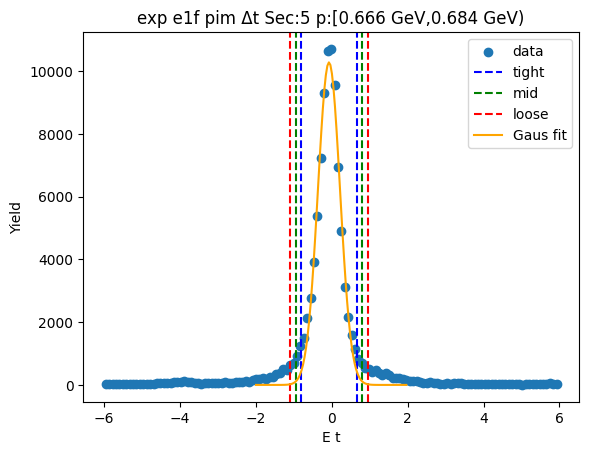

-0.7977618181488942 0.6487748784901891
-0.9424154878128025 0.7934285481540974
-1.0870691574767108 0.9380822178180058


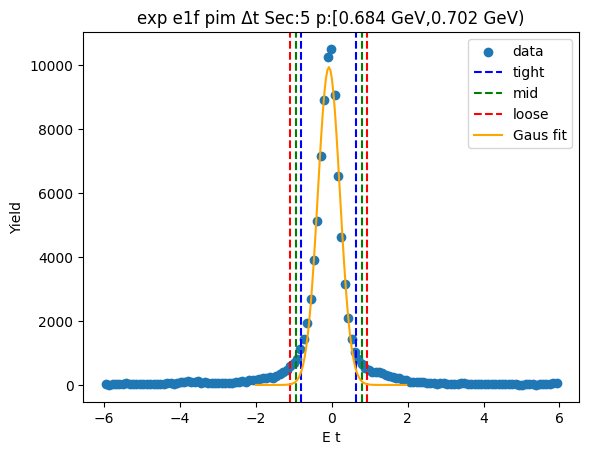

-0.7926092287851223 0.6482915470790847
-0.9366993063715432 0.7923816246655053
-1.0807893839579639 0.936471702251926


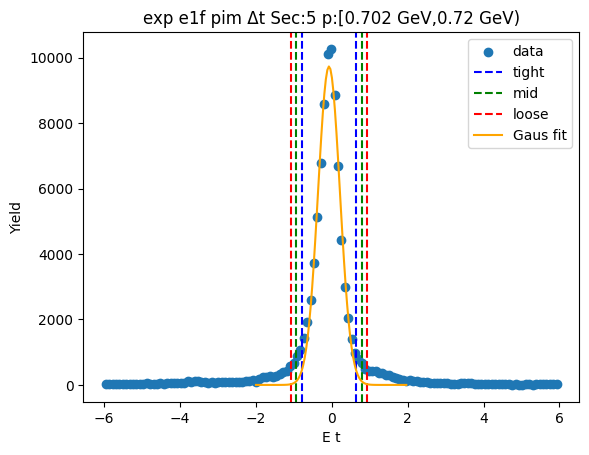

-0.7968400383533234 0.6464347585795176
-0.9411675180466076 0.7907622382728018
-1.0854949977398918 0.9350897179660859


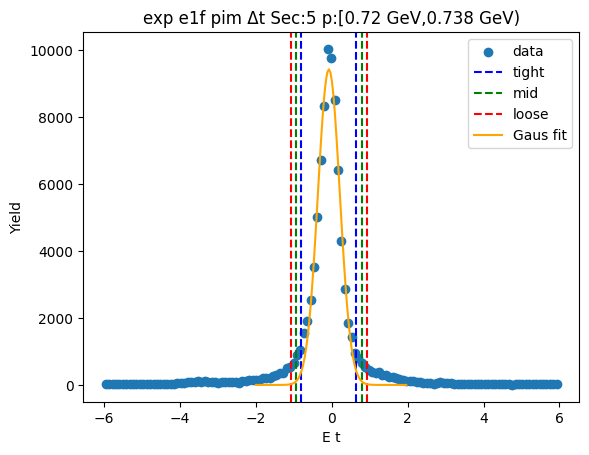

-0.7840994144290443 0.6427563820350273
-0.9267849940754515 0.7854419616814344
-1.0694705737218586 0.9281275413278416


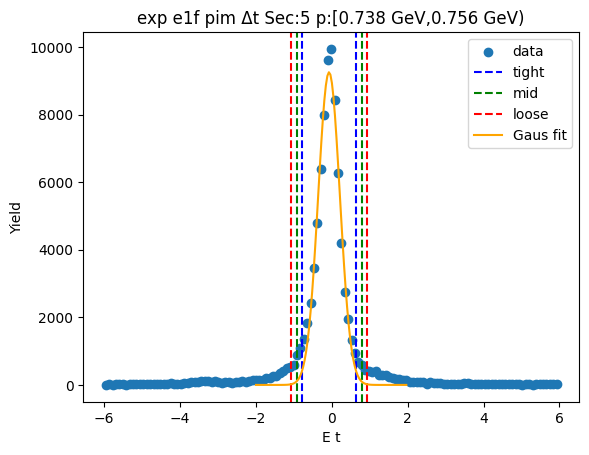

-0.7941486654119331 0.6487264892285866
-0.9384361808759851 0.7930140046926386
-1.082723696340037 0.9373015201566905


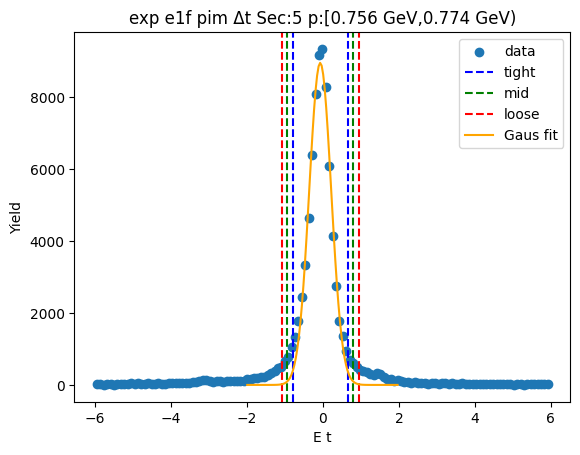

-0.7916707536738001 0.646363947744325
-0.9354742238156127 0.7901674178861376
-1.0792776939574253 0.9339708880279501


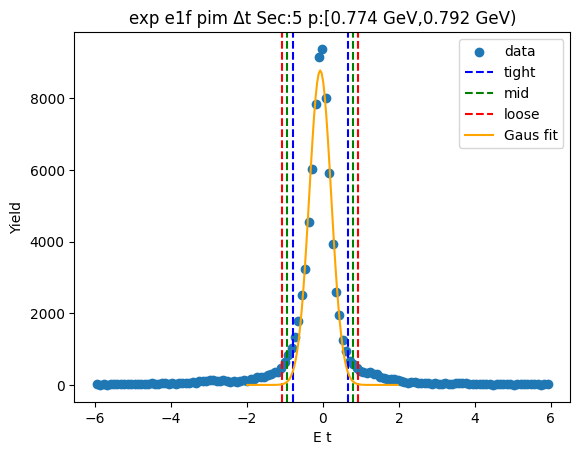

-0.7939908596092666 0.6449382034060547
-0.9378837659107987 0.7888311097075867
-1.0817766722123308 0.9327240160091188


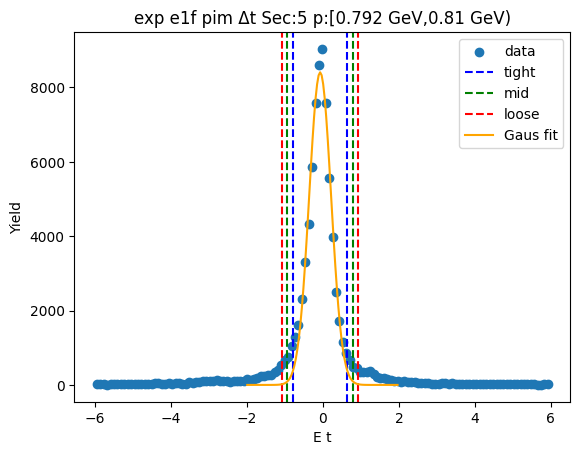

-0.7913004312275016 0.6404473266582922
-0.9344752070160809 0.7836221024468715
-1.0776499828046604 0.926796878235451


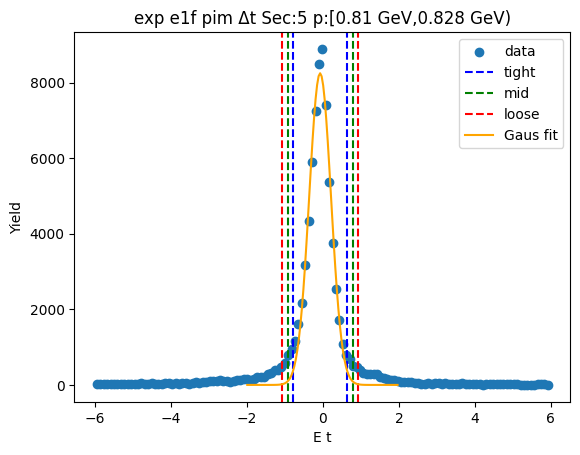

-0.778883337855754 0.6304304324028824
-0.9198147148816176 0.771361809428746
-1.0607460919074811 0.9122931864546097


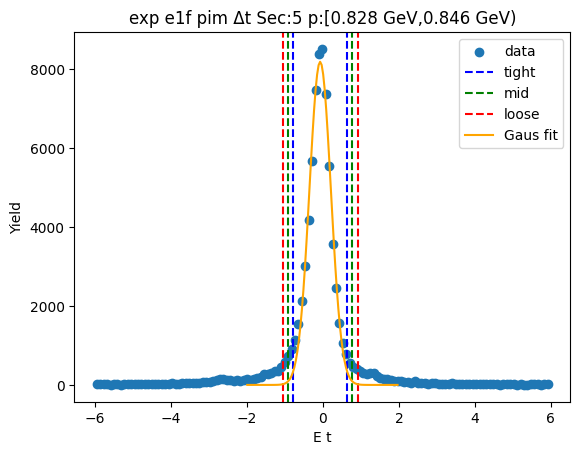

-0.7792826906470871 0.6337597627794185
-0.9205869359897377 0.7750640081220691
-1.0618911813323884 0.9163682534647197


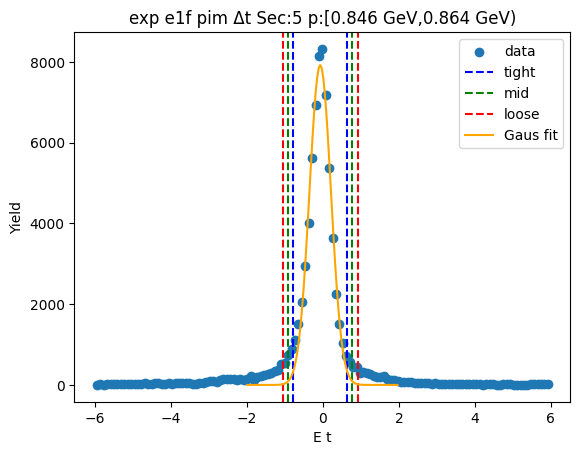

-0.7897356778418271 0.6486123242714609
-0.933570478053156 0.7924471244827898
-1.0774052782644847 0.9362819246941185


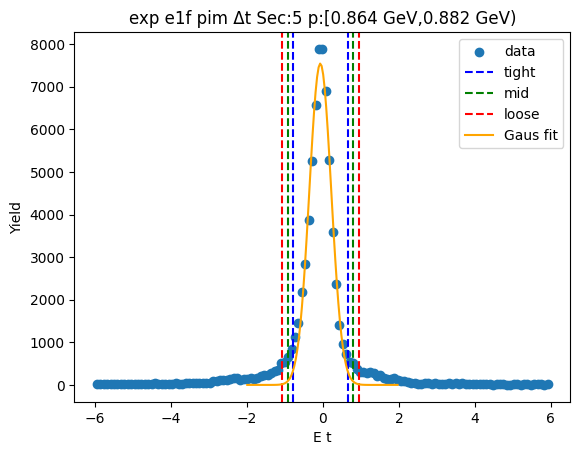

-0.7742538814650772 0.6322701558645833
-0.9149062851980433 0.7729225595975494
-1.0555586889310093 0.9135749633305155


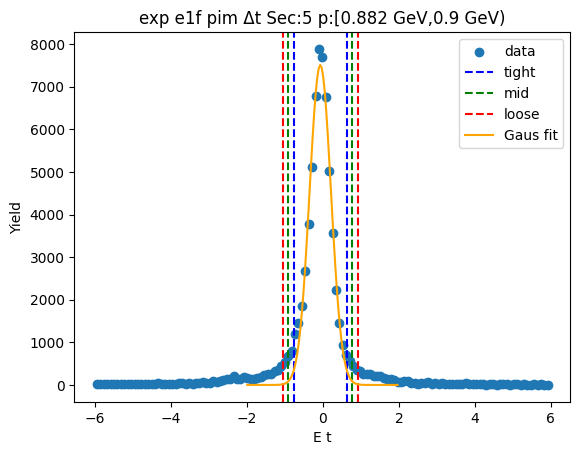

-0.7758532059496168 0.6266079787256047
-0.916099324417139 0.7668540971931269
-1.0563454428846613 0.9071002156606491


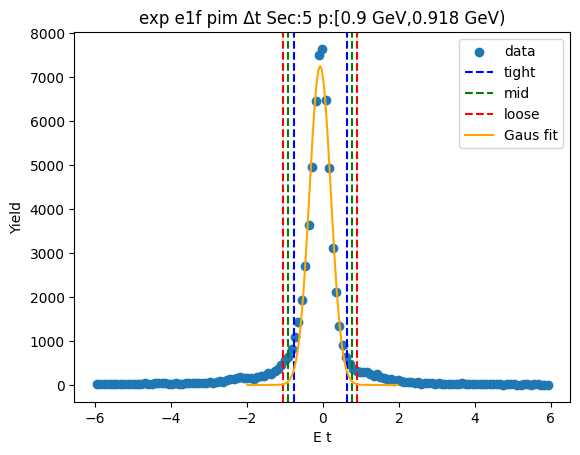

-0.7801418403921853 0.629680253897556
-0.9211240498211595 0.7706624633265302
-1.0621062592501336 0.9116446727555043


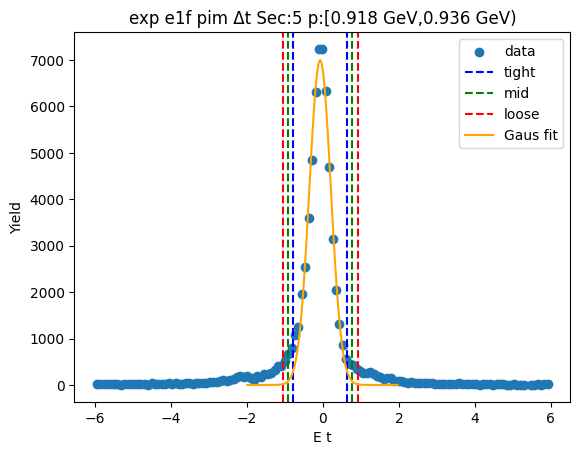

-0.76637475217699 0.6252381964788302
-0.905536047042572 0.7643994913444121
-1.044697341908154 0.9035607862099941


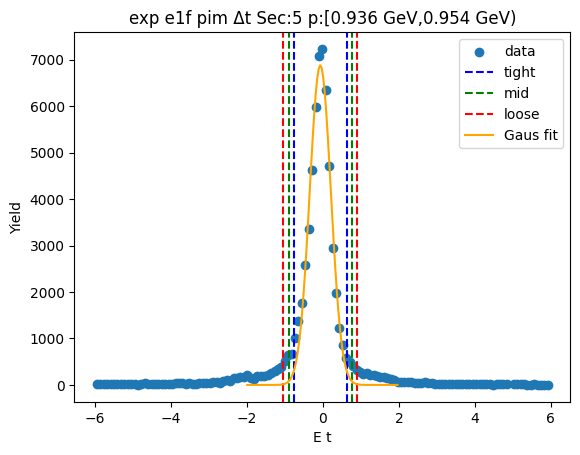

-0.7848156510911735 0.6425316473940386
-0.9275503809396947 0.7852663772425598
-1.0702851107882159 0.928001107091081


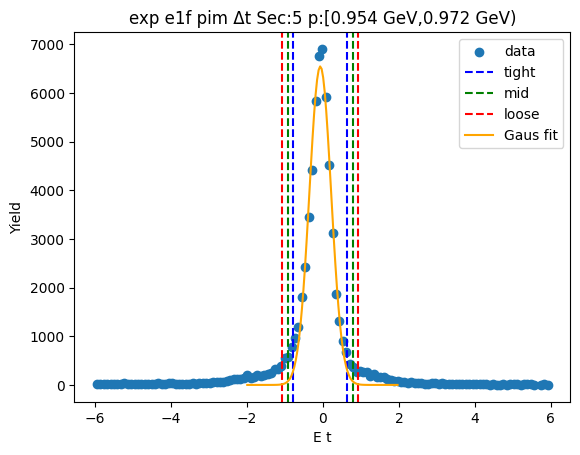

-0.7646049940867558 0.6228596686210405
-0.9033514603575354 0.7616061348918202
-1.0420979266283152 0.9003526011625999


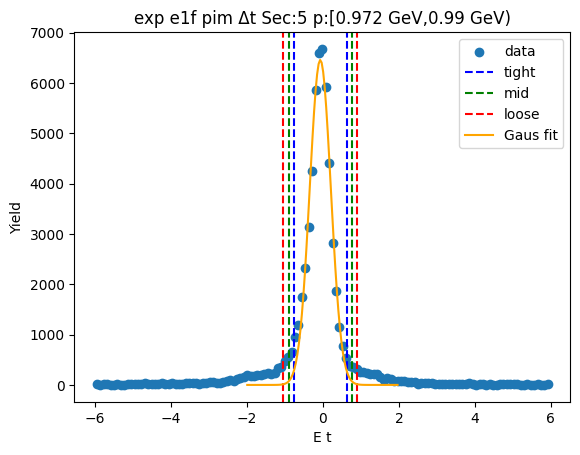

-0.7635668319392377 0.6214625989066214
-0.9020697750238237 0.7599655419912074
-1.0405727181084097 0.8984684850757932


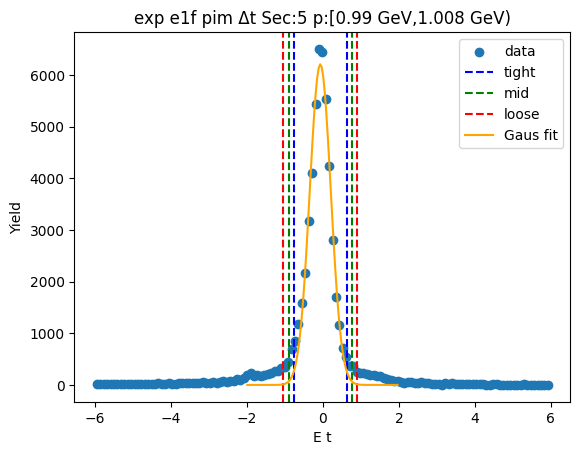

-0.7731907267881607 0.620331026136271
-0.912542902080604 0.7596832014287143
-1.051895077373047 0.8990353767211574


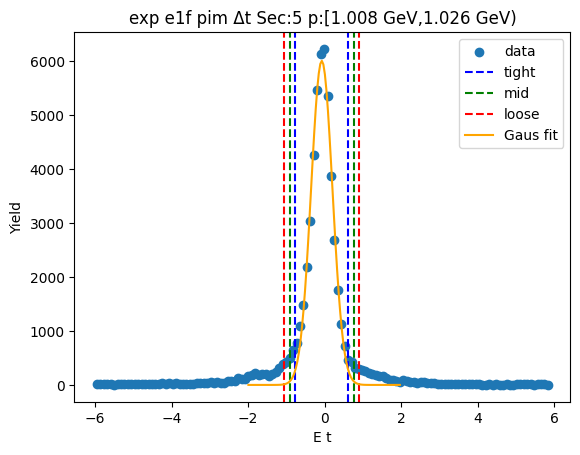

-0.7739366185787402 0.6277958966911967
-0.914109870105734 0.7679691482181905
-1.0542831216327275 0.9081423997451842


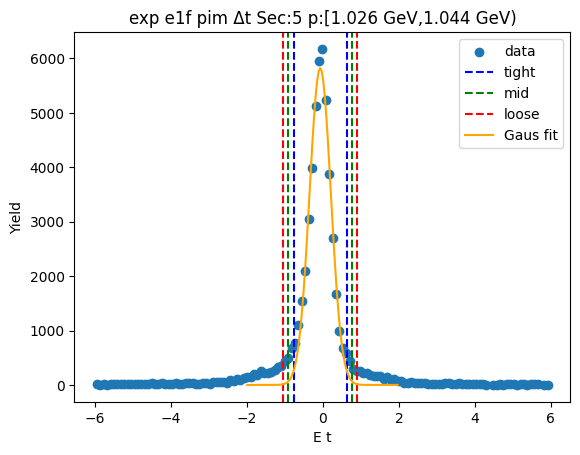

-0.7687665593227339 0.6214715699143646
-0.9077903722464438 0.7604953828380745
-1.0468141851701536 0.8995191957617844


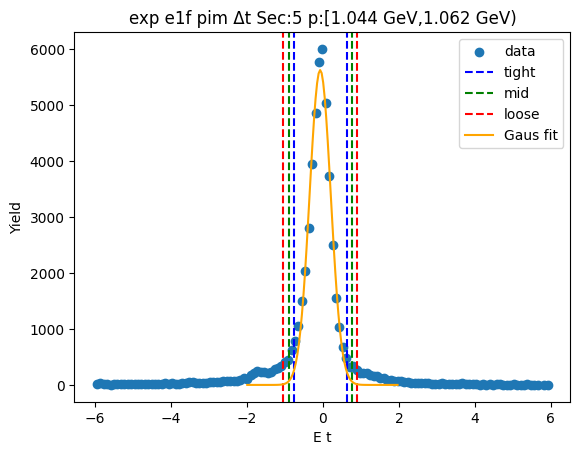

-0.7646875956011635 0.6199353274110172
-0.9031498879023815 0.7583976197122352
-1.0416121802035996 0.8968599120134533


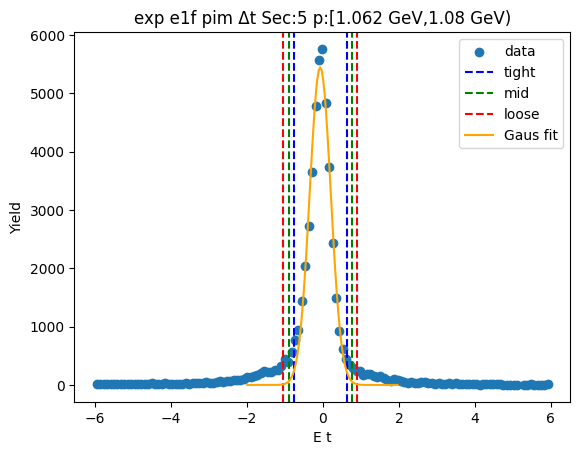

-0.7584569857650955 0.6128238684556969
-0.8955850711871748 0.7499519538777762
-1.032713156609254 0.8870800392998555


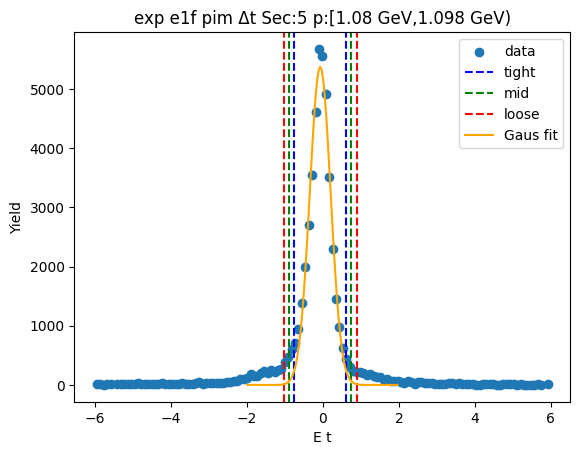

-0.7392591606970964 0.6073501805631802
-0.8739200948231242 0.742011114689208
-1.0085810289491517 0.8766720488152356


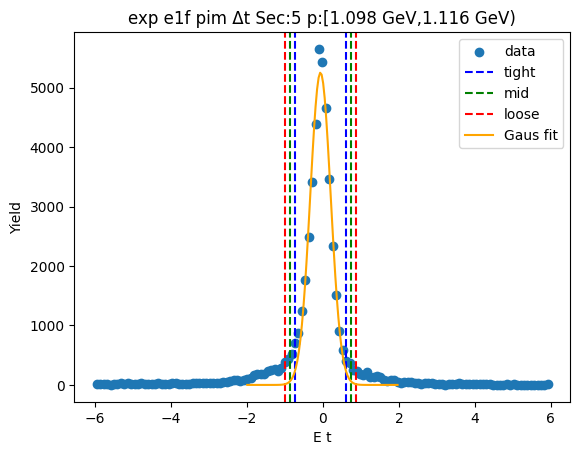

-0.7407812026839886 0.6033877459270709
-0.8751980975450945 0.7378046407881768
-1.0096149924062003 0.8722215356492827


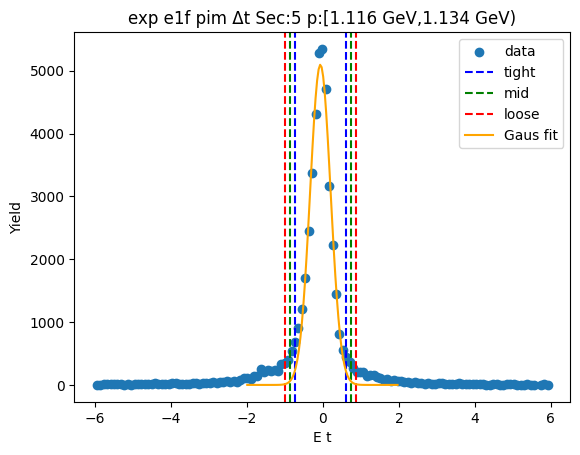

-0.7530649811759038 0.6187998083376018
-0.8902514601272543 0.7559862872889523
-1.0274379390786048 0.8931727662403028


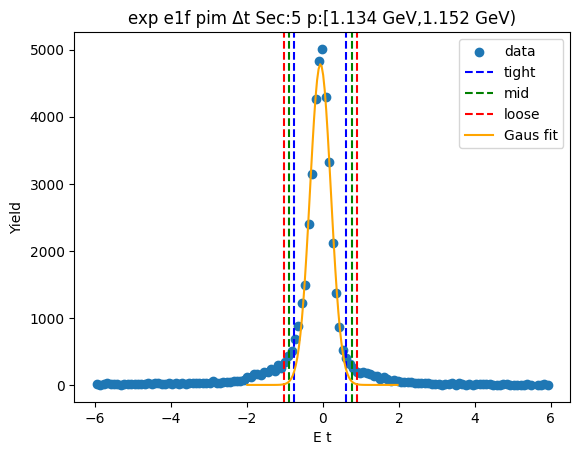

-0.7417531909142541 0.6070646996247762
-0.8766349799681571 0.7419464886786792
-1.0115167690220601 0.8768282777325822


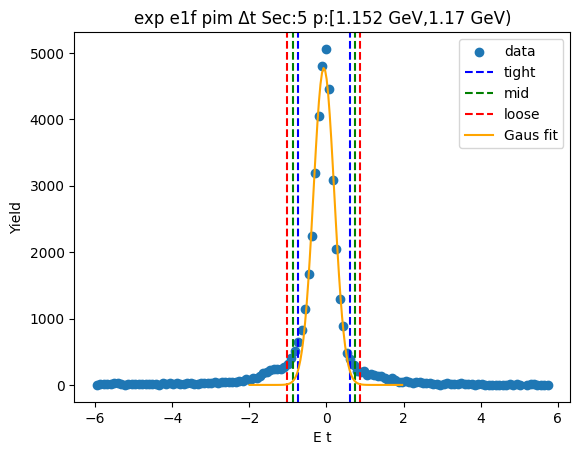

-0.7478821708924576 0.6120517553665513
-0.8838755635183584 0.7480451479924521
-1.019868956144259 0.884038540618353


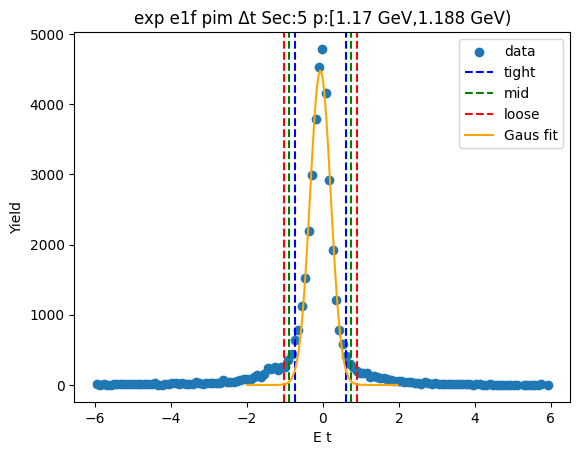

-0.742934382683989 0.6109051409472858
-0.8783183350471164 0.7462890933104132
-1.013702287410244 0.8816730456735407


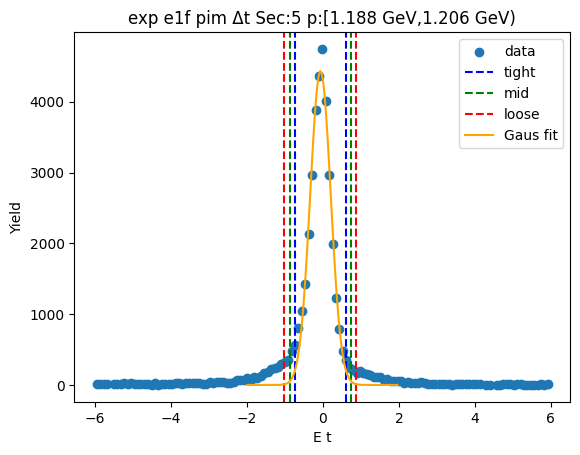

-0.7308535851746598 0.6042405359922043
-0.8643629972913461 0.7377499481088906
-0.9978724094080326 0.871259360225577


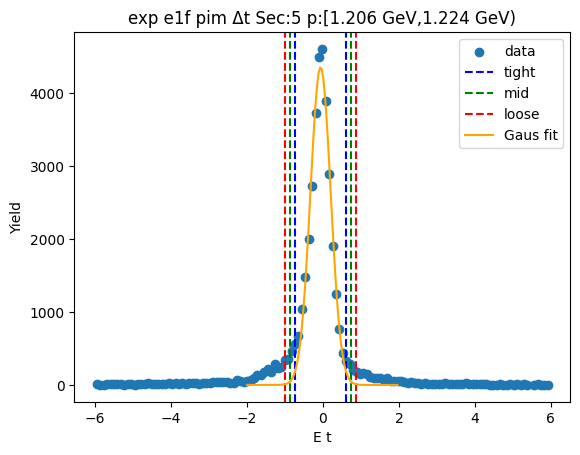

-0.7461010988915313 0.6114105603141291
-0.8818522648120974 0.7471617262346952
-1.0176034307326633 0.8829128921552613


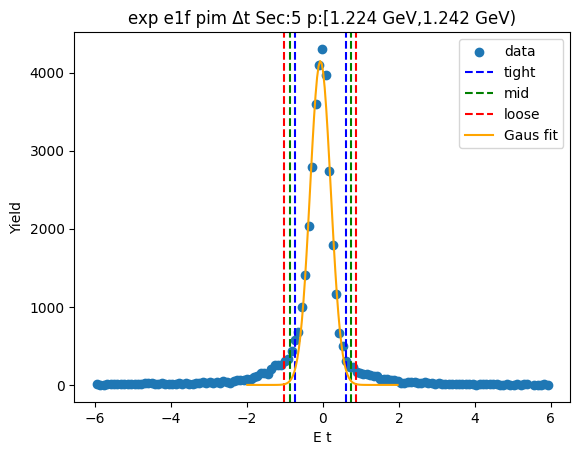

-0.7168102327036585 0.5967838243181087
-0.848169638405835 0.7281432300202855
-0.9795290441080118 0.8595026357224622


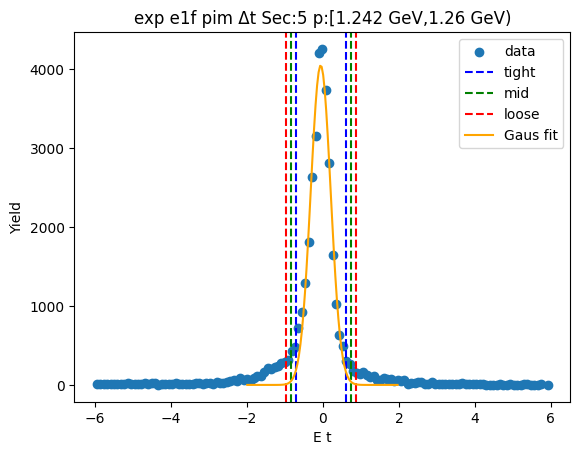

-0.7324521302473884 0.6073886070835316
-0.8664362039804805 0.7413726808166237
-1.0004202777135727 0.8753567545497157


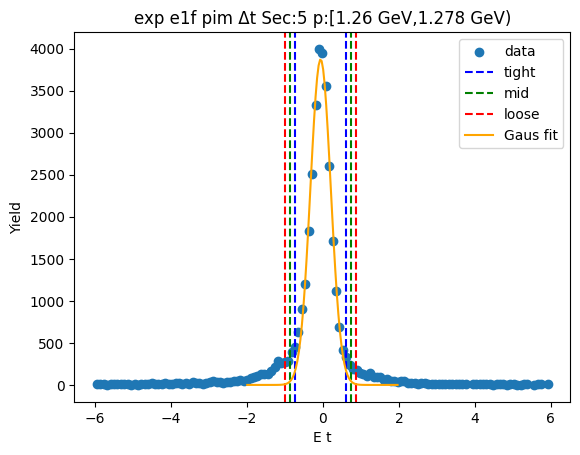

-0.7270417021904838 0.6070469833492032
-0.8604505707444524 0.7404558519031718
-0.9938594392984211 0.8738647204571405


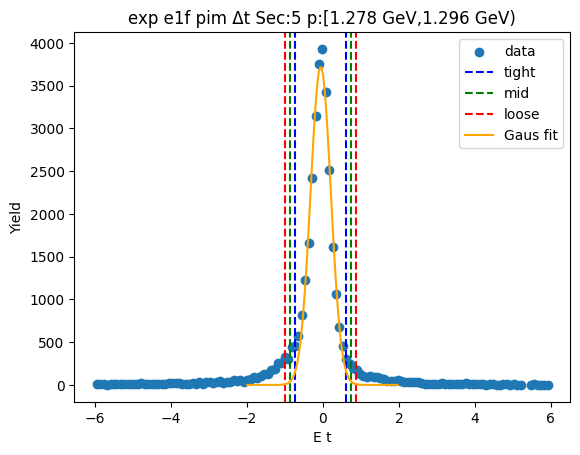

-0.7272539760820113 0.6097894095906872
-0.8609583146492812 0.7434937481579571
-0.994662653216551 0.8771980867252269


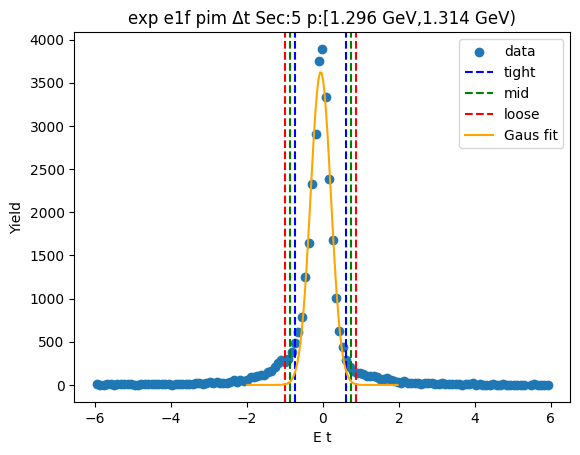

-0.7119427215286145 0.5990630692614918
-0.8430433006076251 0.7301636483405024
-0.9741438796866357 0.861264227419513


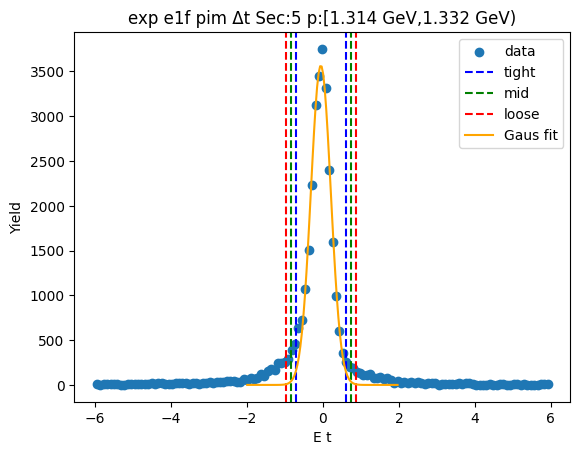

-0.718121317553928 0.5956278926270209
-0.8494962385720229 0.7270028136451158
-0.9808711595901178 0.8583777346632107


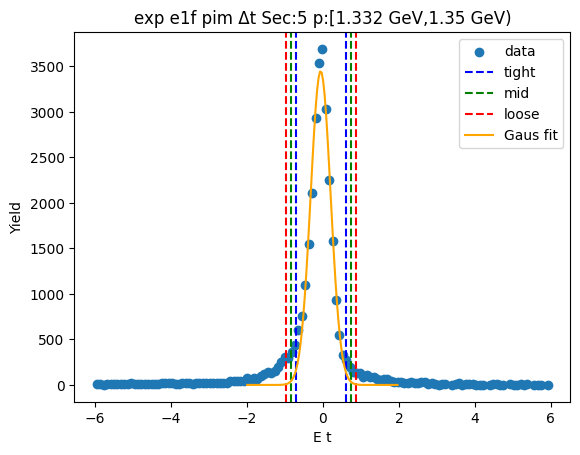

-0.7114531006142233 0.5896767325832262
-0.8415660839339681 0.719789715902971
-0.9716790672537131 0.849902699222716


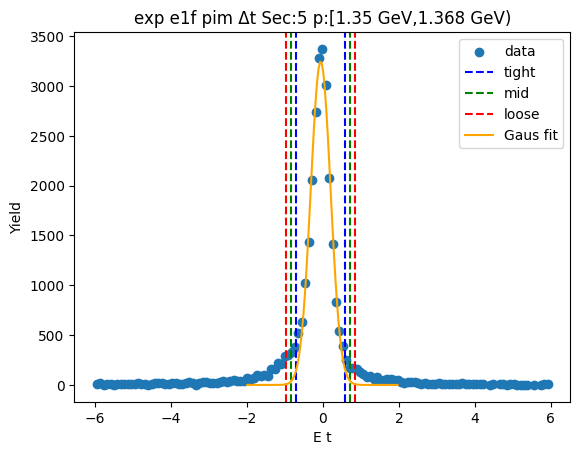

-0.7053826130905174 0.6007441994196181
-0.835995294341531 0.7313568806706316
-0.9666079755925445 0.8619695619216452


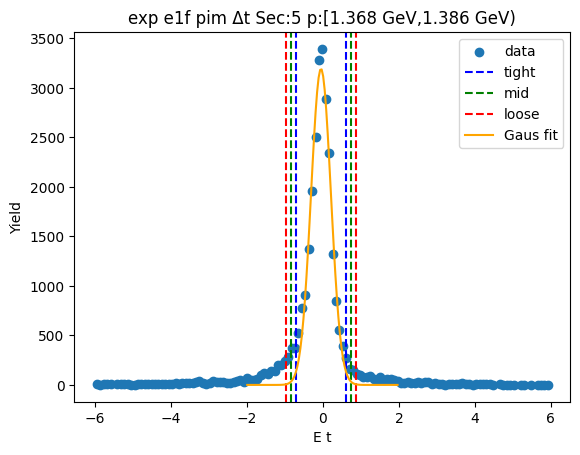

-0.715434583876607 0.6032488463694212
-0.8473029269012098 0.735117189394024
-0.9791712699258126 0.8669855324186269


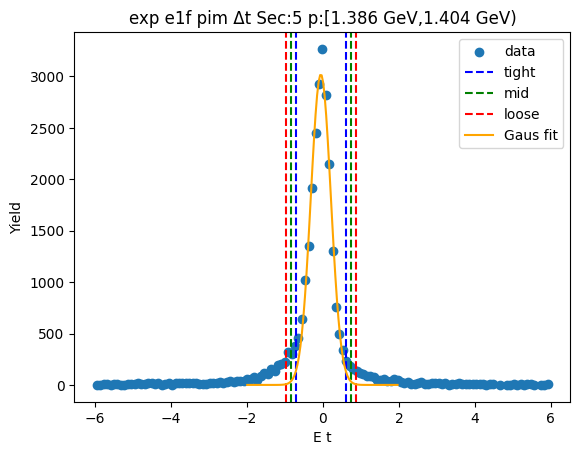

-0.7044972294194424 0.596538170262029
-0.8346007693875894 0.7266417102301761
-0.9647043093557366 0.8567452501983233


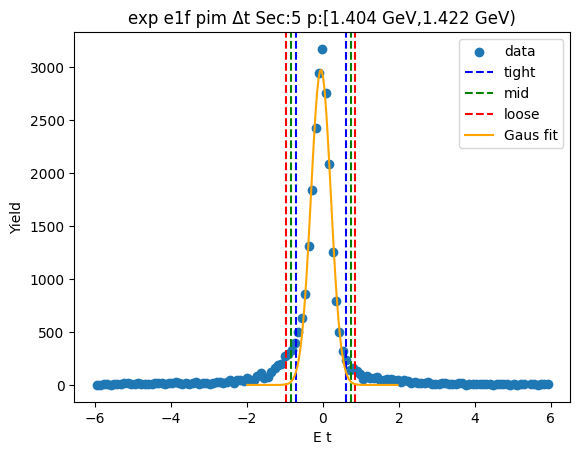

-0.7010278733818187 0.5895273496357314
-0.8300833956835738 0.7185828719374865
-0.9591389179853288 0.8476383942392415


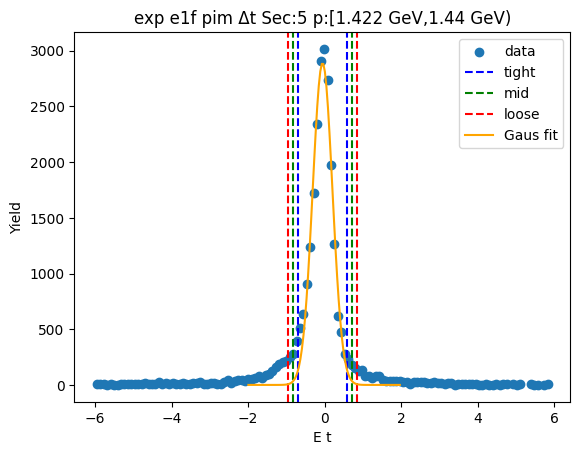

-0.7100457312658311 0.6047775667252732
-0.8415280610649415 0.7362598965243835
-0.9730103908640519 0.867742226323494


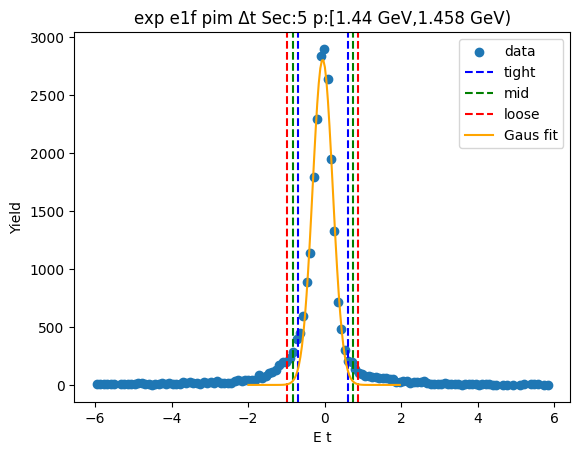

-0.706353896898511 0.5867969800699973
-0.8356689845953618 0.716112067766848
-0.9649840722922125 0.845427155463699


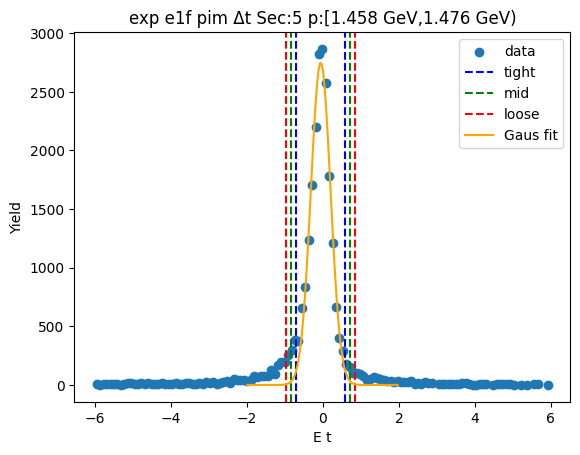

-0.7115763004290415 0.6036744347455553
-0.8431013739465012 0.735199508263015
-0.9746264474639609 0.8667245817804746


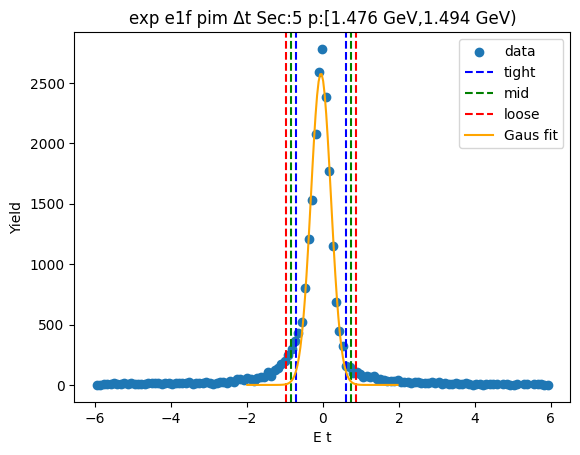

-0.6914125062660458 0.6026479560013019
-0.8208185524927805 0.7320540022280366
-0.9502245987195153 0.8614600484547714


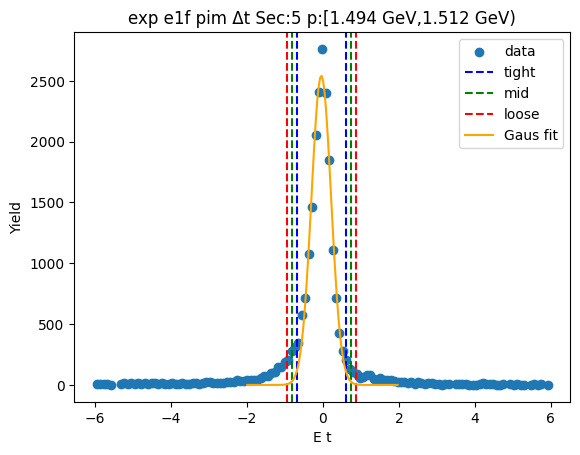

-0.7153201378948532 0.613705709792791
-0.8482227226636176 0.7466082945615555
-0.9811253074323821 0.87951087933032


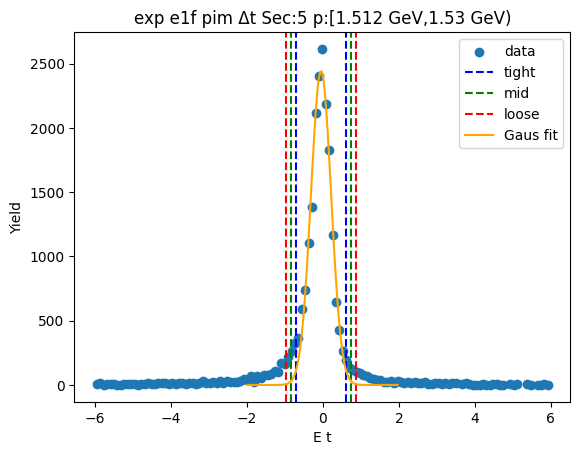

-0.7063873729461435 0.607079119668866
-0.8377340222076444 0.7384257689303668
-0.9690806714691453 0.8697724181918678


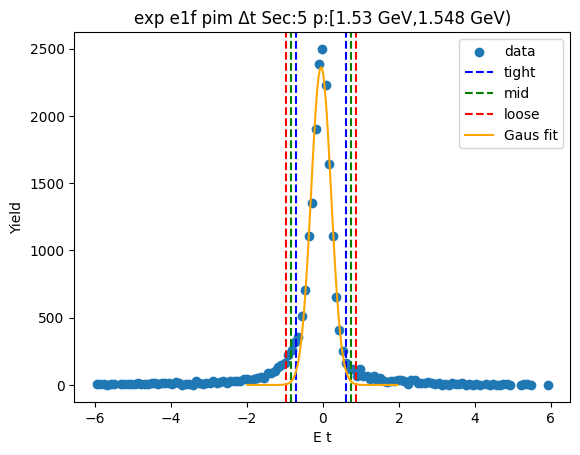

-0.6970349214848585 0.5953789469256924
-0.8262763083259135 0.7246203337667474
-0.9555176951669685 0.8538617206078024


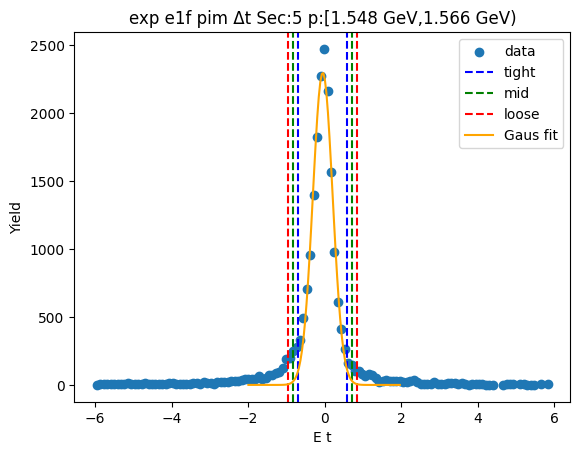

-0.6833844617314643 0.5855783377882583
-0.8102807416834364 0.7124746177402305
-0.9371770216354087 0.8393708976922027


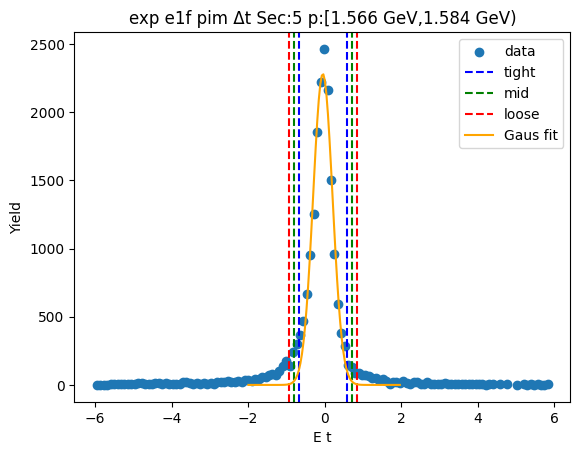

-0.6947509611957141 0.5952832849257308
-0.8237543858078585 0.7242867095378752
-0.952757810420003 0.8532901341500196


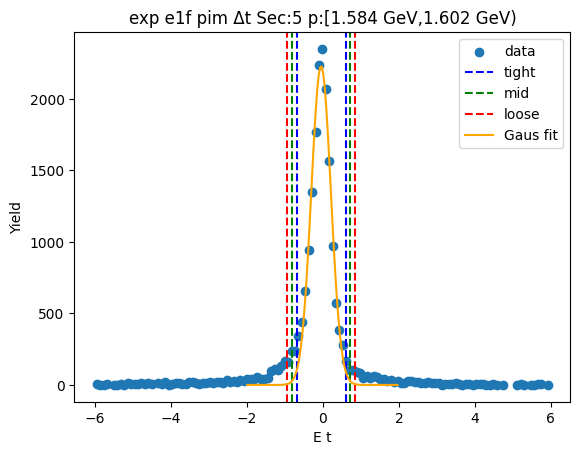

-0.6905113463363882 0.5996296481999289
-0.8195254457900198 0.7286437476535605
-0.9485395452436516 0.8576578471071923


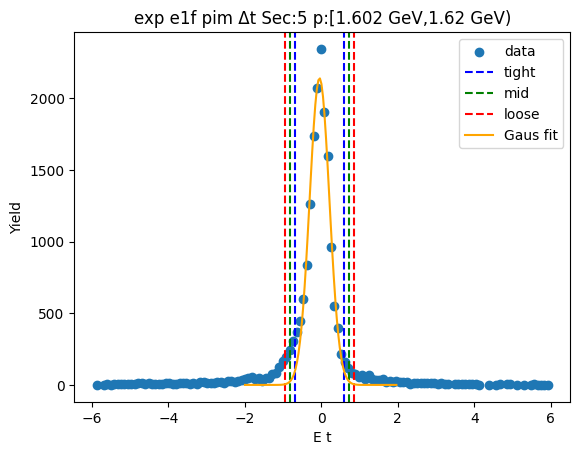

-0.6892055937525323 0.5982838693462811
-0.8179545400624137 0.7270328156561625
-0.9467034863722951 0.8557817619660438


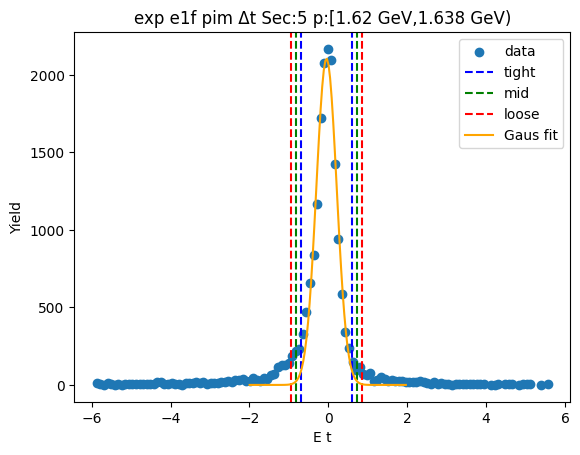

-0.6983721738480277 0.6070762098925935
-0.8289170122220899 0.7376210482666554
-0.9594618505961519 0.8681658866407176


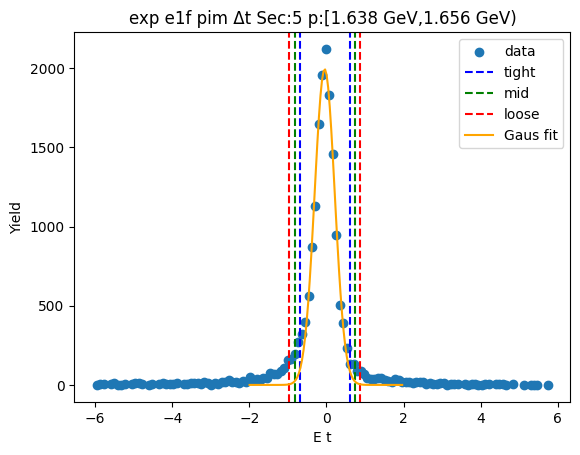

-0.6781659325901567 0.6016122471038311
-0.8061437505595554 0.7295900650732299
-0.9341215685289542 0.8575678830426287


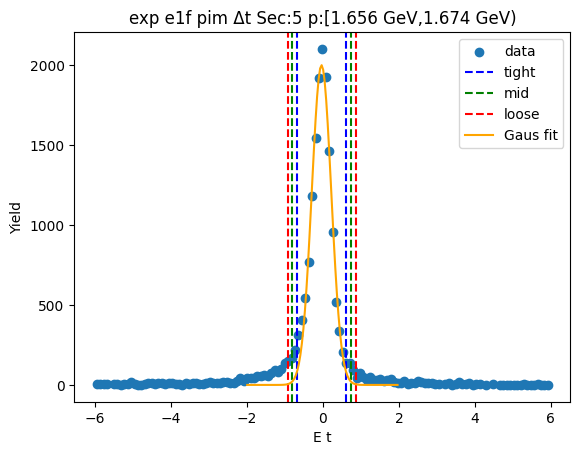

-0.6835458157950395 0.5913385689941529
-0.8110342542739588 0.7188270074730723
-0.938522692752878 0.8463154459519915


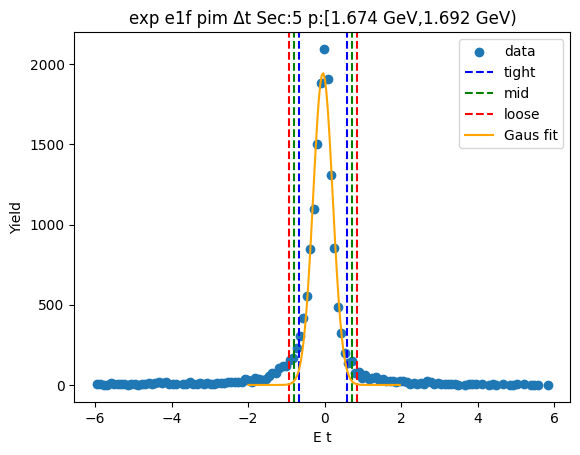

-0.6853530579628726 0.599694841366091
-0.8138578478957689 0.7281996312989872
-0.9423626378286653 0.8567044212318836


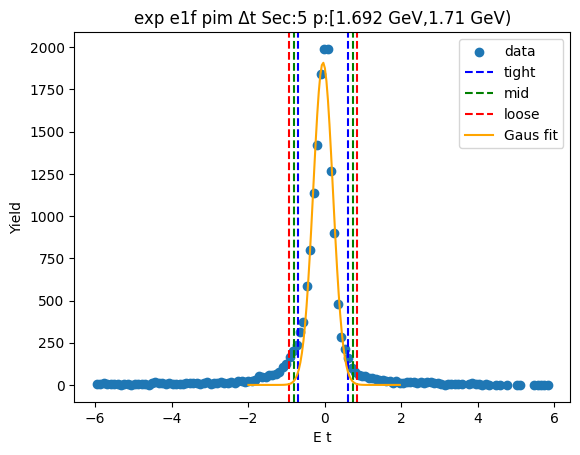

-0.6947975767633627 0.5938703805645498
-0.823664372496154 0.722737176297341
-0.9525311682289452 0.8516039720301323


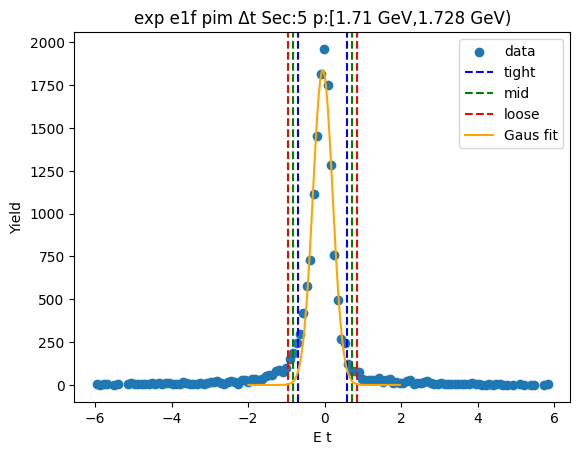

-0.6714586409380628 0.5783806423141821
-0.7964425692632874 0.7033645706394066
-0.9214264975885118 0.828348498964631


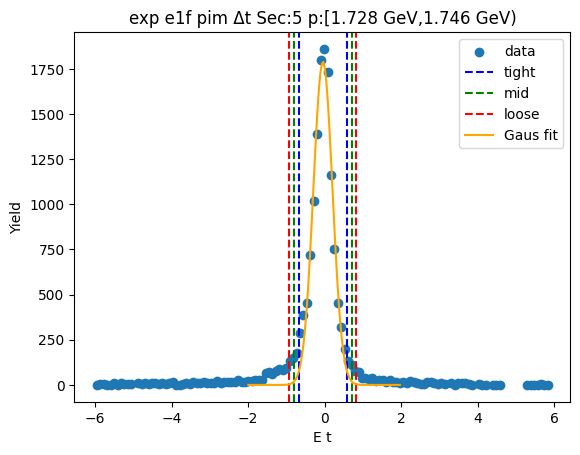

-0.6647877535170387 0.5836859655242334
-0.7896351254211659 0.7085333374283606
-0.9144824973252931 0.8333807093324878


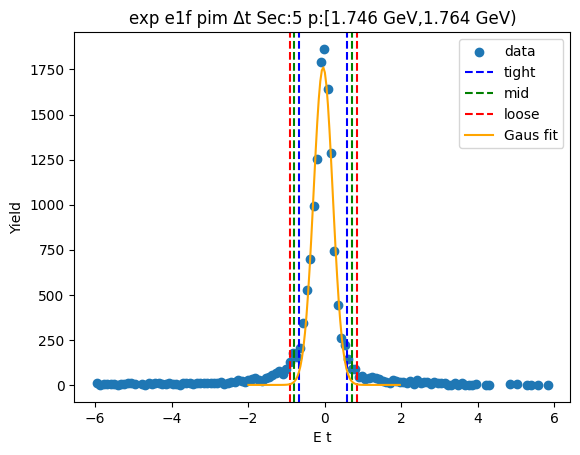

-0.6883195724598276 0.609040969541886
-0.818055626659999 0.7387770237420574
-0.9477916808601704 0.8685130779422289


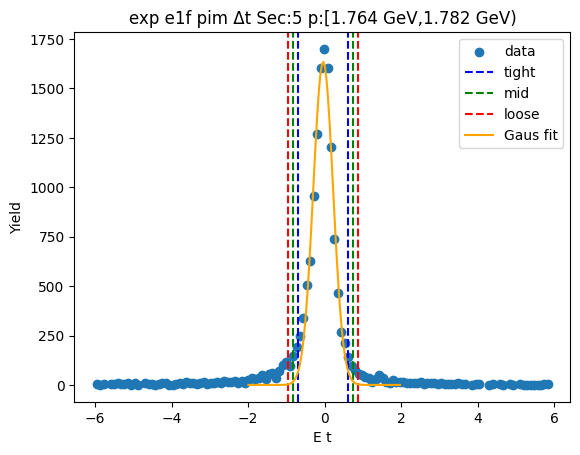

-0.6834037746765433 0.5994750288023674
-0.8116916550244344 0.7277629091502584
-0.9399795353723255 0.8560507894981495


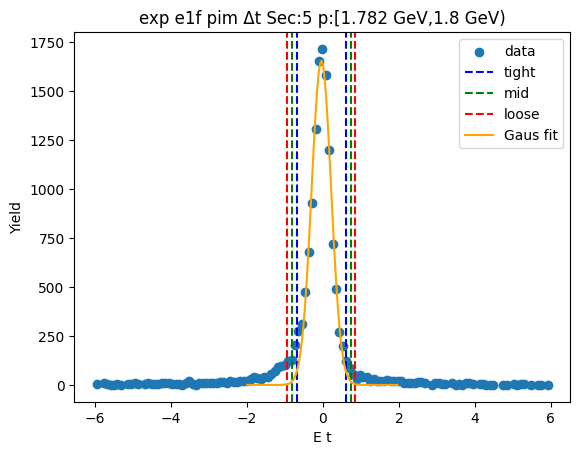

-0.683135362449939 0.6030718709728125
-0.8117560857922141 0.7316925943150876
-0.9403768091344893 0.8603133176573627


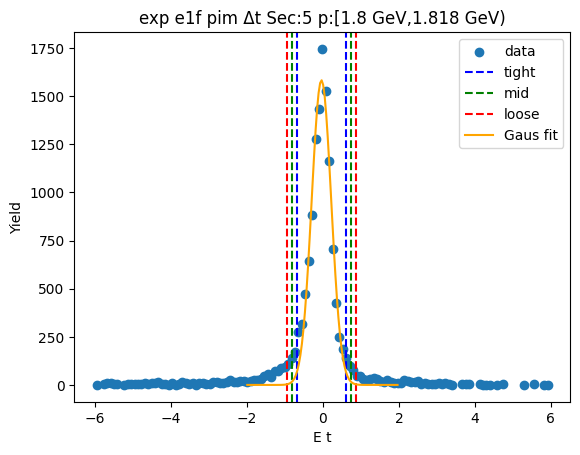

-0.6959622935847481 0.6009145072805856
-0.8256499736712815 0.7306021873671189
-0.9553376537578148 0.8602898674536522


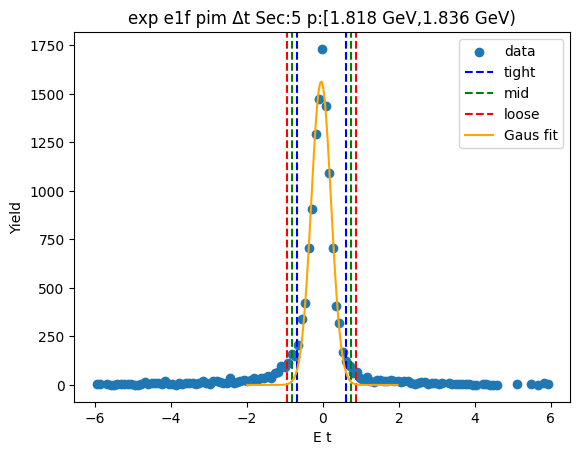

-0.6777943841756456 0.5942799853520705
-0.8050018211284173 0.7214874223048422
-0.9322092580811889 0.8486948592576138


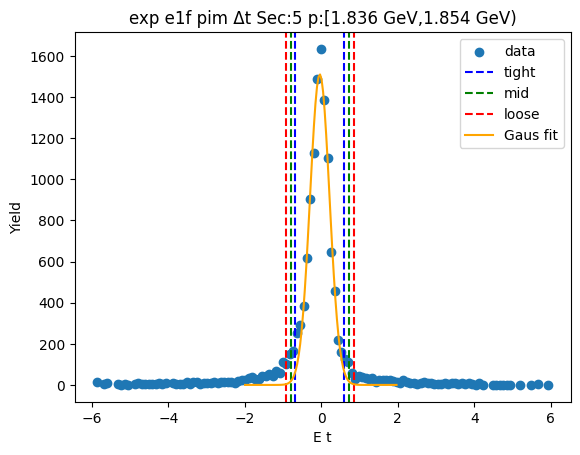

-0.6627055295511106 0.5774217789151241
-0.7867182603977341 0.7014345097617476
-0.9107309912443575 0.825447240608371


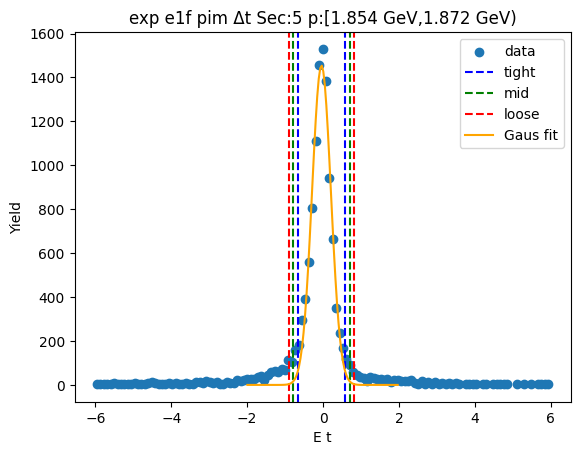

-0.6888134458523083 0.5938893335124031
-0.8170837237887794 0.7221596114488742
-0.9453540017252505 0.8504298893853454


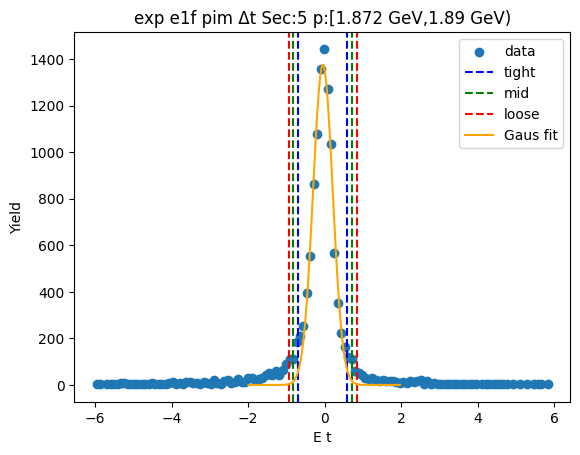

-0.6835347379246653 0.6059863428057625
-0.812486845997708 0.7349384508788052
-0.9414389540707508 0.863890558951848


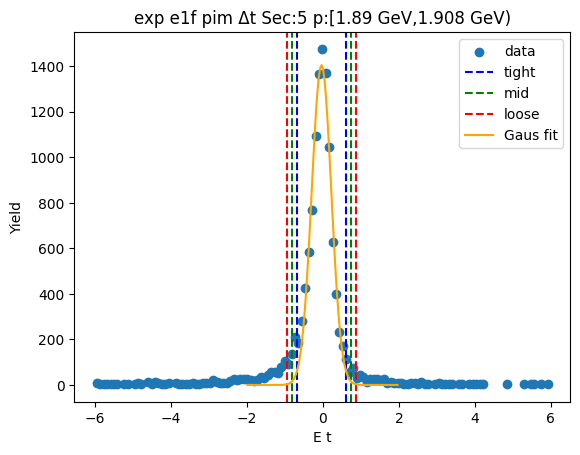

-0.710819726278516 0.6171178524814397
-0.8436134841545115 0.7499116103574353
-0.9764072420305071 0.8827053682334308


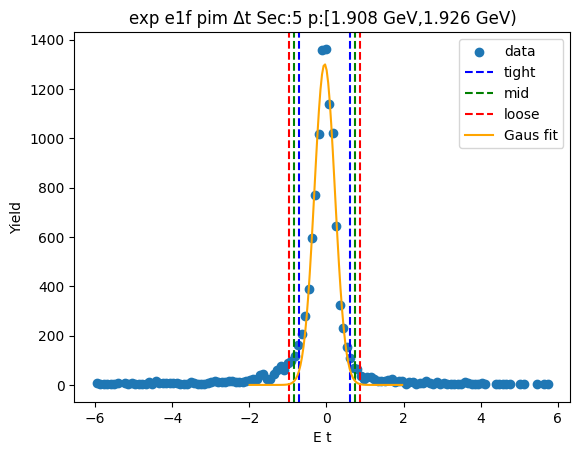

-0.6863577574127105 0.6067559143254976
-0.8156691245865313 0.7360672814993183
-0.944980491760352 0.8653786486731391


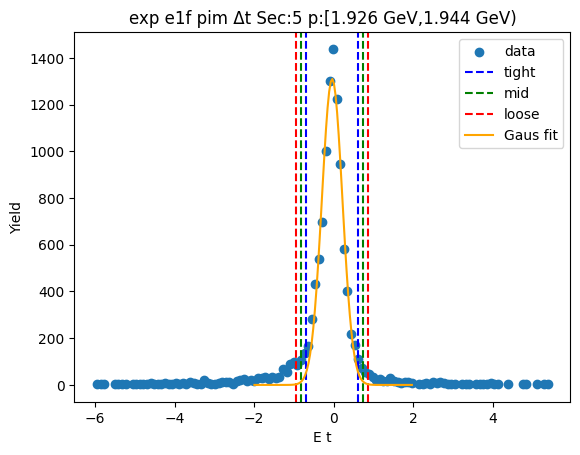

-0.6887264022911366 0.6154030662656054
-0.8191393491468109 0.7458160131212797
-0.949552296002485 0.8762289599769538


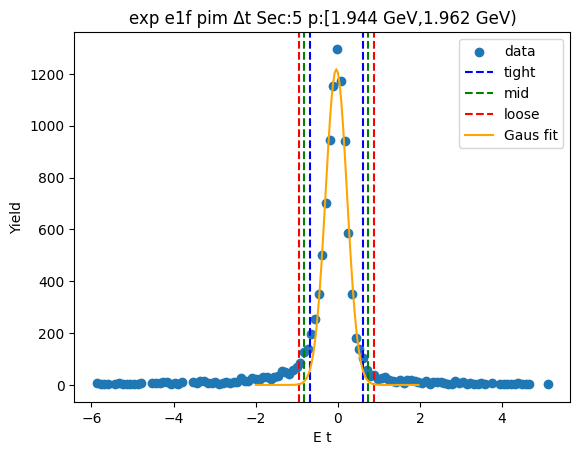

-0.648654070332286 0.5888155200129946
-0.772401029366814 0.7125624790475227
-0.896147988401342 0.8363094380820507


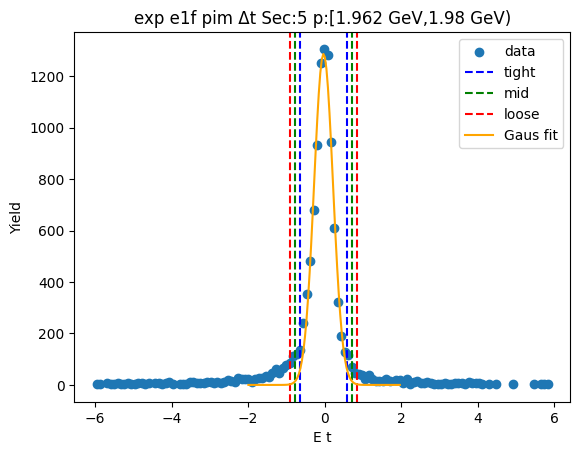

-0.6798338562651369 0.6037960213353226
-0.8081968440251829 0.7321590090953686
-0.9365598317852288 0.8605219968554145


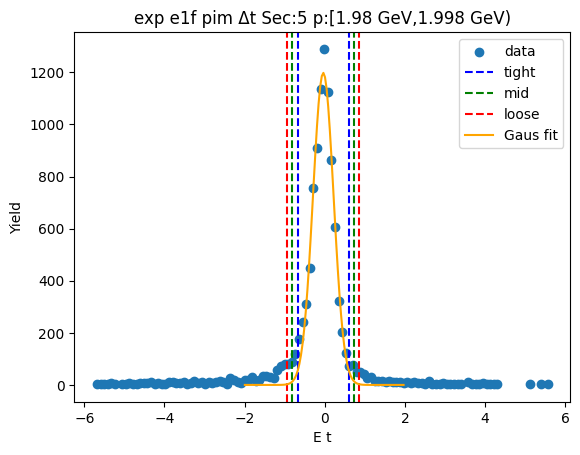

-0.6736757901817968 0.6072262608783173
-0.8017659952878081 0.7353164659843286
-0.9298562003938196 0.8634066710903401


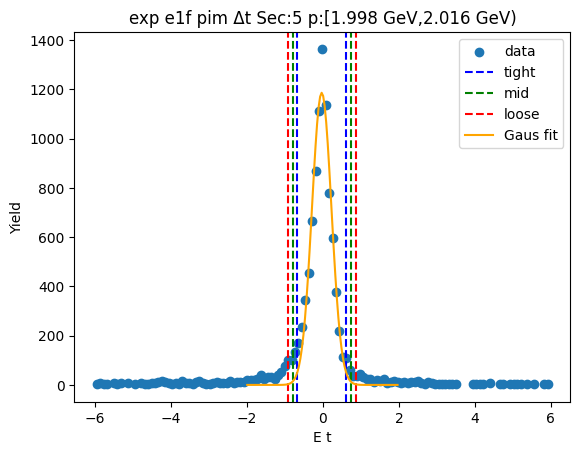

-0.6672556329271299 0.5898332920127264
-0.7929645254211154 0.7155421845067119
-0.918673417915101 0.8412510770006976


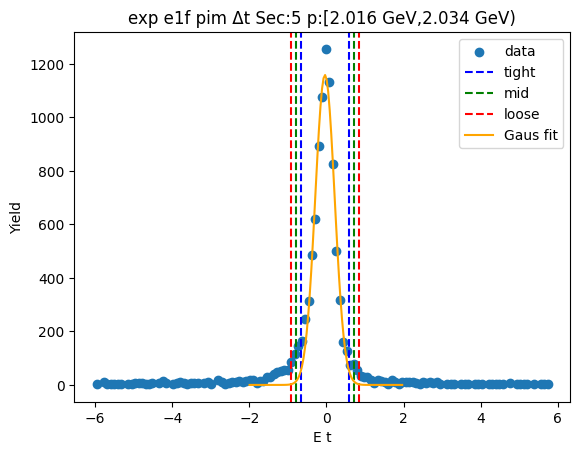

-0.6665859021373997 0.5871934454942085
-0.7919638369005604 0.7125713802573692
-0.9173417716637212 0.83794931502053


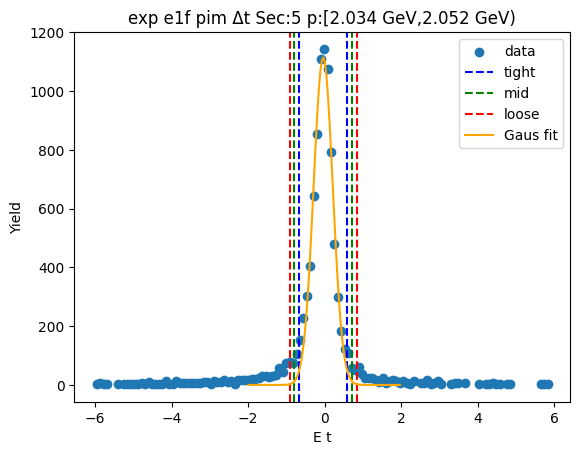

-0.685744892989642 0.6045188832675222
-0.8147712706153584 0.7335452608932386
-0.9437976482410748 0.862571638518955


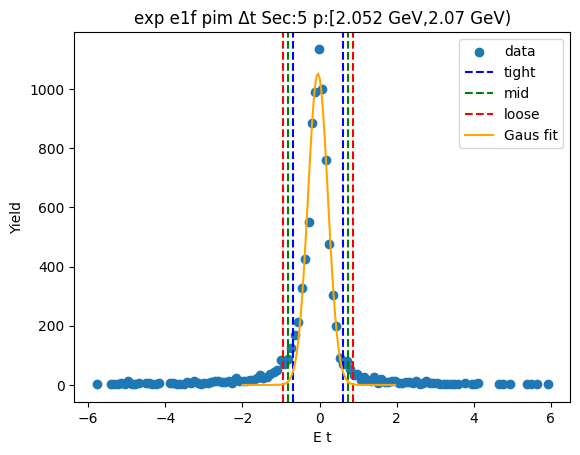

-0.6633233192392841 0.5881462303136623
-0.7884702741945788 0.713293185268957
-0.9136172291498735 0.8384401402242517


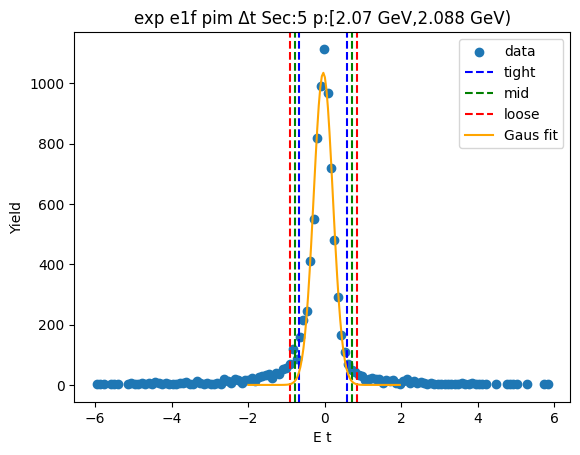

-0.7036593546662939 0.6187859302763532
-0.8359038831605587 0.7510304587706178
-0.9681484116548233 0.8832749872648826


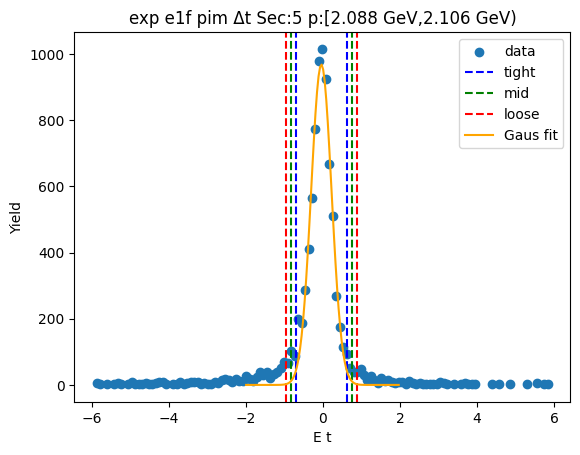

-0.6591626517999435 0.6006947211870896
-0.7851483890986467 0.7266804584857928
-0.91113412639735 0.8526661957844961


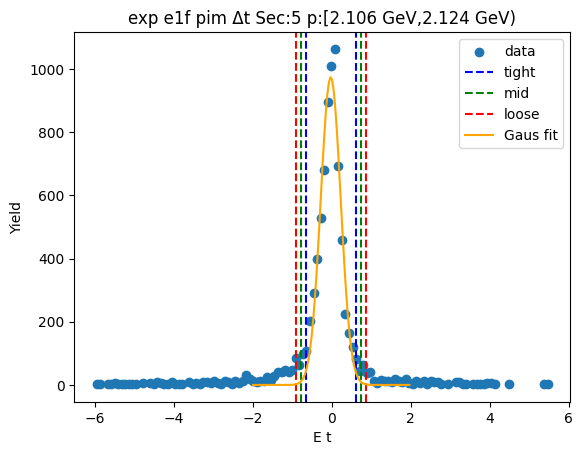

-0.6634948180666839 0.5785081707580205
-0.7876951169491543 0.7027084696404909
-0.9118954158316247 0.8269087685229614


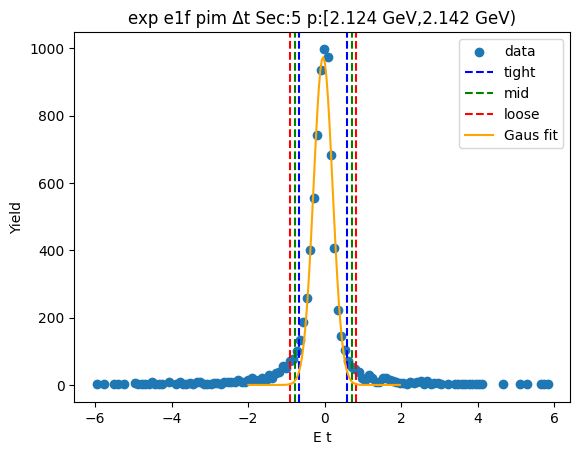

-0.6793397191920786 0.6070214540215616
-0.8079758365134425 0.7356575713429255
-0.9366119538348066 0.8642936886642896


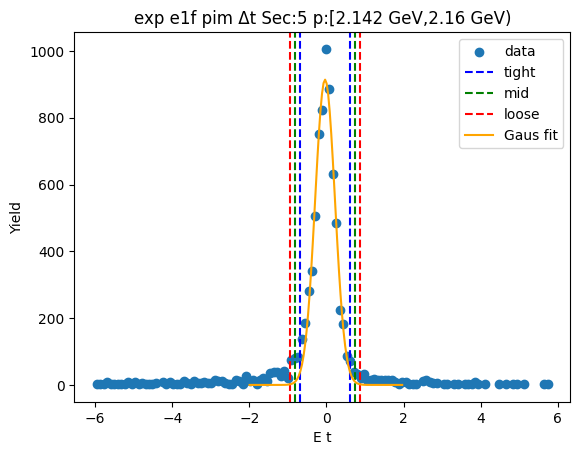

-0.6501467388983321 0.5717282251672579
-0.7723342353048911 0.6939157215738169
-0.8945217317114501 0.8161032179803759


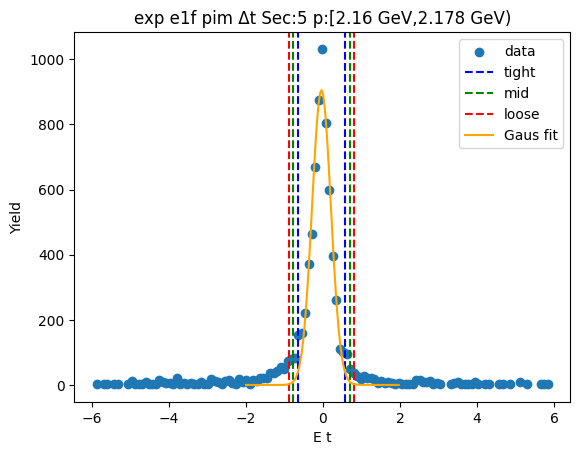

-0.6378516694318745 0.5754322462288457
-0.7591800609979465 0.6967606377949177
-0.8805084525640186 0.8180890293609897


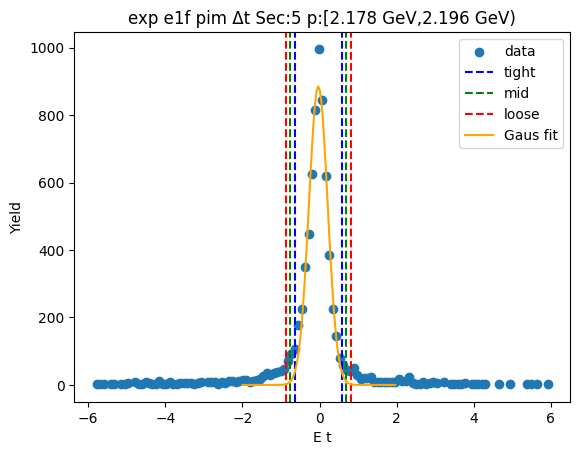

-0.6597058817651535 0.5947060602293488
-0.7851470759646039 0.7201472544287991
-0.9105882701640541 0.8455884486282493


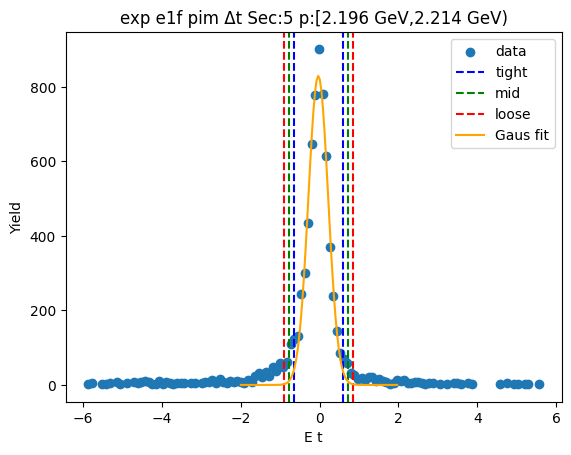

-0.7137476509683067 0.6217604356011168
-0.8472984596252491 0.7553112442580592
-0.9808492682821914 0.8888620529150015


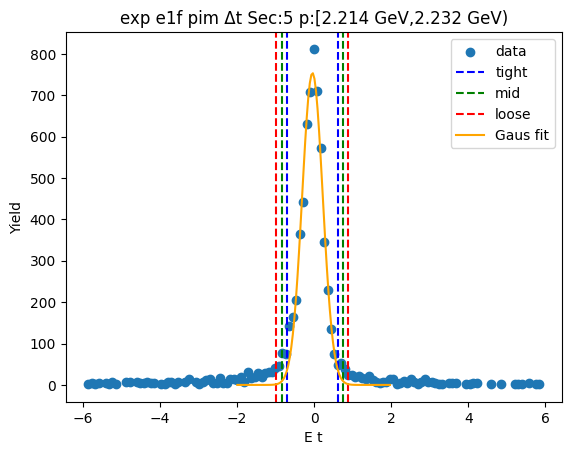

-0.6704284024835097 0.6074698327325152
-0.798218226005112 0.7352596562541176
-0.9260080495267146 0.8630494797757201


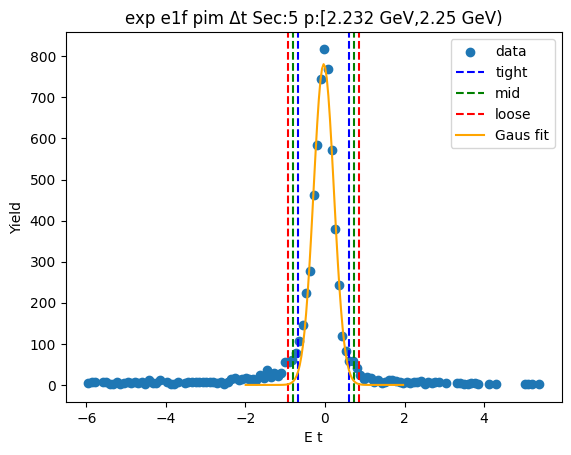

-0.6757259287410714 0.6141053214317364
-0.8047090537583521 0.7430884464490171
-0.9336921787756328 0.8720715714662978


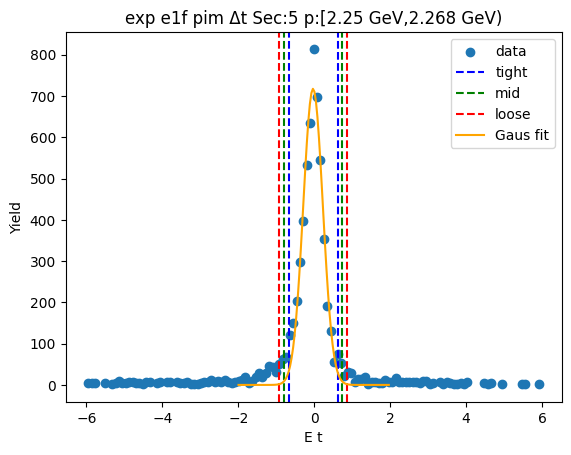

-0.6792656330925666 0.6163373243376955
-0.8088259288355929 0.7458976200807218
-0.9383862245786191 0.875457915823748


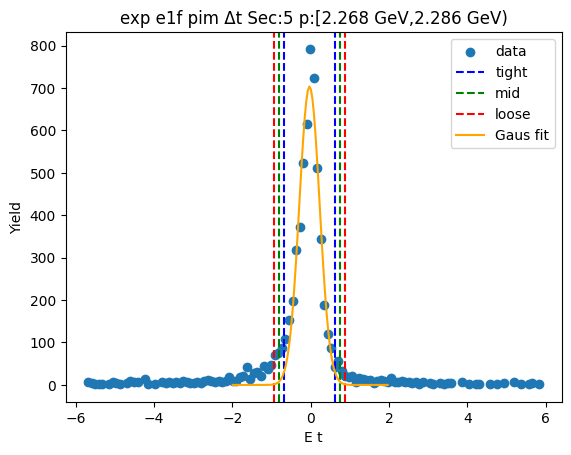

-0.6454059663193914 0.5777240770220753
-0.7677189706535381 0.700037081356222
-0.8900319749876847 0.8223500856903686


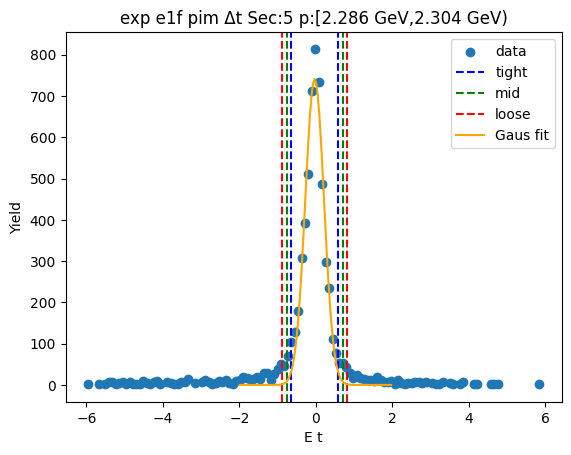

-0.6869825846420498 0.618870399244671
-0.8175678830307219 0.7494556976333432
-0.948153181419394 0.8800409960220152


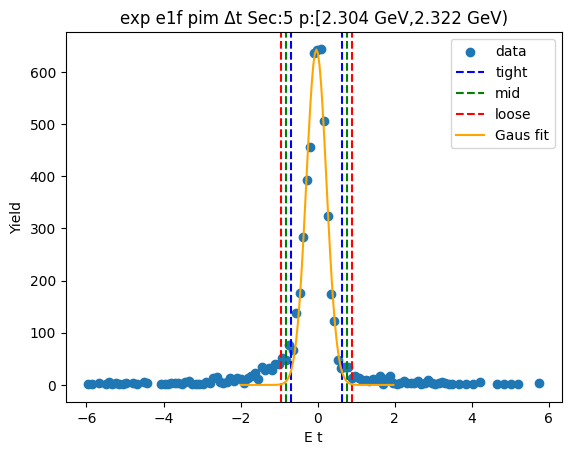

-0.655096679849315 0.5979066040703809
-0.7803970082412846 0.7232069324623505
-0.9056973366332541 0.84850726085432


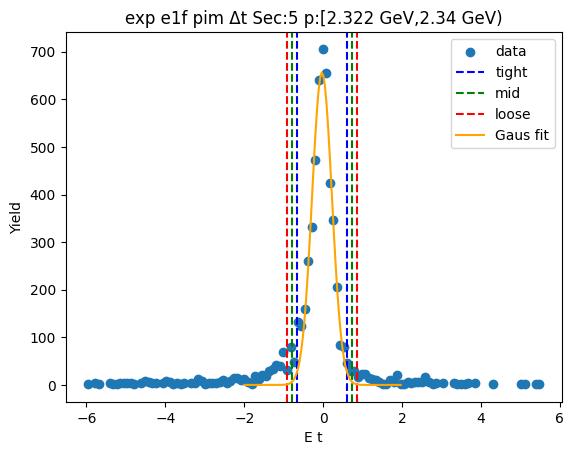

-0.6860608309258991 0.6280985815388003
-0.817476772172369 0.7595145227852702
-0.948892713418839 0.8909304640317401


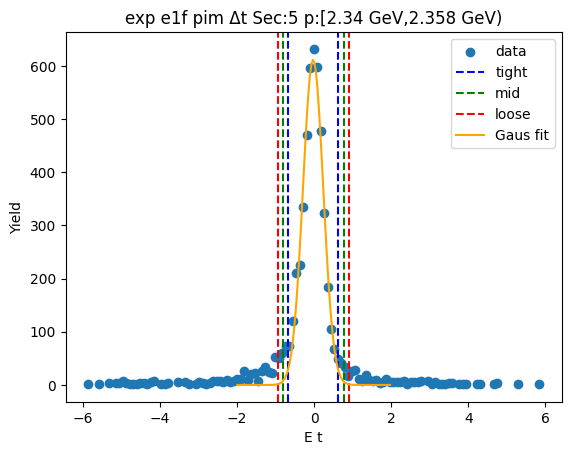

-0.6528991430046357 0.6044902328762162
-0.7786380805927209 0.7302291704643014
-0.9043770181808061 0.8559681080523865


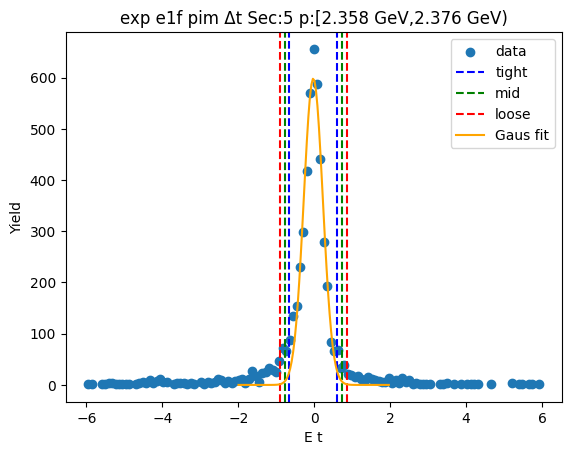

-0.6779722891532678 0.6190236563563023
-0.8076718837042247 0.7487232509072592
-0.9373714782551817 0.8784228454582163


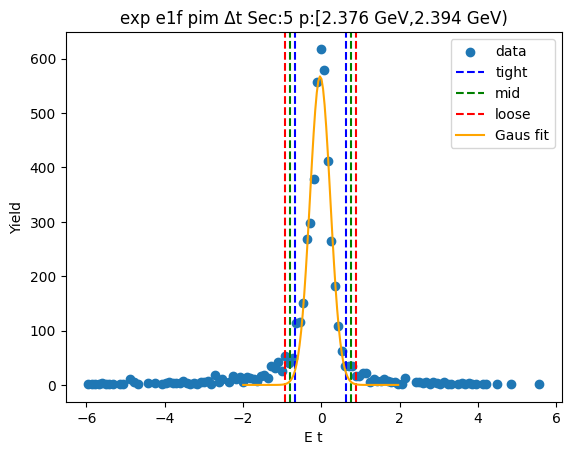

-0.8361370156699949 0.7572395790587946
-0.9954746751428739 0.9165772385316736
-1.1548123346157526 1.0759148980045525


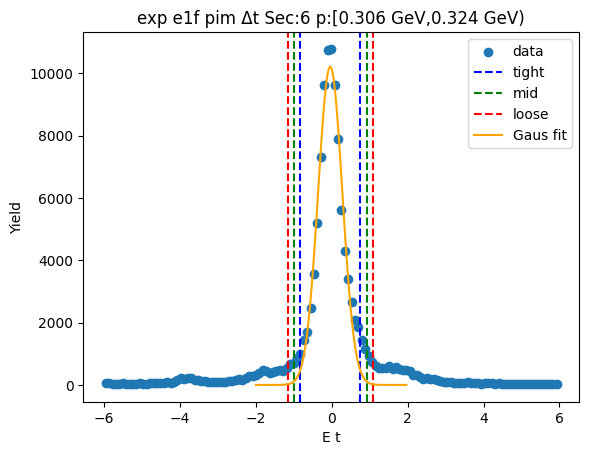

-0.8161008985857877 0.7462961095288038
-0.9723405993972469 0.902535810340263
-1.1285803002087063 1.058775511151722


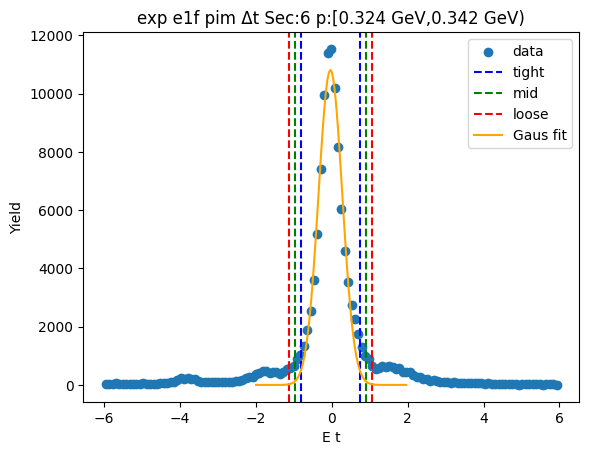

-0.7968454761857622 0.7271978873620513
-0.9492498125405435 0.8796022237168326
-1.1016541488953249 1.032006560071614


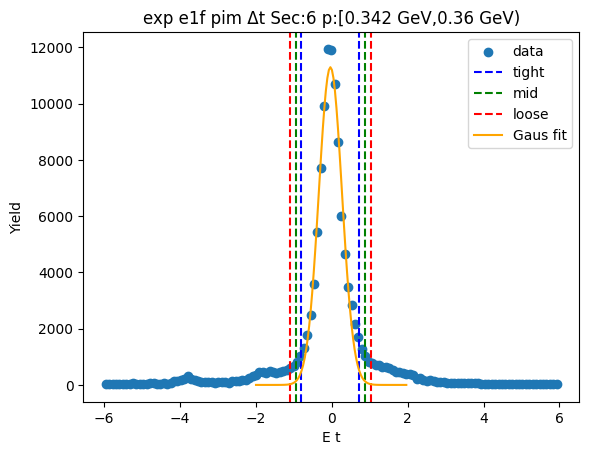

-0.7651212712997119 0.7107429938078084
-0.9127076978104638 0.8583294203185603
-1.0602941243212158 1.0059158468293123


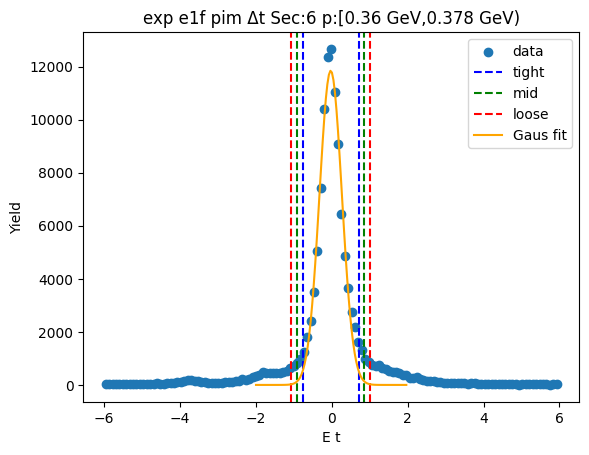

-0.7548829865723726 0.7173511716589619
-0.902106402395506 0.8645745874820953
-1.0493298182186397 1.0117980033052287


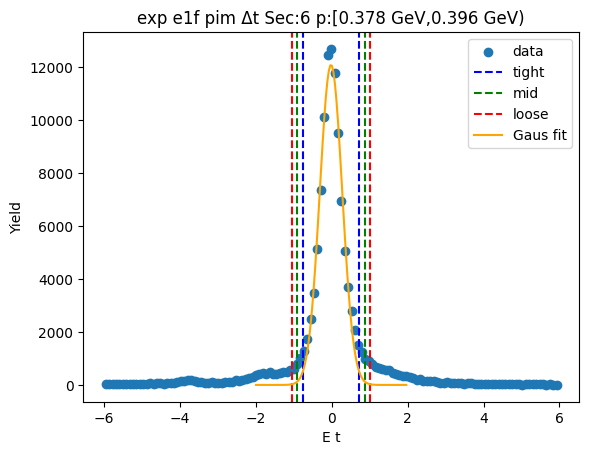

-0.7505833697731393 0.7171210629284873
-0.8973538130433021 0.8638915061986501
-1.0441242563134647 1.0106619494688127


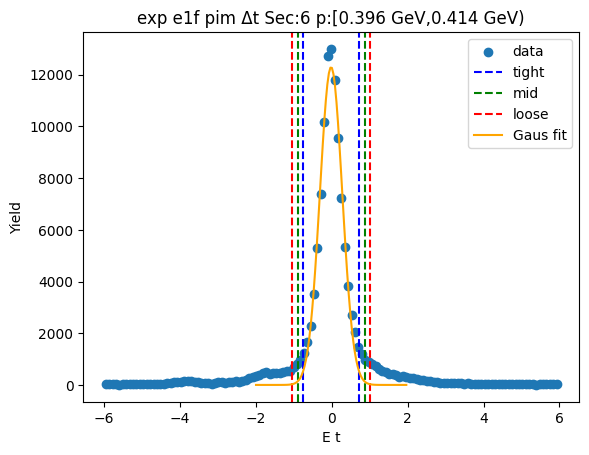

-0.7279828839739855 0.7028532287953433
-0.8710664952509184 0.845936840072276
-1.014150106527851 0.9890204513492089


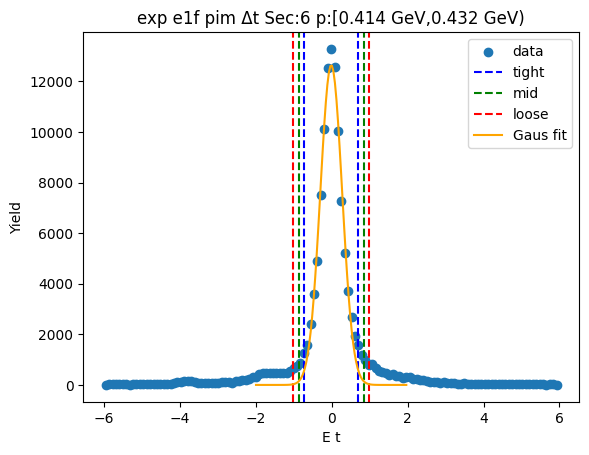

-0.7167487522301736 0.6936288318522741
-0.8577865106384185 0.8346665902605189
-0.9988242690466633 0.9757043486687638


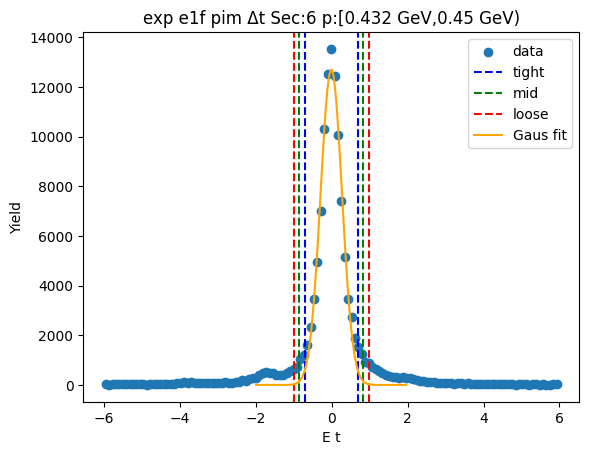

-0.7007941758762507 0.6851112994410863
-0.8393847234079843 0.8237018469728199
-0.977975270939718 0.9622923945045536


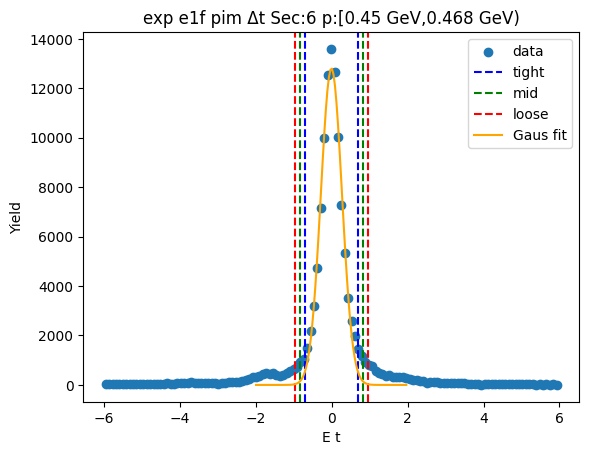

-0.6897465137782516 0.6759322202083017
-0.826314387176907 0.8125000936069571
-0.9628822605755624 0.9490679670056125


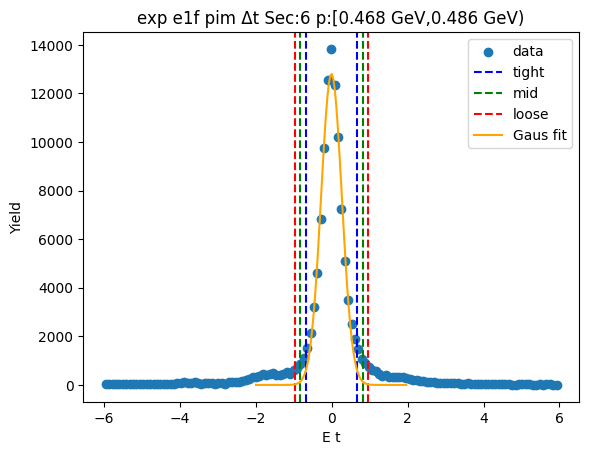

-0.6905944616454054 0.6790790103873954
-0.8275618088486855 0.8160463575906755
-0.9645291560519655 0.9530137047939555


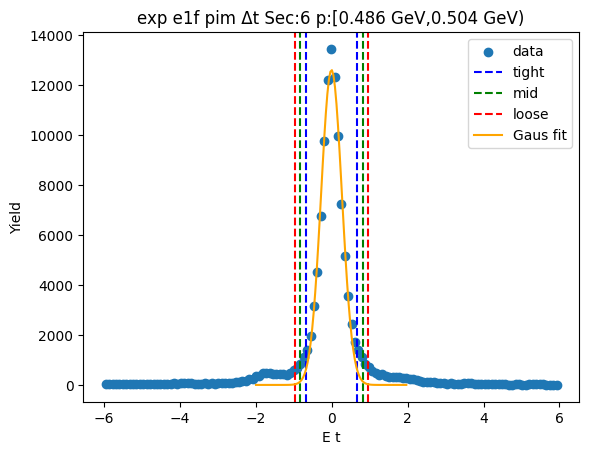

-0.6819824873812861 0.6765734939934702
-0.8178380855187618 0.8124290921309459
-0.9536936836562374 0.9482846902684215


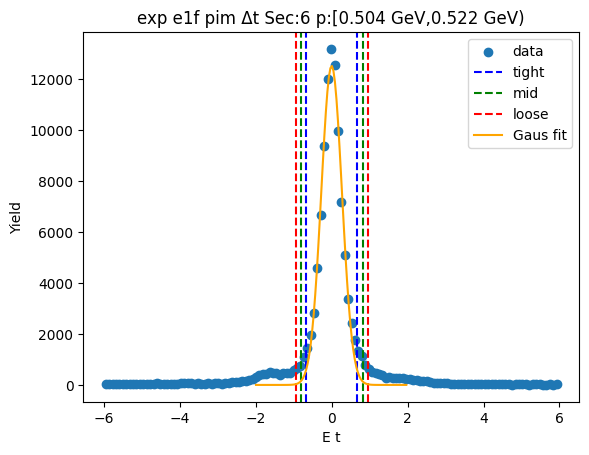

-0.6840017663372413 0.6848073018336052
-0.820882673154326 0.8216882086506898
-0.9577635799714106 0.9585691154677745


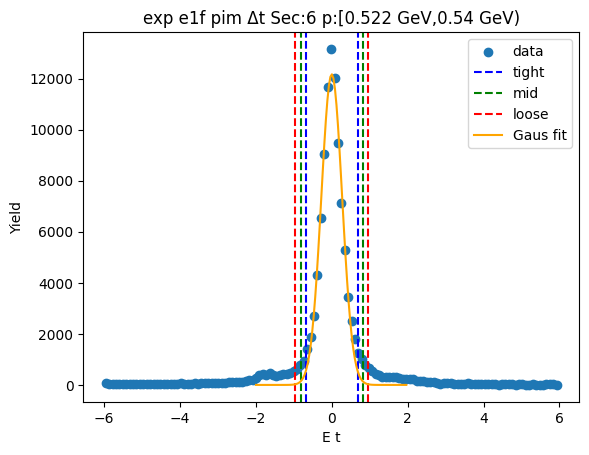

-0.6728811558600045 0.6736544495445642
-0.8075347164004615 0.8083080100850212
-0.9421882769409183 0.942961570625478


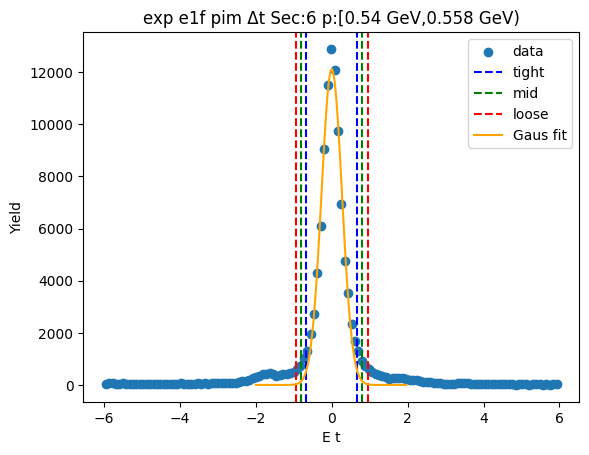

-0.6610766581931015 0.6682934198685754
-0.7940136659992691 0.8012304276747431
-0.9269506738054368 0.9341674354809107


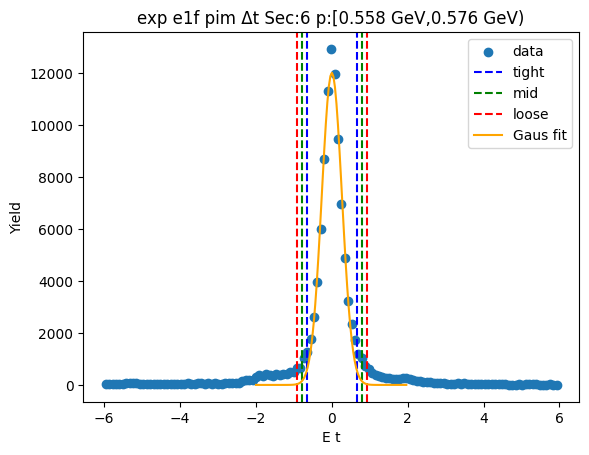

-0.6675613817497341 0.6676999582565966
-0.8010875157503672 0.8012260922572296
-0.9346136497510003 0.9347522262578627


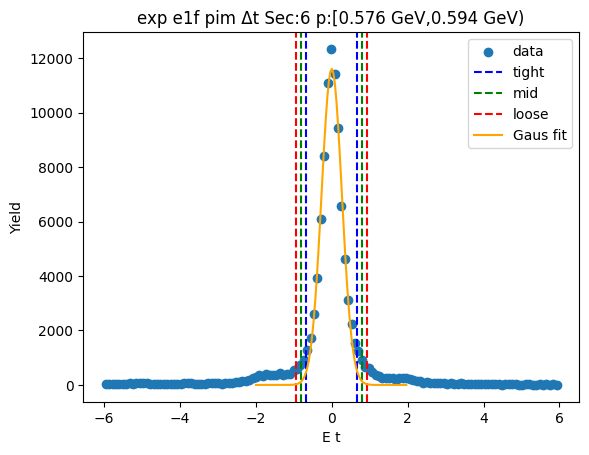

-0.6575794694892887 0.6640960541570486
-0.7897470218539224 0.7962636065216824
-0.9219145742185562 0.9284311588863161


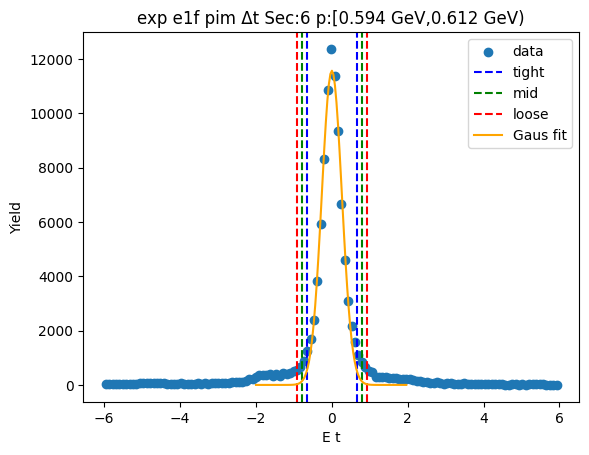

-0.6567788237802253 0.6665536156133055
-0.7891120677195784 0.7988868595526586
-0.9214453116589315 0.9312201034920117


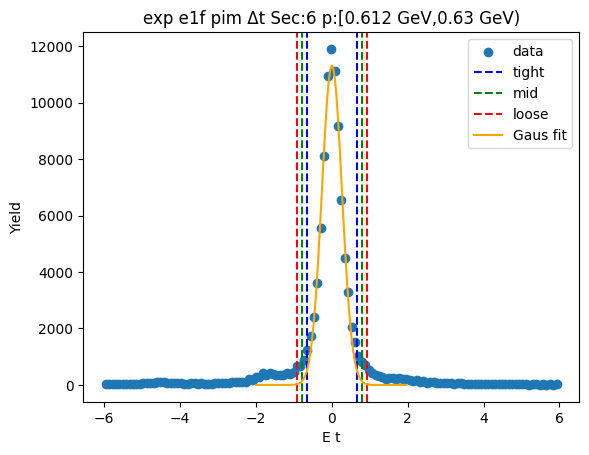

-0.6441462163185762 0.6517004312544822
-0.7737308810758821 0.7812850960117881
-0.903315545833188 0.910869760769094


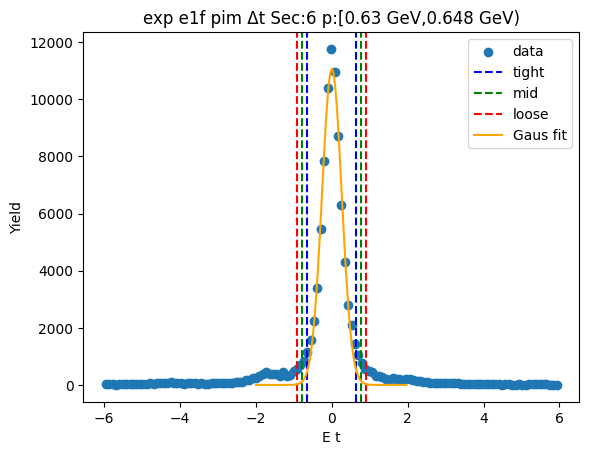

-0.6570704537824253 0.6721236032309675
-0.7899898594837645 0.8050430089323067
-0.9229092651851039 0.937962414633646


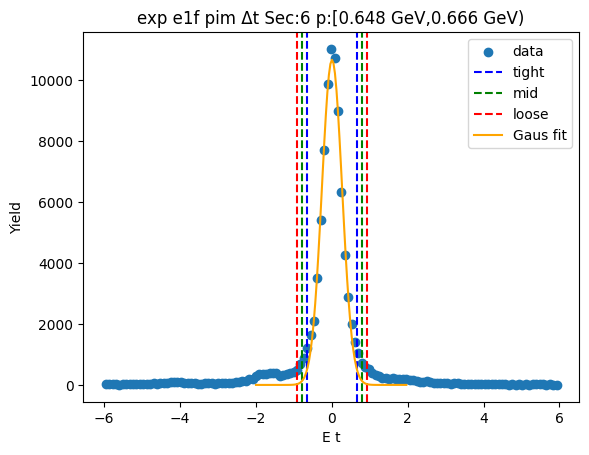

-0.6472649238310861 0.6594766107429533
-0.77793907728849 0.7901507642003571
-0.908613230745894 0.9208249176577611


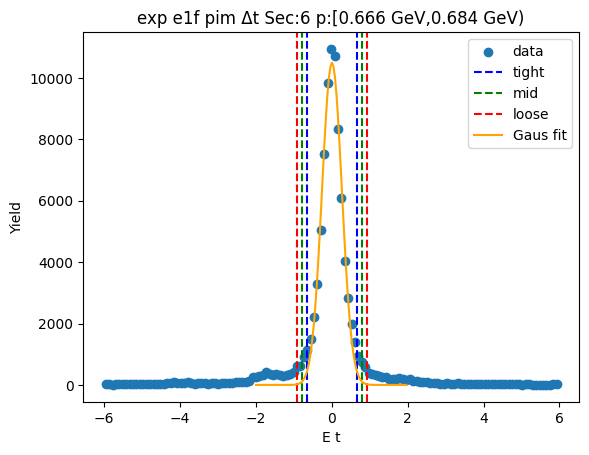

-0.6394193605430838 0.652384724579077
-0.7685997690552998 0.781565133091293
-0.8977801775675158 0.9107455416035091


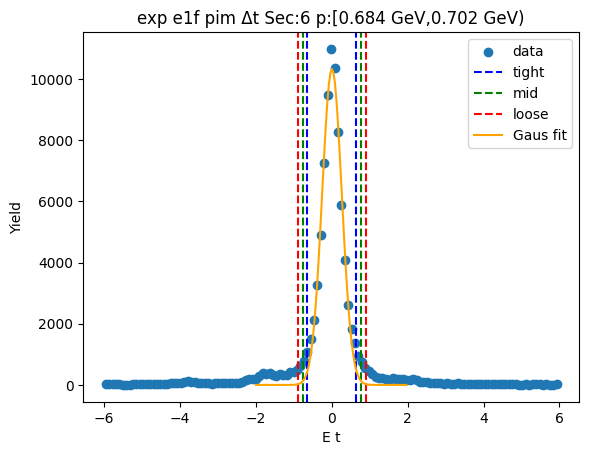

-0.6481385653417104 0.6624458620907647
-0.779197008084958 0.7935043048340122
-0.9102554508282055 0.9245627475772598


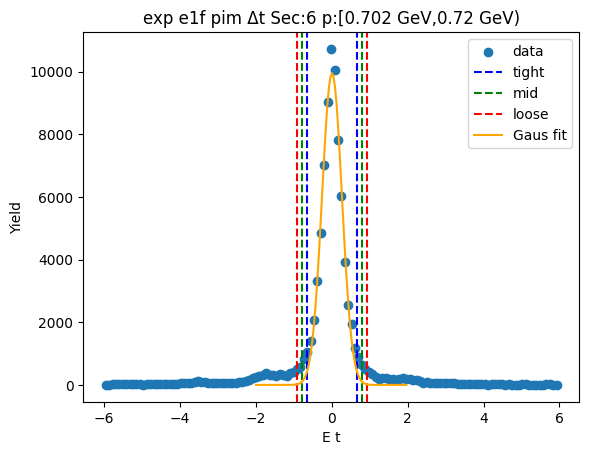

-0.6377614182795434 0.6536598685184934
-0.766903546959347 0.7828019971982971
-0.8960456756391507 0.9119441258781008


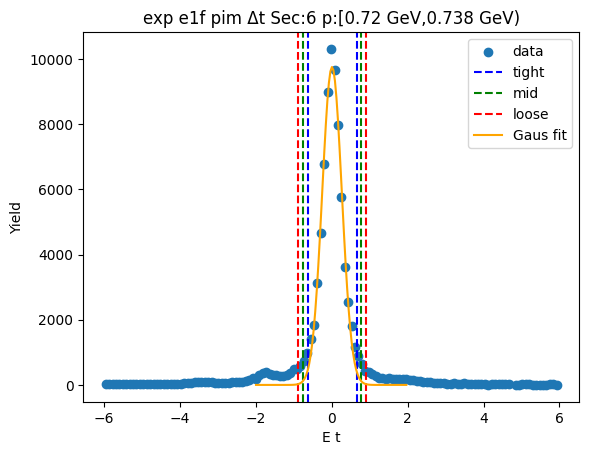

-0.6347186502369264 0.6512356294158403
-0.7633140782022031 0.779831057381117
-0.8919095061674798 0.9084264853463937


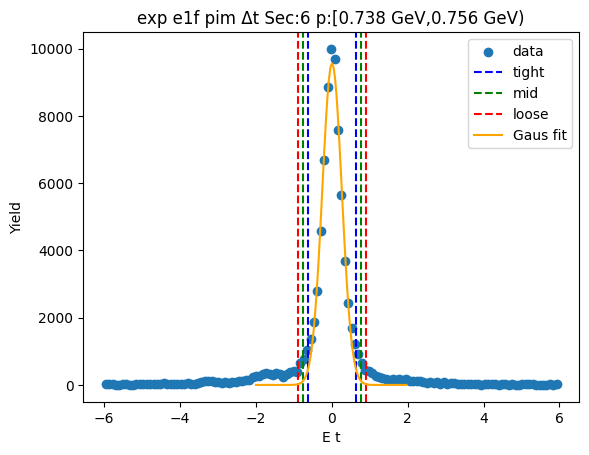

-0.6328047220266242 0.648892343729554
-0.7609744286022421 0.7770620503051718
-0.88914413517786 0.9052317568807897


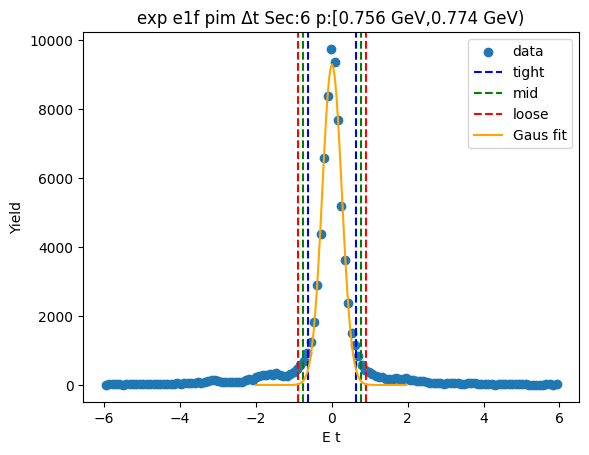

-0.6350260345727081 0.6486069648864072
-0.7633893345186196 0.7769702648323187
-0.8917526344645311 0.9053335647782302


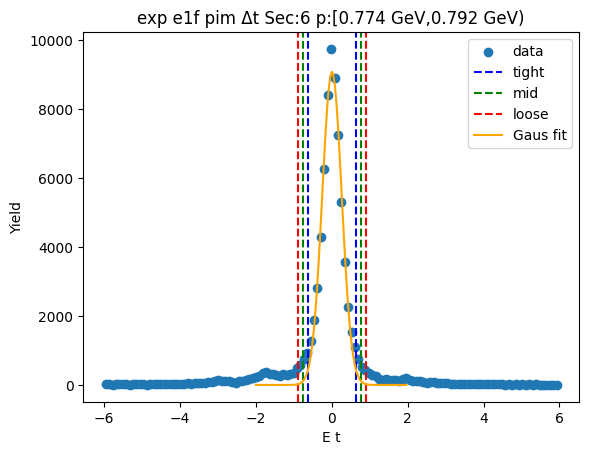

-0.6328025527992323 0.6466666455523307
-0.7607494726343886 0.774613565387487
-0.8886963924695449 0.9025604852226433


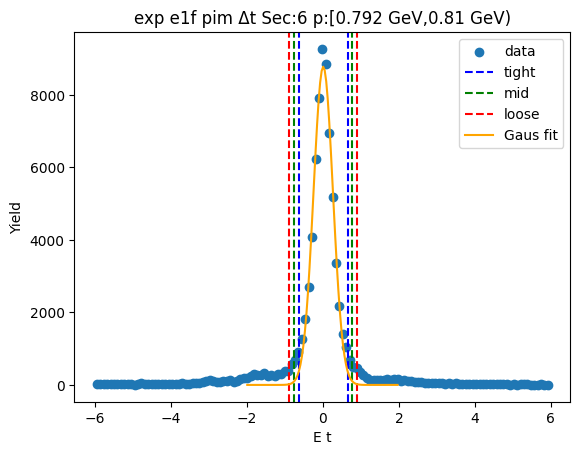

-0.6257435581599202 0.6530353788685137
-0.7536214518627635 0.780913272571357
-0.8814993455656069 0.9087911662742004


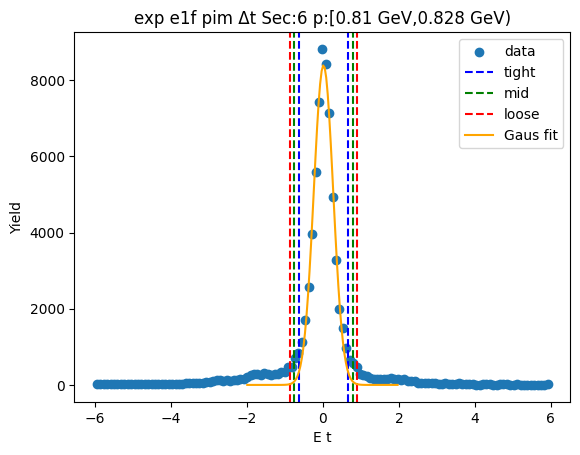

-0.6284919480344824 0.6474397049231175
-0.7560851133302423 0.7750328702188775
-0.8836782786260022 0.9026260355146374


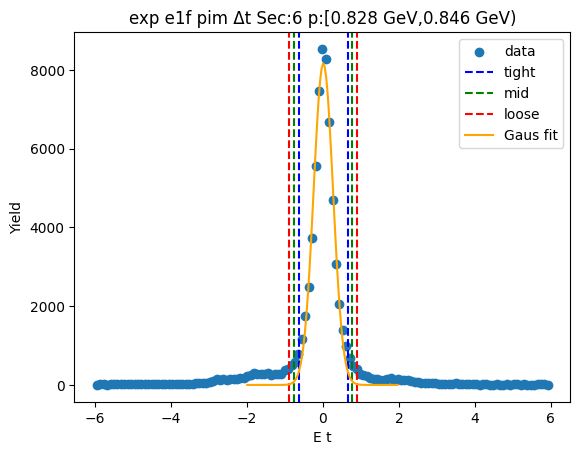

-0.6364806803181174 0.6585010396571082
-0.76597885231564 0.7879992116546307
-0.8954770243131626 0.9174973836521533


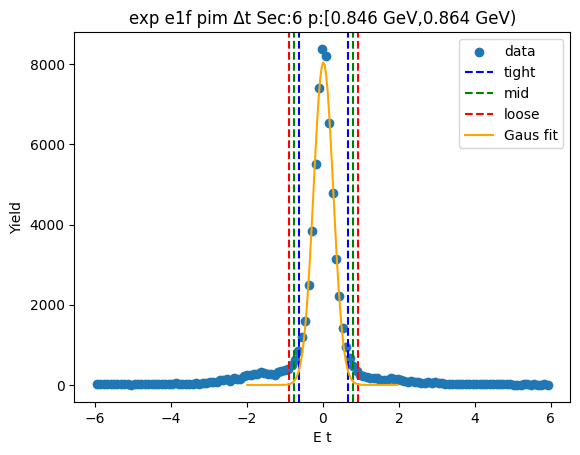

-0.6243962210971806 0.6417892793534458
-0.7510147711422434 0.7684078293985085
-0.877633321187306 0.8950263794435711


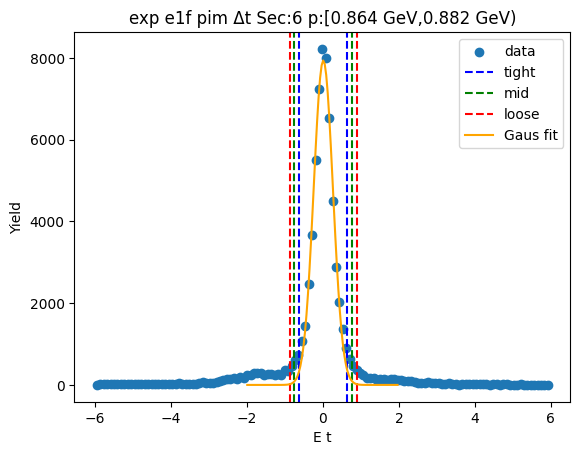

-0.616848083163722 0.6420407245409971
-0.742736963934194 0.7679296053114691
-0.8686258447046659 0.893818486081941


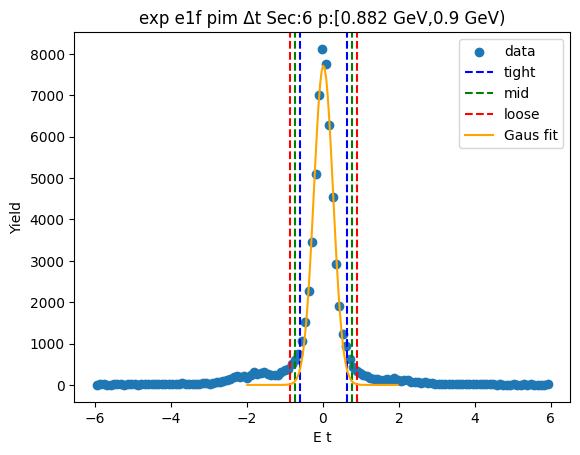

-0.6234608827196118 0.6472348576613611
-0.7505304567577091 0.7743044316994585
-0.8776000307958064 0.9013740057375558


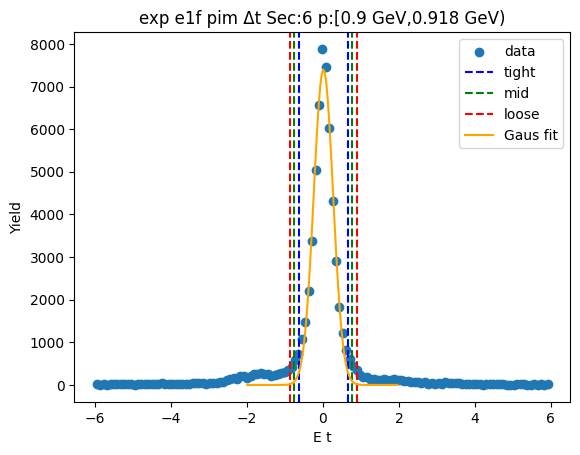

-0.6228606296487161 0.6414355379096083
-0.7492902464045487 0.7678651546654408
-0.8757198631603811 0.8942947714212732


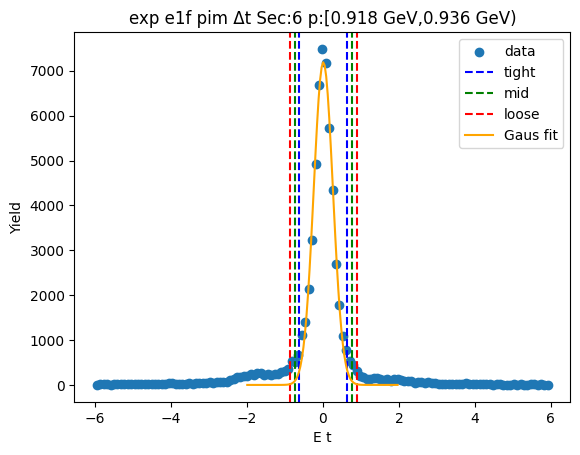

-0.6158400582044854 0.6360134807187756
-0.7410254120968115 0.7611988346111017
-0.8662107659891376 0.8863841885034278


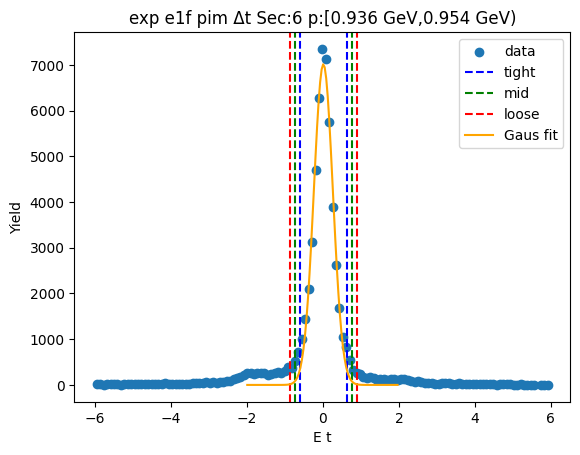

-0.6028856965809092 0.629091129820548
-0.7260833792210548 0.7522888124606937
-0.8492810618612006 0.8754864951008394


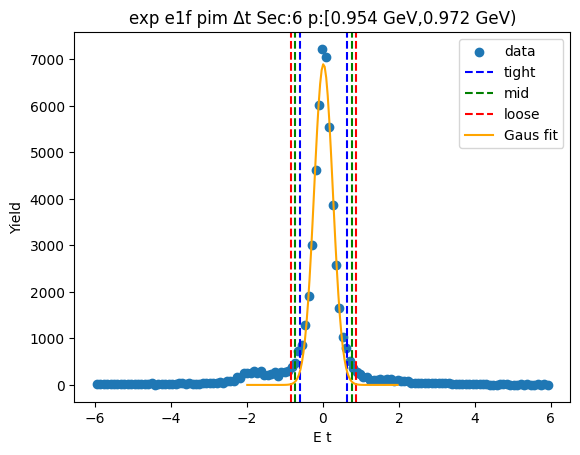

-0.6134035572585776 0.6402059884767912
-0.7387645118321144 0.765566943050328
-0.8641254664056514 0.8909278976238649


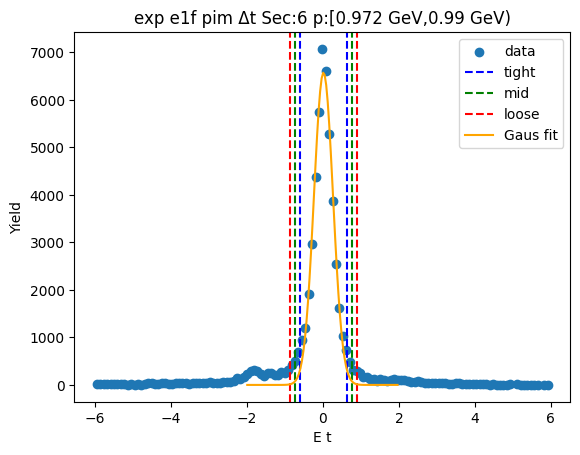

-0.6181525616573014 0.6375356248541462
-0.743721380308446 0.7631044435052908
-0.8692901989595908 0.8886732621564356


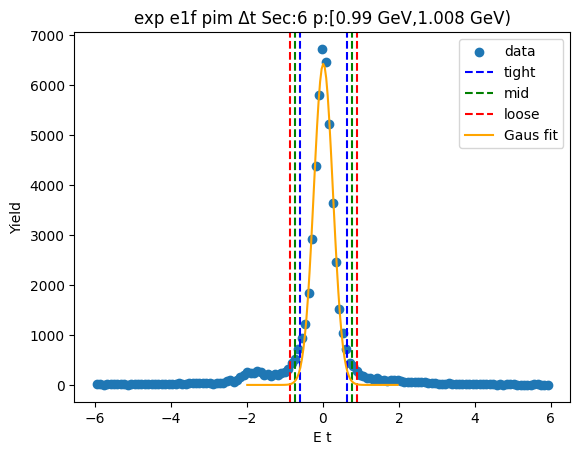

-0.6073431665373286 0.6384545825543828
-0.7319229414464996 0.7630343574635539
-0.8565027163556708 0.887614132372725


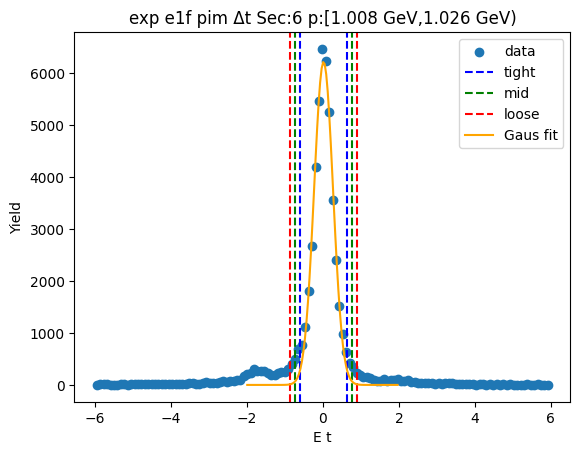

-0.6151301974084141 0.6497729569152285
-0.7416205128407785 0.7762632723475928
-0.8681108282731428 0.9027535877799572


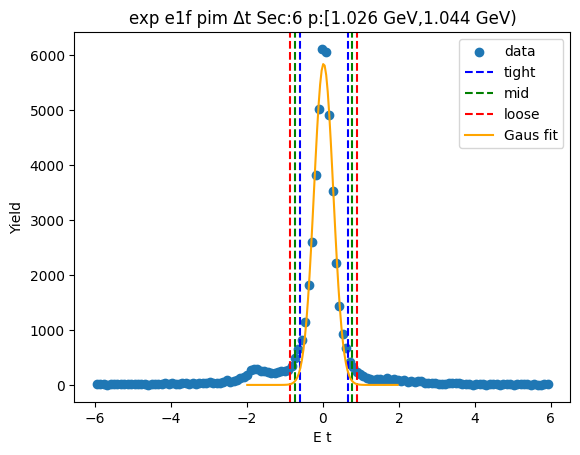

-0.5951555413288988 0.6272654007214099
-0.7173976355339297 0.7495074949264408
-0.8396397297389605 0.8717495891314716


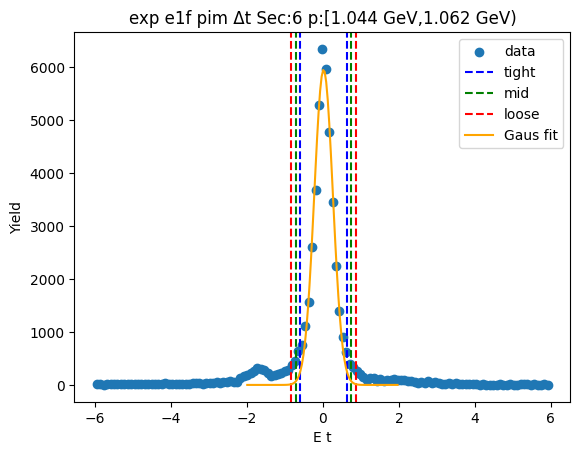

-0.6029194071733884 0.6353491732740685
-0.7267462652181341 0.7591760313188142
-0.8505731232628798 0.8830028893635599


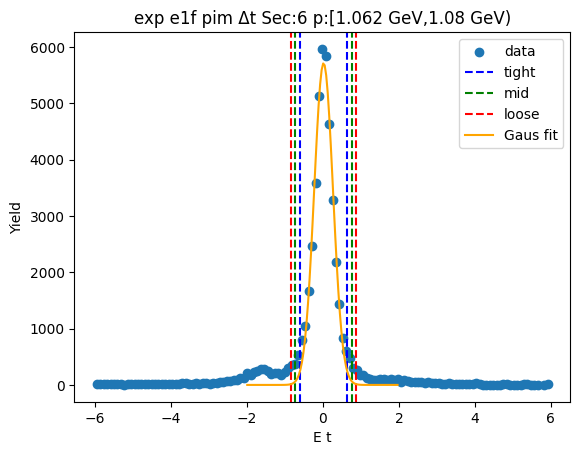

-0.6107824816410606 0.6437062687728062
-0.7362313566824473 0.7691551438141929
-0.861680231723834 0.8946040188555796


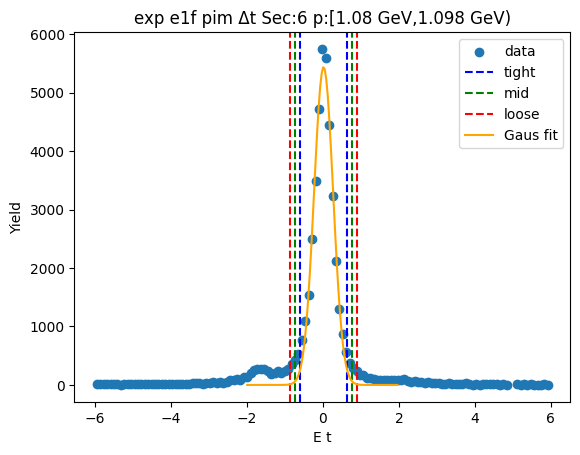

-0.5998995165073062 0.6324722301605872
-0.7231366911740956 0.7557094048273766
-0.846373865840885 0.878946579494166


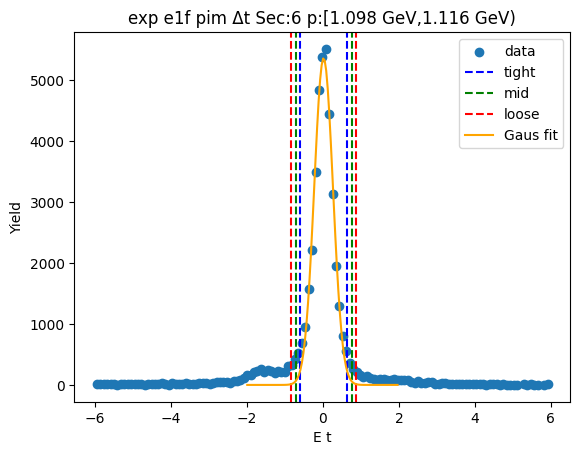

-0.5949727098430272 0.6272978001182471
-0.7171997608391546 0.7495248511143745
-0.839426811835282 0.8717519021105019


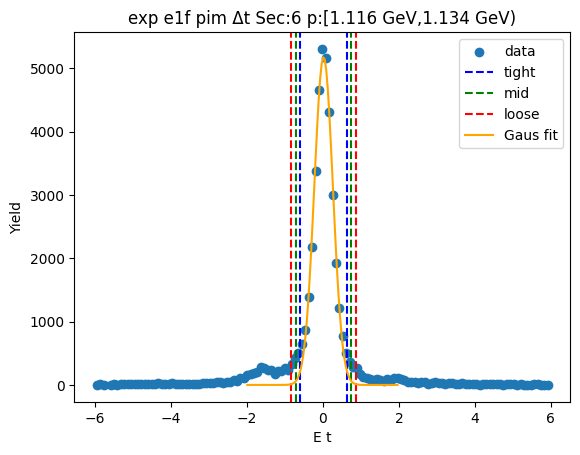

-0.5875272541472454 0.6228367408369504
-0.708563653645665 0.74387314033537
-0.8296000531440846 0.8649095398337896


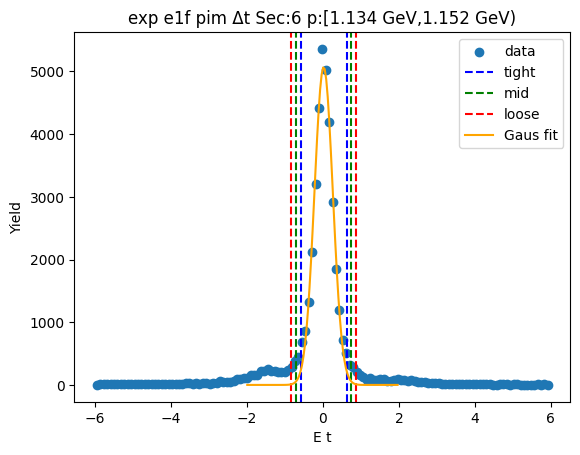

-0.6057777748481805 0.6441132361595374
-0.7307668759489524 0.7691023372603093
-0.8557559770497242 0.8940914383610811


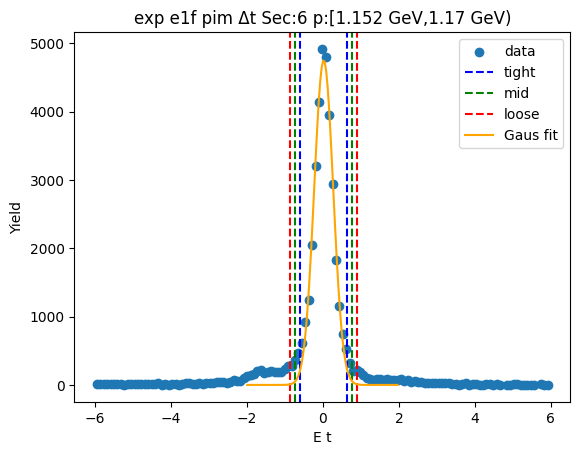

-0.5886393756689463 0.6241053017421725
-0.7099138434100581 0.7453797694832843
-0.8311883111511701 0.8666542372243963


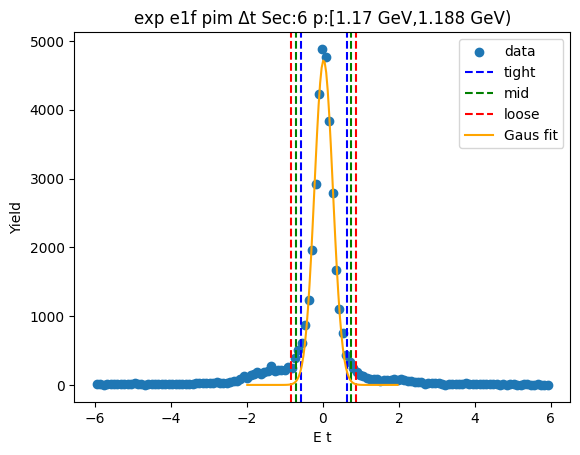

-0.5874435596556519 0.6274208624804282
-0.7089300018692599 0.7489073046940362
-0.8304164440828679 0.8703937469076442


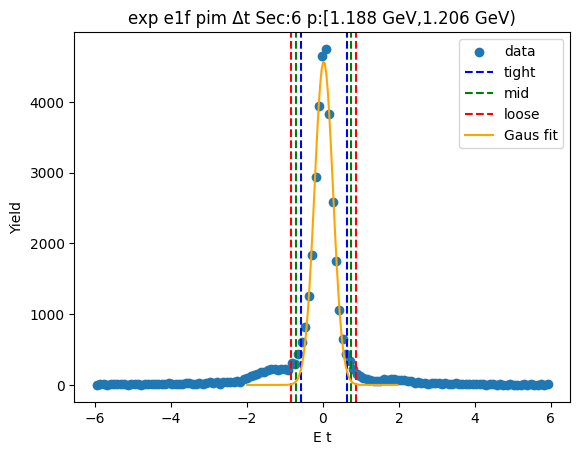

-0.5813167307740813 0.613217816558458
-0.7007701855073352 0.7326712712917118
-0.820223640240589 0.8521247260249657


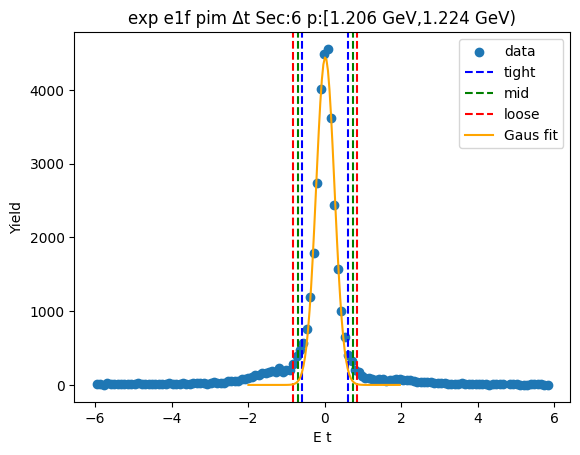

-0.5773907683107049 0.6128158344699743
-0.6964114285887728 0.7318364947480422
-0.8154320888668407 0.8508571550261101


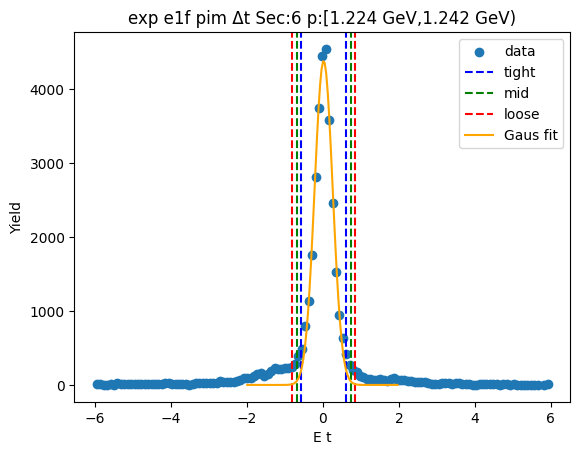

-0.5816863529103781 0.6255582394477291
-0.7024108121461888 0.7462826986835399
-0.8231352713819995 0.8670071579193506


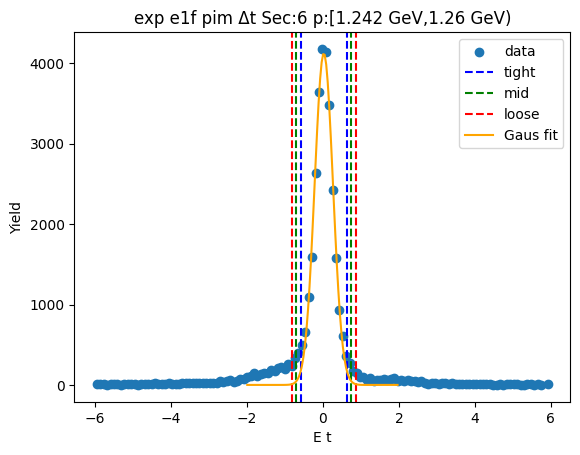

-0.5662301720976364 0.6118426238384047
-0.6840374516912405 0.7296499034320089
-0.8018447312848446 0.8474571830256129


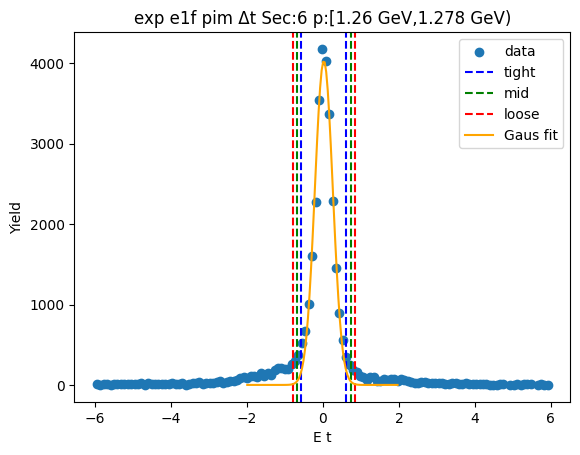

-0.5702862361605383 0.6201128461712402
-0.6893261443937161 0.739152754404418
-0.8083660526268939 0.8581926626375957


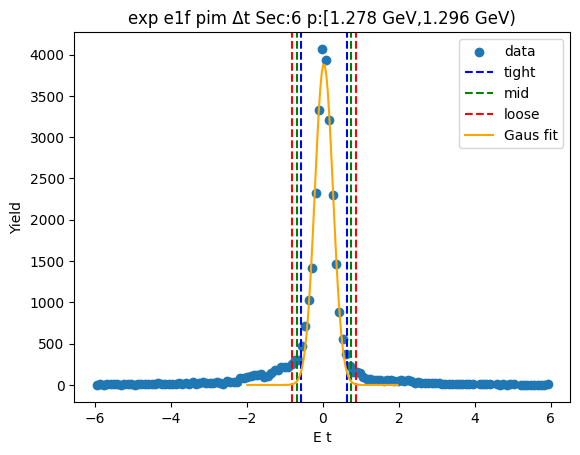

-0.5612070729419049 0.6005987497891804
-0.6773876552150134 0.7167793320622889
-0.7935682374881219 0.8329599143353974


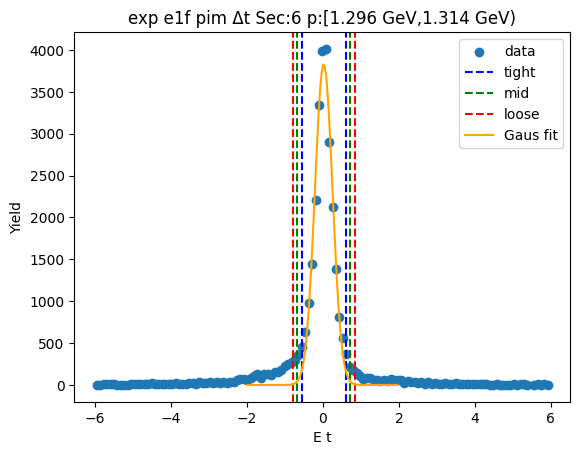

-0.5821685719689232 0.6261737539222975
-0.7030028045580453 0.7470079865114195
-0.8238370371471674 0.8678422191005416


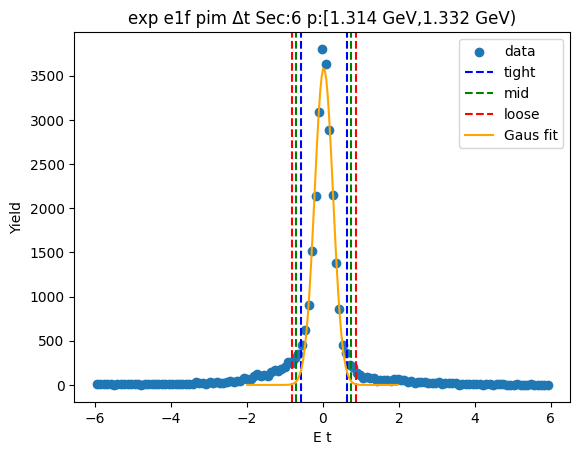

-0.5673913623381447 0.6059767313503254
-0.6847281717069917 0.7233135407191724
-0.8020649810758387 0.8406503500880194


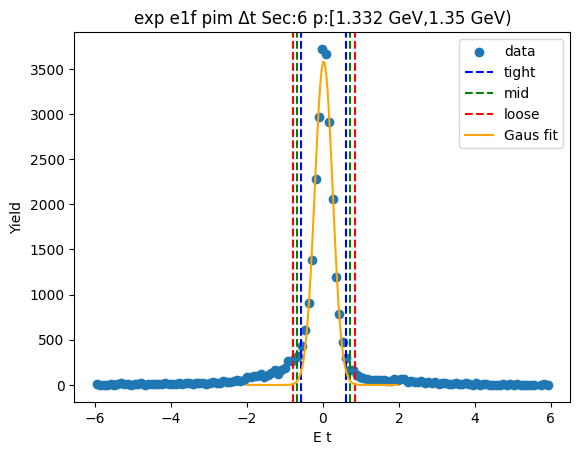

-0.5773646621450018 0.6149962498539584
-0.6966007533448979 0.7342323410538545
-0.815836844544794 0.8534684322537506


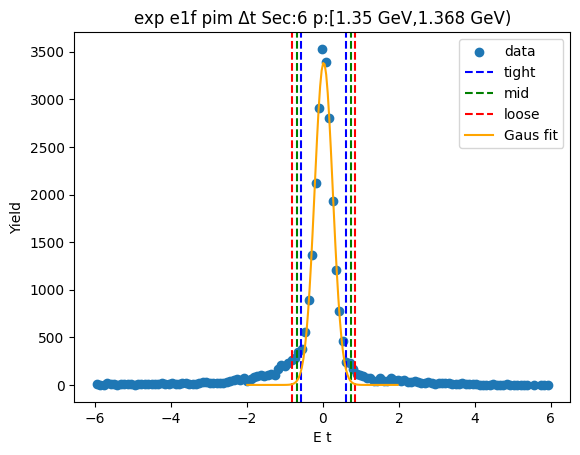

-0.5681181083883664 0.6226119150350697
-0.6871911107307099 0.7416849173774133
-0.8062641130730536 0.8607579197197569


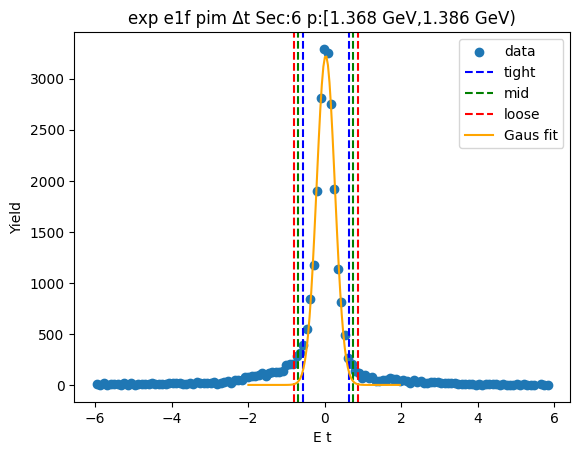

-0.5565317590621238 0.6020013227160191
-0.6723850672399381 0.7178546308938334
-0.7882383754177524 0.8337079390716478


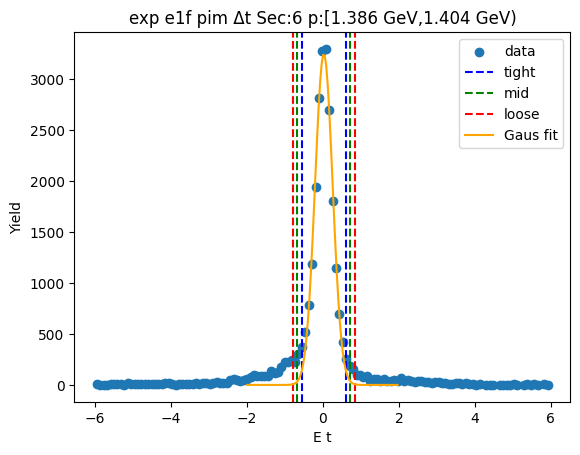

-0.5603714815960965 0.6101869332666021
-0.6774273230823663 0.7272427747528719
-0.7944831645686361 0.8442986162391417


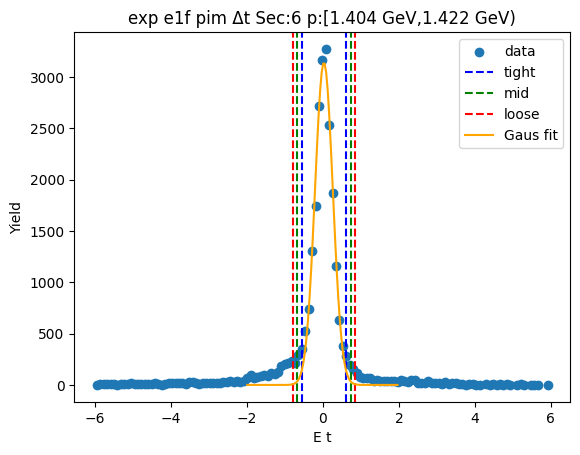

-0.576059992740187 0.6216893258530376
-0.6958349245995095 0.74146425771236
-0.815609856458832 0.8612391895716826


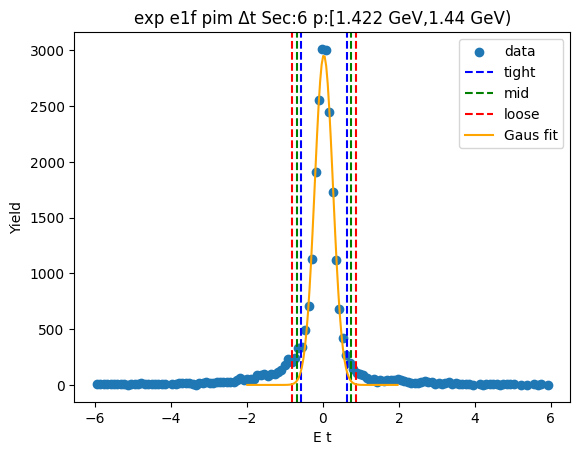

-0.557838778915507 0.6166851070522781
-0.6752911675122855 0.7341374956490565
-0.792743556109064 0.851589884245835


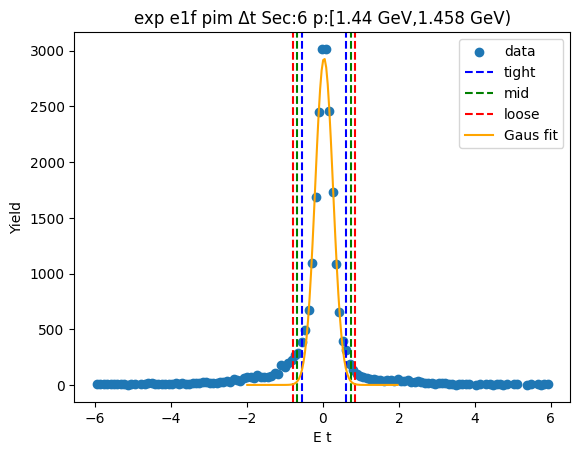

-0.5433637879173661 0.6087402693726465
-0.6585741936463673 0.7239506751016477
-0.7737845993753686 0.839161080830649


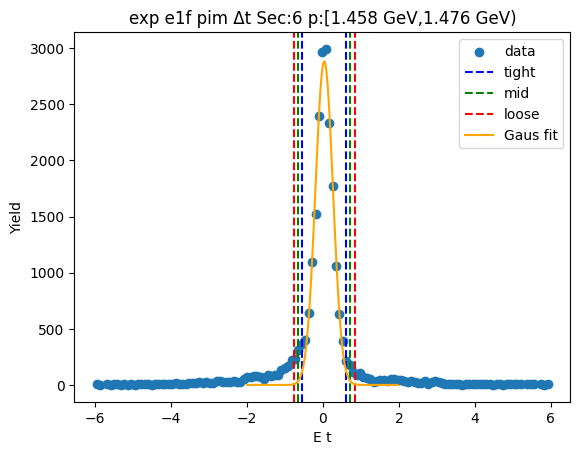

-0.54628443342166 0.6028742773487324
-0.6612003044986992 0.7177901484257716
-0.7761161755757384 0.8327060195028109


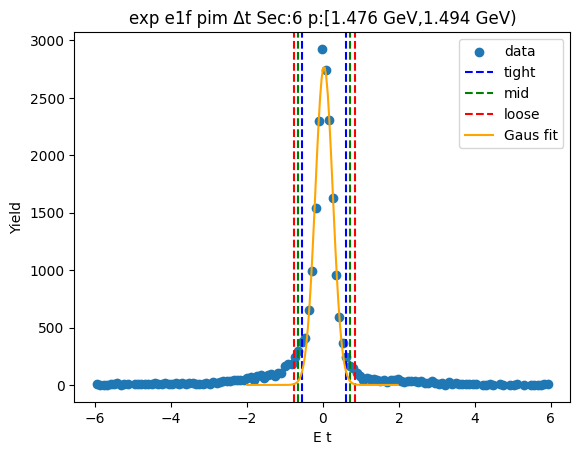

-0.5238851282479114 0.5959389070477509
-0.6358675317774777 0.7079213105773171
-0.7478499353070439 0.8199037141068833


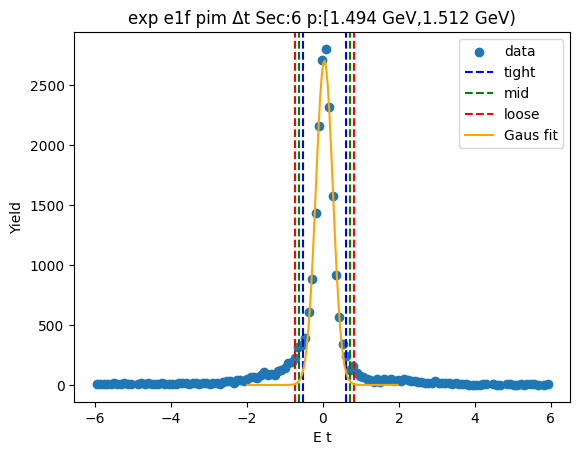

-0.555393292593613 0.6156813927476553
-0.6725007611277398 0.7327888612817821
-0.7896082296618667 0.849896329815909


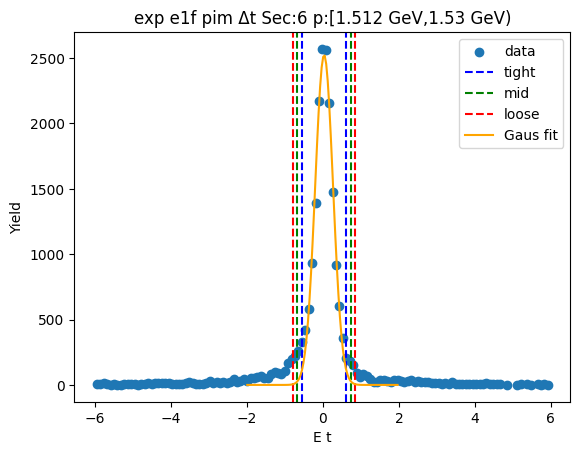

-0.5542497626239877 0.602077861108933
-0.6698825249972798 0.7177106234822251
-0.7855152873705719 0.8333433858555171


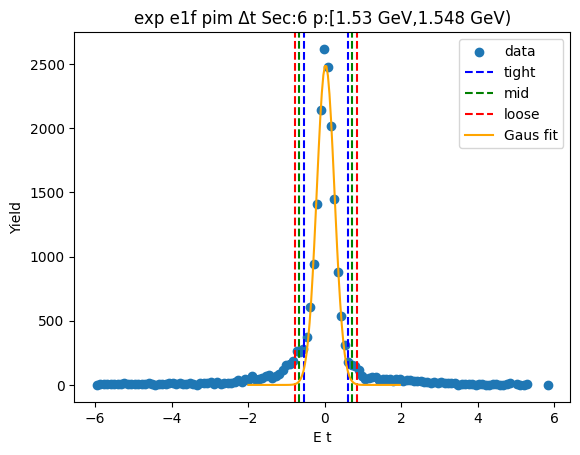

-0.5350512472440838 0.5909662781831948
-0.6476529997868117 0.7035680307259227
-0.7602547523295395 0.8161697832686505


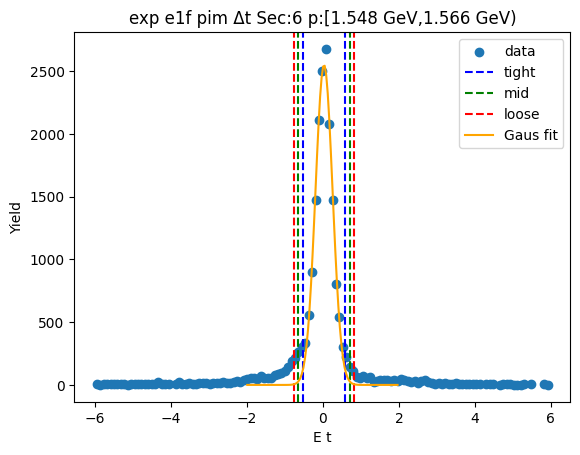

-0.569005906806369 0.628839618518353
-0.6887904593388412 0.7486241710508252
-0.8085750118713134 0.8684087235832975


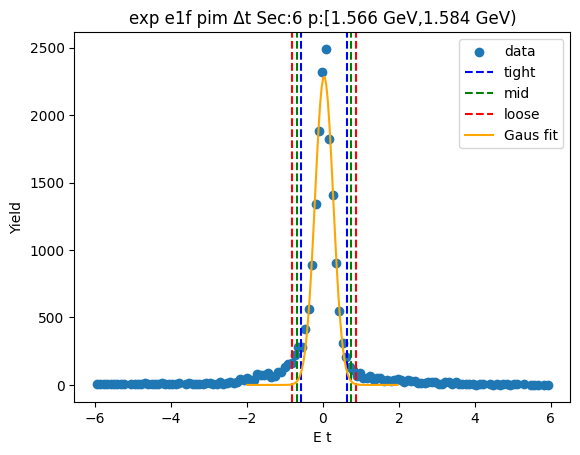

-0.5518654868626816 0.6086053045223572
-0.6679125660011854 0.724652383660861
-0.7839596451396893 0.8406994627993649


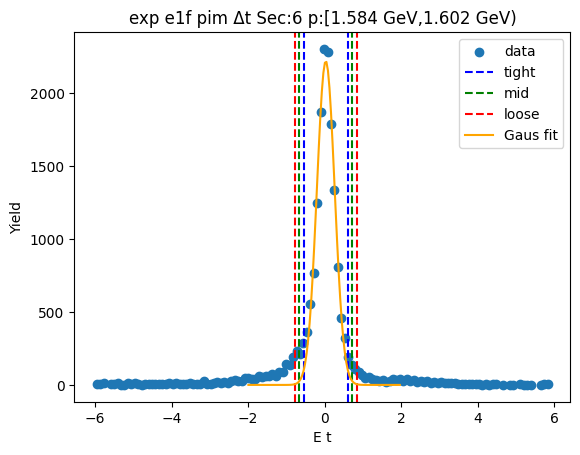

-0.5351120310172024 0.606215774185908
-0.6492448115375133 0.720348554706219
-0.7633775920578244 0.83448133522653


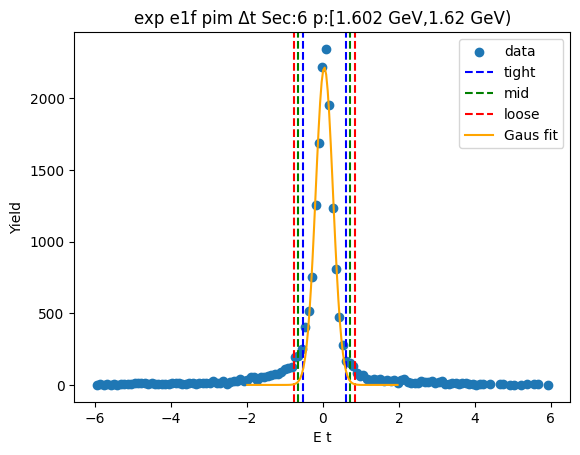

-0.5404178864612411 0.6062247251680978
-0.655082147624175 0.7208889863310317
-0.7697464087871089 0.8355532474939655


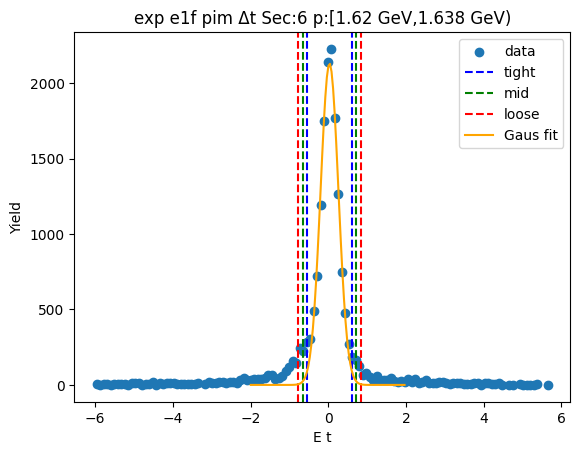

-0.5358781668066721 0.594994559324397
-0.648965439419779 0.708081831937504
-0.7620527120328859 0.8211691045506109


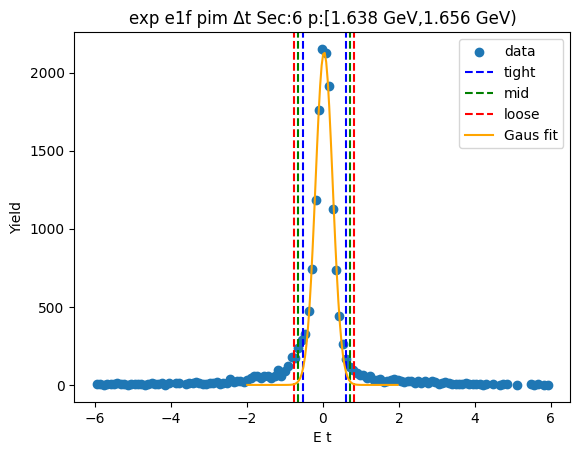

-0.5155263847485927 0.5918421642291305
-0.626263239646365 0.7025790191269028
-0.7370000945441373 0.8133158740246751


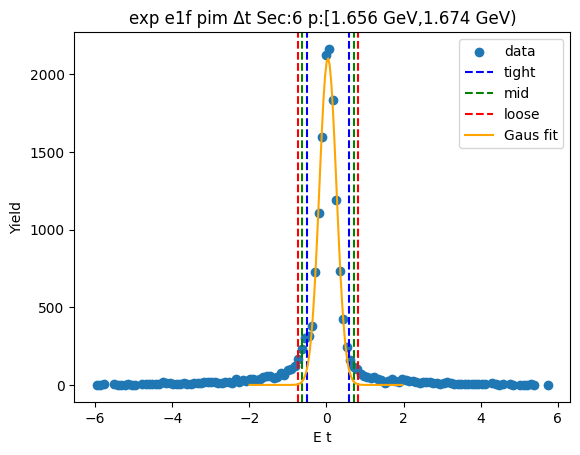

-0.5576039534164314 0.6199580755280842
-0.6753601563108831 0.7377142784225359
-0.7931163592053346 0.8554704813169874


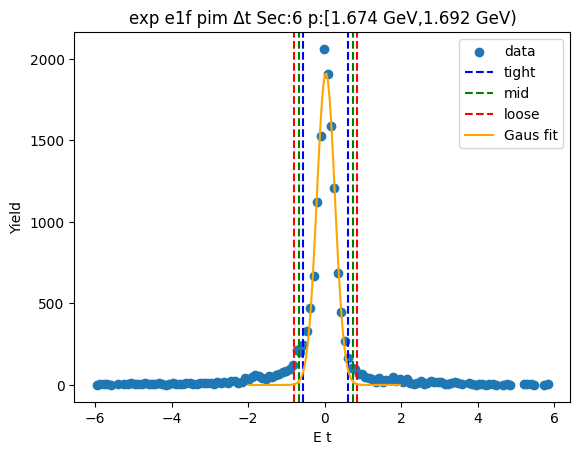

-0.5347347860968903 0.603043467501686
-0.648512611456748 0.7168212928615437
-0.7622904368166057 0.8305991182214014


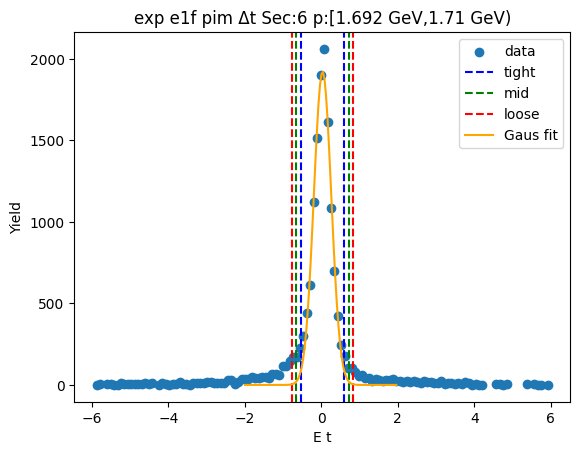

-0.5313931336829072 0.5928788392150823
-0.6438203309727061 0.7053060365048812
-0.756247528262505 0.8177332337946801


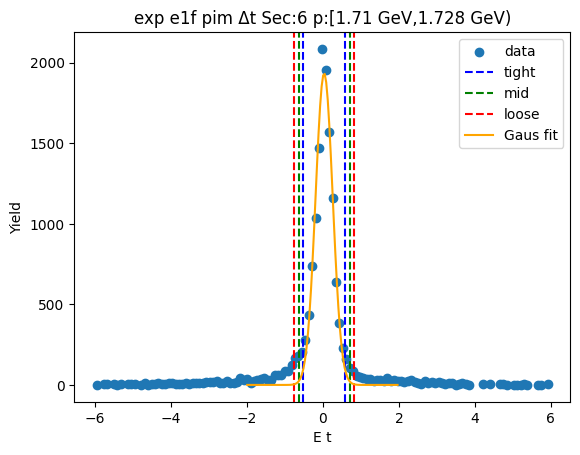

-0.5145412073833464 0.5829438621397485
-0.6242897143356559 0.692692369092058
-0.7340382212879654 0.8024408760443674


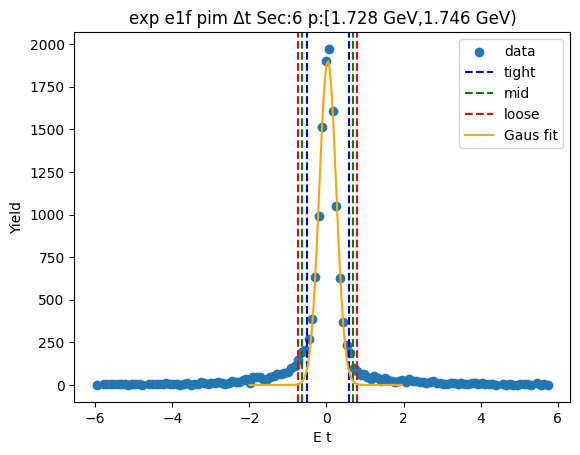

-0.5399953087339793 0.6052888436768826
-0.6545237239750655 0.7198172589179689
-0.7690521392161518 0.8343456741590551


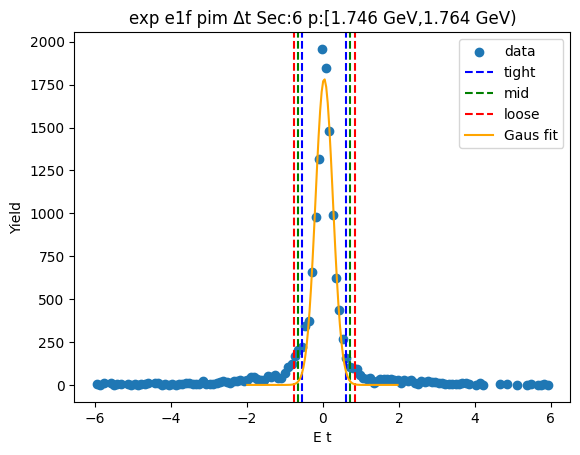

-0.5320453178749515 0.6044604498295468
-0.6456958946454012 0.7181110265999966
-0.759346471415851 0.8317616033704464


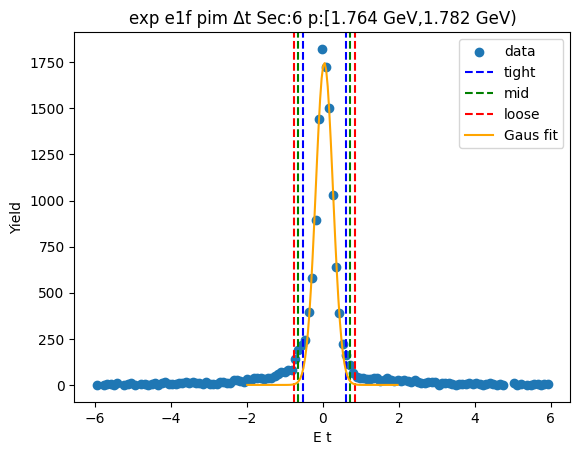

-0.5251729078973331 0.5975375379830214
-0.6374439524853686 0.709808582571057
-0.7497149970734039 0.8220796271590923


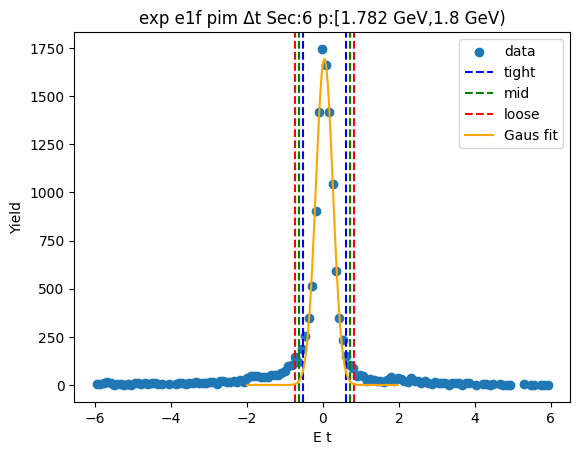

-0.5258708340417723 0.5978953257651237
-0.6382474500224619 0.7102719417458133
-0.7506240660031515 0.8226485577265029


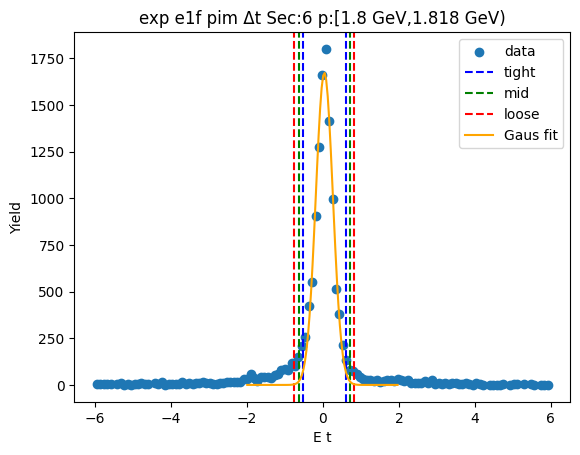

-0.5167055415292384 0.5913079828363778
-0.6275068939658 0.7021093352729393
-0.7383082464023616 0.8129106877095009


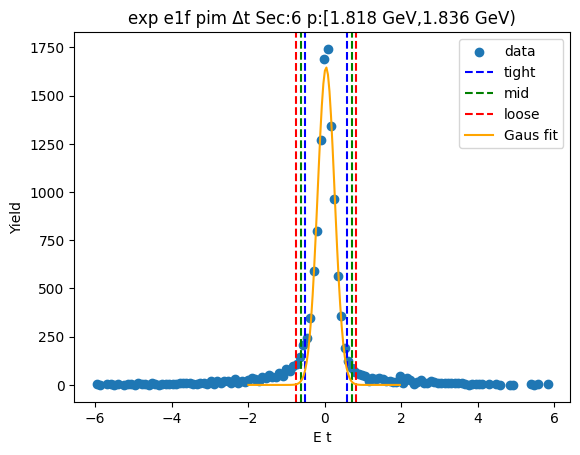

-0.5127755493527488 0.5848102805959214
-0.6225341323476159 0.6945688635907885
-0.7322927153424827 0.8043274465856556


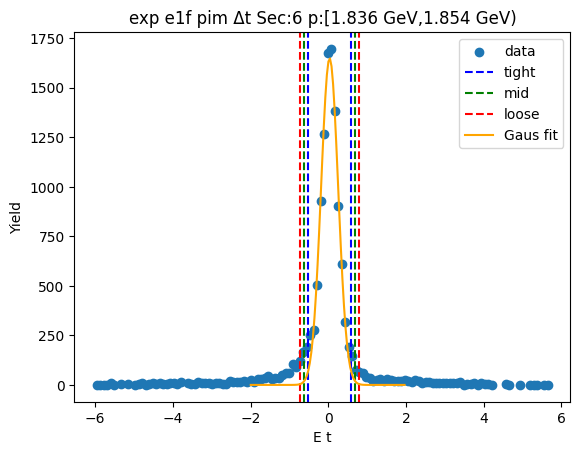

-0.5286638553143526 0.6028038759189507
-0.6418106284376829 0.715950649042281
-0.7549574015610132 0.8290974221656113


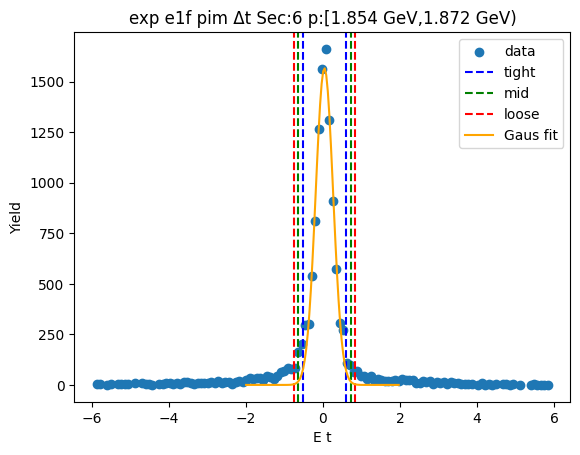

-0.5154127310071338 0.5923403699854183
-0.6261880411063889 0.7031156800846734
-0.7369633512056442 0.8138909901839286


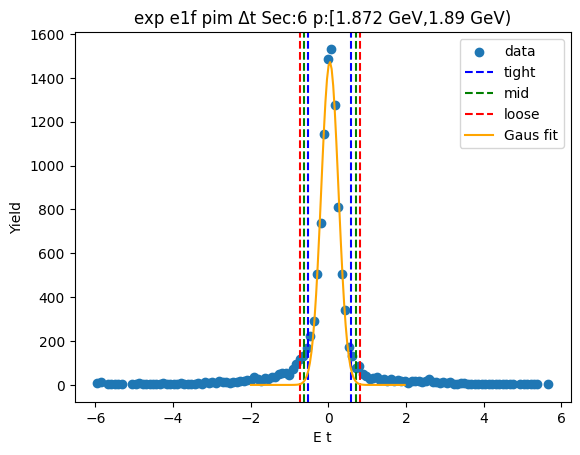

-0.4972062784461022 0.5678265623424328
-0.6037095625249557 0.6743298464212862
-0.7102128466038092 0.7808331305001398


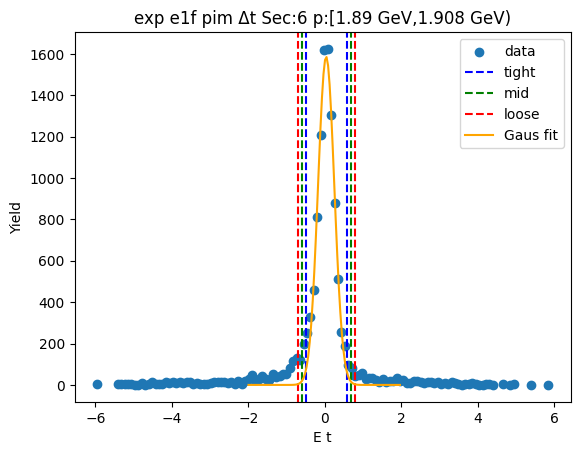

-0.5225627821597096 0.5955878133270966
-0.6343778417083902 0.7074028728757772
-0.7461929012570708 0.8192179324244578


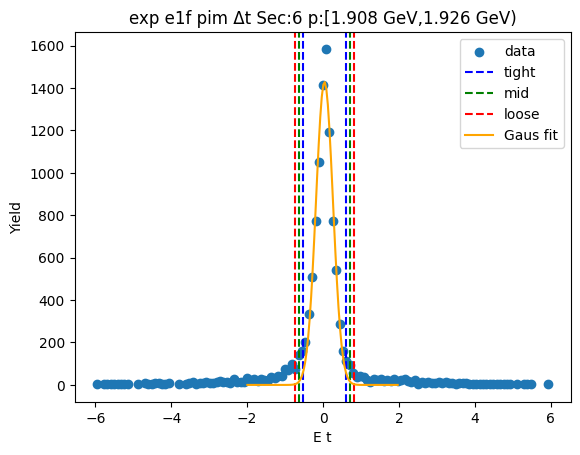

-0.5151786609756666 0.5945364930641239
-0.6261501763796457 0.705508008468103
-0.7371216917836246 0.816479523872082


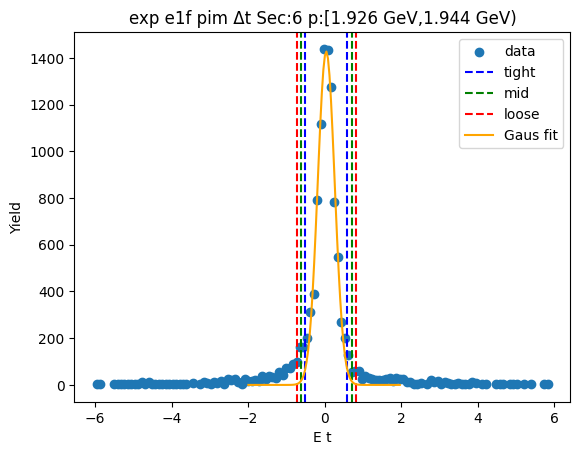

-0.5075274010088044 0.5705886011702108
-0.6153390012267059 0.6784002013881123
-0.7231506014446075 0.7862118016060139


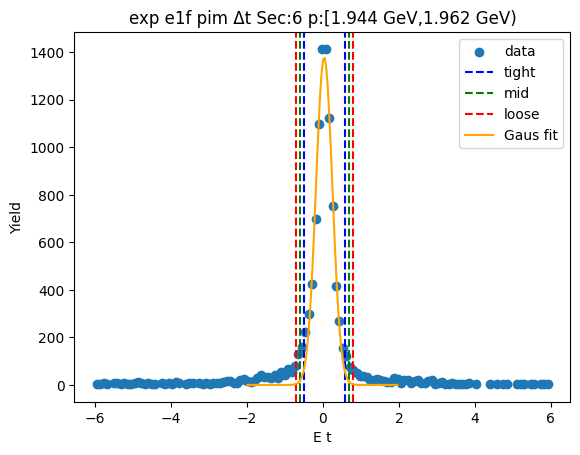

-0.49940339017980345 0.5634355486893793
-0.6056872840667218 0.6697194425762976
-0.7119711779536401 0.7760033364632158


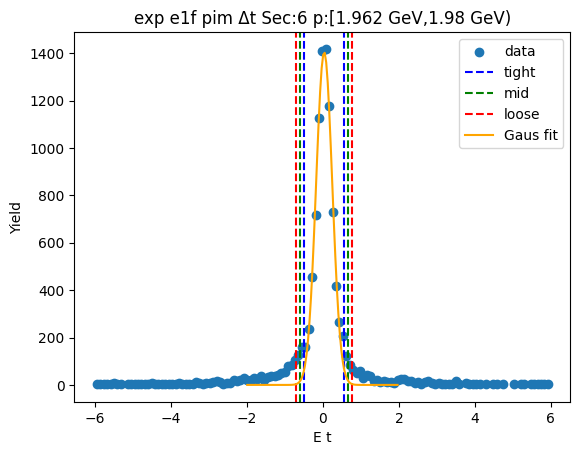

-0.5213207622225092 0.5968282872362912
-0.6331356671683892 0.7086431921821712
-0.7449505721142692 0.8204580971280512


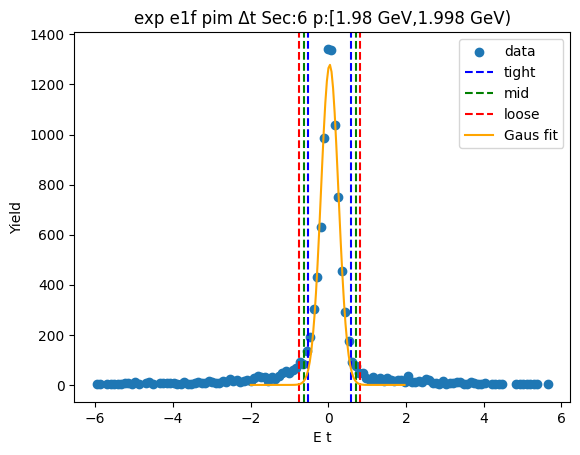

-0.4826331204876363 0.5462244887639044
-0.5855188814127904 0.6491102496890585
-0.6884046423379444 0.7519960106142125


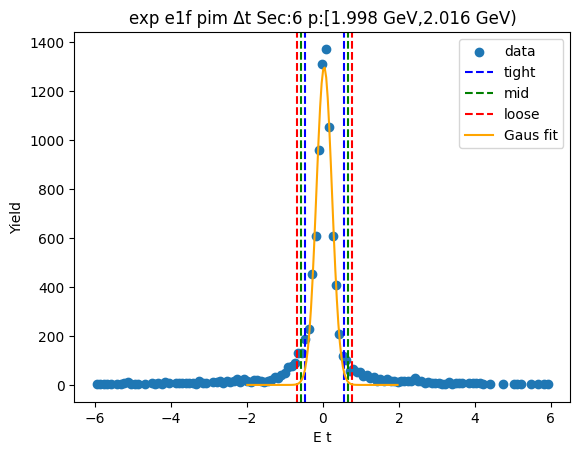

-0.5042670296276366 0.5912807654848247
-0.6138218091388827 0.7008355449960708
-0.7233765886501289 0.810390324507317


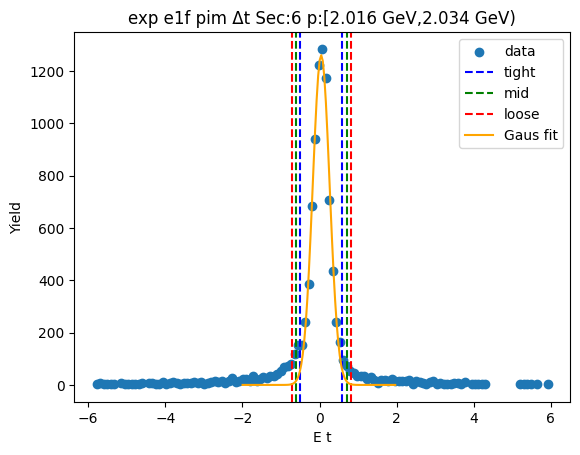

-0.5221083725926826 0.6017264610089917
-0.63449185595285 0.7141099443691591
-0.7468753393130174 0.8264934277293265


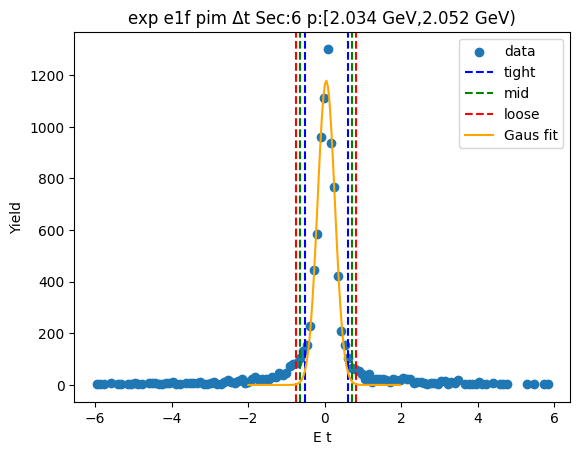

-0.519634611742089 0.5961432118723363
-0.6312123941035316 0.7077209942337789
-0.7427901764649741 0.8192987765952214


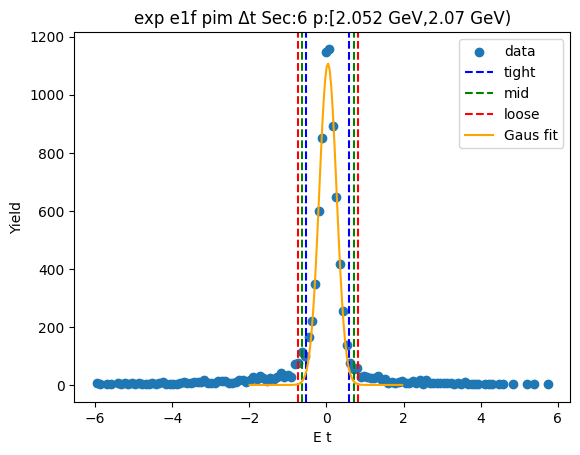

-0.5012042195909995 0.6003295961151046
-0.6113576011616099 0.710482977685715
-0.7215109827322203 0.8206363592563254


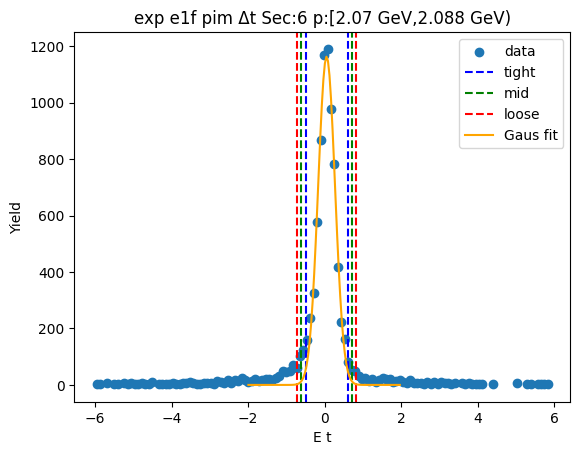

-0.5028380367544044 0.5769590782055646
-0.6108177482504014 0.6849387897015615
-0.7187974597463982 0.7929185011975584


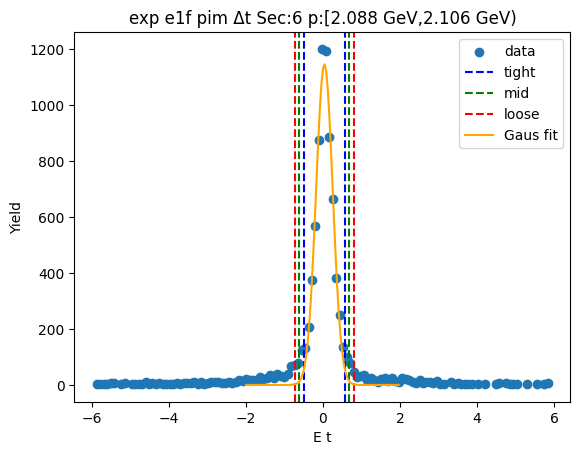

-0.514068901028825 0.6070855278298816
-0.6261843439146956 0.7192009707157522
-0.7382997868005663 0.8313164136016229


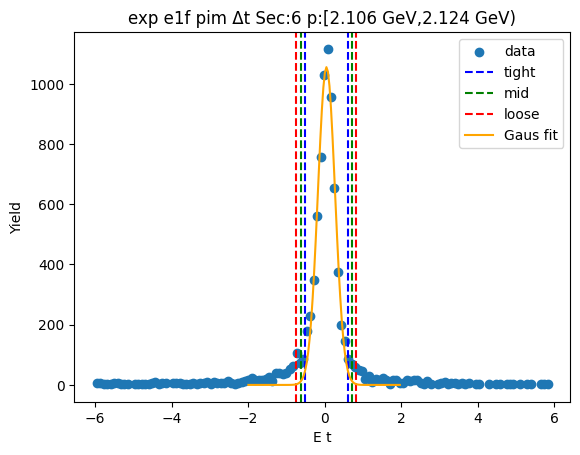

-0.502000448617384 0.6115729458498008
-0.6133577880641026 0.7229302852965194
-0.7247151275108211 0.8342876247432379


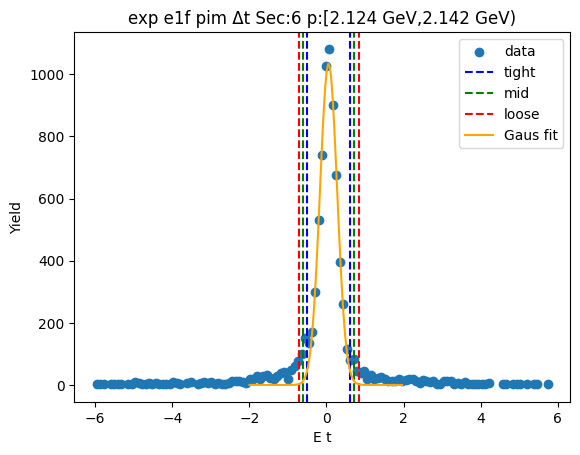

-0.49947953965079844 0.5914617577579717
-0.6085736693916756 0.7005558874988488
-0.7176677991325525 0.8096500172397257


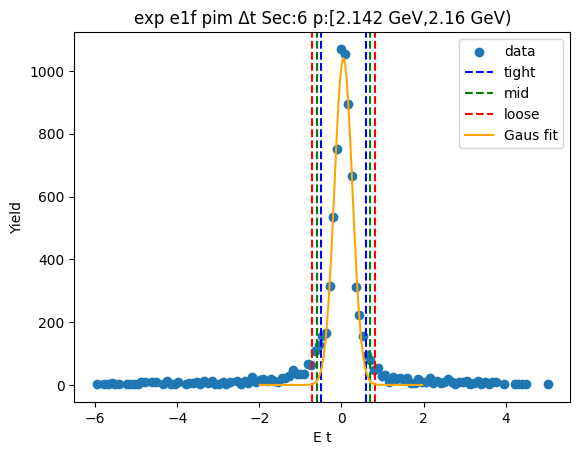

-0.4711936606339157 0.5687840103982107
-0.5751914277371285 0.6727817775014234
-0.6791891948403411 0.776779544604636


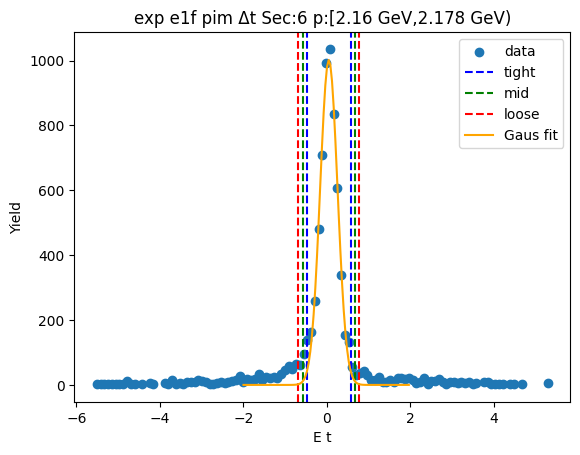

-0.48270183639701103 0.590131114953244
-0.5899851315320366 0.6974144100882695
-0.697268426667062 0.804697705223295


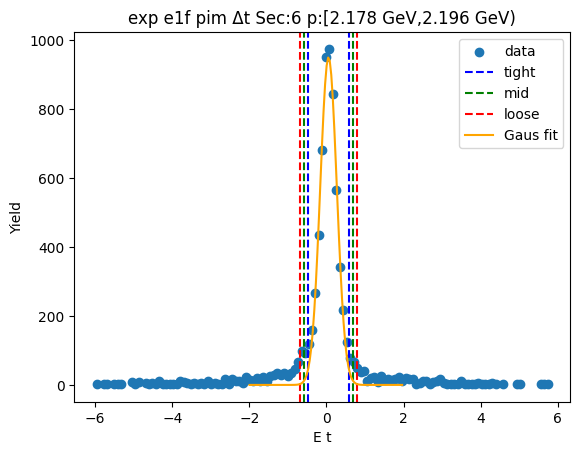

-0.4752644190190343 0.5610827943844245
-0.5788991403593802 0.6647175157247702
-0.6825338616997261 0.7683522370651161


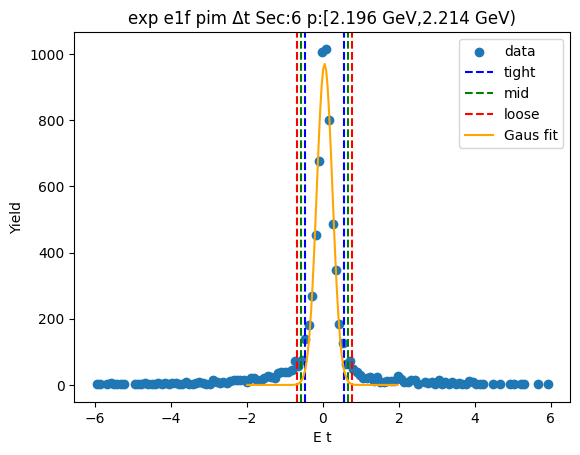

-0.5154563728925506 0.6136678481126562
-0.6283687949930714 0.726580270213177
-0.7412812170935921 0.8394926923136976


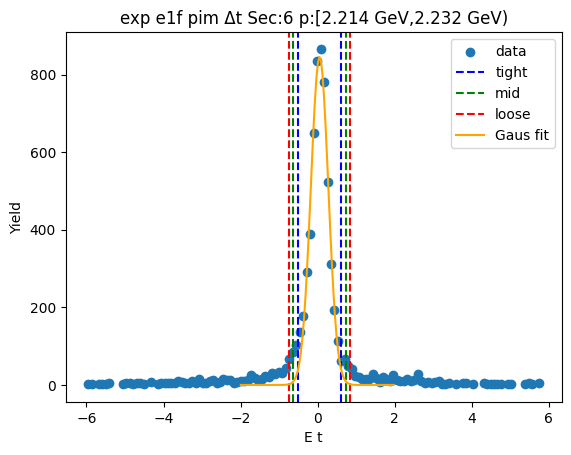

-0.46435855861804004 0.5617182310970188
-0.5669662375895459 0.6643259100685246
-0.6695739165610518 0.7669335890400305


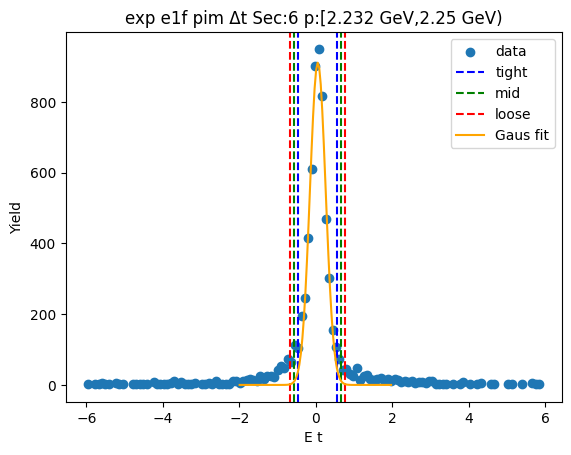

-0.48089018571204817 0.57043755761058
-0.586022960044311 0.675570331942843
-0.6911557343765737 0.7807031062751058


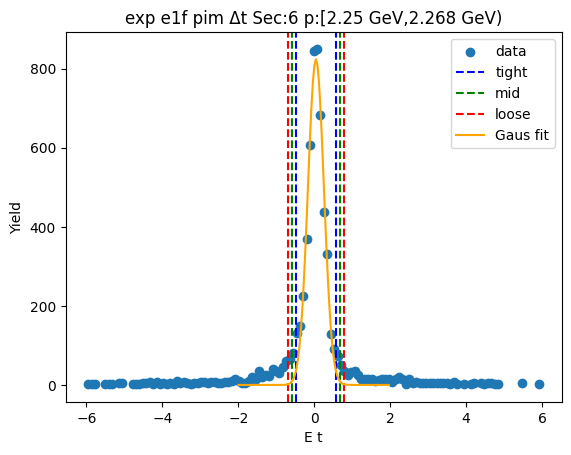

-0.48153014843069114 0.5773126740757185
-0.5874144306813321 0.6831969563263595
-0.6932987129319731 0.7890812385770004


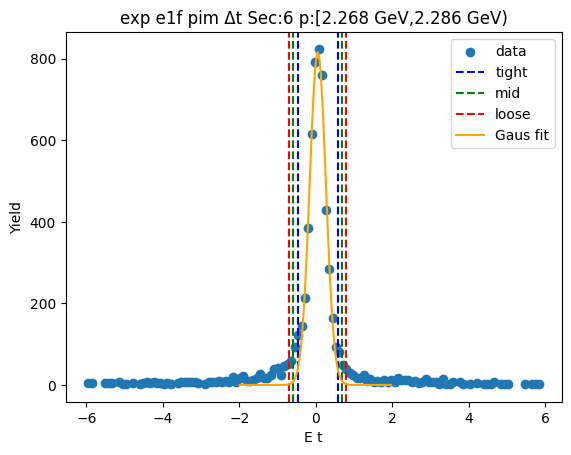

-0.46283683219426897 0.5704249630030865
-0.5661630117140045 0.6737511425228221
-0.6694891912337401 0.7770773220425576


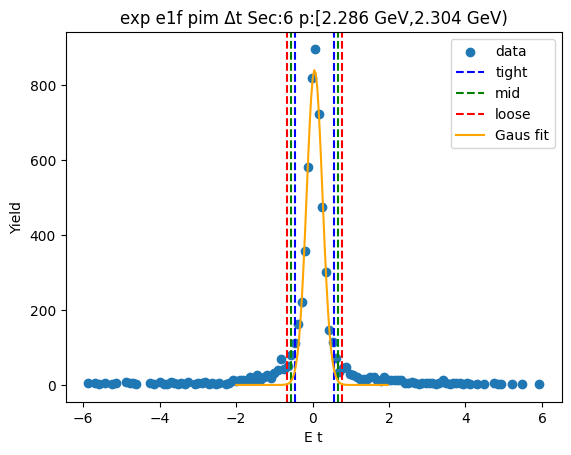

-0.49393908523963126 0.5898496029502389
-0.6023179540586182 0.6982284717692259
-0.7106968228776052 0.8066073405882128


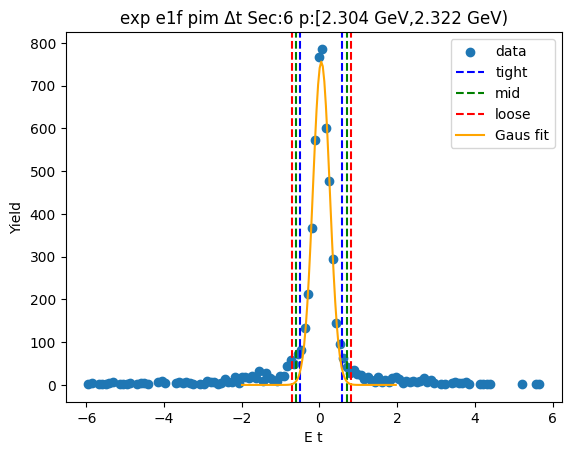

-0.48691633282123026 0.5822147589140658
-0.5938294419947598 0.6891278680875954
-0.7007425511682894 0.796040977261125


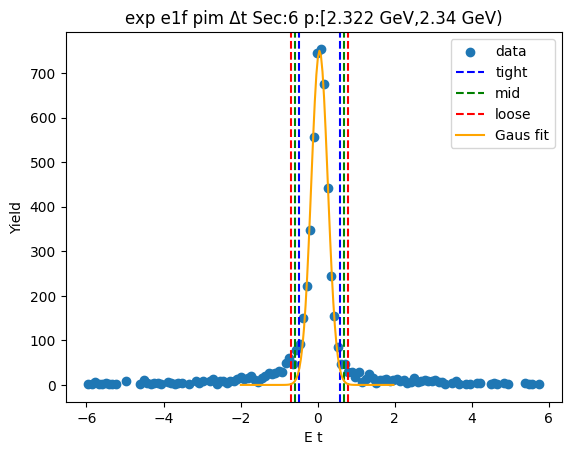

-0.4717975852828614 0.6007588331269923
-0.5790532271238469 0.7080144749679778
-0.6863088689648322 0.8152701168089631


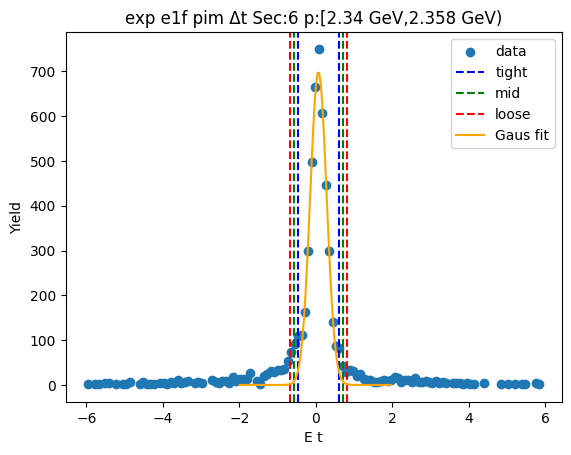

-0.5178334415057293 0.6071355577180884
-0.6303303414281111 0.7196324576404701
-0.7428272413504928 0.8321293575628519


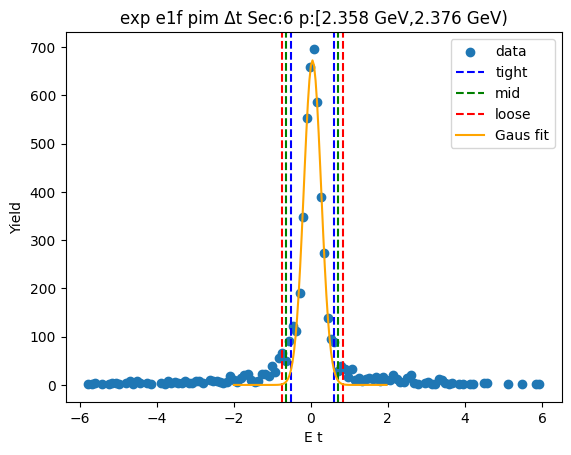

-0.4757472929543314 0.5809947096140482
-0.5814214932111693 0.6866689098708861
-0.6870956934680073 0.7923431101277241


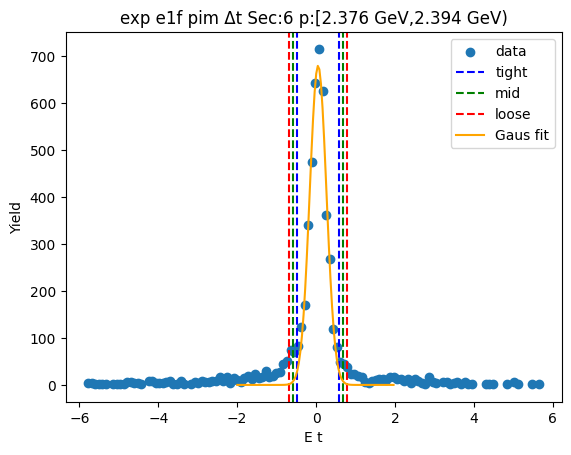

In [18]:
#Initial Guesses for Gaussian Fit
a1=30
m1=0.01
s1=1.5
initial_pars1=[27856.22, 0.01855, 0.8616]

initial_pars2 = [30000,-6.0,1.0]

inital_pars3 = []

tmp_par1 = np.zeros(3)
tmp_par2 = np.zeros(6)

#par_bound_low = [0.0,0.0,0.0]
#par_bound_top = [inf,inf,inf]

fit_pars1 = np.zeros((6,len(x),6))
err1 = np.zeros((6,len(x),3))
bound_mod=[0.6,]
low_mod = 1.2
norm_mod=1.2
min_p = [0.3,0.3,0.3,0.3,0.3,0.3]
mid_p = 4.0
p_cutoff = 2.4

num_sigma1 = [2.5,3,3.5]
bounds1 = np.zeros((6,2,3,len(x)))
sigma1= np.zeros((6,2,3,len(x)))

g1_pars = np.zeros((6,len(x),3))
g2_pars = np.zeros((6,len(x),3))

for sec in range(6):
    for i in range(3):
        tmp_par1[i] = initial_pars1[i]
        for j in range(2):
            if j ==0:
                tmp_par2[i+j*3]= initial_pars1[i]
            elif j ==1:
                tmp_par2[i+j*3]= initial_pars2[i]
    for xbin in range(len(x)):
        if fit_y[sec][xbin].sum()>15 and x[xbin]>min_p[sec] and x[xbin]<p_cutoff:
            #Set the amplitude guess to the maximum yield value
            initial_pars1[0] = np.amax(fit_y[sec][xbin])
            plt.scatter(fit_x[sec][xbin],fit_y[sec][xbin],label="data")
            #Initial Fitting
            #Set Fit Range
            if x[xbin]<mid_p:  
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-norm_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x1 = Bounds_on_Y(fit_x[sec][xbin],-2.0,2.0)
                fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],-2.0,2.0)
                cont_x1 = np.linspace(fit_x1[0],fit_x1[len(fit_x1)-1],100)
                try:
                    pars1 = op.curve_fit(Gaus,fit_x1,fit_y1,p0=tmp_par1,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars1[0][i]
                        tmp_par1[i]=pars1[0][i]
                        tmp_par2[i]=pars1[0][i]
                        err1[sec][xbin][i]=np.sqrt(pars1[1][i][i])
                        bounds1[sec][0][i][xbin] = pars1[0][1] - num_sigma1[i]*pars1[0][2]
                        bounds1[sec][1][i][xbin] = pars1[0][1] + num_sigma1[i]*pars1[0][2]
                        sigma1[sec][0][i][xbin] = pars1[1][1][1] - num_sigma1[i]*pars1[1][2][2]
                        sigma1[sec][1][i][xbin] = pars1[1][1][1] + num_sigma1[i]*pars1[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                    plt.plot(cont_x1,Gaus(cont_x1,*pars1[0]),color='orange',label='Gaus fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            else:
                #fit_x1 = Bounds_on_Y(fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                #fit_y1 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x[sec][xbin],initial_pars1[1]-low_mod*initial_pars1[2],initial_pars1[1]+norm_mod*initial_pars1[2])
                fit_x2 = Bounds_on_Y(fit_x[sec][xbin],-6.0,2.0)
                fit_y2 = Bounds_on_X_From_Y(fit_y[sec][xbin],fit_x2[sec][xbin],-6.0,2.0)
                cont_x2 = np.linspace(fit_x2[0],fit_x2[len(fit_x2)-1],100)
                plt.plot(cont_x2,Gaus2(cont_x2,*tmp_par2),color='r',label='Inital 2Gaus fit')
                try:
                    pars2 = op.curve_fit(Gaus2,fit_x2,fit_y2,p0=tmp_par2,maxfev=5000)
                    for i in range(3):
                        fit_pars1[sec][xbin][i]=pars2[0][i]
                        g1_pars[sec][xbin][i] = pars2[0][i]
                        g2_pars[sec][xbin][i] = pars2[0][i+3]
                        err1[sec][xbin][i]=np.sqrt(pars2[1][i][i])
                        bounds1[sec][0][i][xbin] = pars2[0][1] - num_sigma1[i]*pars2[0][2]
                        bounds1[sec][1][i][xbin] = pars2[0][1] + num_sigma1[i]*pars2[0][2]
                        sigma1[sec][0][i][xbin] = pars2[1][1][1] - num_sigma1[i]*pars2[1][2][2]
                        sigma1[sec][1][i][xbin] = pars2[1][1][1] + num_sigma1[i]*pars2[1][2][2]
                        plt.axvline(x=bounds1[sec][0][i][xbin],label=cut_name[i],color=cut_cols[i],linestyle='dashed')
                        plt.axvline(x=bounds1[sec][1][i][xbin],color=cut_cols[i],linestyle='dashed')
                        print(bounds1[sec][0][i][xbin],bounds1[sec][1][i][xbin])
                        for j in range(2):
                            tmp_par2[i+j*3]= pars2[0][i+j*3]
                    plt.plot(cont_x2,Gaus2(cont_x2,*pars2[0]),color='orange',label='2Gaus fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g1_pars[0][xbin]),color='c',label='Proton fit')
                    plt.plot(cont_x2,Gaus(cont_x2,*g2_pars[0][xbin]),color='m',label='\u03C0+ fit')
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            
            
            #if np.sqrt(pars1[1][1][1])/pars1[0][1] < 0.1:
            
            
           
            plot_title="{} {} {} \u0394t Sec:{} p:[{} GeV,{} GeV)".format(sim,run,species,sec+1,Pbin_low(xbin),Pbin_top(xbin))
            plt.title(plot_title)
            plt.xlabel(yname)
            plt.ylabel("Yield")
            plt.legend()
            plt.show()

In [19]:
for sec in range(6):
    for cut in range(3):
        for xbin in range(len(x)):
            bounds1[sec][0][cut][xbin] = fit_pars1[sec][xbin][1]-num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][0][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]
            bounds1[sec][1][cut][xbin] = fit_pars1[sec][xbin][1]+num_sigma1[cut]*fit_pars1[sec][xbin][2]
            sigma1[sec][1][cut][xbin] = err1[sec][xbin][1]+num_sigma1[cut]*err1[sec][xbin][2]

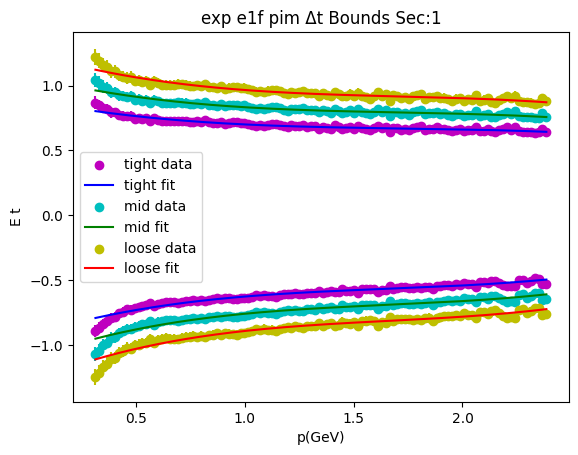

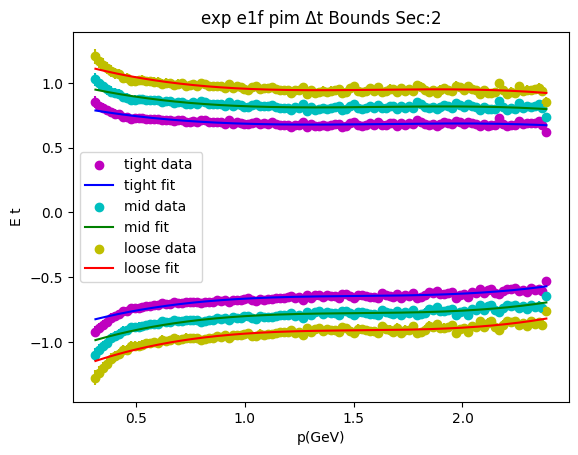

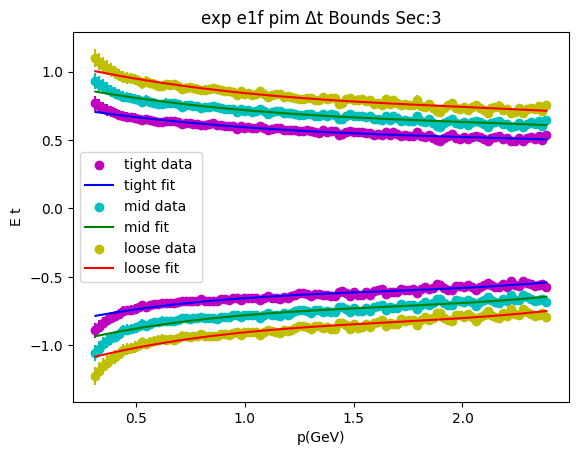

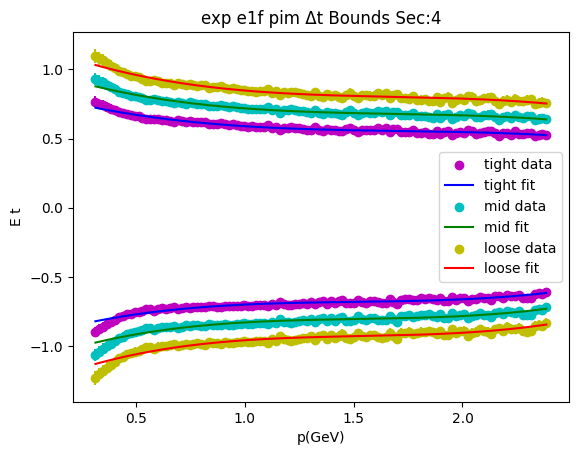

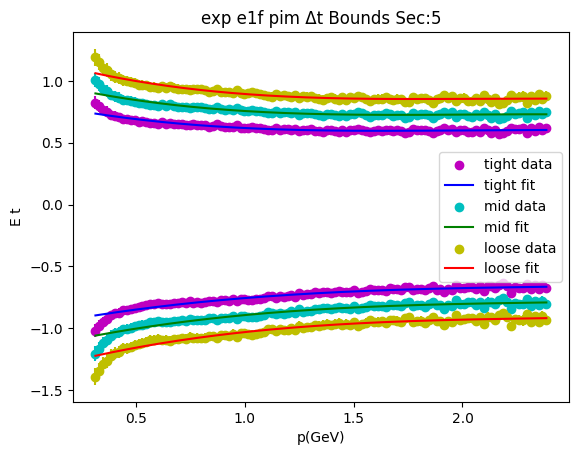

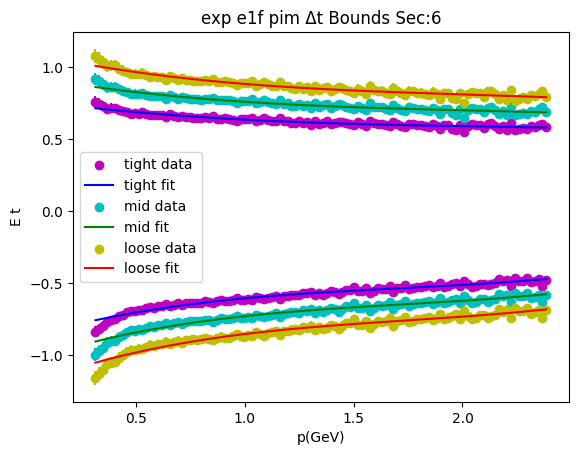

In [20]:
l0=0.0
l1=0.5
l2=-0.2
l3=0.2
initial_low_par2=[l0,l1,l2,l3]
t0=0.0
t1=0.5
t2=-0.2
t3=-0.2
initial_top_par2=[t0,t1,t2,t3]

low_par_fit= np.zeros((6,3,4))
top_par_fit = np.zeros((6,3,4))

cut_cols = ['b','g','r']
cut_name= ["tight","mid","loose"]
data_cols = ['m',"c",'y']

par_bou = [[[-np.inf,-np.inf,-np.inf,0.0],[np.inf,np.inf,np.inf,np.inf]],
           [[-np.inf,-np.inf,-np.inf,-np.inf],[np.inf,np.inf,np.inf,0.0]]]

for sec in range(6):
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),label="{} data".format(cut_name[cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),yerr=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),fmt='',linestyle='',color=data_cols[cut])
        plt.errorbar(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),yerr=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),fmt='',linestyle='',color=data_cols[cut])
        #Fit with 3rd order Polynomial 
        par_low1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),p0=initial_low_par2,sigma=Remove_Zeros_X(sigma1[sec][0][cut],bounds1[sec][0][cut]),bounds=par_bou[0],maxfev=5000)
        par_top1=op.curve_fit(Poly3,Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),p0=initial_top_par2,sigma=Remove_Zeros_X(sigma1[sec][1][cut],bounds1[sec][1][cut]),bounds=par_bou[1],maxfev=5000)
        for i in range(4):
            low_par_fit[sec][cut][i] = par_low1[0][i]
            top_par_fit[sec][cut][i] = par_top1[0][i]
        cont_x_low = np.linspace(Remove_Zeros_X(x,bounds1[sec][0][cut])[0],Remove_Zeros_X(x,bounds1[sec][0][cut])[len(Remove_Zeros_X(x,bounds1[sec][0][cut]))-1],200)
        cont_x_top = np.linspace(Remove_Zeros_X(x,bounds1[sec][1][cut])[0],Remove_Zeros_X(x,bounds1[sec][1][cut])[len(Remove_Zeros_X(x,bounds1[sec][1][cut]))-1],200)
        plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color=cut_cols[cut],label="{} fit".format(cut_name[cut]))
        plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color=cut_cols[cut])
    plot_title="{} {} {} \u0394t Bounds Sec:{}".format(sim,run,species,sec+1)
    plt.title(plot_title)
    plt.xlabel(xname)
    plt.ylabel(yname)
    plt.legend()
    plt.show()

In [21]:
#Stuff to make it so I can plot a 2d Histogram with data in the format I have
#Would be a lot easier if I had uproot 4 working 
dumb_x= np.zeros((6,len(xbins)*len(ybins)))
dumb_y= np.zeros((6,len(xbins)*len(ybins)))
dense2 = np.zeros((6,len(xbins)*len(ybins)))
for sec in range(6):
    for i in range(len(xbins)):
        for j in range(len(ybins)):
            dumb_x[sec][i+j*len(xbins)]+=xbins[i]
            dumb_y[sec][i+j*len(xbins)]+=ybins[j]
            dense2[sec][i+j*len(xbins)]+=zvals_xy[sec][i][j]

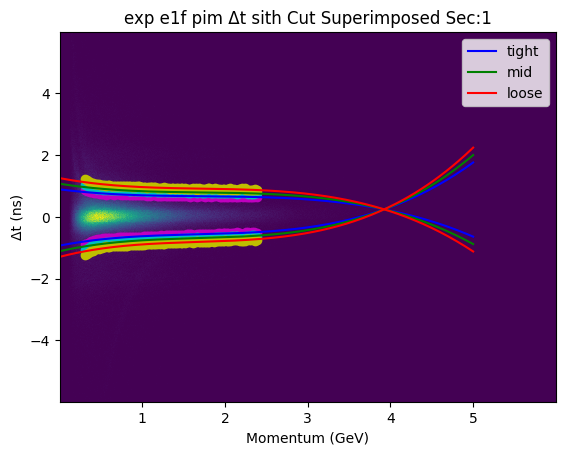

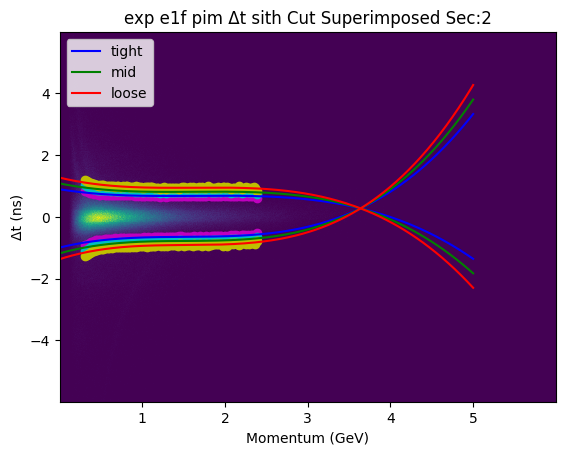

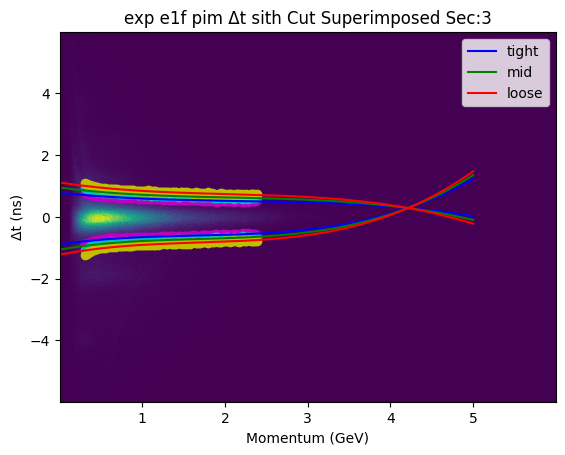

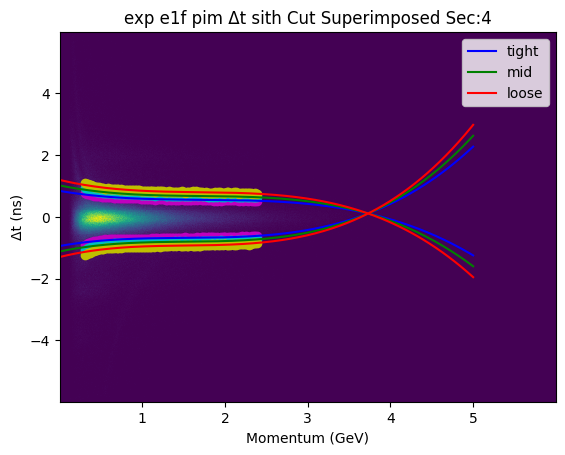

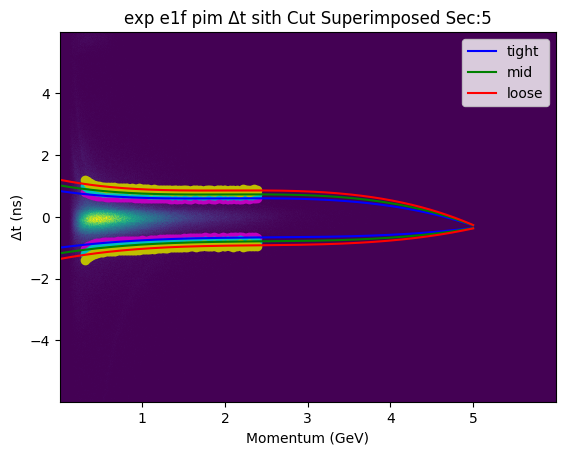

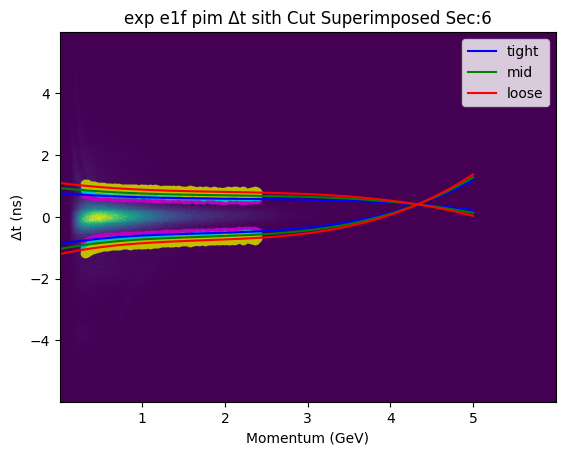

In [22]:
for sec in range(6):
    plt.hist2d(dumb_x[sec], dumb_y[sec], bins=(len(xbins), len(ybins)), weights=dense2[sec])
    for cut in range(3):
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][0][cut]),Remove_Zeros(bounds1[sec][0][cut]),color=data_cols[cut])
        plt.scatter(Remove_Zeros_X(x,bounds1[sec][1][cut]),Remove_Zeros(bounds1[sec][1][cut]),color=data_cols[cut])
        cont_x_low2 = np.linspace(0.0,5.0,200)
        cont_x_top2 = np.linspace(0.0,5.0,200)
        plt.plot(cont_x_low2,Poly3(cont_x_low2,*low_par_fit[sec][cut]),color=cut_cols[cut],label=cut_name[cut])
        plt.plot(cont_x_top2,Poly3(cont_x_top2,*top_par_fit[sec][cut]),color=cut_cols[cut])
        #cont_x_low = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][0][cut]))-1],200)
        #cont_x_top = np.linspace(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[0],Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut])[len(Remove_Zeros_X(sf_x,sf_bounds1[sec][1][cut]))-1],200)
        #plt.plot(cont_x_low,Poly3(cont_x_low,*low_par_fit[sec][cut]),color='y')
        #plt.plot(cont_x_top,Poly3(cont_x_top,*top_par_fit[sec][cut]),color='y')
    plt.title("{} {} {} \u0394t sith Cut Superimposed Sec:{}".format(sim,run,species,sec+1))
    plt.xlabel("Momentum (GeV)")
    plt.ylabel("\u0394t (ns)")
    plt.legend()
    plt.show()
    
    

In [23]:
print(cut_perf+" "+species+" Cut Parameters for ",num_sigma1," sigma cut using 3rd order Polynomial")
print("Lower Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        #print("{\t{\t{",low_par_fit[sec][cut][par],end=",")
                        print("{\t{\t{",low_par_fit[4][cut][par],end=",")
                    else:
                        #print("\t{\t{",low_par_fit[sec][cut][par],end=",")
                        print("\t{\t{",low_par_fit[4][cut][par],end=",")
                else:
                    #print("\t\t{",low_par_fit[sec][cut][par],end=",")
                    print("\t\t{",low_par_fit[4][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            #print(low_par_fit[sec][cut][par],"}}}")
                            print(low_par_fit[4][cut][par],"}}}")
                        else:
                            print(low_par_fit[4][cut][par],"}},")
                            #print(low_par_fit[sec][cut][par],"}},")
                    else:
                        #print(low_par_fit[sec][cut][par],"},")
                        print(low_par_fit[4][cut][par],"},")
                else:
                    #print(low_par_fit[sec][cut][par],end=",")
                    print(low_par_fit[4][cut][par],end=",")
print("Upper Bound in order of increasing exponent")
for sec in range(6):
    for cut in range(3):
        for par in range(4):
            if par==0:
                if cut==0:
                    if sec==0:
                        #print("{\t{\t{",top_par_fit[sec][cut][par],end=",")
                        print("{\t{\t{",top_par_fit[4][cut][par],end=",")
                    else:
                        #print("\t{\t{",top_par_fit[sec][cut][par],end=",")
                        print("\t{\t{",top_par_fit[4][cut][par],end=",")
                else:
                    #print("\t\t{",top_par_fit[sec][cut][par],end=",")
                    print("\t\t{",top_par_fit[4][cut][par],end=",")
            else:
                if par==3:
                    if cut == 2:
                        if sec == 5:
                            #print(top_par_fit[sec][cut][par],"}}}")
                            print(top_par_fit[4][cut][par],"}}}")
                        else:
                            #print(top_par_fit[sec][cut][par],"}},")
                            print(top_par_fit[4][cut][par],"}},")
                    else:
                        #print(top_par_fit[sec][cut][par],"},")
                        print(top_par_fit[4][cut][par],"},")
                else:
                    #print(top_par_fit[sec][cut][par],end=",")
                    print(top_par_fit[4][cut][par],end=",")
#print(low_par_fit)
#print(top_par_fit)

delta pim Cut Parameters for  [2.5, 3, 3.5]  sigma cut using 3rd order Polynomial
Lower Bound in order of increasing exponent
{	{	{ -0.9963317816543192,0.3521081110290479,-0.13034812980869595,0.01710506101218697 },
		{ -1.1798985697863642,0.4260994503046556,-0.16354971218952458,0.02219191969103157 },
		{ -1.3634653468913258,0.500090758866741,-0.1967512701570272,0.027278772558756617 }},
	{	{ -0.9963317816543192,0.3521081110290479,-0.13034812980869595,0.01710506101218697 },
		{ -1.1798985697863642,0.4260994503046556,-0.16354971218952458,0.02219191969103157 },
		{ -1.3634653468913258,0.500090758866741,-0.1967512701570272,0.027278772558756617 }},
	{	{ -0.9963317816543192,0.3521081110290479,-0.13034812980869595,0.01710506101218697 },
		{ -1.1798985697863642,0.4260994503046556,-0.16354971218952458,0.02219191969103157 },
		{ -1.3634653468913258,0.500090758866741,-0.1967512701570272,0.027278772558756617 }},
	{	{ -0.9963317816543192,0.3521081110290479,-0.13034812980869595,0.01710506101218697 },